In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from xgboost import XGBClassifier
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score, roc_auc_score, confusion_matrix, roc_curve
from sklearn.inspection import permutation_importance
from sklearn.utils.class_weight import compute_class_weight
import shap
from sklearn.linear_model import LassoCV
import seaborn as sns
import matplotlib.pyplot as plt
import joblib

# Các hàm

## 1. Load dữ liệu

In [2]:
# Đọc dữ liệu
def load_data(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")
    
    # In thông tin chung về dữ liệu
    print(X_train.info())

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'type', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")
    
    return X_train, y_train, X_test, y_test

## 2. Đánh giá dữ liệu

In [3]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    f1_score, precision_score, recall_score, accuracy_score,
    roc_auc_score, roc_curve, confusion_matrix, classification_report
)
import matplotlib.pyplot as plt
import seaborn as plt
import seaborn as sns
import numpy as np

def evaluate_model(model, X_train, y_train, X_test, y_test):
    def evaluate_split(X, y, split_name):
        y_pred = model.predict(X)
        y_proba = model.predict_proba(X)

        f1 = f1_score(y, y_pred, average=None)
        precision = precision_score(y, y_pred, average=None)
        recall = recall_score(y, y_pred, average=None)
        accuracy = accuracy_score(y, y_pred)

        y_bin = label_binarize(y, classes=[0, 1, 2, 3, 4])
        roc_auc = roc_auc_score(y_bin, y_proba, multi_class="ovr")

        print(f"\n--- {split_name} Metrics ---")
        print("F1 Score (per class):", f1)
        print("Precision (per class):", precision)
        print("Recall (per class):", recall)
        print(f"Accuracy: {accuracy:.4f}")
        print(f"AUC (One-vs-Rest): {roc_auc:.4f}")

        print("\nClassification Report:")
        print(classification_report(y, y_pred, target_names=["E", "D", "C", "B", "A"]))

        conf_matrix = confusion_matrix(y, y_pred)
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
                    xticklabels=["E", "D", "C", "B", "A"],
                    yticklabels=["E", "D", "C", "B", "A"])
        plt.title(f"Confusion Matrix - {split_name}")
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.show()

        # ROC Curve
        plt.figure(figsize=(10, 8))
        for i in range(5):
            fpr, tpr, _ = roc_curve(y_bin[:, i], y_proba[:, i])
            auc_score = roc_auc_score(y_bin[:, i], y_proba[:, i])
            plt.plot(fpr, tpr, label=f"Class {i} (AUC = {auc_score:.2f})")
        plt.plot([0, 1], [0, 1], 'k--')
        plt.title(f"ROC Curve - {split_name}")
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.legend()
        plt.show()

        return f1, precision, recall, accuracy, roc_auc

    train_metrics = evaluate_split(X_train, y_train, "Train")
    test_metrics = evaluate_split(X_test, y_test, "Test")

    return {
        "train": train_metrics,
        "test": test_metrics
    }

## 3. Scale dữ liệu

In [4]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
import numpy as np
import pandas as pd

def scale_data(X_train, X_test, scaler_type="standard"):
    """
    Áp dụng các kỹ thuật scaling cho dữ liệu.
    
    Parameters:
        X_train (DataFrame): Dữ liệu huấn luyện
        X_test (DataFrame): Dữ liệu kiểm tra
        scaler_type (str): 'minmax', 'standard', 'robust', hoặc 'log'
    
    Returns:
        X_train_scaled, X_test_scaled: Dữ liệu đã được scale
    """
    if scaler_type == "log":
        # Đảm bảo tất cả các giá trị > 0 trước khi lấy log
        min_val = min(X_train.min().min(), X_test.min().min())
        if min_val <= 0:
            offset = 1 - min_val
            X_train = X_train + offset
            X_test = X_test + offset
        X_train_scaled = np.log(X_train)
        X_test_scaled = np.log(X_test)
        return X_train_scaled, X_test_scaled

    elif scaler_type == "minmax":
        scaler = MinMaxScaler()
    elif scaler_type == "standard":
        scaler = StandardScaler()
    elif scaler_type == "robust":
        scaler = RobustScaler()
    else:
        raise ValueError(f"Scaler type '{scaler_type}' không hợp lệ. Chọn: 'minmax', 'standard', 'robust', hoặc 'log'.")

    # Fit và transform dữ liệu
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    return X_train_scaled, X_test_scaled


## Permutation Importance

In [5]:
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import pandas as pd

def plot_permutation_importance(model, X_train, y_train):
    # Tính Permutation Importance
    perm_importance = permutation_importance(model, X_train, y_train, n_repeats=8, random_state=42)
    
    # Tạo DataFrame cho dữ liệu quan trọng
    importance_df = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': perm_importance.importances_mean
    }).sort_values(by='Importance', ascending=False)
    
    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(importance_df)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    importance_df.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Permutation Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return importance_df

## Lasso

In [6]:
import pandas as pd
from sklearn.linear_model import LassoCV
import numpy as np
import matplotlib.pyplot as plt

def lasso_feature_selection(X_train, y_train):
    # Lasso Regression với Cross-Validation để tìm alpha tốt nhất
    lasso = LassoCV(cv=5, random_state=42)
    lasso.fit(X_train, y_train)
    
    # In ra trọng số của các feature
    feature_importance = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': np.abs(lasso.coef_)
    }).sort_values(by='Importance', ascending=False)
    
    # Tính chiều cao dựa trên số lượng feature
    num_features = len(feature_importance)
    height = max(4, num_features * 0.3)  # đảm bảo không quá nhỏ
    
    # Vẽ biểu đồ trọng số của feature
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=(8, height))
    plt.title("Lasso Feature Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()
    
    return feature_importance

## Boruta Trick

In [7]:
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def boruta_trick(model, X_train, y_train):
    # Tạo một feature ngẫu nhiên (feature "ngẫu nhiên")
    random_feature = np.random.rand(X_train.shape[0], 1)
    X_train_random = np.hstack([X_train.values, random_feature])

    # Huấn luyện mô hình Random Forest
    model.fit(X_train_random, y_train)

    # Tính toán importance của từng feature
    feature_importance = pd.DataFrame({
        'Feature': list(X_train.columns) + ['Random Feature'],
        'Importance': model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    # In ra độ quan trọng của tất cả các feature (bao gồm feature ngẫu nhiên)
    print('Feature Importance (Including Random Feature):')
    print(feature_importance)

    # Lọc các feature quan trọng hơn feature ngẫu nhiên
    important_features = feature_importance[feature_importance['Importance'] > feature_importance['Importance'].iloc[-1]]
    print('Important features (Above Random Feature): ', important_features)

    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(feature_importance)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Boruta Feature Importance (Trick)")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return important_features

## Calibration

In [8]:
from sklearn.calibration import CalibratedClassifierCV

def calibrate_model(model, X_train, y_train, method='sigmoid'):
    """
    Áp dụng Calibration (One-vs-Rest cho đa lớp).
    
    Parameters:
    model: mô hình đã huấn luyện
    X_train: Dữ liệu huấn luyện
    y_train: Nhãn huấn luyện
    method: phương pháp calibration ('sigmoid' hoặc 'isotonic')
    
    Return:
    calibrated_model: mô hình đã qua calibration
    """
    calibrated_model = CalibratedClassifierCV(model, method=method, cv='prefit')
    calibrated_model.fit(X_train, y_train)
    return calibrated_model

In [9]:
# SHAP (SHapley Additive exPlanations)
def plot_shap_importance(model, X_train):
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_train)
    # Vẽ SHAP summary plot
    shap.summary_plot(shap_values, X_train)
    return shap_values

# 1. Scale dữ liệu standard

In [10]:
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

def process_phase(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)

    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    # Tính trọng số mẫu
    classes = np.unique(y_train)
    class_weights = compute_class_weight(class_weight='balanced', classes=classes, y=y_train)

    # Hiển thị trọng số gắn với từng nhãn
    for label, weight in zip(classes, class_weights):
        print(f"Label: {label} --> Weight: {weight:.4f}")
        
    sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

    # Huấn luyện mô hình
    model = XGBClassifier(
        subsample=  0.8, 
        n_estimators = 400, 
        min_child_weight = 3, 
        max_depth = 6, 
        learning_rate = 0.05,
        gamma = 0,
        colsample_bytree = 1.0,
        random_state=42,
        use_label_encoder=False,
        eval_metric='mlogloss'
    )
    model.fit(X_train_scaled, y_train, sample_weight=sample_weights)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)
    
    # param_grid = {
    #     'max_depth': [4, 6, 8],
    #     'learning_rate': [0.01, 0.02, 0.05],
    #     'n_estimators': [300, 500, 800],
    #     'subsample': [0.6, 0.8, 1.0],
    #     'colsample_bytree': [0.6, 0.8, 1.0],
    #     'min_child_weight': [1, 3, 5],
    #     'gamma': [0, 1, 3],
    # }
    # Cấu hình StratifiedKFold
    # skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # RandomizedSearchCV với StratifiedKFold
    # random_search = RandomizedSearchCV(
    #     estimator=XGBClassifier(
    #         use_label_encoder=False,
    #         eval_metric='mlogloss',
    #     ),
    #     param_distributions=param_grid,
    #     scoring='f1_macro',
    #     n_iter=40,
    #     cv=skf,  # Sử dụng StratifiedKFold
    #     random_state=42,
    #     n_jobs=-1,
    #     verbose=2
    # )
    # random_search.fit(X_train_scaled, y_train)
    # # In ra siêu tham số tốt nhất
    # print(f"✅ Best Parameters for phase {phase}:")
    # print(random_search.best_params_)
    
    # In ra F1 macro tốt nhất trên tập validation (cross-validation)
    # print(f"🎯 Best F1_macro score from CV: {random_search.best_score_:.4f}")


    # Lưu kết quả
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    results_filename = f"test_results_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")

    # Đánh giá mô hình
    print(f"----------Results for phase: {phase}--------------")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)

    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    results_filename = f"test_results_calibrate_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")

    print(f"-------------Results for calibrate phase: {phase}---------------")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Feature selection và SHAP (chỉ với phase 1-2)
    if int(phase[-1]) <= 2:
        print(f"\n-------------Permutation Importance for phase: {phase}---------")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
        
        print(f"\n-----------SHAP Feature Importance for phase: {phase}------------")
        shap_values = plot_shap_importance(model, X_train_scaled)

        print(f"\n-----Lasso Feature Selection for phase: {phase}----------")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print(f"\n----------Boruta Trick: {phase}----------")
        important_features = boruta_trick(model, X_train_scaled, y_train)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

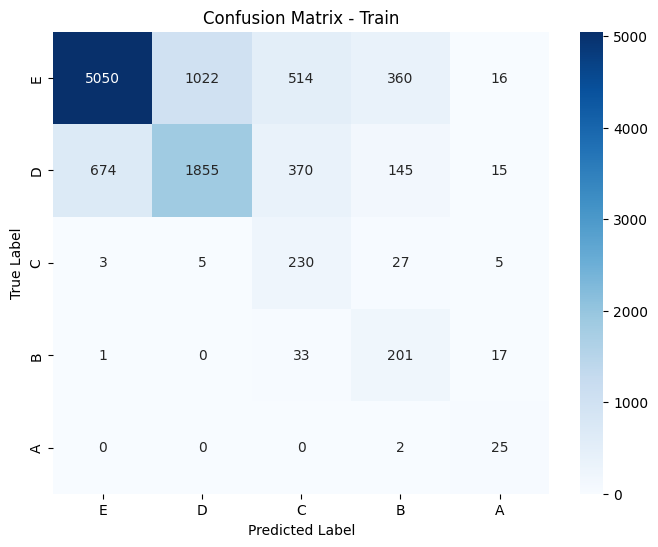

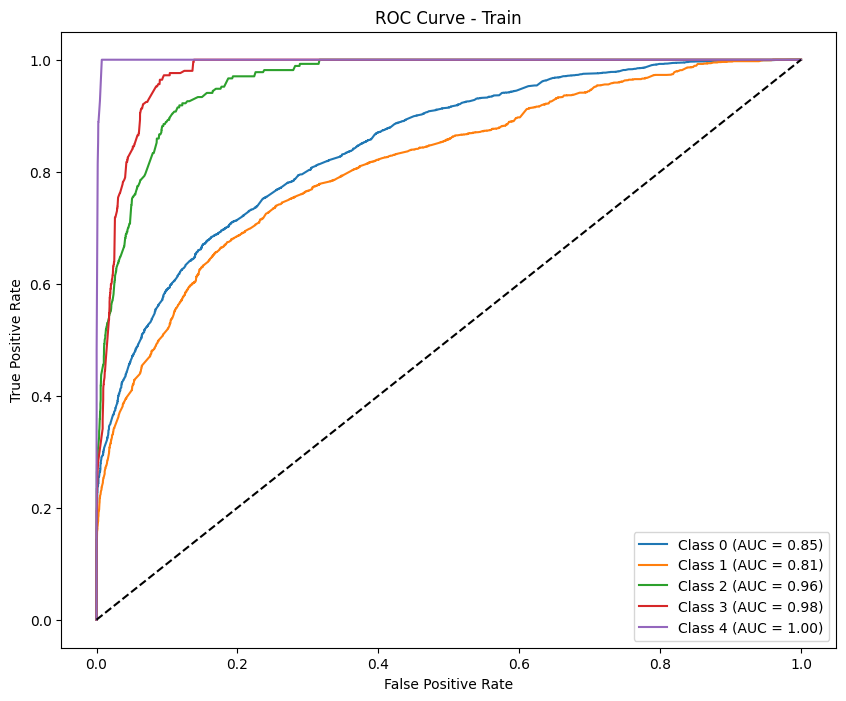

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90923318 0.4260355  0.         0.         0.        ]
Precision (per class): [0.8776435 0.48      0.        0.        0.       ]
Recall (per class): [0.94318182 0.38297872 0.         0.         0.        ]
Accuracy: 0.8161
AUC (One-vs-Rest): 0.7952

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.94      0.91       616
           D       0.48      0.38      0.43        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       756
   macro avg       0.27      0.27      0.27       756
weighted avg       0.77      0.82      0.79       756



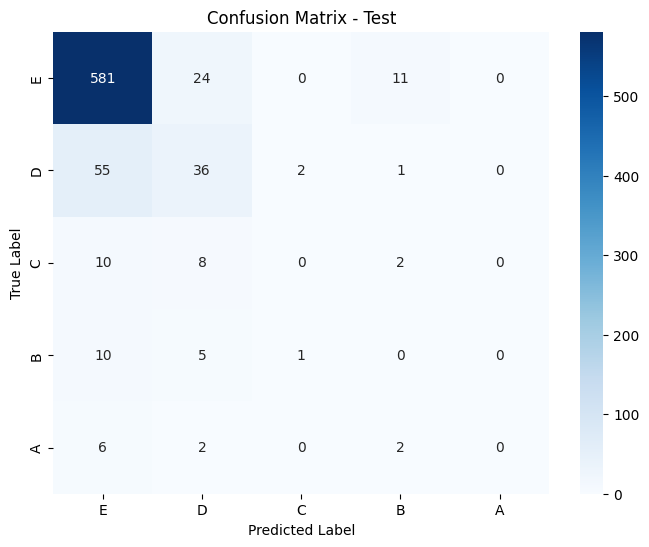

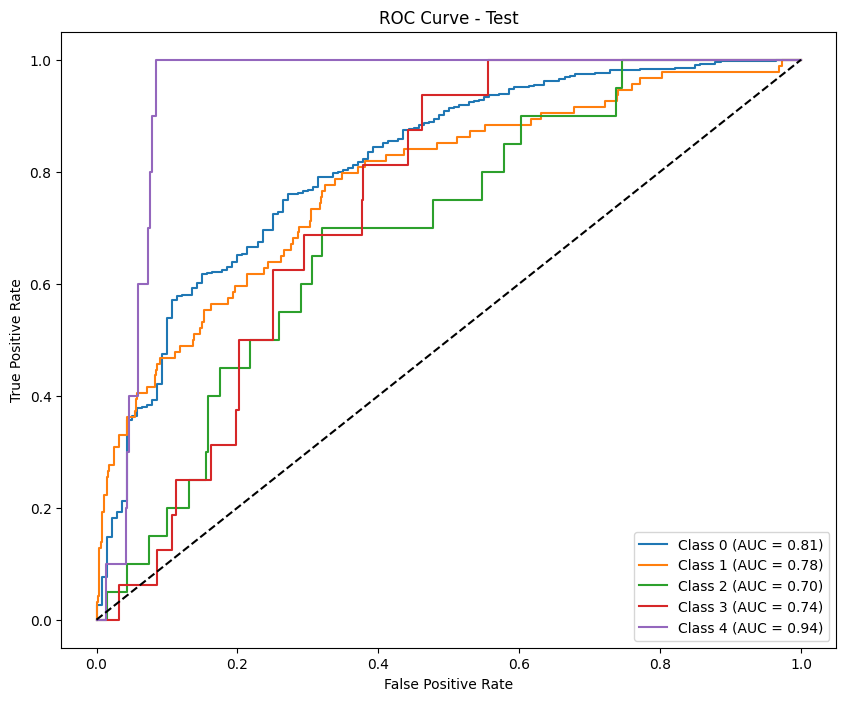

Results saved as test_results_calibrate_standard_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.84385871 0.59070885 0.50943396 0.49916805 0.65671642]
Precision (per class): [0.78975707 0.7622739  0.51923077 0.42979943 0.55      ]
Recall (per class): [0.90591784 0.48218372 0.5        0.5952381  0.81481481]
Accuracy: 0.7653
AUC (One-vs-Rest): 0.9284

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      6962
           D       0.76      0.48      0.59      3059
           C       0.52      0.50      0.51       270
           B       0.43      0.60      0.50       252
           A       0.55      0.81      0.66        27

    accuracy                           0.77     10570
   macro avg       0.61      0.66      0.62     10570
weighted avg       0.77      0.77      0.75     10570



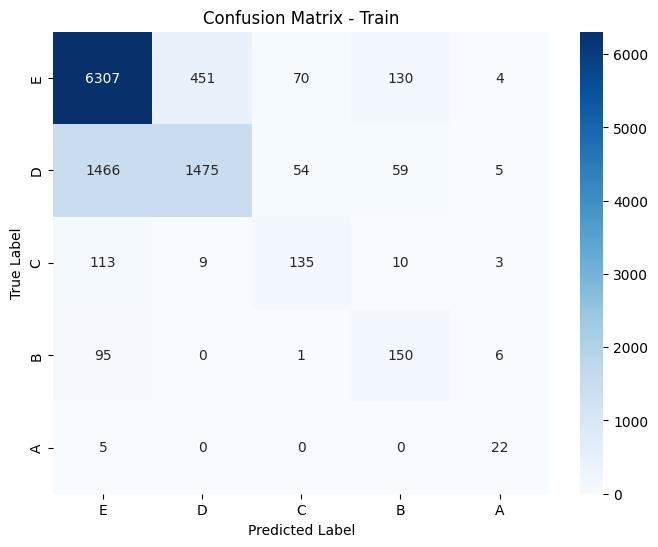

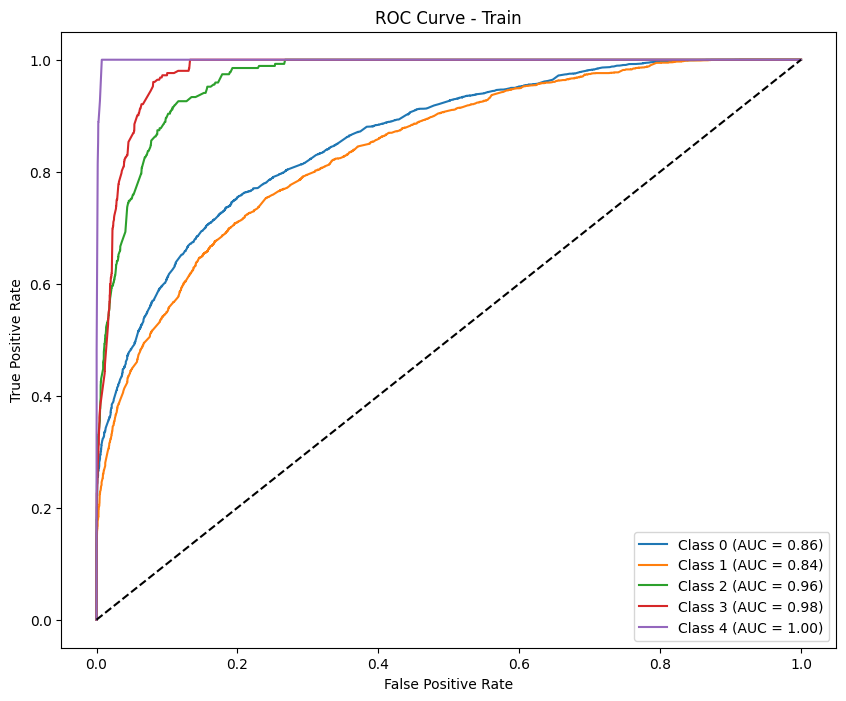

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91238671 0.39130435 0.         0.         0.        ]
Precision (per class): [0.85310734 0.61363636 0.         0.         0.        ]
Recall (per class): [0.98051948 0.28723404 0.         0.         0.        ]
Accuracy: 0.8347
AUC (One-vs-Rest): 0.7426

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.98      0.91       616
           D       0.61      0.29      0.39        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.83      0.79       756



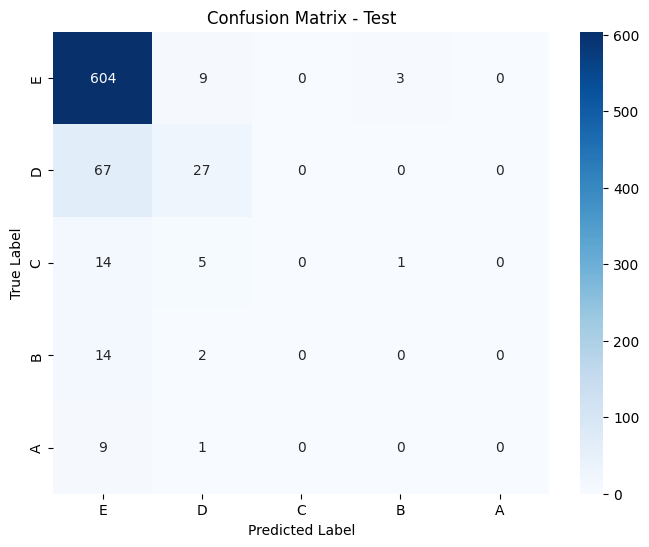

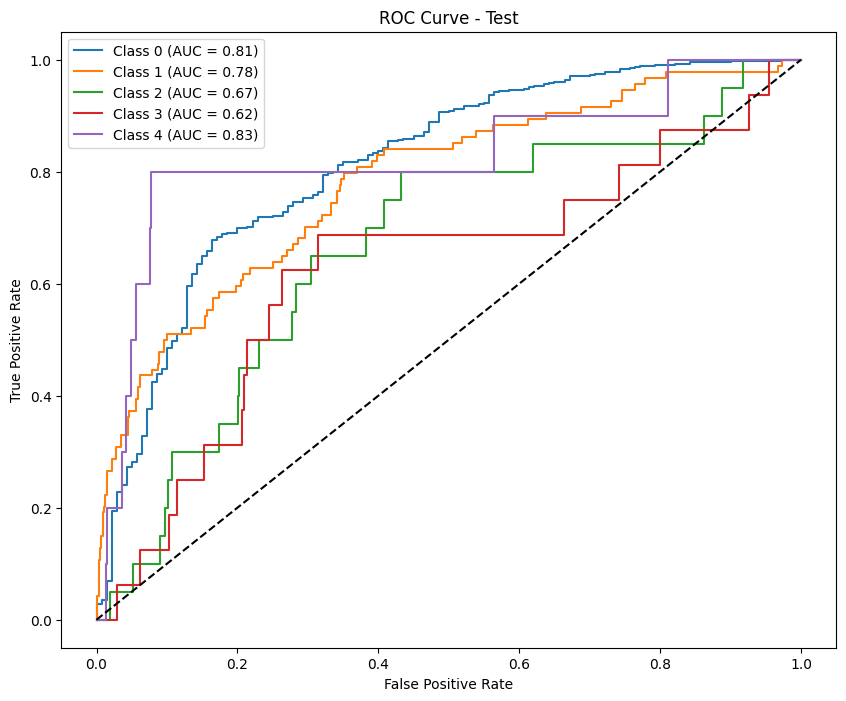


-------------Permutation Importance for phase: phase1---------


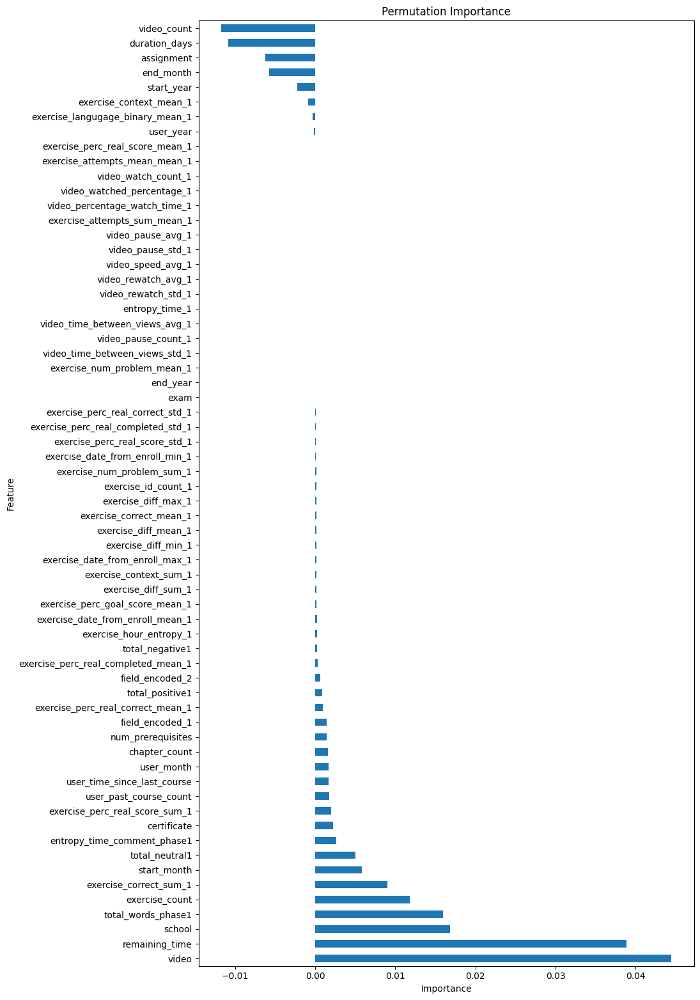

               Feature  Importance
17               video    0.044465
20      remaining_time    0.038895
0               school    0.016864
60  total_words_phase1    0.015989
10      exercise_count    0.011838
..                 ...         ...
3           start_year   -0.002259
6            end_month   -0.005747
16          assignment   -0.006232
19       duration_days   -0.010868
9          video_count   -0.011743

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


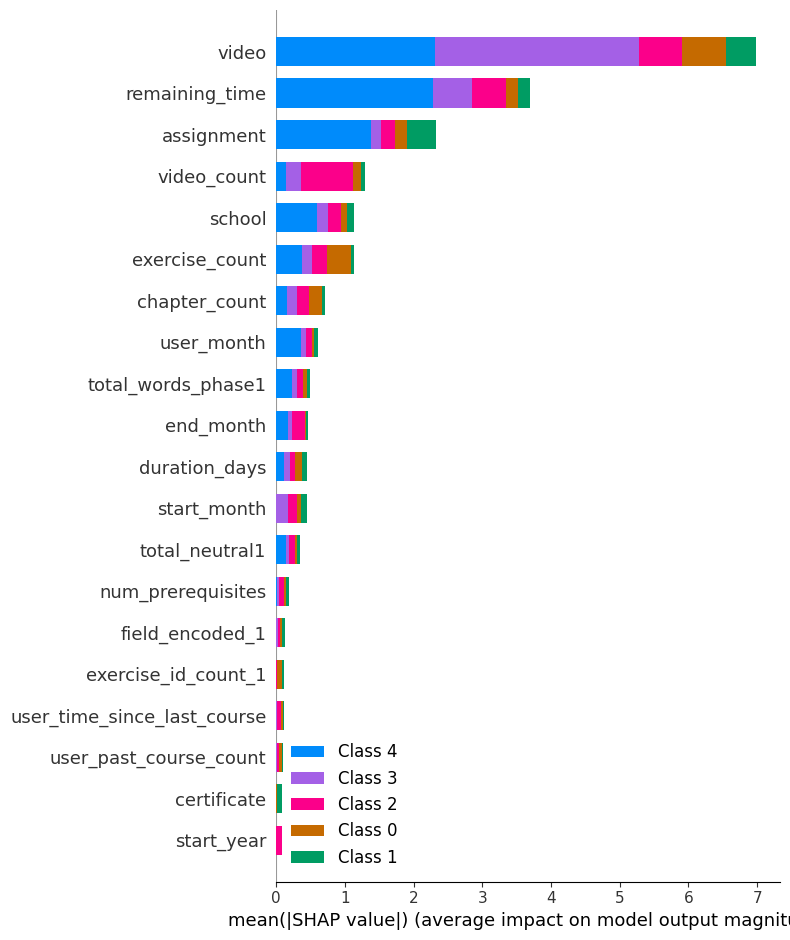


-----Lasso Feature Selection for phase: phase1----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8626378950229991, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.02200669836202, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0369075503499516, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.024488956595178, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.003649219412182, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6832867277062178, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8605425435234793, tolerance: 0.3884189

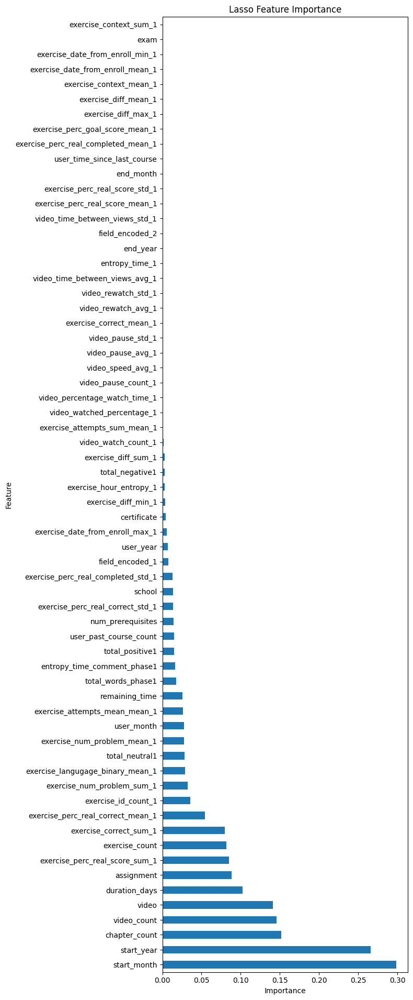

                             Feature  Importance
4                        start_month    0.298216
3                         start_year    0.265777
11                     chapter_count    0.151744
9                        video_count    0.145462
17                             video    0.141055
..                               ...         ...
33           exercise_context_mean_1    0.000000
30  exercise_date_from_enroll_mean_1    0.000000
29   exercise_date_from_enroll_min_1    0.000000
18                              exam    0.000000
32            exercise_context_sum_1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                              Feature  Importance
15                        certificate    0.247422
44     exercise_perc_real_score_sum_1    0.144429
22                exercise_id_count_1    0.047470
17                              video    0.039424
42  exercise_perc_real_correct_mean_1    0.030432


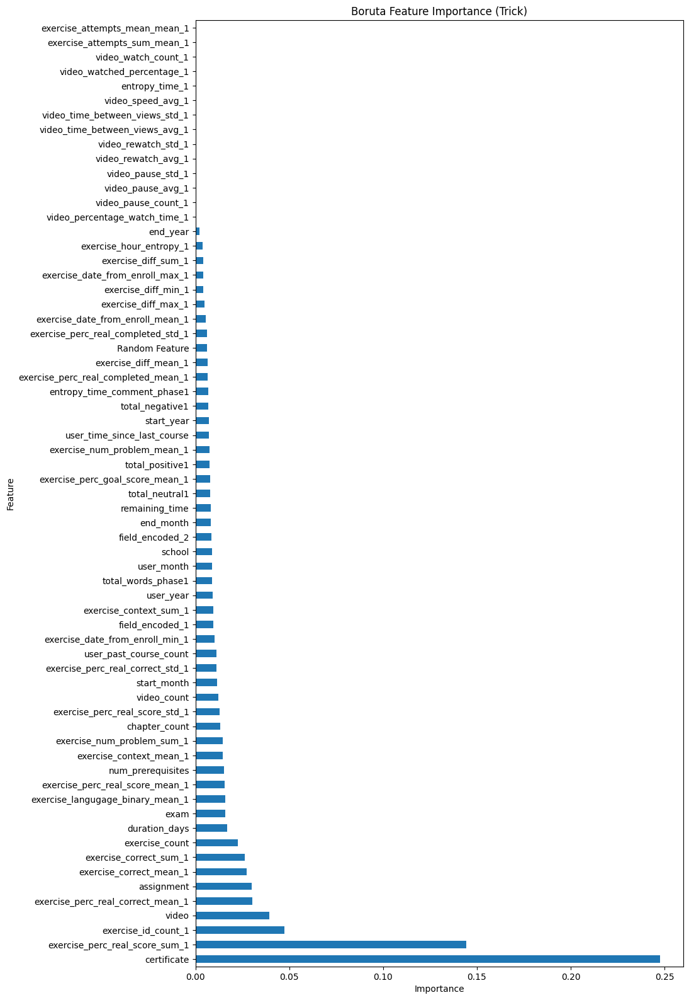

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Label: 0 --> Weight: 0.3042
Label: 1 --> Weight: 0.6998
Label: 2 --> Weight: 7.4330
Label: 3 --> Weight: 7.4330
Label: 4 --> Weight: 68.3840
Results saved as test_results_standard_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.78795015 0.60915999 0.34874759 0.43722944 0.62162162]
Precision (per class): [0.8783636  0.61129431 0.2240099  0.29106628 0.46938776]
Recall (per class): [0.71441281 0.60704052 0.78695652 0.87826087 0.92      ]
Accuracy: 0.6907
AUC (One-vs-Rest): 0.9134

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.71      0.79      5620
           D       0.61      0.61      0.61      2443
           C       0.22      0.79      0.35       230
           B     

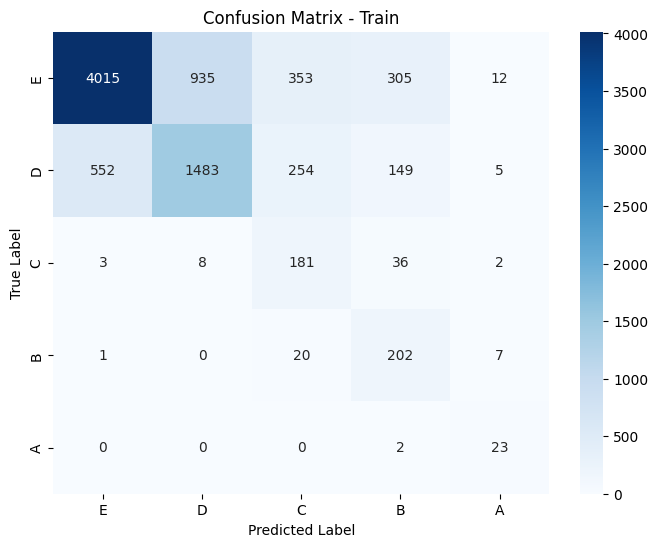

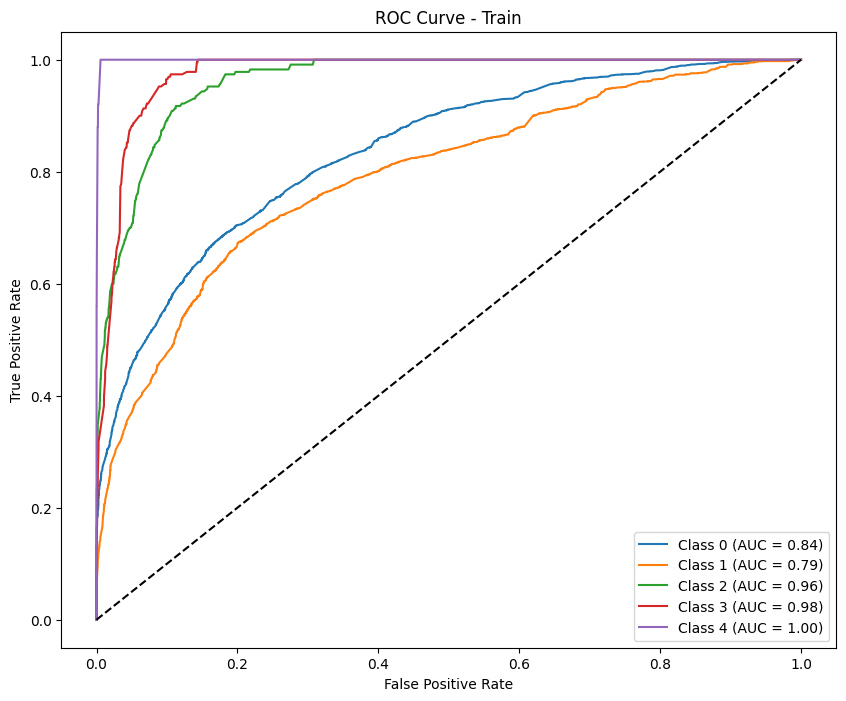


--- Test Metrics ---
F1 Score (per class): [0.8654311  0.26666667 0.         0.03076923 0.        ]
Precision (per class): [0.84968354 0.34482759 0.         0.02       0.        ]
Recall (per class): [0.8817734  0.2173913  0.         0.06666667 0.        ]
Accuracy: 0.7480
AUC (One-vs-Rest): 0.6801

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.88      0.87       609
           D       0.34      0.22      0.27        92
           C       0.00      0.00      0.00        20
           B       0.02      0.07      0.03        15
           A       0.00      0.00      0.00        10

    accuracy                           0.75       746
   macro avg       0.24      0.23      0.23       746
weighted avg       0.74      0.75      0.74       746



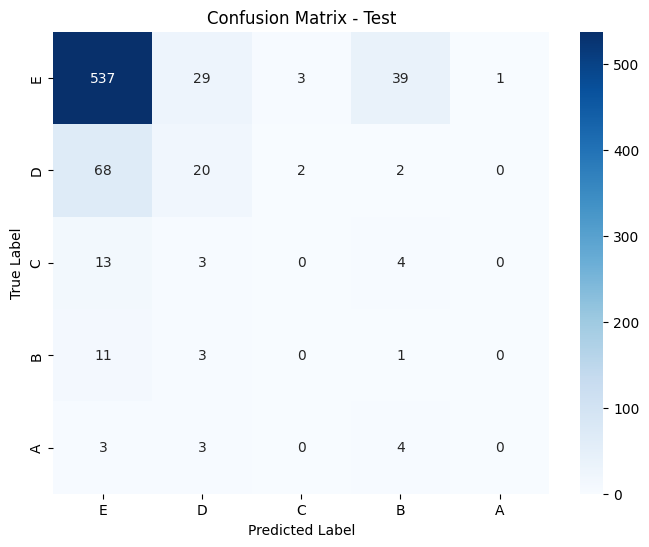

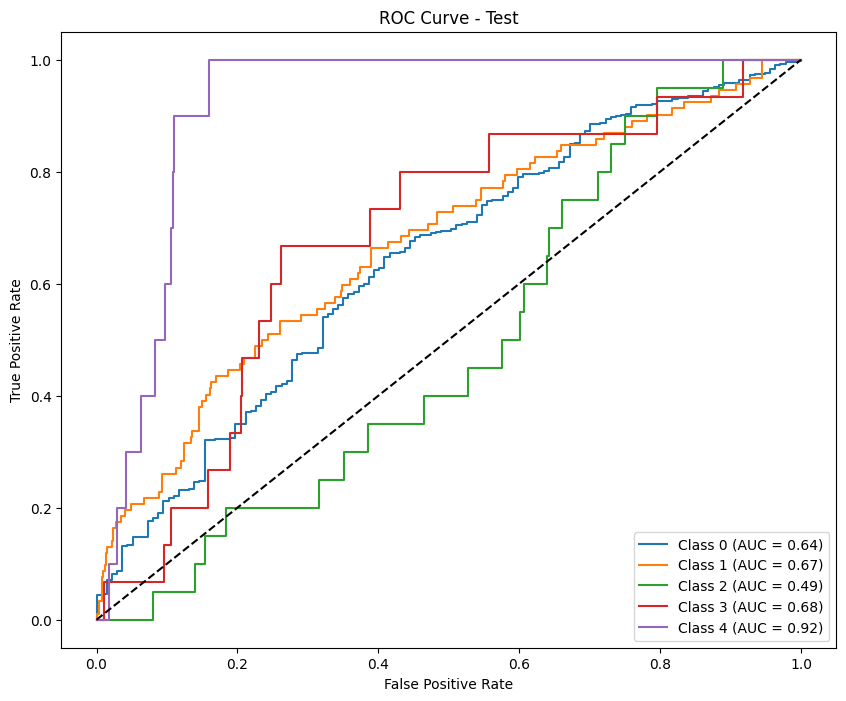

Results saved as test_results_calibrate_standard_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.83837797 0.56118036 0.52609603 0.5        0.68656716]
Precision (per class): [0.78505979 0.74126344 0.5060241  0.42424242 0.54761905]
Recall (per class): [0.89946619 0.45149406 0.54782609 0.60869565 0.92      ]
Accuracy: 0.7542
AUC (One-vs-Rest): 0.9230

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      5620
           D       0.74      0.45      0.56      2443
           C       0.51      0.55      0.53       230
           B       0.42      0.61      0.50       230
           A       0.55      0.92      0.69        25

    accuracy                           0.75      8548
   macro avg       0.60      0.69      0.62      8548
weighted avg       0.75      0.75      0.74      8548



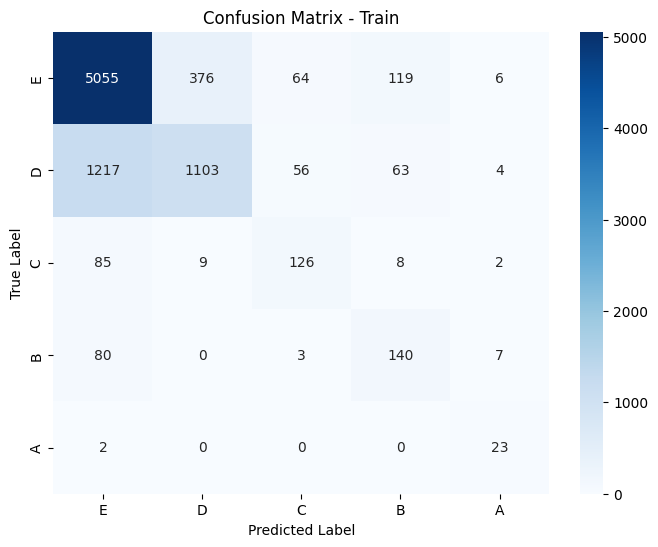

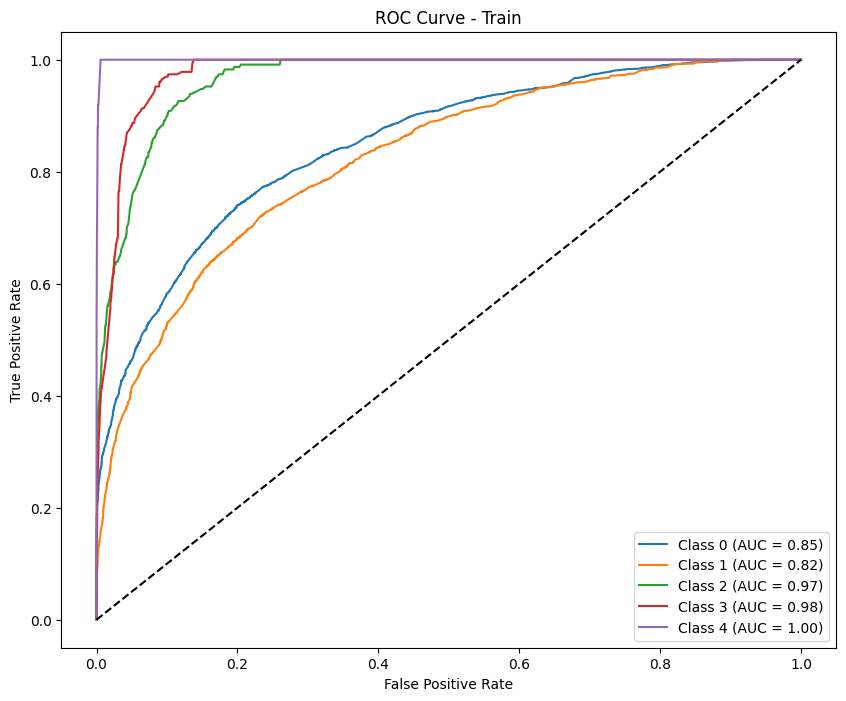

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.892261   0.17699115 0.         0.06451613 0.        ]
Precision (per class): [0.82933709 0.47619048 0.         0.0625     0.        ]
Recall (per class): [0.96551724 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.8029
AUC (One-vs-Rest): 0.6680

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       609
           D       0.48      0.11      0.18        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.80       746
   macro avg       0.27      0.23      0.23       746
weighted avg       0.74      0.80      0.75       746



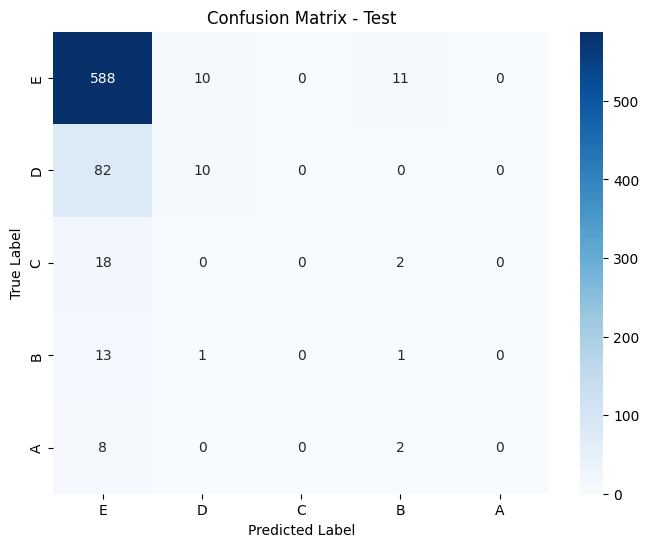

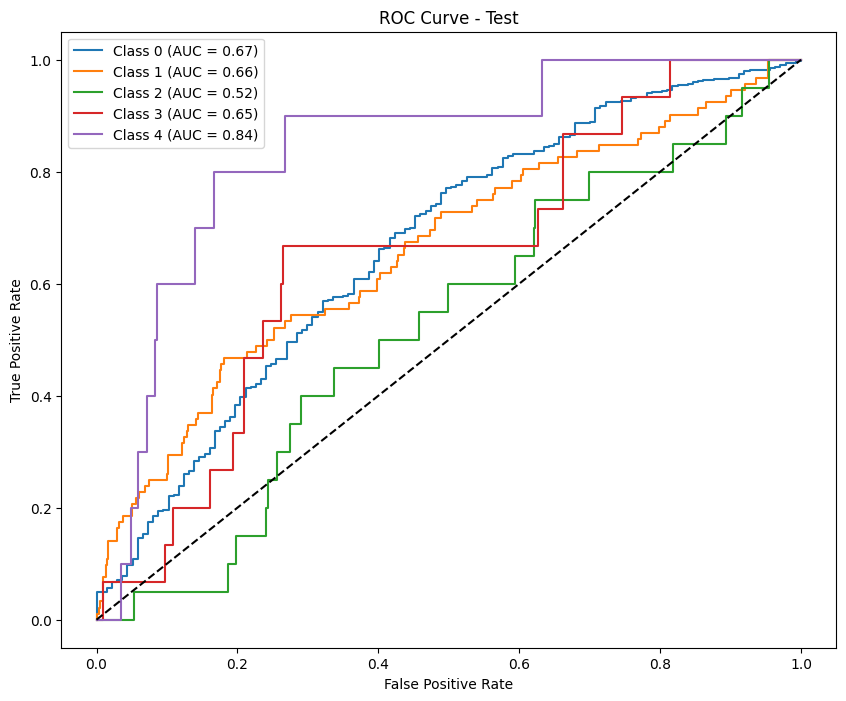


-------------Permutation Importance for phase: phase2---------


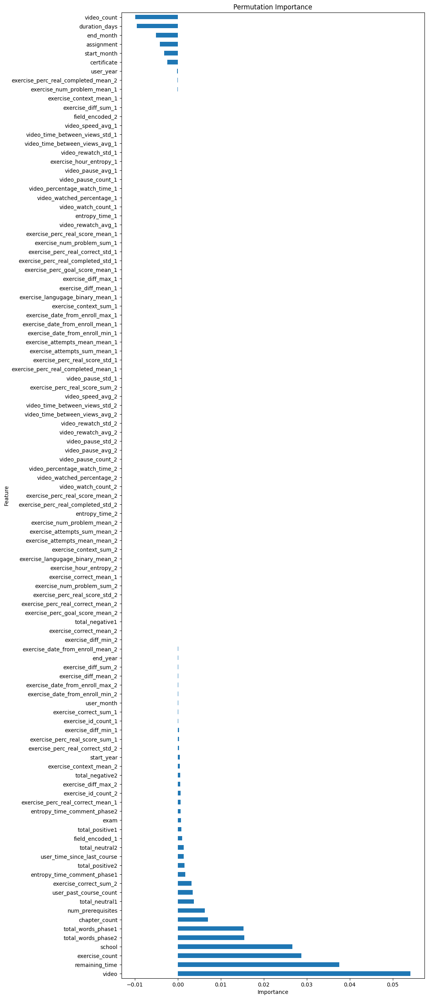

                Feature  Importance
17                video    0.054165
20       remaining_time    0.037597
10       exercise_count    0.028793
0                school    0.026658
103  total_words_phase2    0.015428
..                  ...         ...
4           start_month   -0.003203
16           assignment   -0.004182
6             end_month   -0.005104
19        duration_days   -0.009564
9           video_count   -0.009944

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


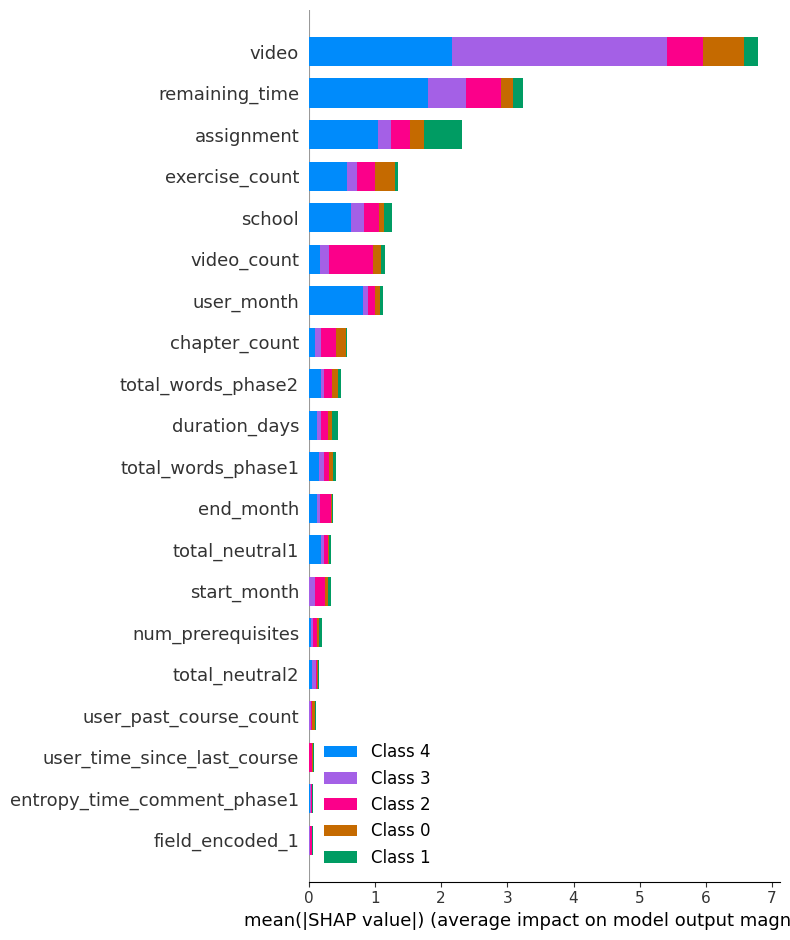


-----Lasso Feature Selection for phase: phase2----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.3597667214316971, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6821299359539807, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.201722082807464, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3476406713102733, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3783970504987337, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.374100164403899, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.357610336191101, tolerance: 0.328028

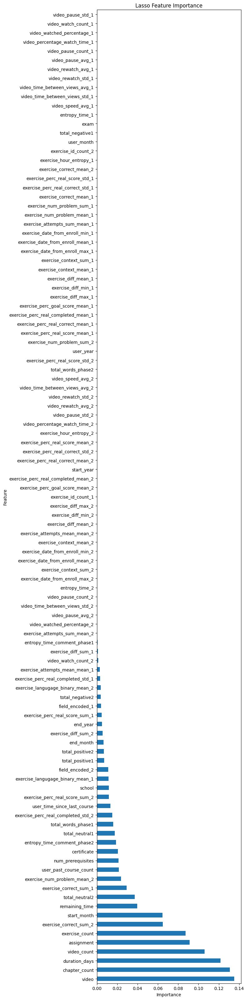

                          Feature  Importance
17                          video    0.135128
11                  chapter_count    0.130991
19                  duration_days    0.121659
9                     video_count    0.105890
16                     assignment    0.091239
..                            ...         ...
51            video_pause_count_1    0.000000
50  video_percentage_watch_time_1    0.000000
49     video_watched_percentage_1    0.000000
48            video_watch_count_1    0.000000
53              video_pause_std_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                                Feature  Importance
15                          certificate    0.137254
17                                video    0.043240
16                           assignment    0.030775
66               exercise_correct_sum_2    0.030586
40  exercise_perc_real_completed_mean_1    0.030406
..                     

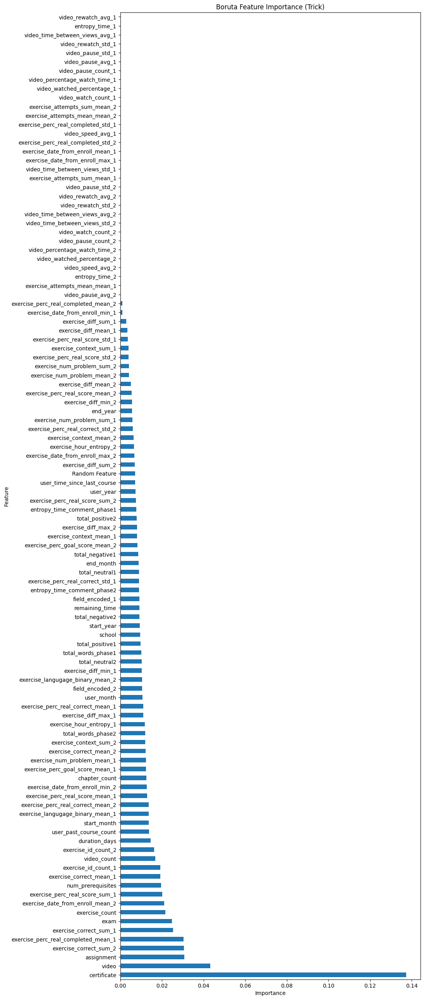

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Label: 0 --> Weight: 0.3046
Label: 1 --> Weight: 0.6905
Label: 2 --> Weight: 8.0860
Label: 3 --> Weight: 7.5391
Label: 4 --> Weight: 82.1368
Results saved as test_results_standard_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.79982973 0.62068966 0.35227273 0.41388175 0.44705882]
Precision (per class): [0.87947578 0.62828649 0.22561863 0.28196147 0.28787879]
Recall (per class): [0.7334114  0.61327434 0.80310881 0.77777778 1.        ]
Accuracy: 0.7022
AUC (One-vs-Rest): 0.9196

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.73      0.80      5124
           D       0.63      0.61      0.62      2260
           C       0.23      0.80      0.35       193
           B     

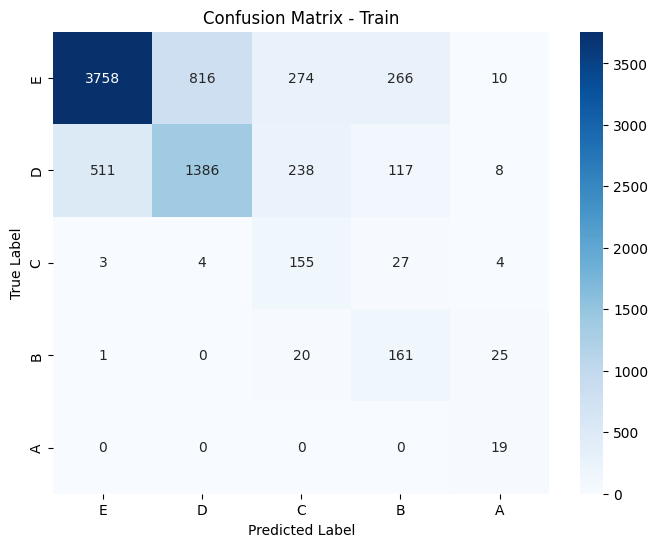

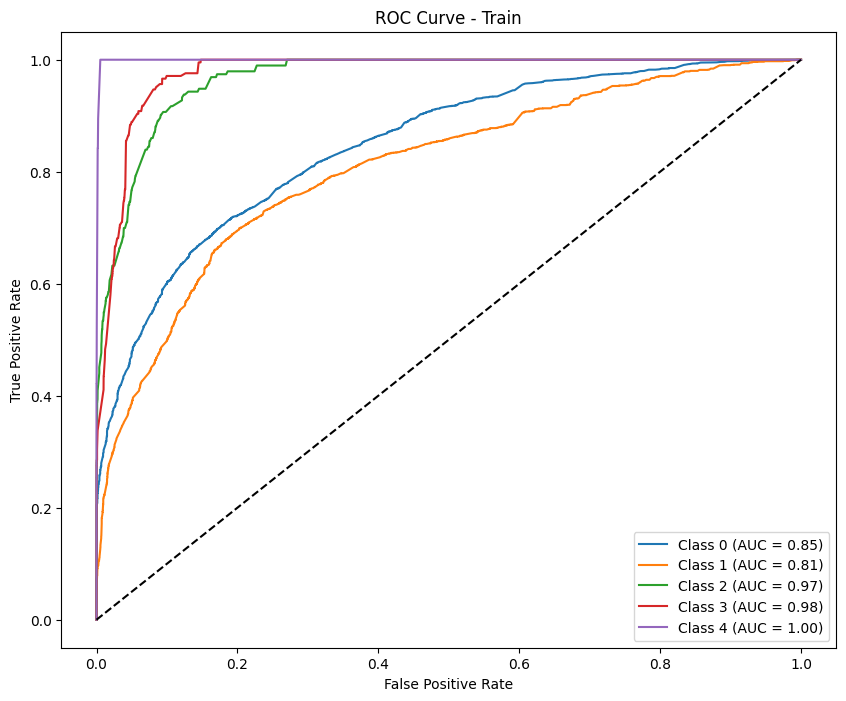

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.78144514 0.15957447 0.         0.04255319 0.        ]
Precision (per class): [0.8217636  0.14851485 0.         0.02564103 0.        ]
Recall (per class): [0.74489796 0.17241379 0.         0.125      0.        ]
Accuracy: 0.6311
AUC (One-vs-Rest): 0.6195

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.74      0.78       588
           D       0.15      0.17      0.16        87
           C       0.00      0.00      0.00        20
           B       0.03      0.12      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.63       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.63      0.66       721



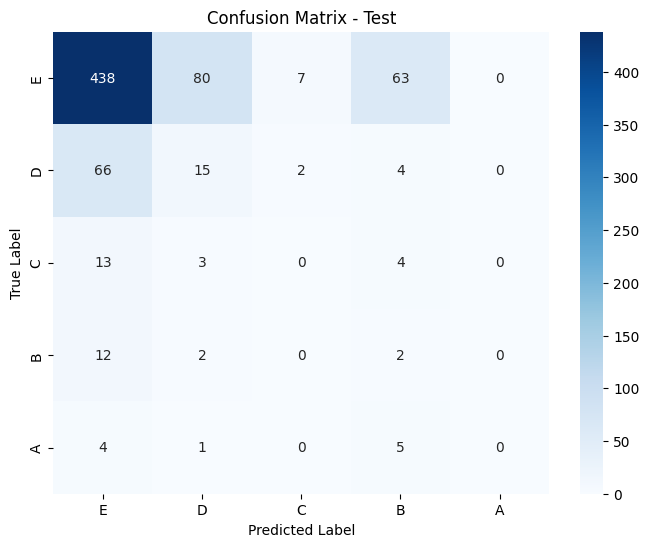

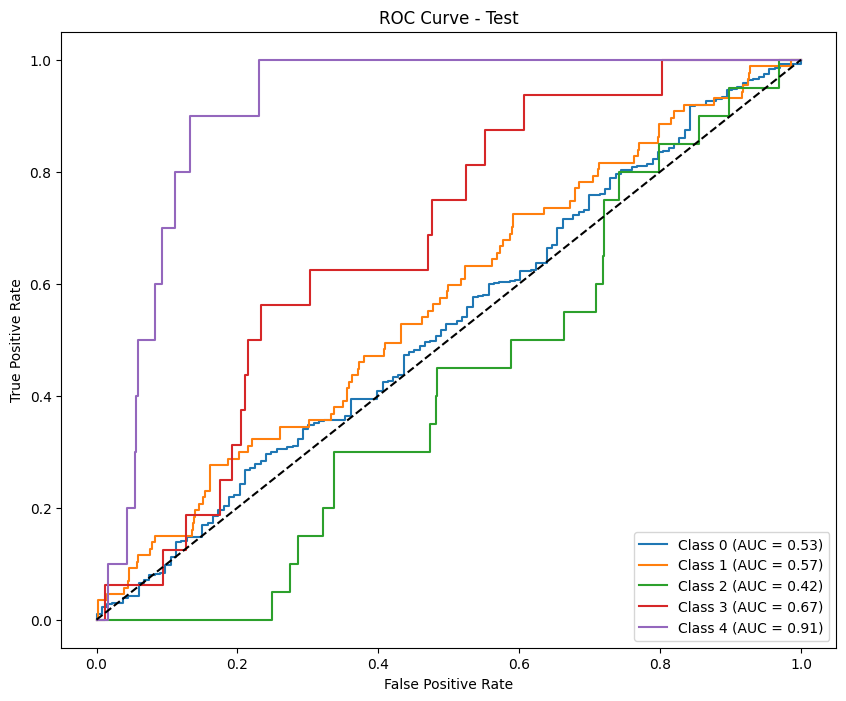

Results saved as test_results_calibrate_standard_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.83941269 0.59465128 0.54320988 0.51881188 0.64150943]
Precision (per class): [0.79666959 0.72972973 0.51886792 0.43959732 0.5       ]
Recall (per class): [0.88700234 0.50176991 0.56994819 0.63285024 0.89473684]
Accuracy: 0.7609
AUC (One-vs-Rest): 0.9287

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.73      0.50      0.59      2260
           C       0.52      0.57      0.54       193
           B       0.44      0.63      0.52       207
           A       0.50      0.89      0.64        19

    accuracy                           0.76      7803
   macro avg       0.60      0.70      0.63      7803
weighted avg       0.76      0.76      0.75      7803



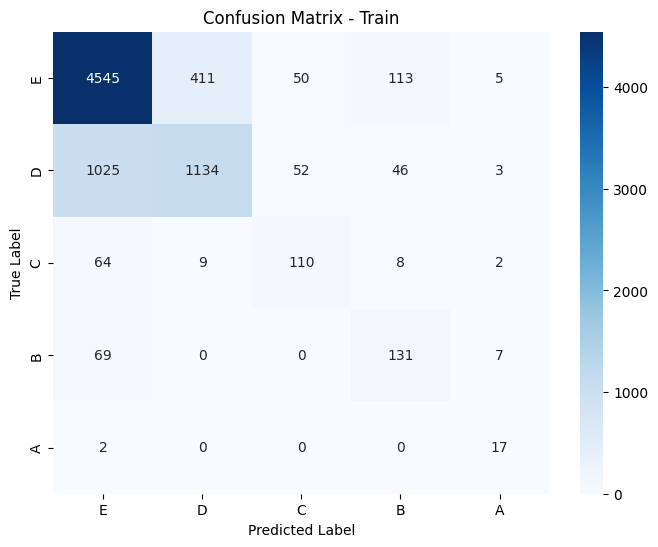

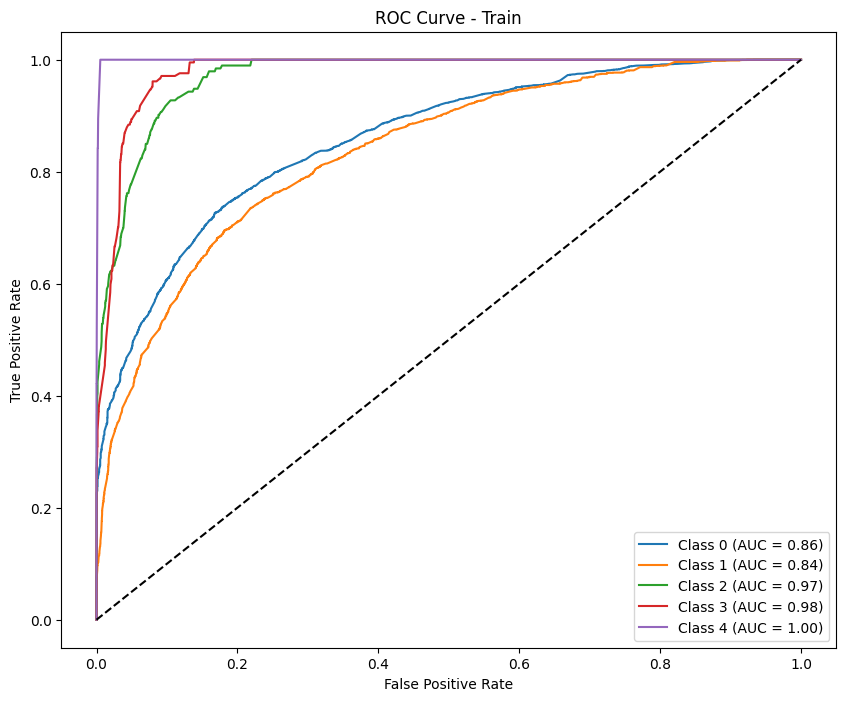

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.86977492 0.09677419 0.         0.04545455 0.        ]
Precision (per class): [0.82469512 0.16216216 0.         0.03571429 0.        ]
Recall (per class): [0.92006803 0.06896552 0.         0.0625     0.        ]
Accuracy: 0.7601
AUC (One-vs-Rest): 0.6057

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.92      0.87       588
           D       0.16      0.07      0.10        87
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.76       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.76      0.72       721



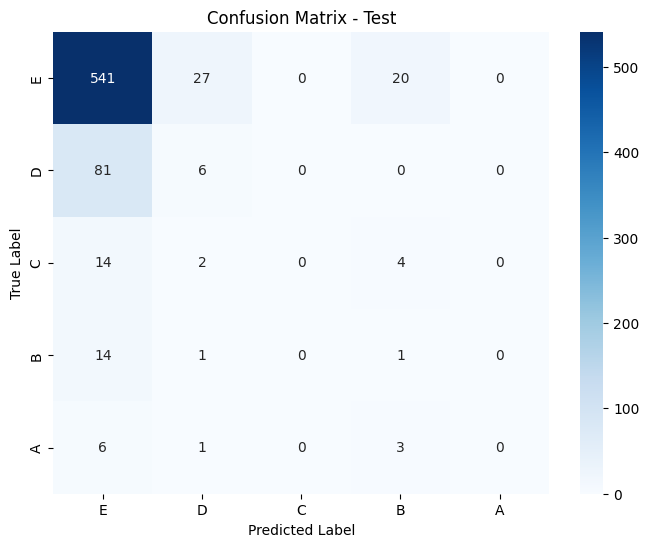

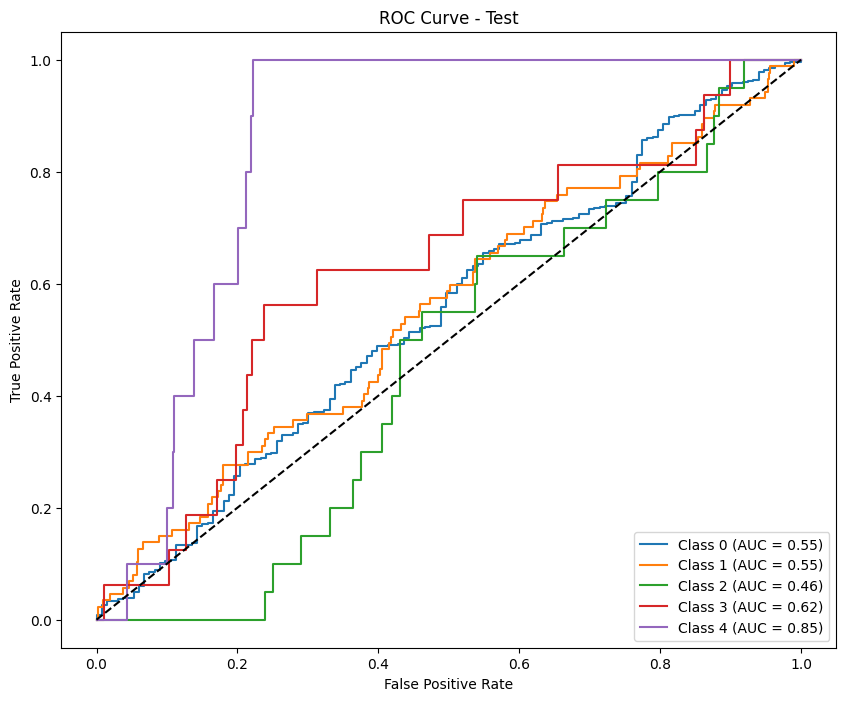

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Label: 0 --> Weight: 0.3058
Label: 1 --> Weight: 0.6780
Label: 2 --> Weight: 10.6198
Label: 3 --> Weight: 6.7459
Label: 4 --> Weight: 76.6143
Results saved as test_results_standard_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.81762546 0.66413662 0.37826087 0.52571429 0.65116279]
Precision (per class): [0.88213932 0.66455696 0.24233983 0.37704918 0.48275862]
Recall (per class): [0.76190476 0.66371681 0.86138614 0.86792453 1.        ]
Accuracy: 0.7386
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.76      0.82      3507
           D       0.66      0.66      0.66      1582
           C       0.24      0.86      0.38       101
           B    

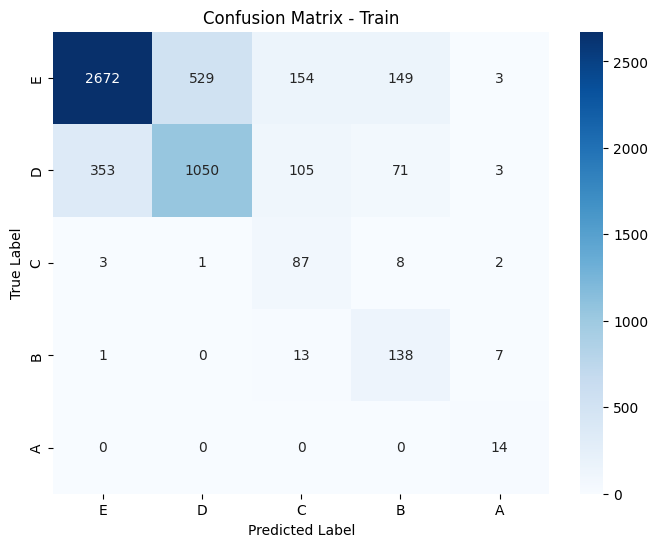

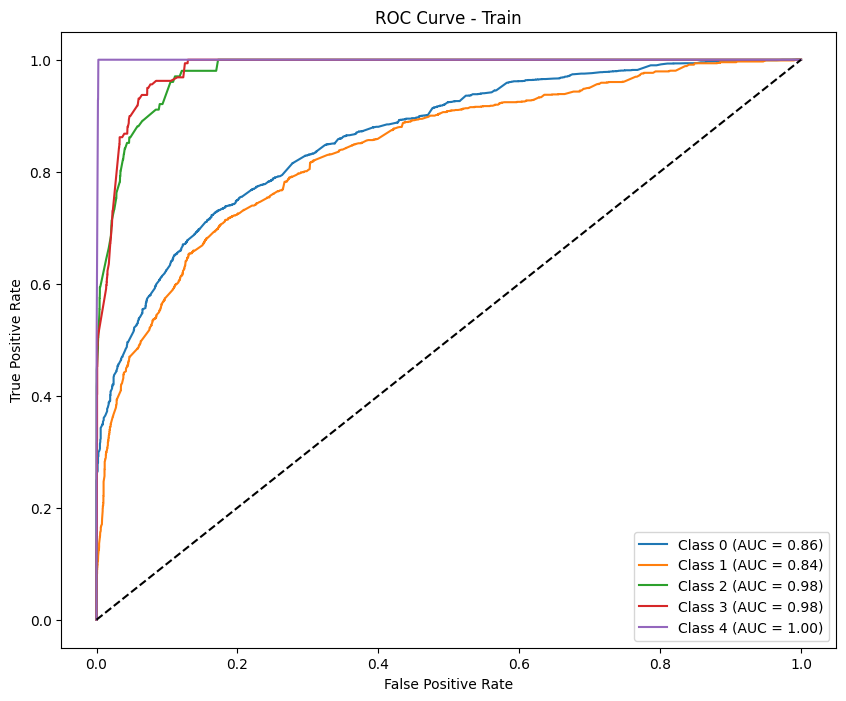

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.75894539 0.11299435 0.         0.04040404 0.        ]
Precision (per class): [0.79487179 0.10869565 0.         0.02469136 0.        ]
Recall (per class): [0.72612613 0.11764706 0.         0.11111111 0.        ]
Accuracy: 0.6041
AUC (One-vs-Rest): 0.5454

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.73      0.76       555
           D       0.11      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.02      0.11      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.60       687
   macro avg       0.19      0.19      0.18       687
weighted avg       0.66      0.60      0.63       687



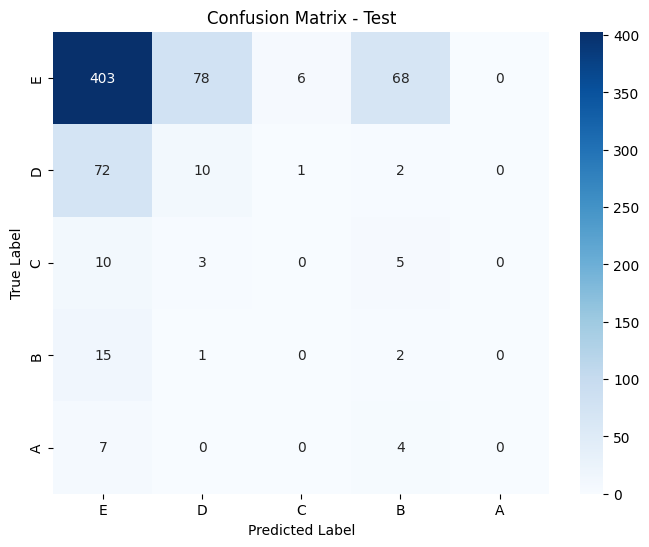

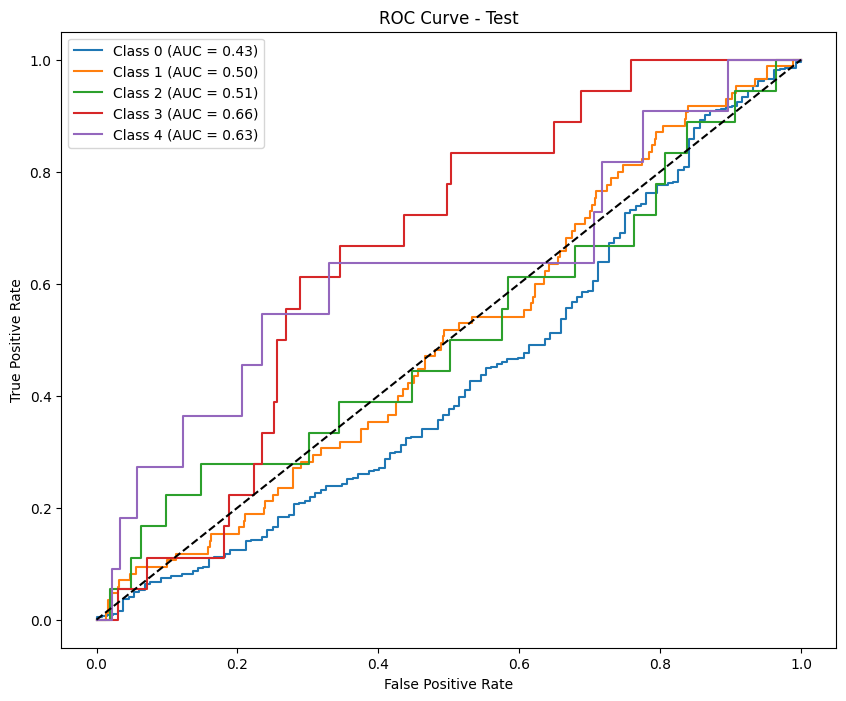

Results saved as test_results_calibrate_standard_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.8556179  0.63727306 0.59907834 0.59002169 0.66666667]
Precision (per class): [0.82263158 0.76991943 0.56034483 0.45033113 0.5       ]
Recall (per class): [0.89136014 0.54361568 0.64356436 0.85534591 1.        ]
Accuracy: 0.7833
AUC (One-vs-Rest): 0.9400

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.89      0.86      3507
           D       0.77      0.54      0.64      1582
           C       0.56      0.64      0.60       101
           B       0.45      0.86      0.59       159
           A       0.50      1.00      0.67        14

    accuracy                           0.78      5363
   macro avg       0.62      0.79      0.67      5363
weighted avg       0.79      0.78      0.78      5363



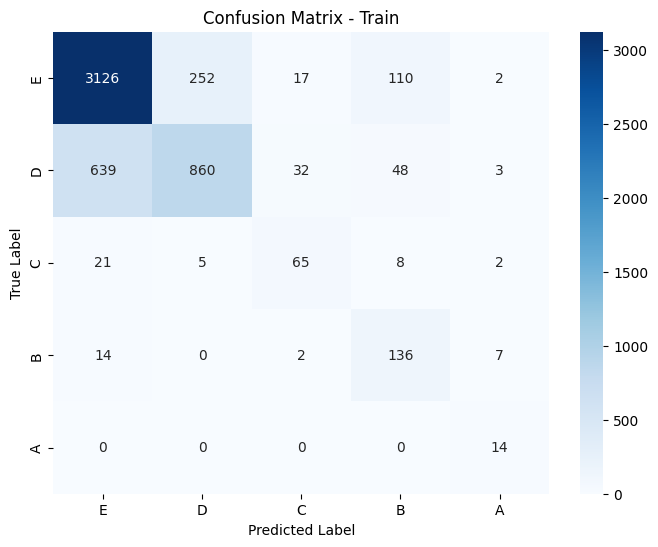

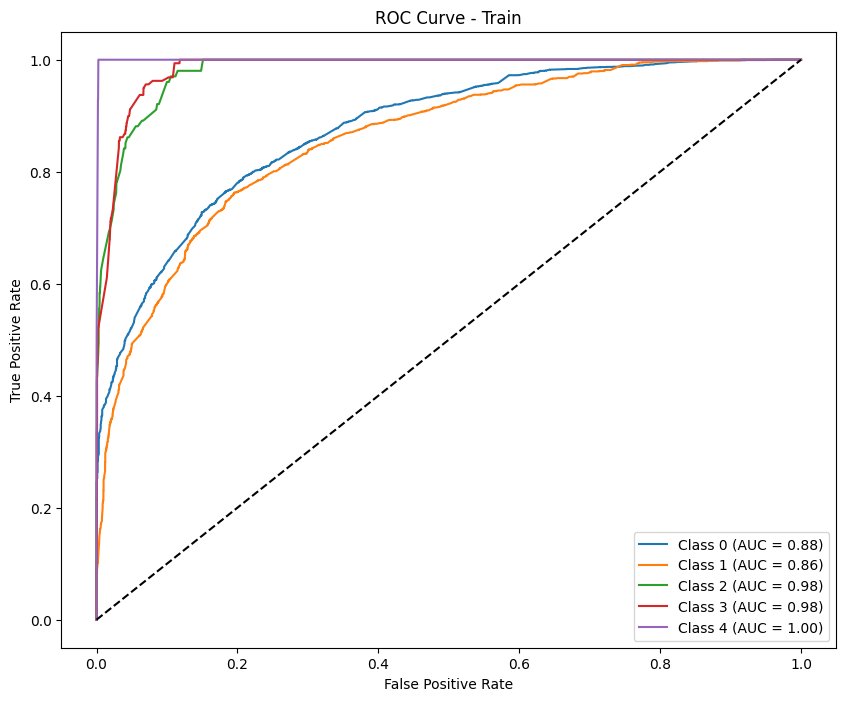

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.85884354 0.1        0.         0.04166667 0.        ]
Precision (per class): [0.81320451 0.17142857 0.         0.03333333 0.        ]
Recall (per class): [0.90990991 0.07058824 0.         0.05555556 0.        ]
Accuracy: 0.7453
AUC (One-vs-Rest): 0.5810

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.91      0.86       555
           D       0.17      0.07      0.10        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.75       687
   macro avg       0.20      0.21      0.20       687
weighted avg       0.68      0.75      0.71       687



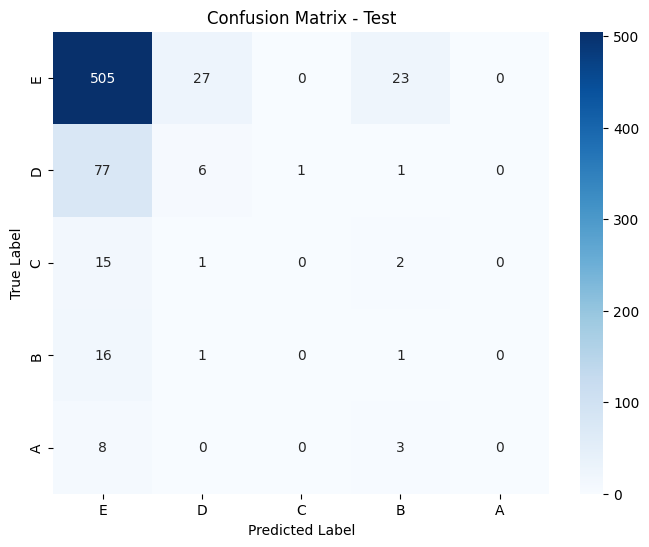

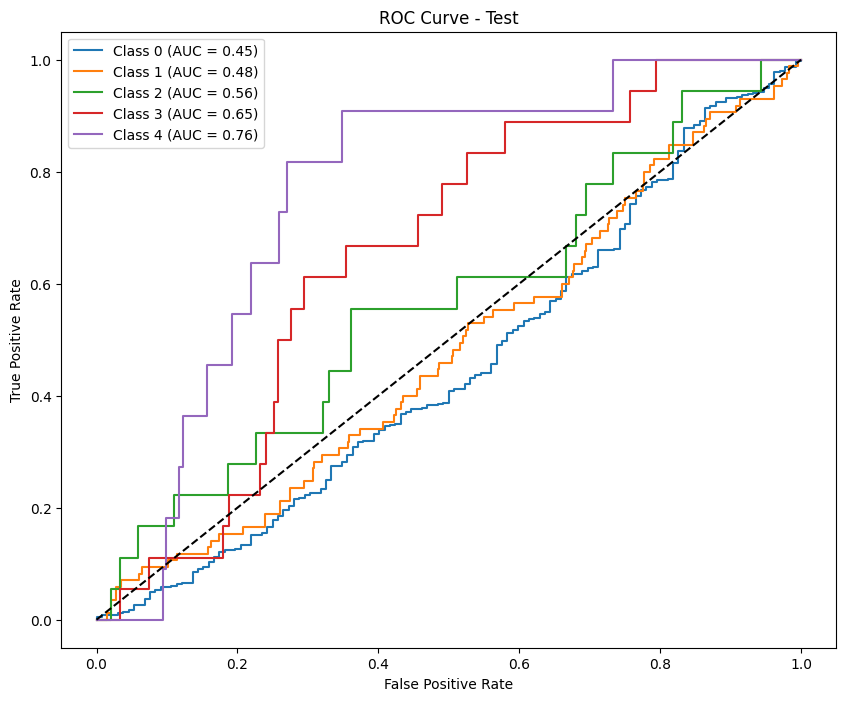

In [11]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro')

## Xử lý imbalance

### Phân phối các nhãn

In [12]:
# Đọc dữ liệu
def plot_label(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")

    # Đếm số lượng mỗi class
    value_counts = y_train.value_counts()
    print(value_counts)
    
    # Vẽ biểu đồ
    value_counts.plot(kind='bar', figsize=(8, 6), color='skyblue', edgecolor='black')
    
    # Thêm tiêu đề và nhãn trục
    plt.title(f"Distribution of y_train labels in {phase}")
    plt.xlabel("Class")
    plt.ylabel("Count")
    
    # Hiển thị
    plt.show()
    
    return X_train, y_train, X_test, y_test

label_encoded
0    6962
1    3059
2     270
3     252
4      27
Name: count, dtype: int64


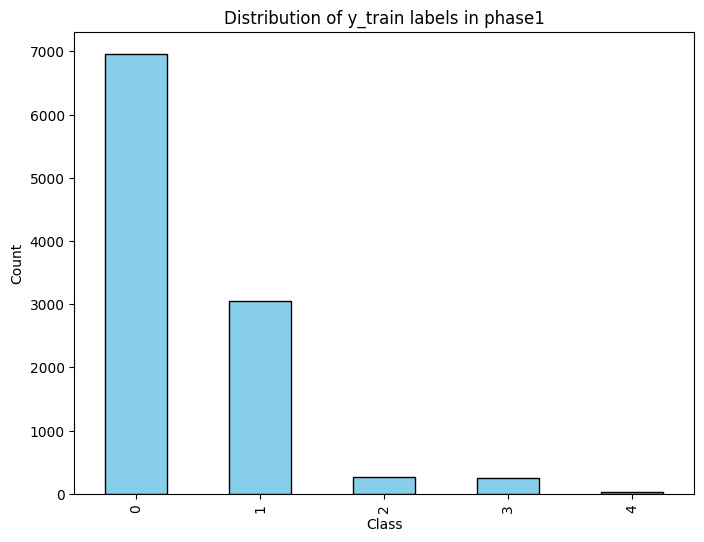

label_encoded
0    5620
1    2443
2     230
3     230
4      25
Name: count, dtype: int64


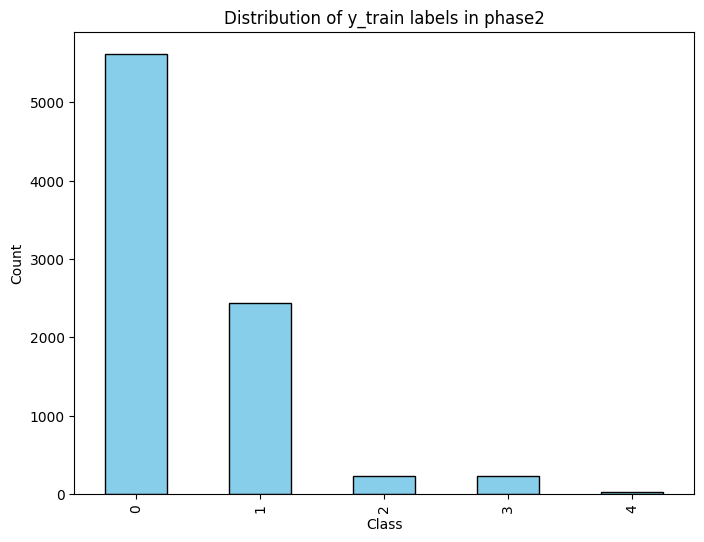

label_encoded
0    5124
1    2260
3     207
2     193
4      19
Name: count, dtype: int64


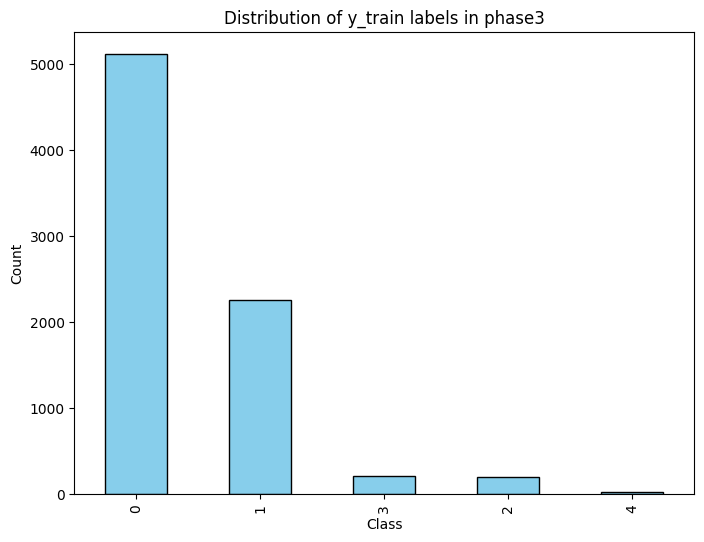

label_encoded
0    3507
1    1582
3     159
2     101
4      14
Name: count, dtype: int64


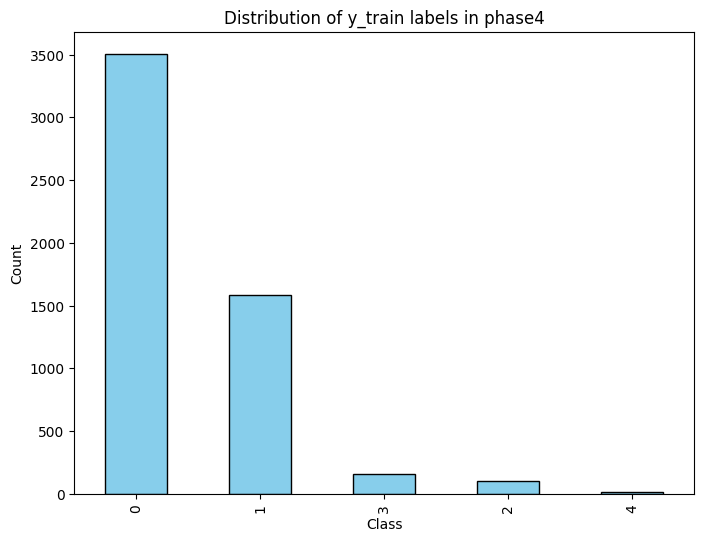

In [13]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    plot_label(phase)

### Undersampling

In [14]:
import pandas as pd

def manual_custom_undersample_decrease(X, y, class_decrease_counts):
    """
    Undersample bằng cách giảm bớt một số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_decrease_counts (dict): Dict {class_label: decrease_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau undersample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        if cls in class_decrease_counts:
            decrease_count = class_decrease_counts[cls]
            target_count = max(len(df_cls) - decrease_count, 1)  # Đảm bảo ít nhất còn 1 mẫu
            if len(df_cls) > target_count:
                df_cls = df_cls.sample(n=target_count, random_state=42)
        # Nếu class không cần giảm thì giữ nguyên
        resampled_parts.append(df_cls)

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [15]:
# Đọc và xử lý dữ liệu cho từng phase
def process_undersample_phase(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Undersampling
    cls_count = {
        0: 2000,
        1: 1000,
        2: 0,
        3: 0,
        4: 0
    }
    X_train, y_train = manual_custom_undersample_decrease(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
    # Thiết lập StratifiedKFold
    # skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # # Định nghĩa mô hình XGBoost
    # model = XGBClassifier(random_state=42)
    
    # Định nghĩa các tham số cần tìm kiếm (cho GridSearchCV hoặc RandomizedSearchCV)
    # param_grid = {
    #     'max_depth': [7, 9],
    #     'learning_rate': [0.02, 0.1],
    #     'n_estimators': [200],
    #     'subsample': [0.7, 0.8],
    #     'colsample_bytree': [0.7, 0.8, 0.9]
    # }
    
    # Sử dụng GridSearchCV hoặc RandomizedSearchCV
    # GridSearchCV: Thử tất cả các kết hợp tham số
    # grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=skf, scoring='accuracy', n_jobs=-1)
    
    # RandomizedSearchCV: Thử ngẫu nhiên một số lượng tham số
    # randomized_search = RandomizedSearchCV(
    #     estimator=model,
    #     param_distributions=param_grid,
    #     n_iter=35,
    #     cv=skf,
    #     scoring=metric,
    #     random_state=42,
    #     n_jobs=-1,
    #     verbose=2 
    # )
    
    # # Huấn luyện mô hình với RandomizedSearchCV
    # randomized_search.fit(X_train_scaled, y_train)
    
    # # In ra tham số tốt nhất
    # print(f"Best Parameters for phase {phase}: {randomized_search.best_params_}")
    # best_params = randomized_search.best_params_

    # # Dự đoán trên tập test
    # y_pred = randomized_search.best_estimator_.predict(X_test_scaled)
    
    sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

    # Huấn luyện mô hình
    model = XGBClassifier(
        subsample=  0.8, 
        n_estimators = 400, 
        min_child_weight = 3, 
        max_depth = 6, 
        learning_rate = 0.05,
        gamma = 0,
        colsample_bytree = 1.0,
        random_state=42,
        use_label_encoder=False,
        eval_metric='mlogloss'
    )
    model.fit(X_train_scaled, y_train, sample_weight=sample_weights)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)
    
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Tính toán calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    # Dự đoán trên tập test
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_calibrate_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    
    # Chọn feature yếu
    if int(phase[-1]) <=2:
        print(f"\nPermutation Importance for phase: {phase}")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
    
        # Lasso Regression cho chọn feature
        print(f"\nLasso Feature Selection for phase: {phase}")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print("\nBoruta Trick:")
        important_features = boruta_trick(model, X_train_scaled, y_train)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

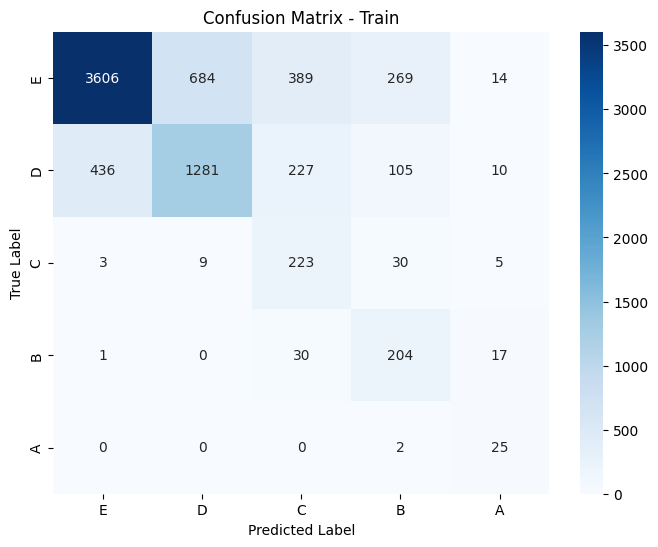

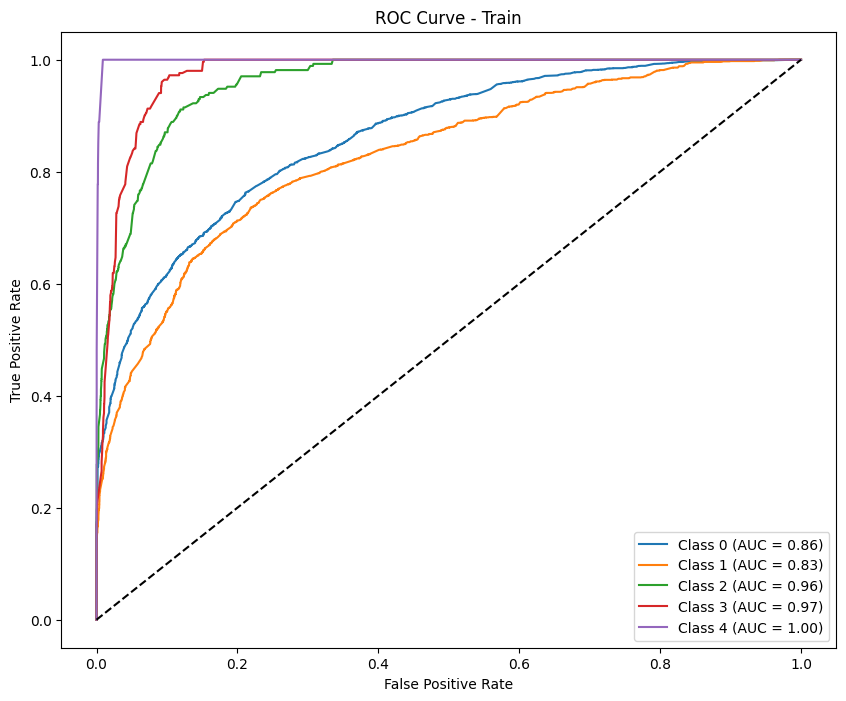

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90793651 0.46242775 0.         0.04761905 0.        ]
Precision (per class): [0.88819876 0.50632911 0.         0.03846154 0.        ]
Recall (per class): [0.92857143 0.42553191 0.         0.0625     0.        ]
Accuracy: 0.8108
AUC (One-vs-Rest): 0.7881

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.93      0.91       616
           D       0.51      0.43      0.46        94
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       756
   macro avg       0.29      0.28      0.28       756
weighted avg       0.79      0.81      0.80       756



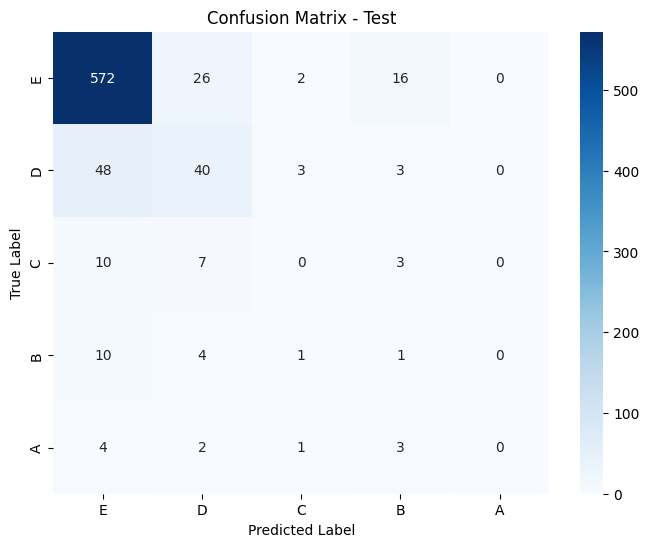

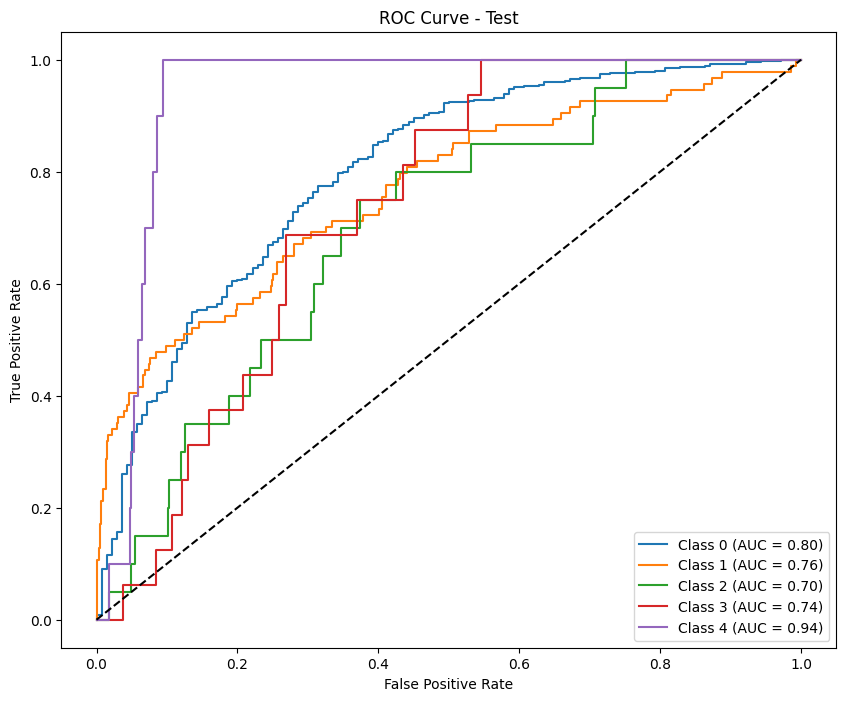

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.8470722  0.60527859 0.54478976 0.54609929 0.67692308]
Precision (per class): [0.79935622 0.76387861 0.53790614 0.49358974 0.57894737]
Recall (per class): [0.90084643 0.50121418 0.55185185 0.61111111 0.81481481]
Accuracy: 0.7697
AUC (One-vs-Rest): 0.9331

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.90      0.85      4962
           D       0.76      0.50      0.61      2059
           C       0.54      0.55      0.54       270
           B       0.49      0.61      0.55       252
           A       0.58      0.81      0.68        27

    accuracy                           0.77      7570
   macro avg       0.63      0.68      0.64      7570
weighted avg       0.77      0.77      0.76      7570



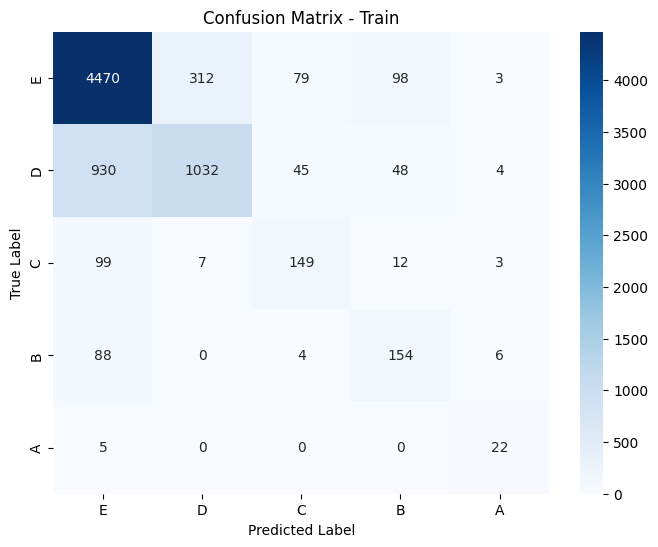

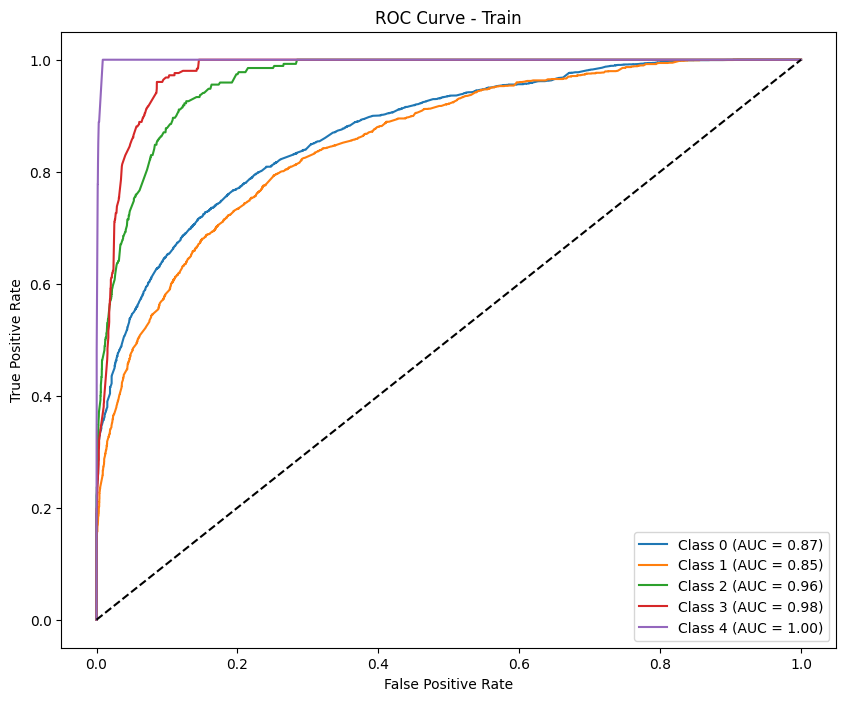

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91641337 0.43971631 0.         0.         0.        ]
Precision (per class): [0.86142857 0.65957447 0.         0.         0.        ]
Recall (per class): [0.9788961  0.32978723 0.         0.         0.        ]
Accuracy: 0.8386
AUC (One-vs-Rest): 0.7701

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.98      0.92       616
           D       0.66      0.33      0.44        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.30      0.26      0.27       756
weighted avg       0.78      0.84      0.80       756



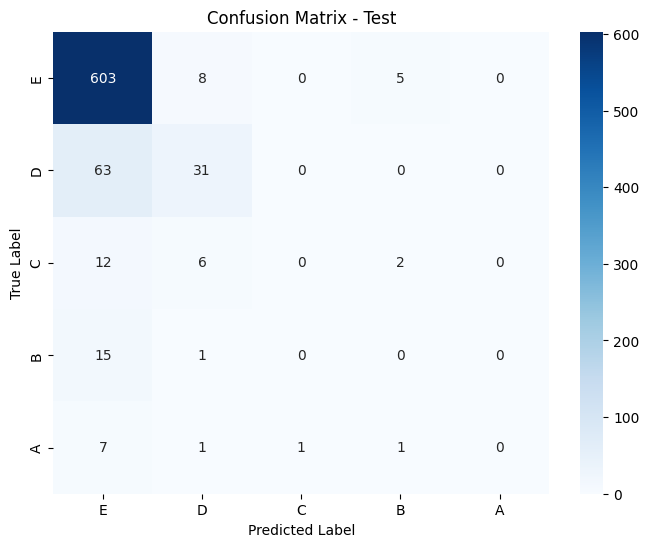

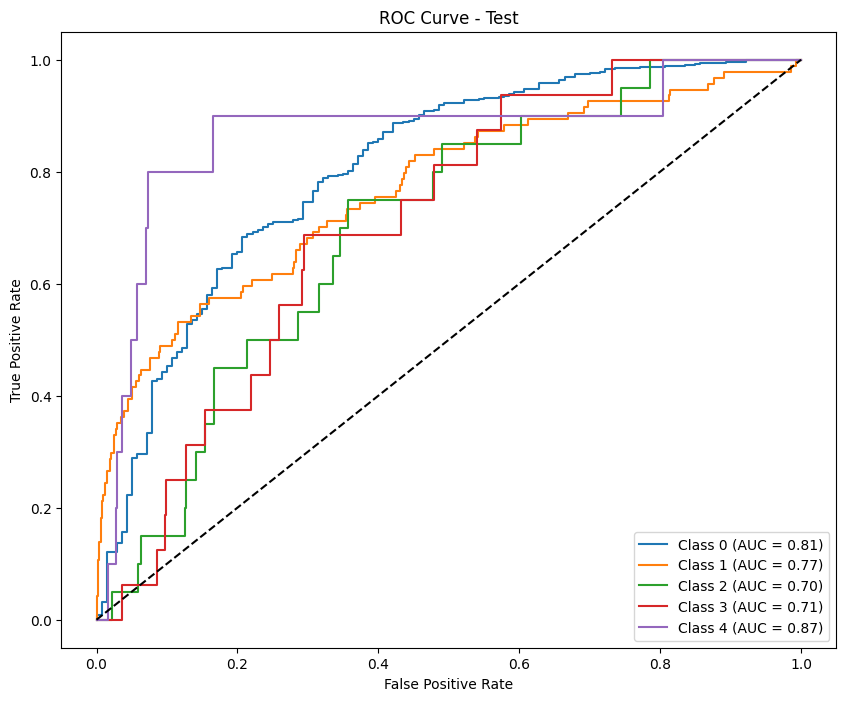


Permutation Importance for phase: phase1


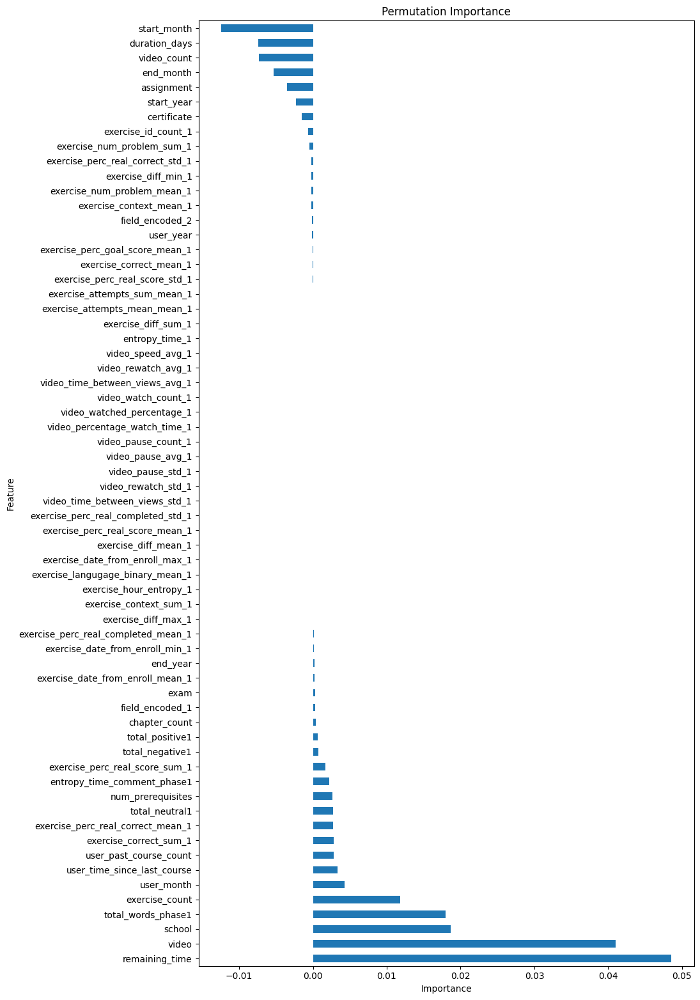

               Feature  Importance
20      remaining_time    0.048563
17               video    0.040984
0               school    0.018676
60  total_words_phase1    0.017966
10      exercise_count    0.011790
..                 ...         ...
16          assignment   -0.003501
6            end_month   -0.005317
9          video_count   -0.007282
19       duration_days   -0.007431
4          start_month   -0.012450

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.3947015172088868, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.5380991497859213, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.4287818834272912, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6895845779690717, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1456934783805082, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3065345679387974, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3390008102055617, tolerance: 0.338293989

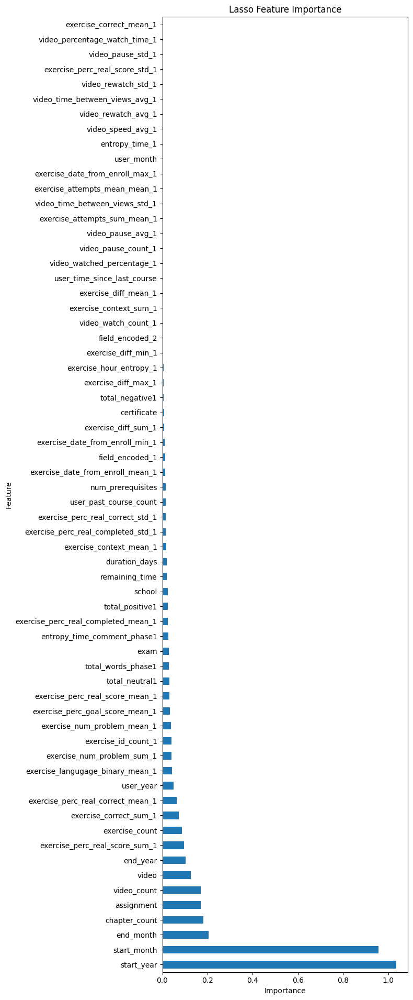

                           Feature  Importance
3                       start_year    1.034117
4                      start_month    0.956411
6                        end_month    0.205053
11                   chapter_count    0.180369
16                      assignment    0.170109
..                             ...         ...
55             video_rewatch_std_1    0.000000
46  exercise_perc_real_score_std_1    0.000000
53               video_pause_std_1    0.000000
50   video_percentage_watch_time_1    0.000000
24         exercise_correct_mean_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
44     exercise_perc_real_score_sum_1    0.108838
24            exercise_correct_mean_1    0.080603
15                        certificate    0.077792
42  exercise_perc_real_correct_mean_1    0.056119
17                              video    0.047052
..                                ...         ...
5

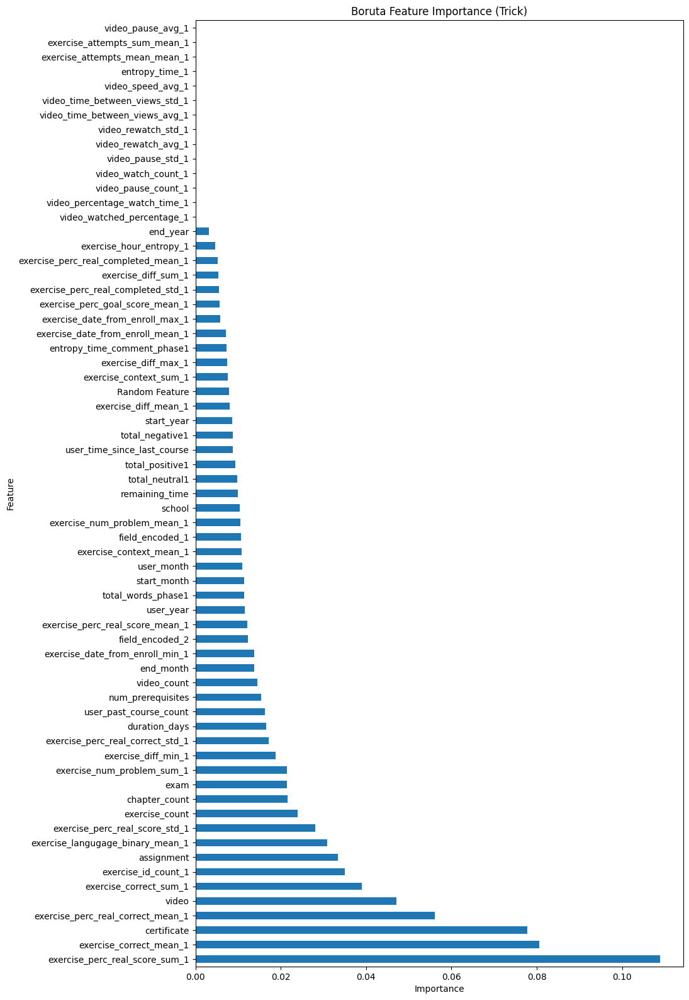

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.79510329 0.61860625 0.43726708 0.53092784 0.68656716]
Precision (per class): [0.89125214 0.61292517 0.30608696 0.37728938 0.54761905]
Recall (per class): [0.71767956 0.62439362 0.76521739 0.89565217 0.92      ]
Accuracy: 0.7037
AUC (One-vs-Rest): 0.9211

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.72      0.80      3620
           D       0.61      0.62      0.62      1443
           C       0.31      0.77      0.44       230
           B       0.38      0.90      0.53       230
           A       0.55      0.92      0.69        25

    accuracy                           0.70      5548
   macr

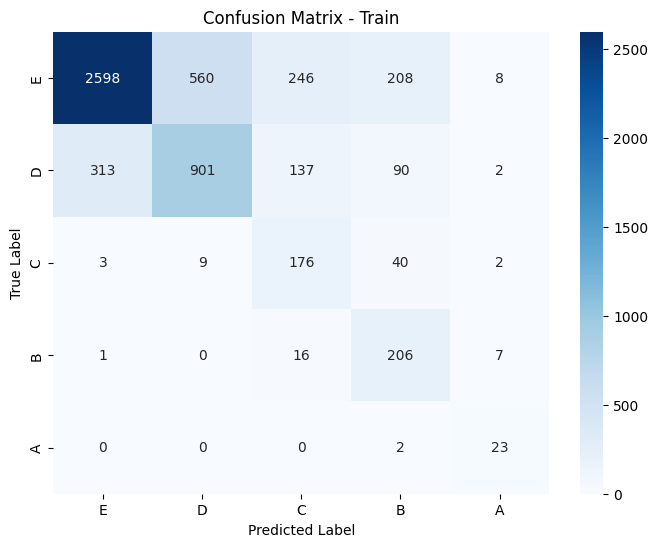

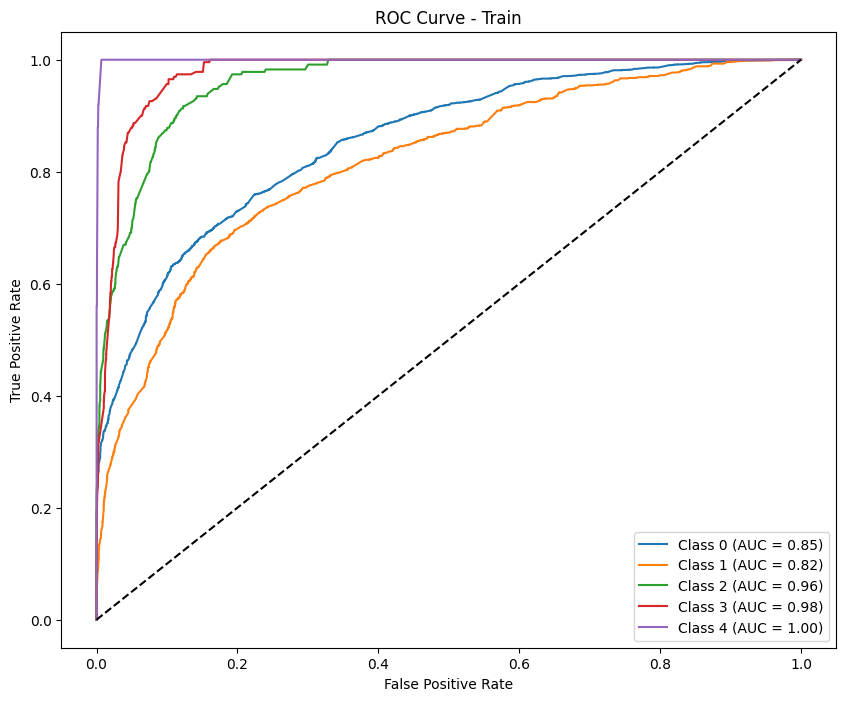


--- Test Metrics ---
F1 Score (per class): [0.83934426 0.20689655 0.         0.06666667 0.        ]
Precision (per class): [0.83797054 0.2195122  0.         0.04444444 0.        ]
Recall (per class): [0.8407225  0.19565217 0.         0.13333333 0.        ]
Accuracy: 0.7131
AUC (One-vs-Rest): 0.6467

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84       609
           D       0.22      0.20      0.21        92
           C       0.00      0.00      0.00        20
           B       0.04      0.13      0.07        15
           A       0.00      0.00      0.00        10

    accuracy                           0.71       746
   macro avg       0.22      0.23      0.22       746
weighted avg       0.71      0.71      0.71       746



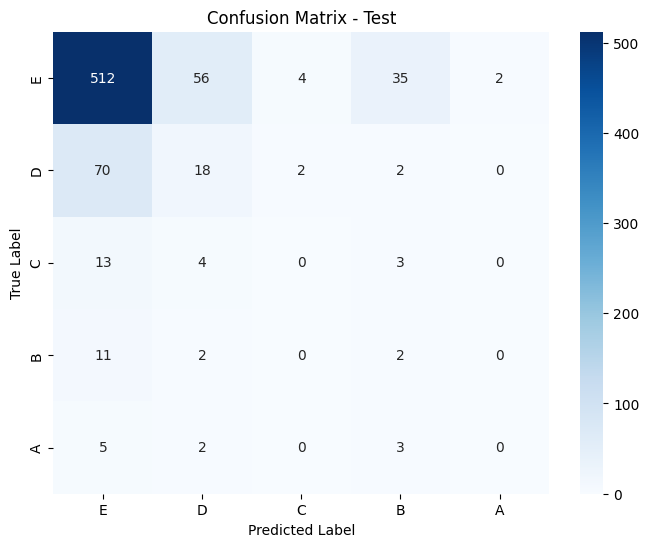

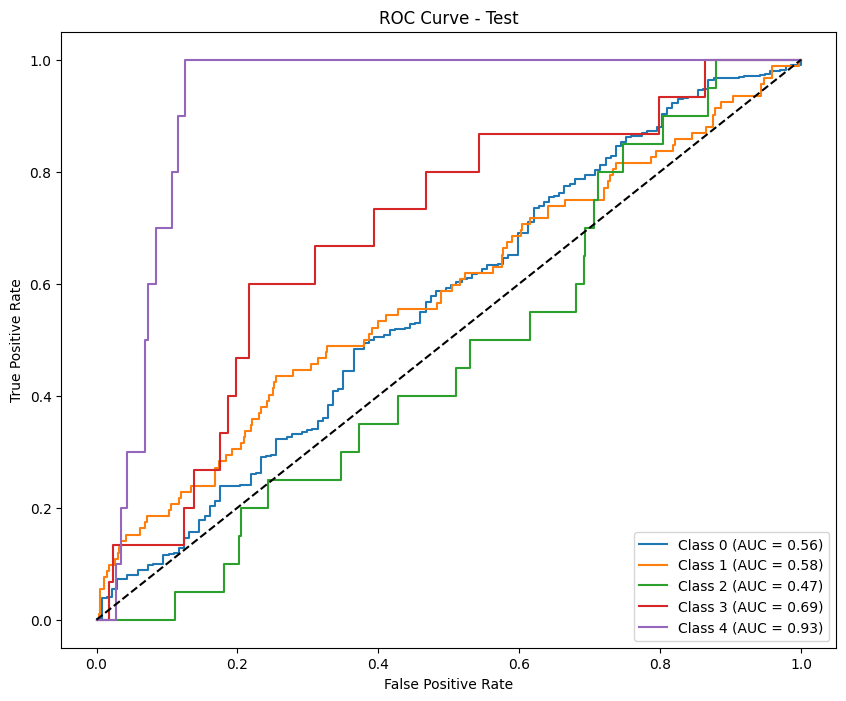

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84203723 0.54840123 0.5518591  0.59920635 0.74193548]
Precision (per class): [0.79130224 0.7452381  0.50177936 0.55109489 0.62162162]
Recall (per class): [0.89972376 0.43381843 0.61304348 0.65652174 0.92      ]
Accuracy: 0.7567
AUC (One-vs-Rest): 0.9290

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      3620
           D       0.75      0.43      0.55      1443
           C       0.50      0.61      0.55       230
           B       0.55      0.66      0.60       230
           A       0.62      0.92      0.74        25

    accuracy                           0.76      5548
   macro avg       0.64      0.70      0.66      5548
weighted avg       0.76      0.76      0.74      5548



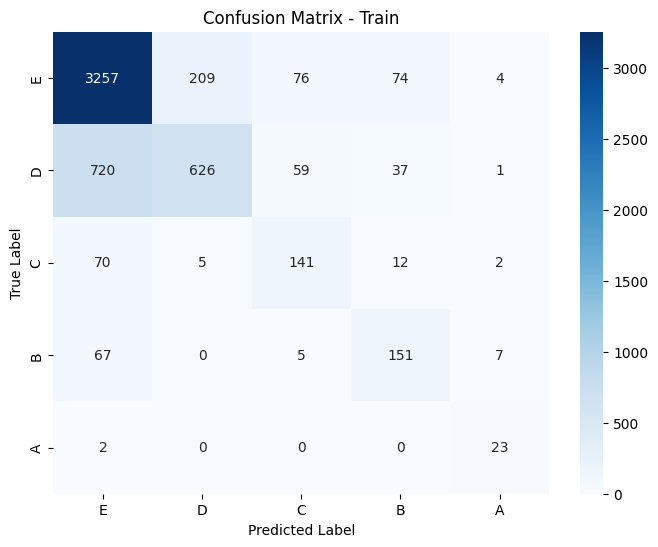

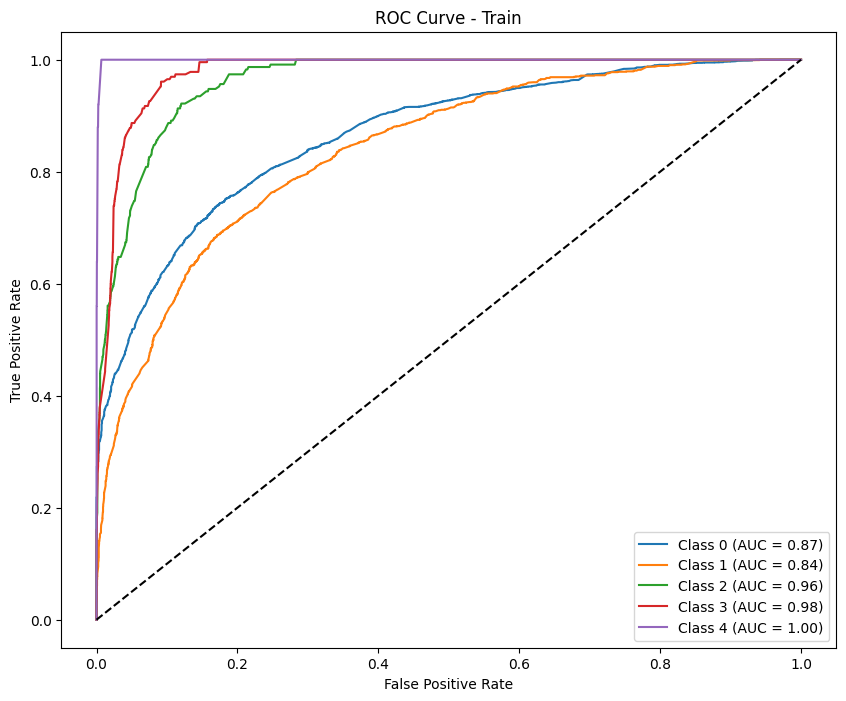

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88803681 0.16       0.         0.06060606 0.        ]
Precision (per class): [0.83309353 0.3030303  0.         0.05555556 0.        ]
Recall (per class): [0.95073892 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.7909
AUC (One-vs-Rest): 0.6330

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.95      0.89       609
           D       0.30      0.11      0.16        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.79       746
   macro avg       0.24      0.23      0.22       746
weighted avg       0.72      0.79      0.75       746



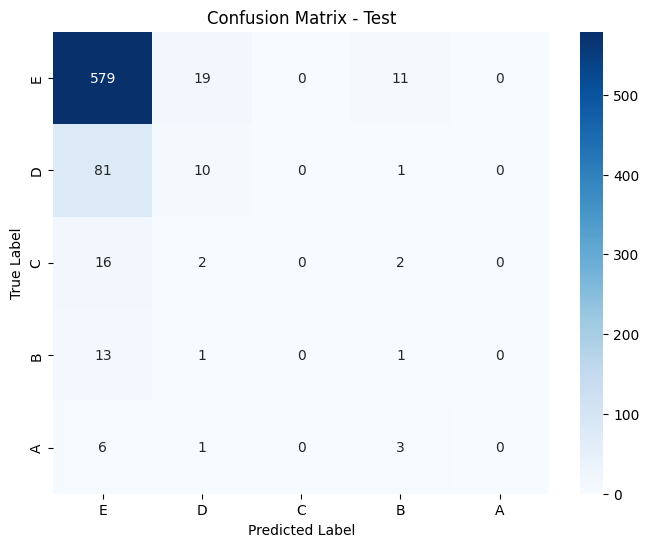

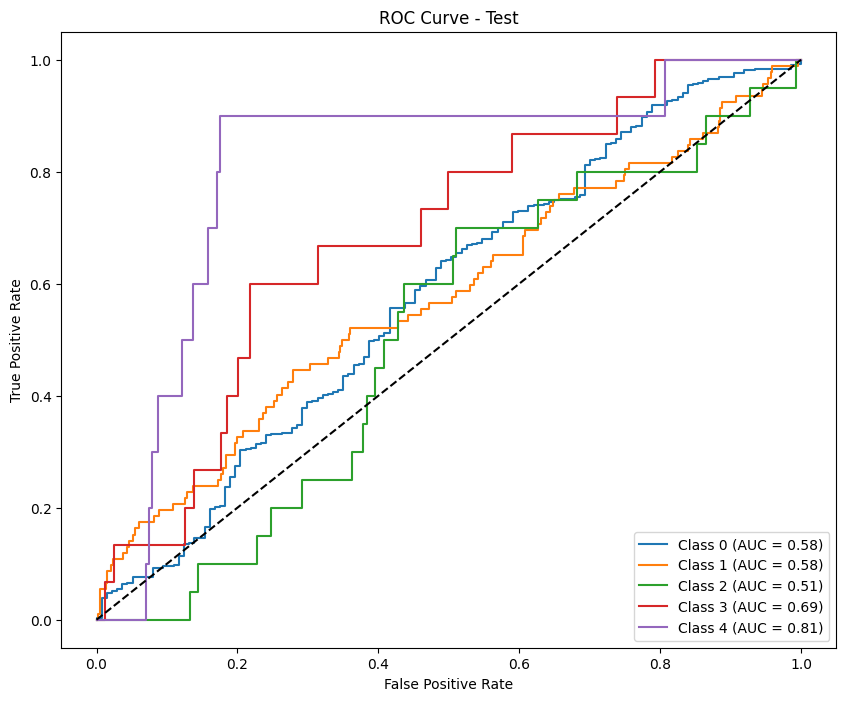


Permutation Importance for phase: phase2


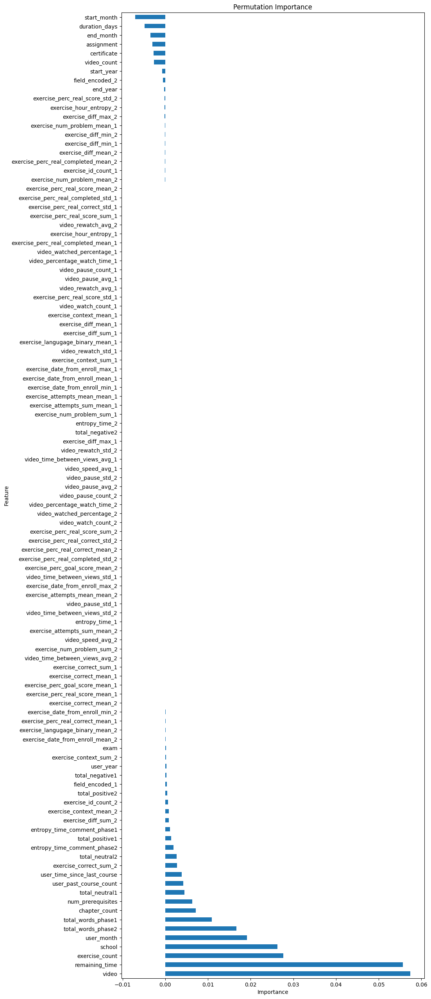

           Feature  Importance
17           video    0.057431
20  remaining_time    0.055651
10  exercise_count    0.027645
0           school    0.026316
8       user_month    0.019106
..             ...         ...
15     certificate   -0.002726
16      assignment   -0.002997
6        end_month   -0.003447
19   duration_days   -0.004822
4      start_month   -0.007052

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.4601167825403536, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.8459633651664262, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6739772710625402, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1114454914745693, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9883298889890284, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9590974461357291, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.944816970716147, tolerance: 0.2815

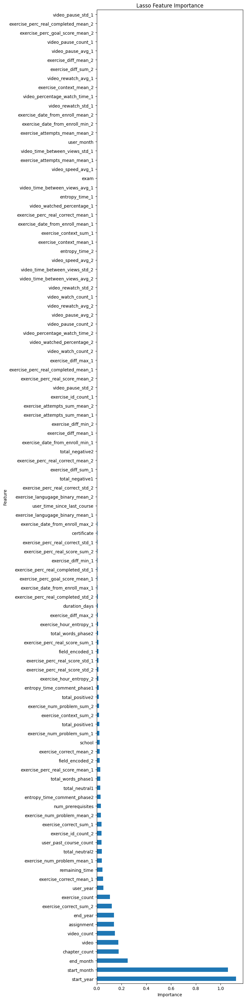

                                Feature  Importance
3                            start_year    1.124895
4                           start_month    1.059348
6                             end_month    0.251513
11                        chapter_count    0.177802
17                                video    0.175931
..                                  ...         ...
52                    video_pause_avg_1    0.000000
51                  video_pause_count_1    0.000000
82      exercise_perc_goal_score_mean_2    0.000000
83  exercise_perc_real_completed_mean_2    0.000000
53                    video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
15                      certificate    0.156502
17                            video    0.047210
16                       assignment    0.033633
66           exercise_correct_sum_2    0.030516
18                             exam    0.021022
..

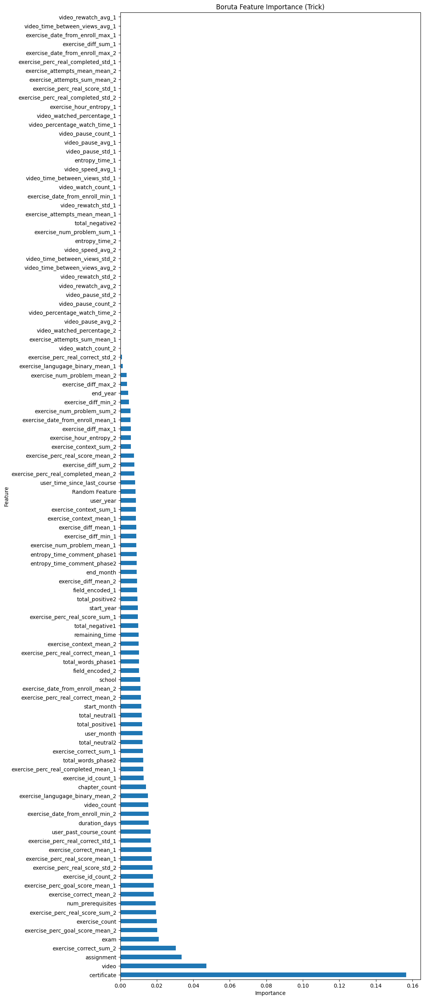

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.80533333 0.6459439  0.47588424 0.51242236 0.49350649]
Precision (per class): [0.90563774 0.61828737 0.34498834 0.37757437 0.32758621]
Recall (per class): [0.72503201 0.67619048 0.76683938 0.79710145 1.        ]
Accuracy: 0.7181
AUC (One-vs-Rest): 0.9296

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.73      0.81      3124
           D       0.62      0.68      0.65      1260
           C       0.34      0.77      0.48       193
           B       0.38      0.80      0.51       207
           A       0.33      1.00      0.49        19

    accuracy                           0.72      4803
   macr

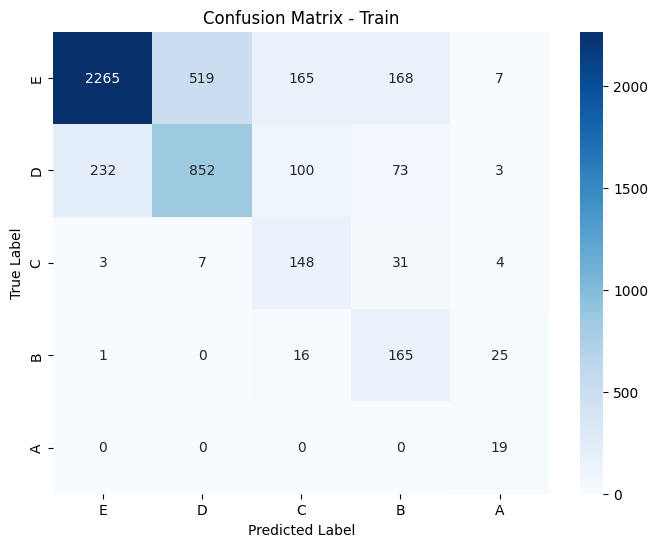

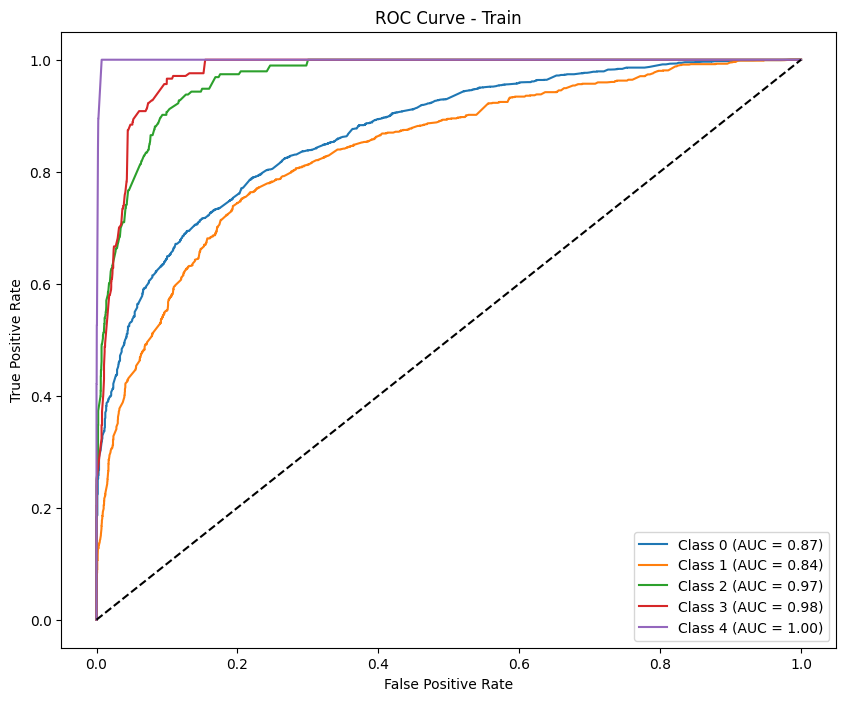


--- Test Metrics ---
F1 Score (per class): [0.73998136 0.20175439 0.         0.0625     0.        ]
Precision (per class): [0.8185567  0.16312057 0.         0.0375     0.        ]
Recall (per class): [0.67517007 0.26436782 0.         0.1875     0.        ]
Accuracy: 0.5867
AUC (One-vs-Rest): 0.6124

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.68      0.74       588
           D       0.16      0.26      0.20        87
           C       0.00      0.00      0.00        20
           B       0.04      0.19      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.59       721
   macro avg       0.20      0.23      0.20       721
weighted avg       0.69      0.59      0.63       721



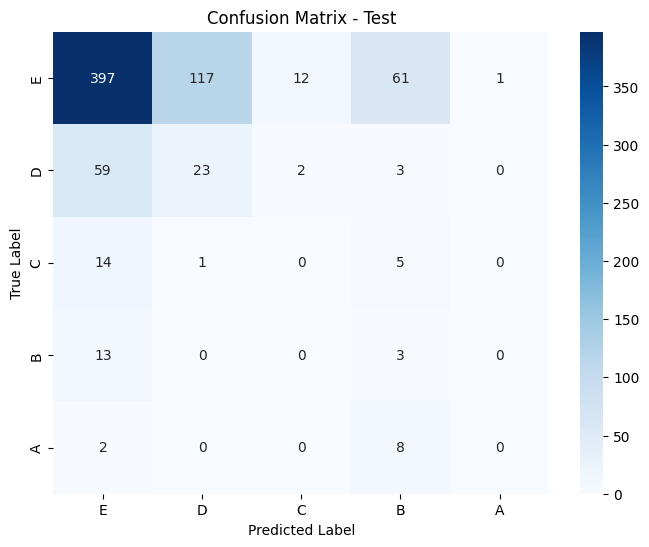

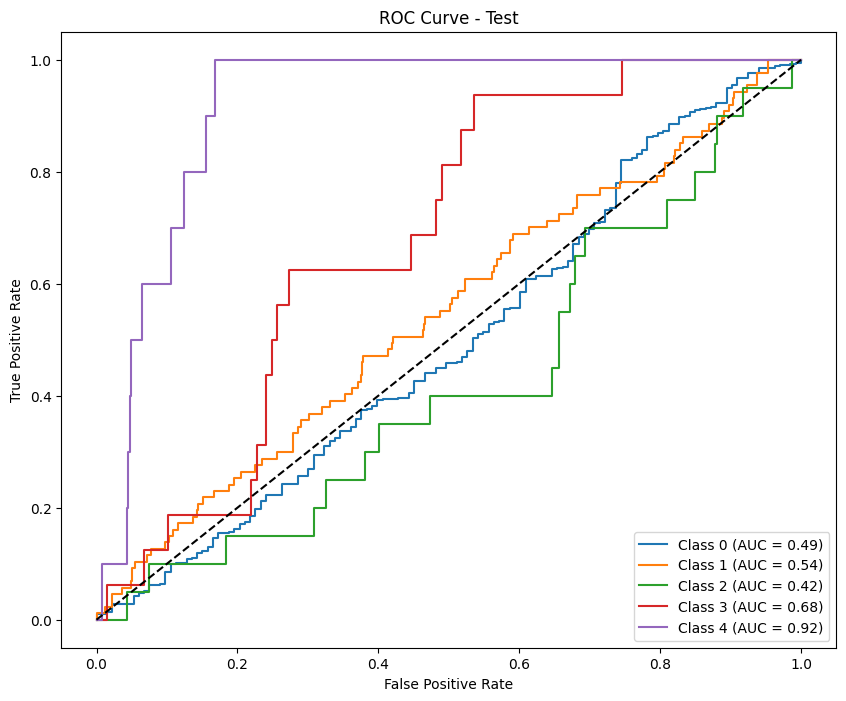

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8525283  0.60769231 0.5955335  0.60444444 0.70833333]
Precision (per class): [0.80662668 0.77073171 0.57142857 0.55967078 0.5862069 ]
Recall (per class): [0.90396927 0.5015873  0.62176166 0.65700483 0.89473684]
Accuracy: 0.7764
AUC (One-vs-Rest): 0.9370

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.90      0.85      3124
           D       0.77      0.50      0.61      1260
           C       0.57      0.62      0.60       193
           B       0.56      0.66      0.60       207
           A       0.59      0.89      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.72      0.67      4803
weighted avg       0.78      0.78      0.77      4803



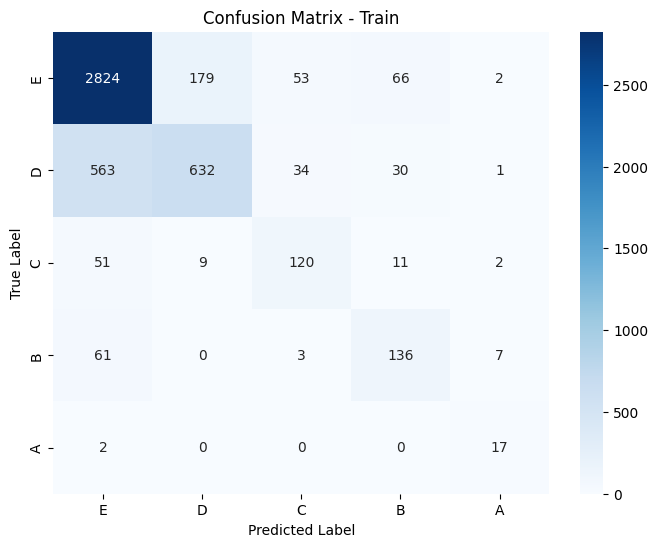

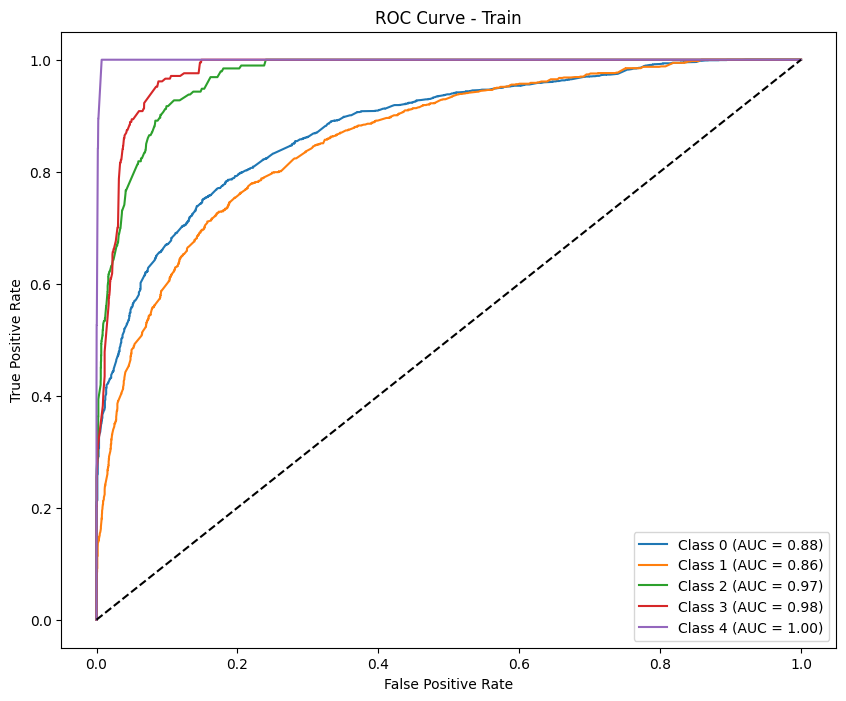

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8452579  0.1509434  0.         0.04081633 0.        ]
Precision (per class): [0.82736156 0.16666667 0.         0.03030303 0.        ]
Recall (per class): [0.86394558 0.13793103 0.         0.0625     0.        ]
Accuracy: 0.7226
AUC (One-vs-Rest): 0.6012

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.85       588
           D       0.17      0.14      0.15        87
           C       0.00      0.00      0.00        20
           B       0.03      0.06      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.72       721
   macro avg       0.20      0.21      0.21       721
weighted avg       0.70      0.72      0.71       721



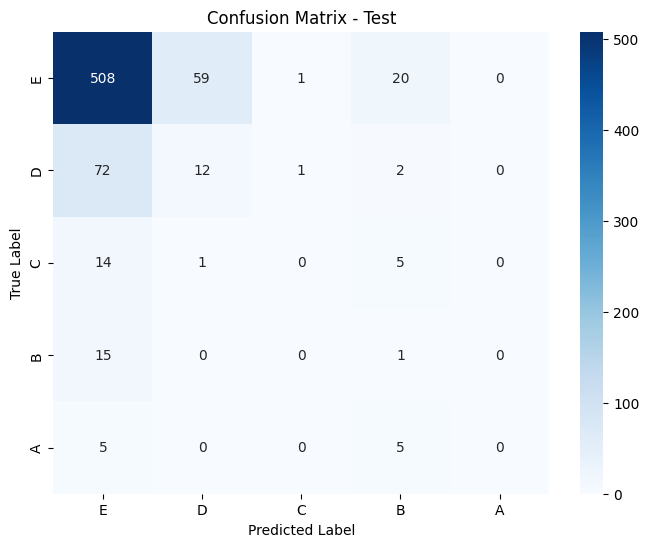

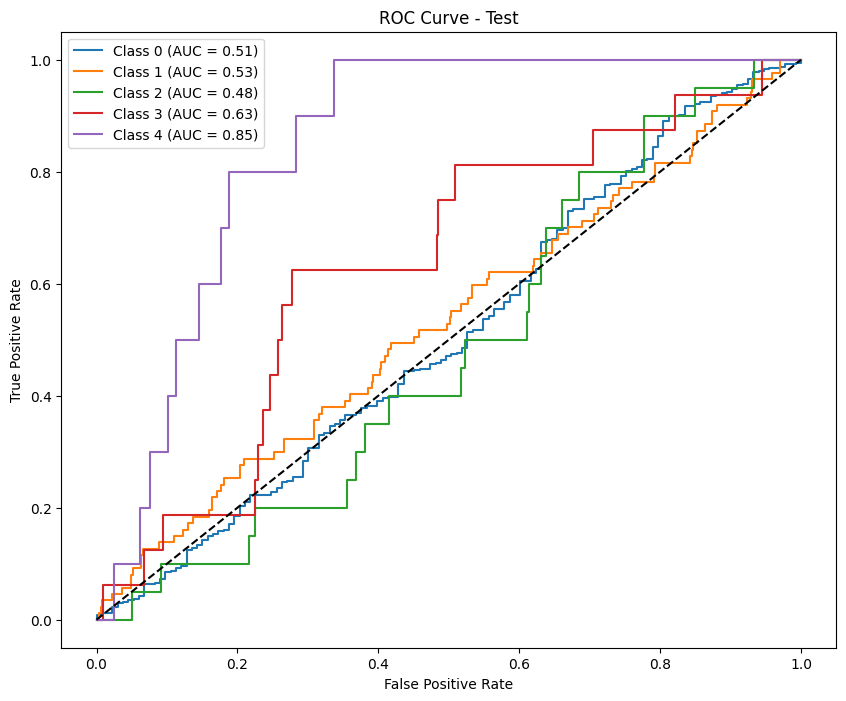

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.81925055 0.66934835 0.53538462 0.69873418 0.68292683]
Precision (per class): [0.91769547 0.62934947 0.38839286 0.58474576 0.51851852]
Recall (per class): [0.73988056 0.71477663 0.86138614 0.86792453 1.        ]
Accuracy: 0.7490
AUC (One-vs-Rest): 0.9460

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.74      0.82      1507
           D       0.63      0.71      0.67       582
           C       0.39      0.86      0.54       101
           B       0.58      0.87      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.75      2363
   macr

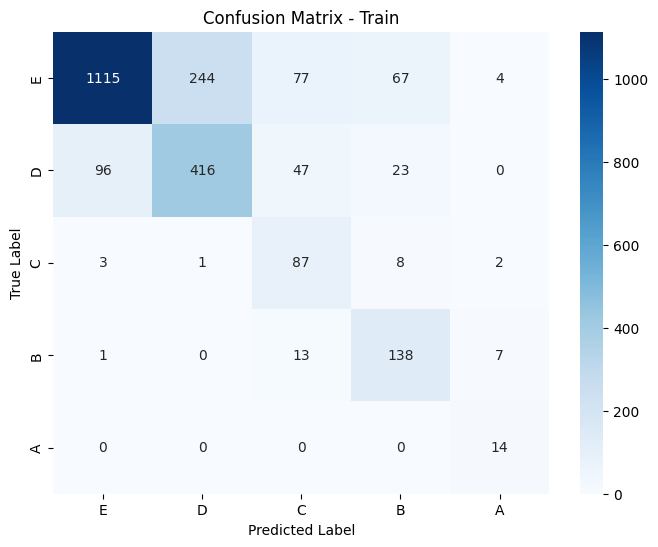

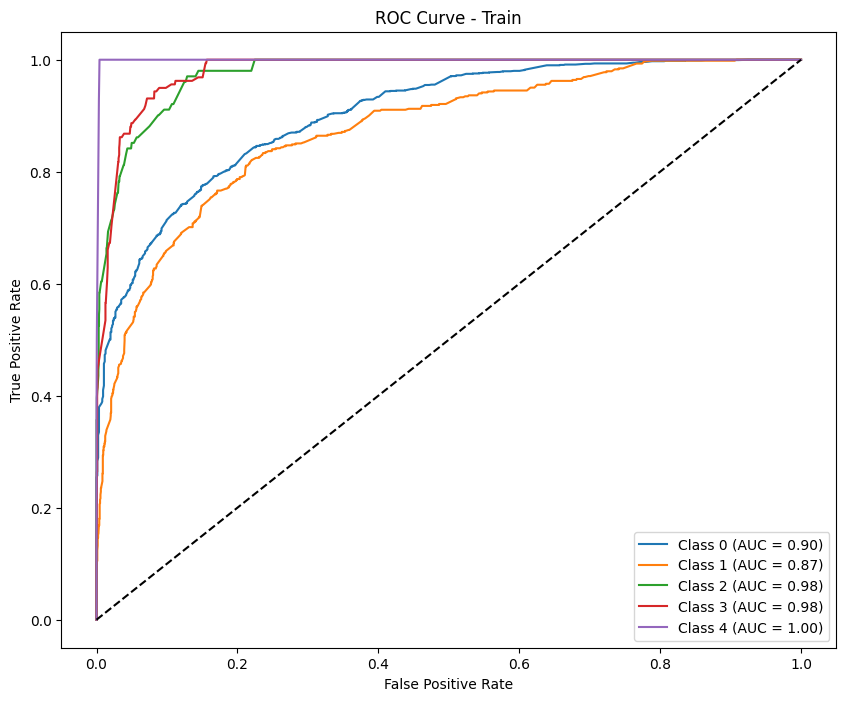

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.76603774 0.11049724 0.         0.06451613 0.        ]
Precision (per class): [0.8039604  0.10416667 0.         0.04       0.        ]
Recall (per class): [0.73153153 0.11764706 0.         0.16666667 0.        ]
Accuracy: 0.6099
AUC (One-vs-Rest): 0.5702

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.73      0.77       555
           D       0.10      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.04      0.17      0.06        18
           A       0.00      0.00      0.00        11

    accuracy                           0.61       687
   macro avg       0.19      0.20      0.19       687
weighted avg       0.66      0.61      0.63       687



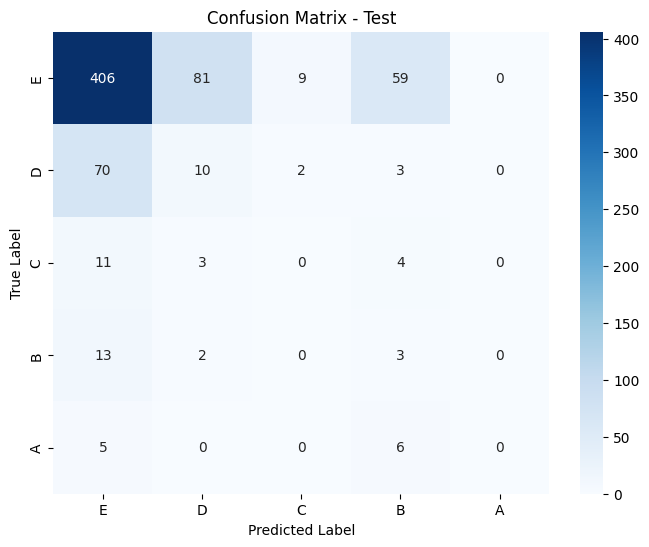

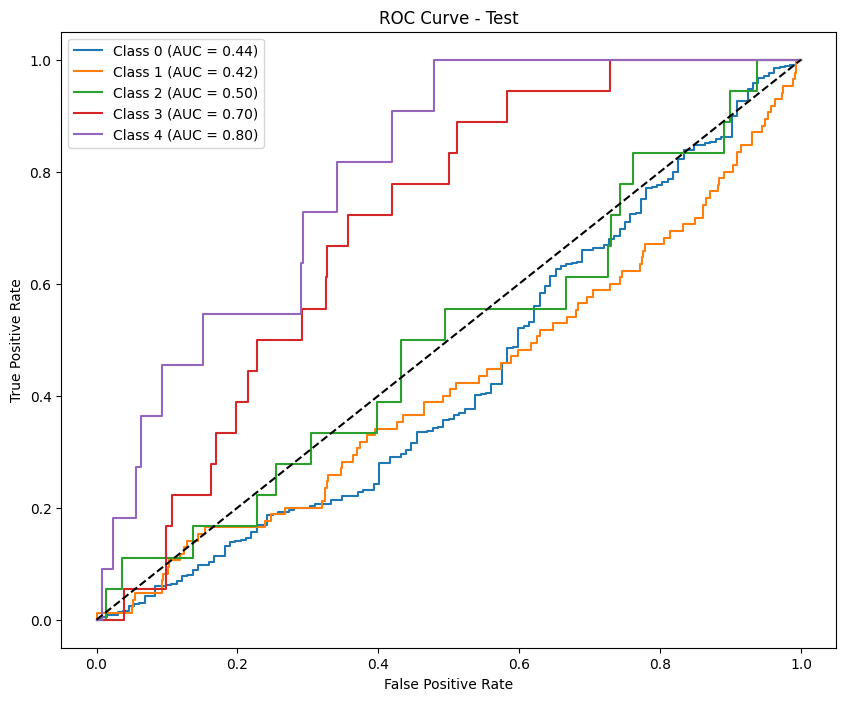

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87144703 0.64065708 0.63967611 0.73854447 0.73684211]
Precision (per class): [0.84896161 0.79591837 0.54109589 0.64622642 0.58333333]
Recall (per class): [0.89515594 0.53608247 0.78217822 0.86163522 1.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.9512

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.90      0.87      1507
           D       0.80      0.54      0.64       582
           C       0.54      0.78      0.64       101
           B       0.65      0.86      0.74       159
           A       0.58      1.00      0.74        14

    accuracy                           0.80      2363
   macro avg       0.68      0.82      0.73      2363
weighted avg       0.81      0.80      0.79      2363



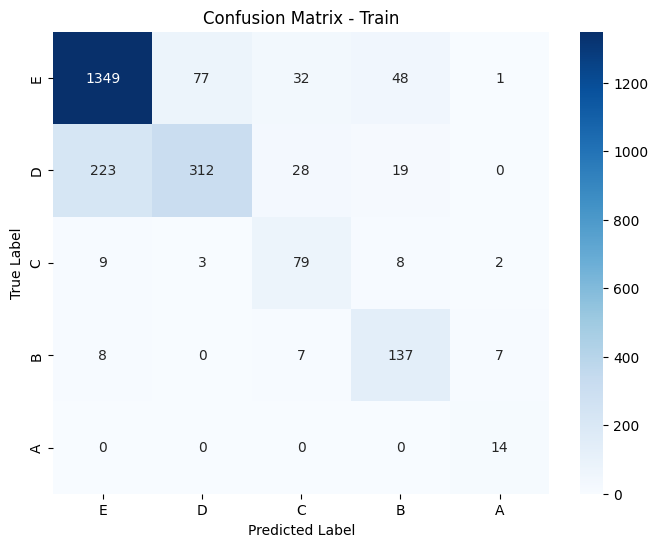

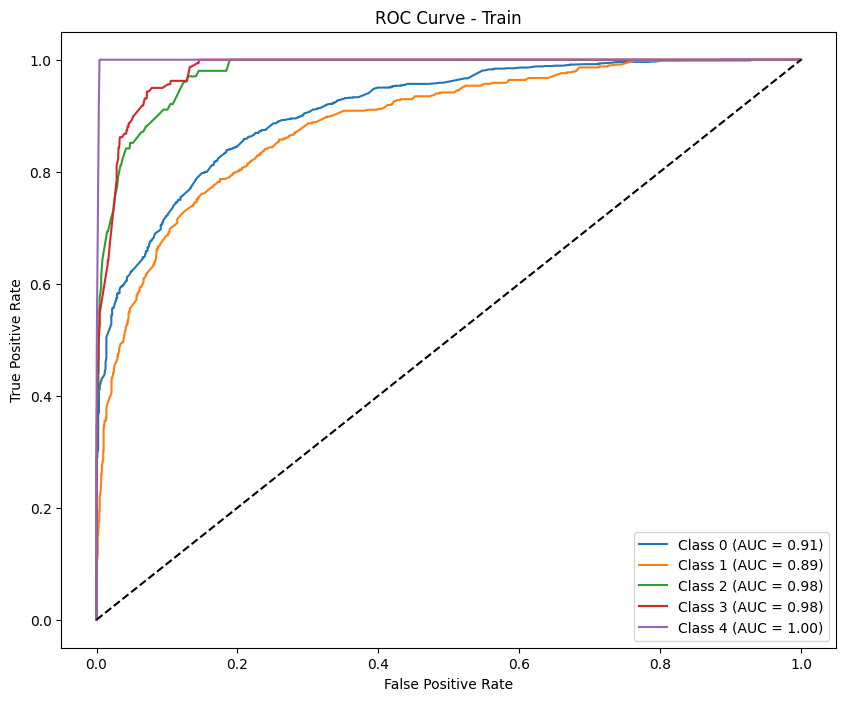

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.84687767 0.03278689 0.         0.03773585 0.        ]
Precision (per class): [0.80618893 0.05405405 0.         0.02857143 0.        ]
Recall (per class): [0.89189189 0.02352941 0.         0.05555556 0.        ]
Accuracy: 0.7249
AUC (One-vs-Rest): 0.5843

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85       555
           D       0.05      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.72       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.66      0.72      0.69       687



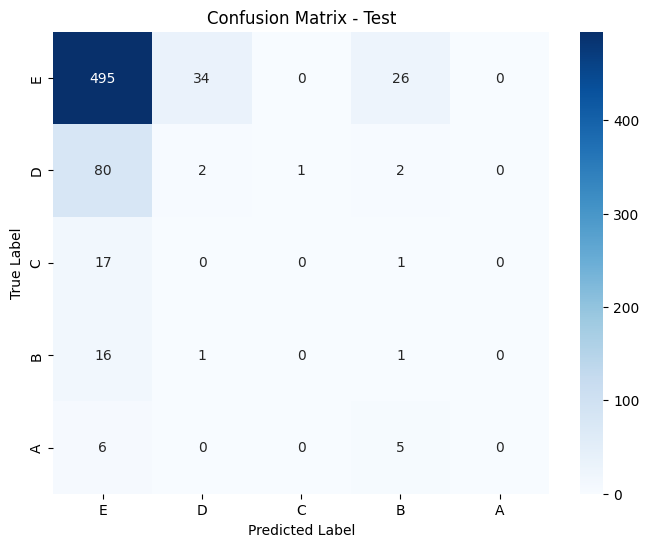

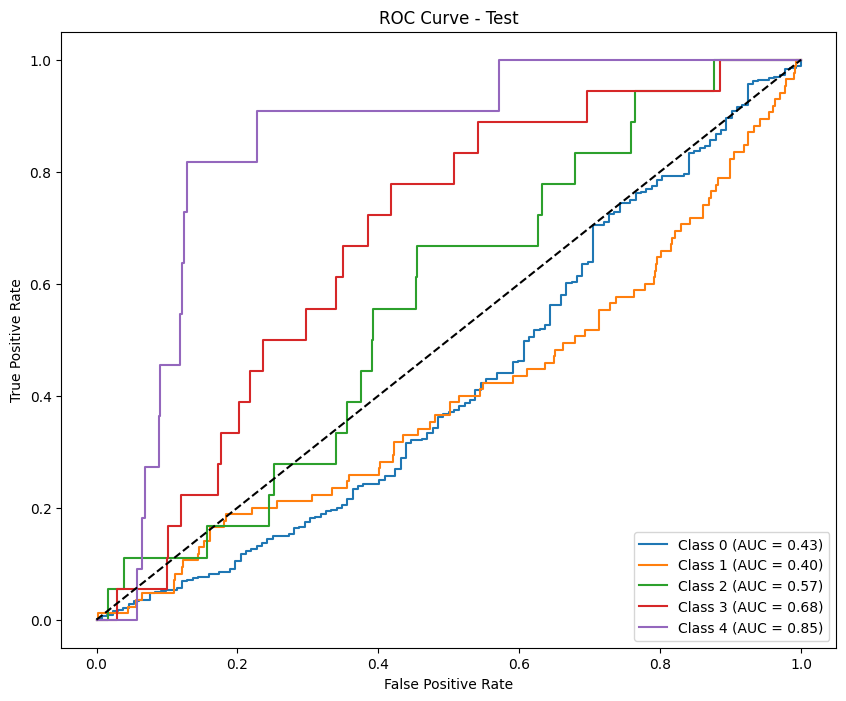

In [16]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, scale='standard', metric='f1_macro')

### Oversammpling

In [17]:
def manual_custom_oversample(X, y, class_increase_counts):
    """
    Oversample bằng cách tăng thêm số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_increase_counts (dict): Dict {class_label: increase_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau oversample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        resampled_parts.append(df_cls)  # Ban đầu: dữ liệu gốc

        if cls in class_increase_counts:
            increase_count = class_increase_counts[cls]
            n_repeat = increase_count // len(df_cls)  # số lần nhân bản toàn bộ
            n_extra = increase_count % len(df_cls)    # thêm bao nhiêu mẫu riêng lẻ

            # Nhân bản toàn bộ
            if n_repeat > 0:
                resampled_parts.append(pd.concat([df_cls] * n_repeat, ignore_index=True))

            # Lấy thêm một số mẫu ngẫu nhiên
            if n_extra > 0:
                resampled_parts.append(df_cls.sample(n=n_extra, replace=True, random_state=42))

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [18]:
# Đọc và xử lý dữ liệu cho từng phase
def process_oversample_phase(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Oversampling
    cls_count = {
        2: 1000,
        3: 500,
        4: 250
    }
    X_train, y_train = manual_custom_oversample(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
    sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

    # Huấn luyện mô hình
    model = XGBClassifier(
        subsample=  0.8, 
        n_estimators = 400, 
        min_child_weight = 3, 
        max_depth = 6, 
        learning_rate = 0.05,
        gamma = 0,
        colsample_bytree = 1.0,
        random_state=42,
        use_label_encoder=False,
        eval_metric='mlogloss'
    )
    model.fit(X_train_scaled, y_train)
    
    # Dự đoán
    y_pred = model.predict(X_test_scaled)
    
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

    # Tính toán calibrate model
    calibrate_train_model = calibrate_model(model, X_train_scaled, y_train)
    # Dự đoán trên tập test
    y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
    # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
    results_df = X_test.copy()
    results_df['True_Label'] = y_test
    results_df['Predicted_Label'] = y_calibrate_pred
    
    # Lưu kết quả dự đoán
    results_filename = f"test_results_calibrate_undersample_{scale}_{metric}_{phase}.csv"
    results_df.to_csv(results_filename, index=False)
    print(f"Results saved as {results_filename}")
    
    # Đánh giá mô hình
    print(f"Results for phase: {phase}")
    evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)

    
    # Chọn feature yếu
    if int(phase[-1]) <=2:
        print(f"\nPermutation Importance for phase: {phase}")
        perm_importance = plot_permutation_importance(model, X_train_scaled, y_train)
        print(perm_importance)
    
        # Lasso Regression cho chọn feature
        print(f"\nLasso Feature Selection for phase: {phase}")
        lasso_importance = lasso_feature_selection(X_train_scaled, y_train)
        print(lasso_importance)

        print("\nBoruta Trick:")
        important_features = boruta_trick(model, X_train_scaled, y_train)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

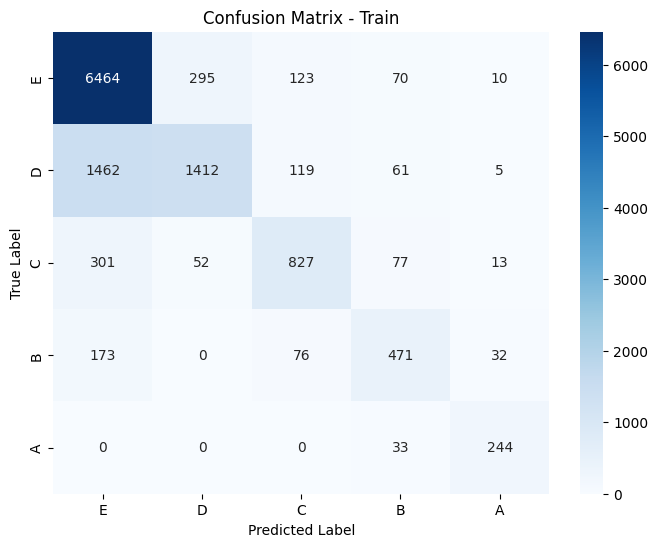

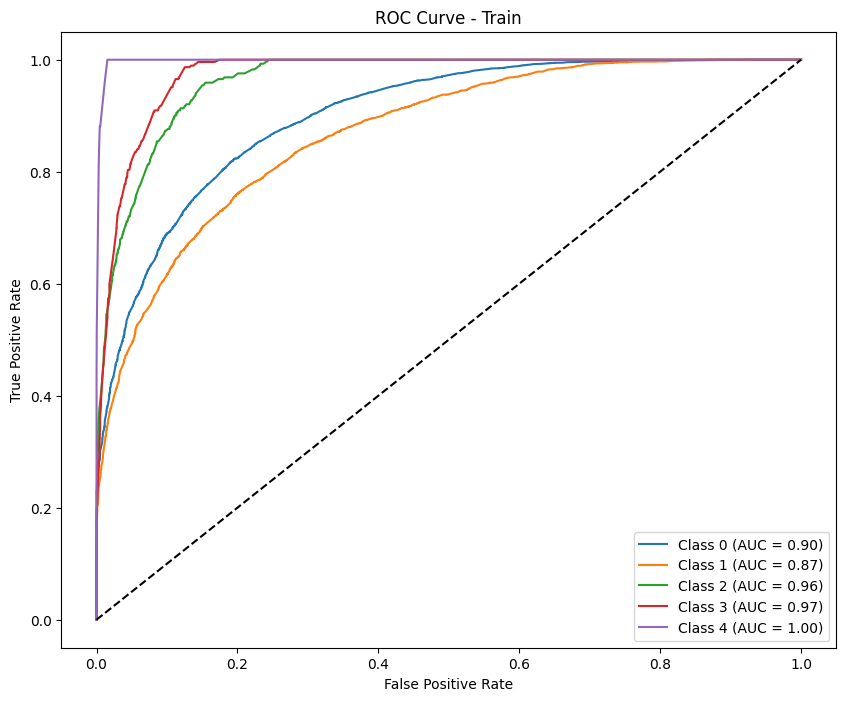

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92331526 0.45882353 0.         0.         0.        ]
Precision (per class): [0.88296296 0.51315789 0.         0.         0.        ]
Recall (per class): [0.96753247 0.41489362 0.         0.         0.        ]
Accuracy: 0.8399
AUC (One-vs-Rest): 0.8160

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.97      0.92       616
           D       0.51      0.41      0.46        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.28      0.28       756
weighted avg       0.78      0.84      0.81       756



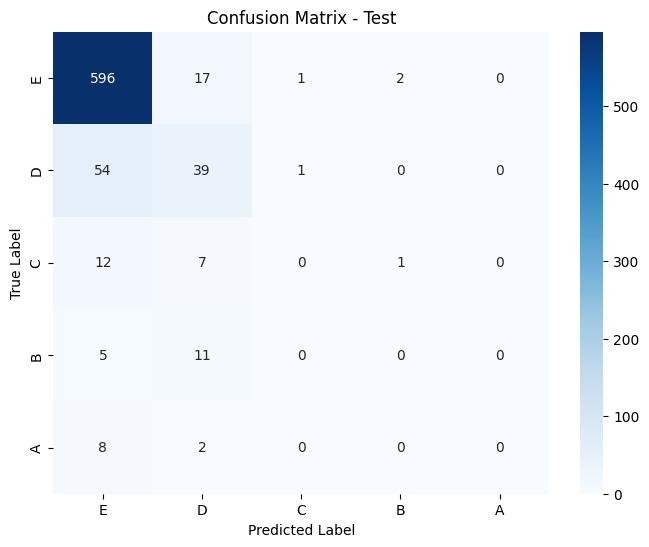

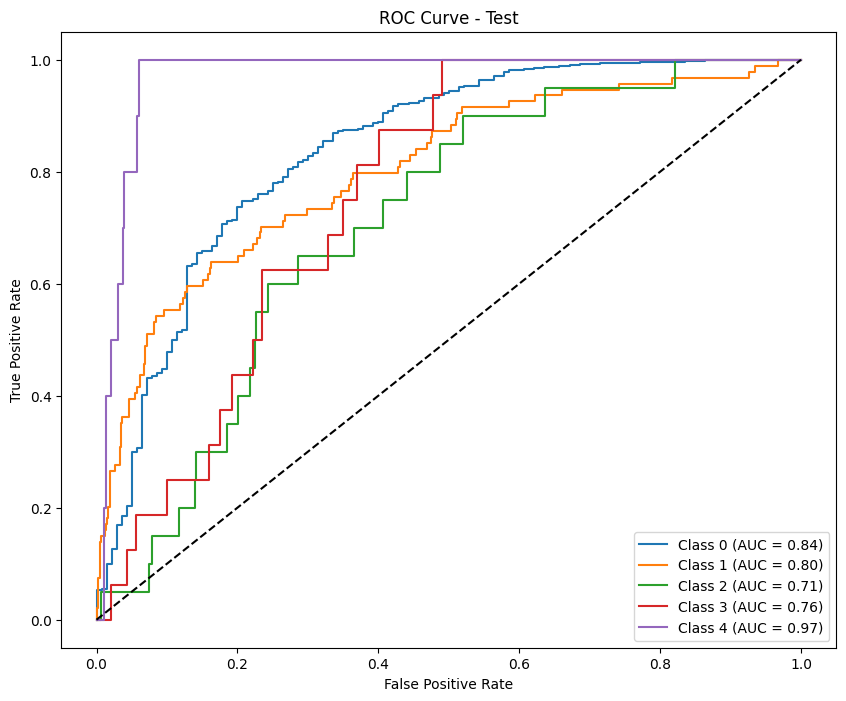

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.84045184 0.61813292 0.68423219 0.64485344 0.8457539 ]
Precision (per class): [0.78597325 0.74941779 0.71699741 0.66153846 0.81333333]
Recall (per class): [0.9030451  0.52598889 0.65433071 0.62898936 0.88086643]
Accuracy: 0.7666
AUC (One-vs-Rest): 0.9413

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      6962
           D       0.75      0.53      0.62      3059
           C       0.72      0.65      0.68      1270
           B       0.66      0.63      0.64       752
           A       0.81      0.88      0.85       277

    accuracy                           0.77     12320
   macro avg       0.75      0.72      0.73     12320
weighted avg       0.76      0.77      0.76     12320



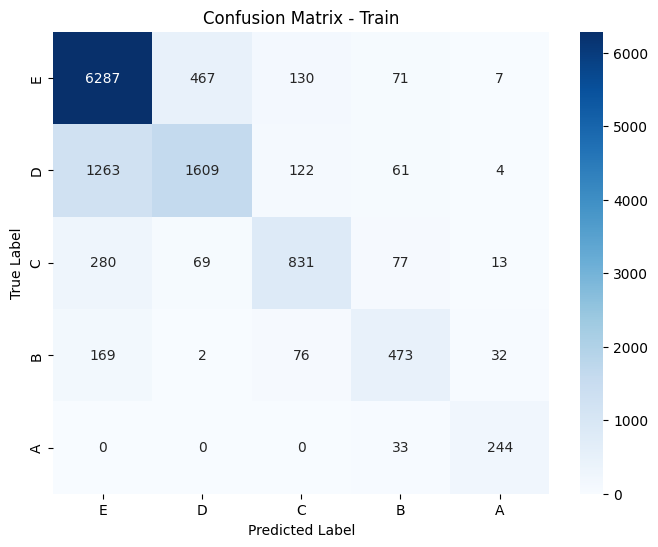

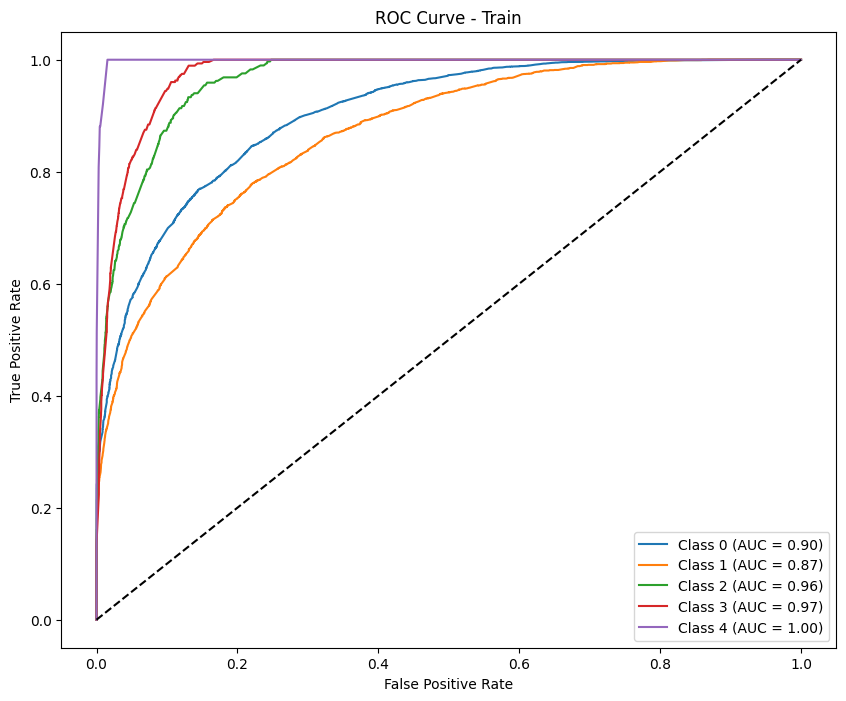

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9222395  0.44827586 0.         0.         0.        ]
Precision (per class): [0.88507463 0.4875     0.         0.         0.        ]
Recall (per class): [0.96266234 0.41489362 0.         0.         0.        ]
Accuracy: 0.8360
AUC (One-vs-Rest): 0.7772

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.96      0.92       616
           D       0.49      0.41      0.45        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.27      0.28      0.27       756
weighted avg       0.78      0.84      0.81       756



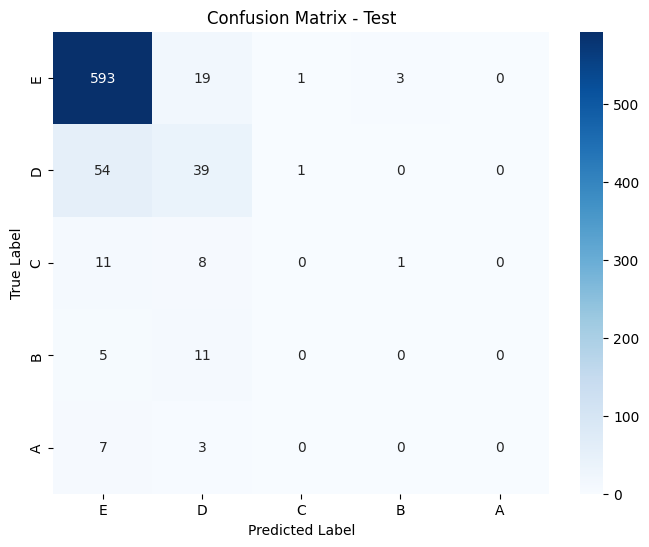

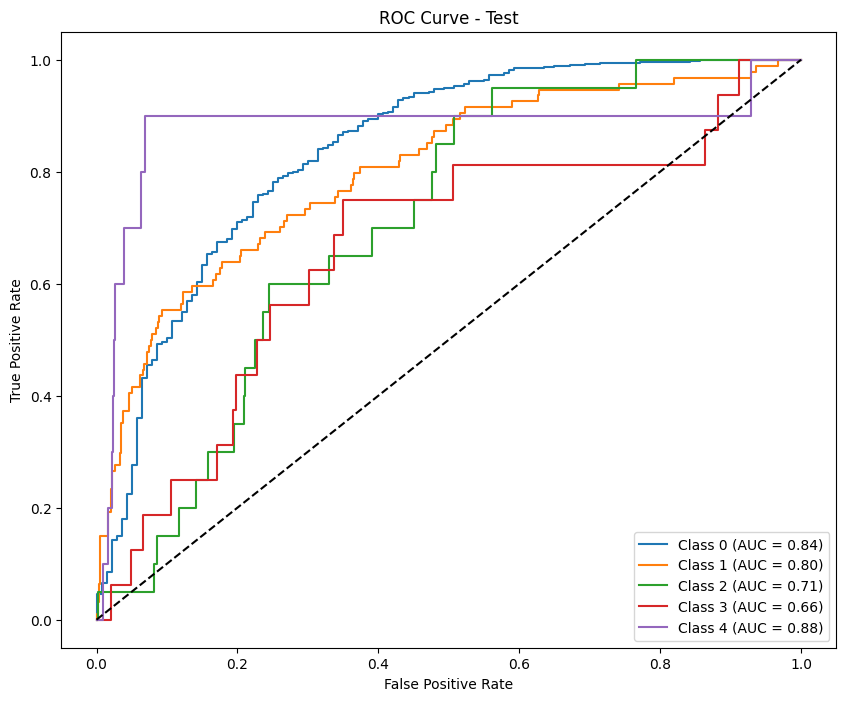


Permutation Importance for phase: phase1


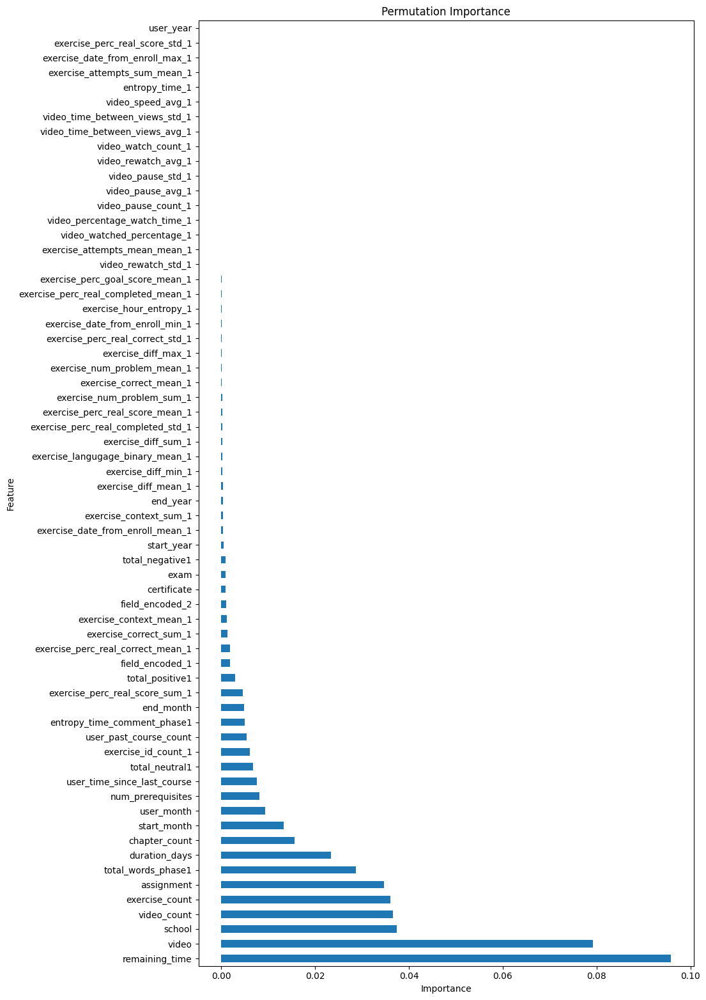

                            Feature  Importance
20                   remaining_time    0.095881
17                            video    0.079261
0                            school    0.037459
9                       video_count    0.036526
10                   exercise_count    0.035988
..                              ...         ...
59                   entropy_time_1    0.000000
27     exercise_attempts_sum_mean_1    0.000000
31  exercise_date_from_enroll_max_1   -0.000030
46   exercise_perc_real_score_std_1   -0.000041
7                         user_year   -0.000101

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.391085096551251, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.057808591191133, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.20768661342845, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.922907324791595, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1872777443932137, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.909138397240895, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.728414328576946, tolerance: 1.0302982853084377

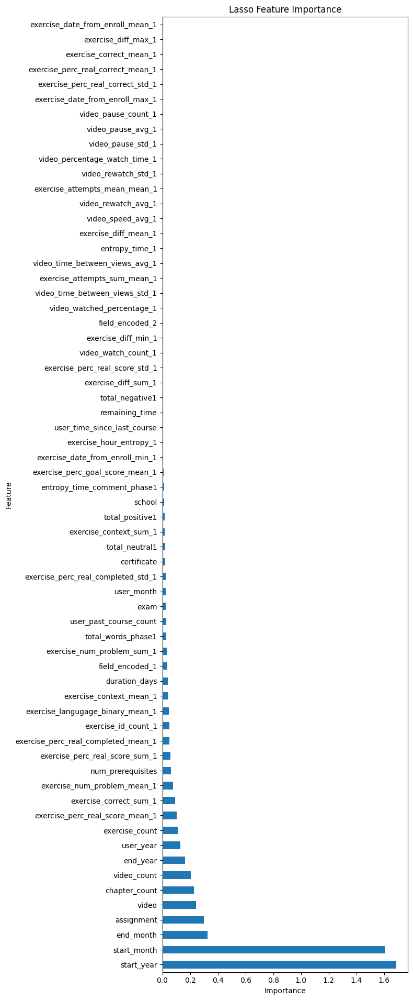

                              Feature  Importance
3                          start_year    1.685940
4                         start_month    1.604261
6                           end_month    0.327597
16                         assignment    0.299268
17                              video    0.244257
..                                ...         ...
43   exercise_perc_real_correct_std_1    0.000000
42  exercise_perc_real_correct_mean_1    0.000000
24            exercise_correct_mean_1    0.000000
38                exercise_diff_max_1    0.000000
30   exercise_date_from_enroll_mean_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
15                        certificate    0.134772
44     exercise_perc_real_score_sum_1    0.113755
17                              video    0.094769
16                         assignment    0.060550
42  exercise_perc_real_correct_mean_1    0.037960
..             

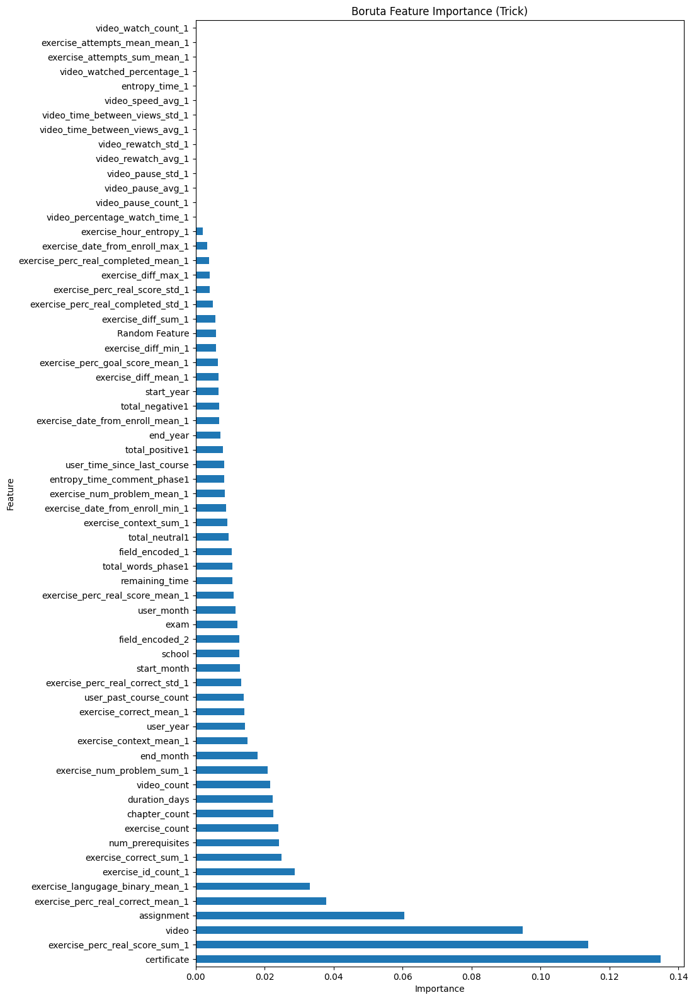

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83901484 0.55692874 0.70787402 0.65398168 0.88461538]
Precision (per class): [0.77446552 0.77867647 0.68625954 0.67343977 0.85185185]
Recall (per class): [0.91530249 0.43348342 0.73089431 0.63561644 0.92      ]
Accuracy: 0.7593
AUC (One-vs-Rest): 0.9408

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.92      0.84      5620
           D       0.78      0.43      0.56      2443
           C       0.69      0.73      0.71      1230
           B       0.67      0.64      0.65       730
           A       0.85      0.92      0.88       275

    accuracy                           0.76     10298
   macr

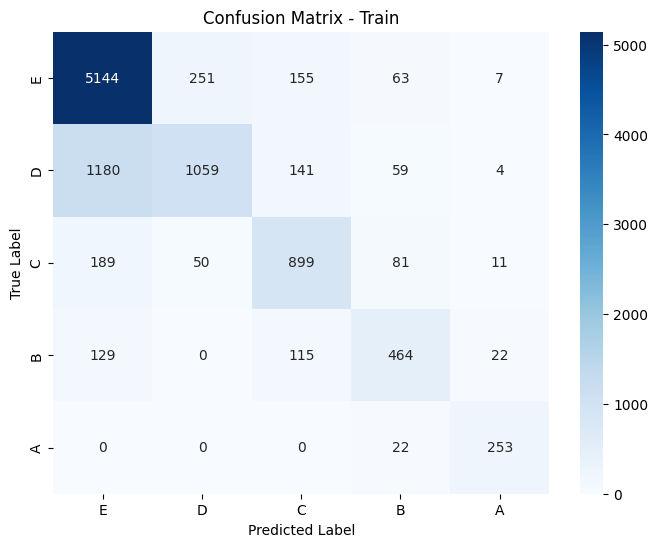

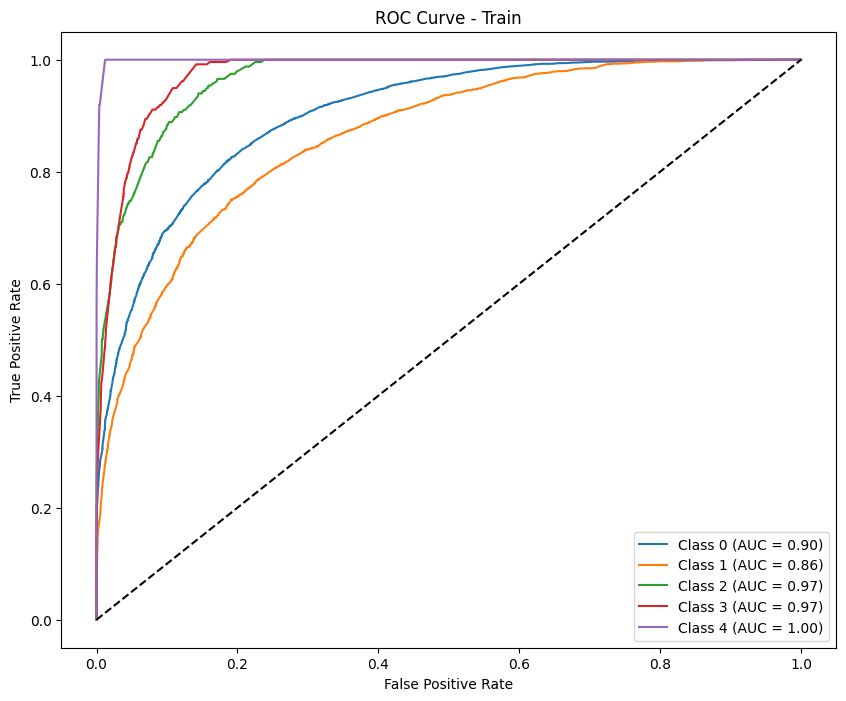

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90253262 0.28148148 0.         0.         0.        ]
Precision (per class): [0.84726225 0.44186047 0.         0.         0.        ]
Recall (per class): [0.96551724 0.20652174 0.         0.         0.        ]
Accuracy: 0.8137
AUC (One-vs-Rest): 0.7568

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.97      0.90       609
           D       0.44      0.21      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.26      0.23      0.24       746
weighted avg       0.75      0.81      0.77       746



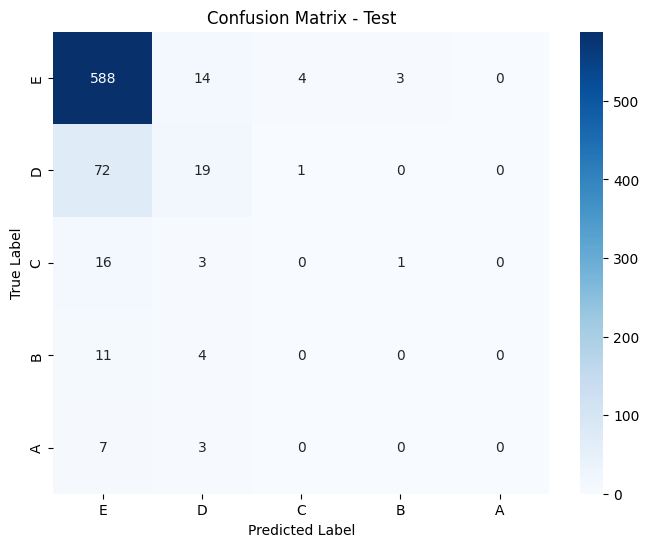

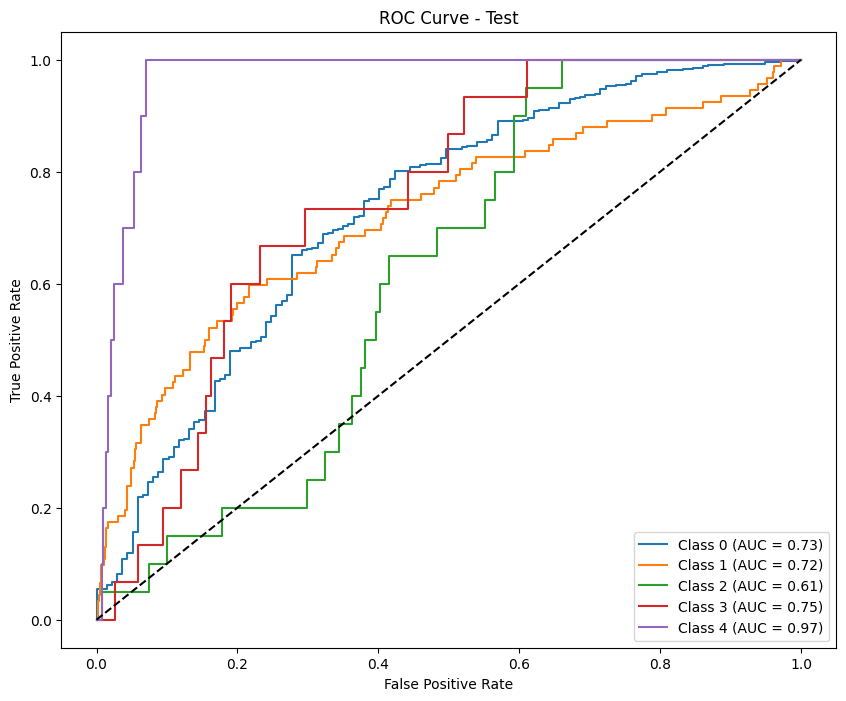

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83616679 0.59113772 0.71263452 0.66710526 0.88927944]
Precision (per class): [0.79687248 0.71247113 0.69898358 0.64177215 0.86054422]
Recall (per class): [0.87953737 0.50511666 0.72682927 0.69452055 0.92      ]
Accuracy: 0.7604
AUC (One-vs-Rest): 0.9411

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.88      0.84      5620
           D       0.71      0.51      0.59      2443
           C       0.70      0.73      0.71      1230
           B       0.64      0.69      0.67       730
           A       0.86      0.92      0.89       275

    accuracy                           0.76     10298
   macro avg       0.74      0.75      0.74     10298
weighted avg       0.76      0.76      0.75     10298



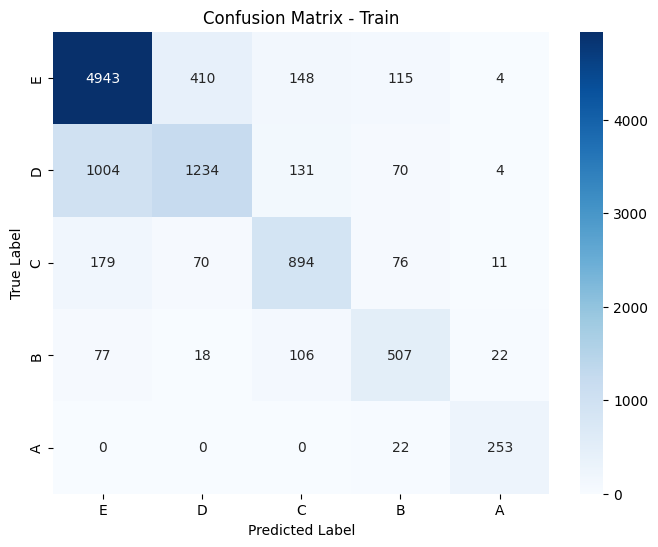

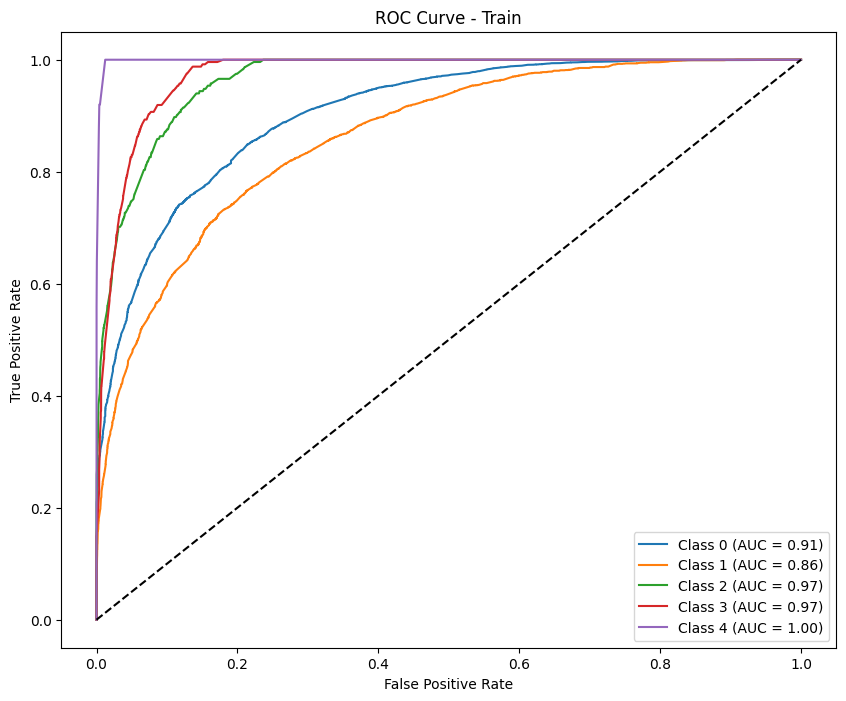

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9003861  0.28169014 0.         0.         0.        ]
Precision (per class): [0.84985423 0.4        0.         0.         0.        ]
Recall (per class): [0.95730706 0.2173913  0.         0.         0.        ]
Accuracy: 0.8083
AUC (One-vs-Rest): 0.7287

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.96      0.90       609
           D       0.40      0.22      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.25      0.23      0.24       746
weighted avg       0.74      0.81      0.77       746



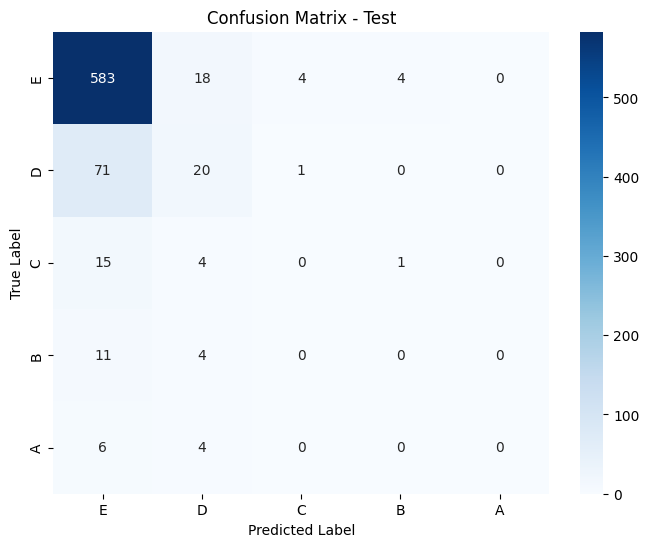

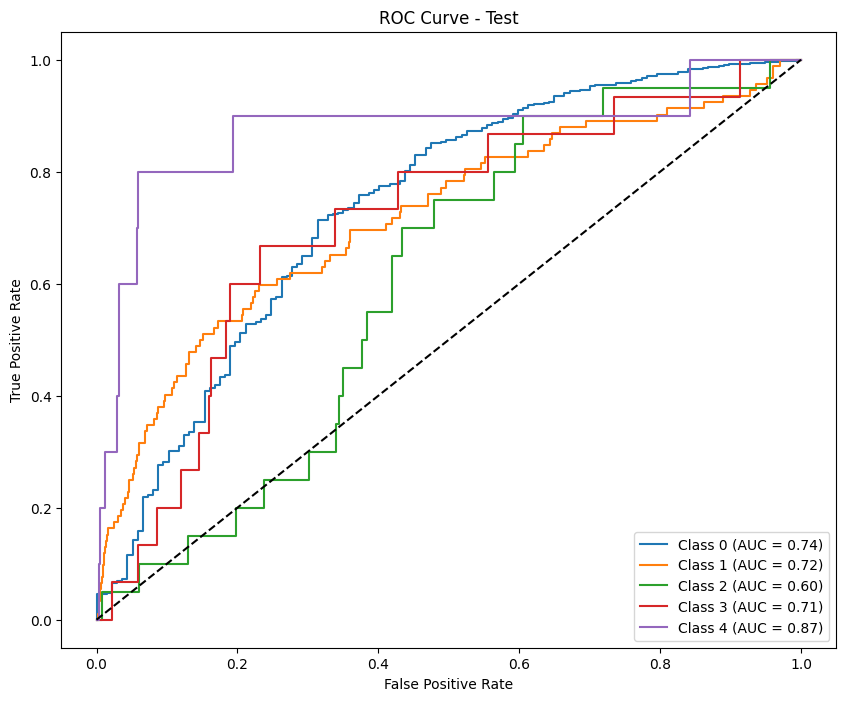


Permutation Importance for phase: phase2


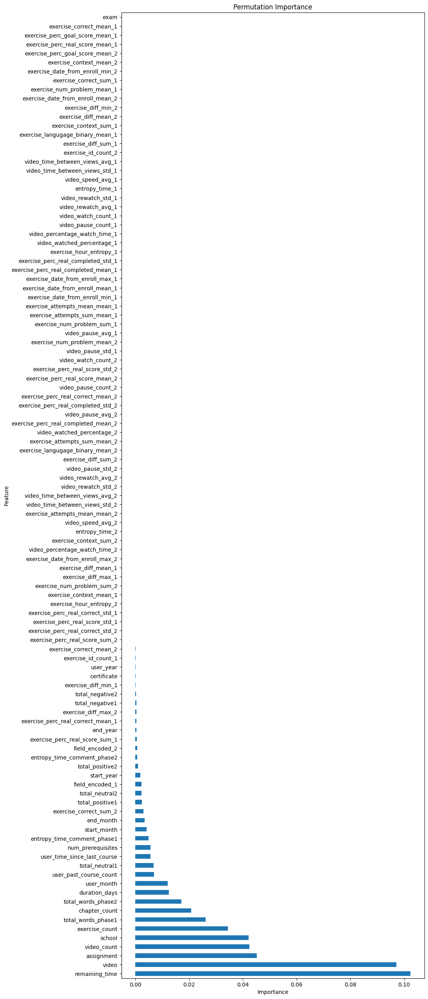

                            Feature  Importance
20                   remaining_time    0.102399
17                            video    0.097191
16                       assignment    0.045227
9                       video_count    0.042472
0                            school    0.042120
..                              ...         ...
82  exercise_perc_goal_score_mean_2   -0.000049
45  exercise_perc_real_score_mean_1   -0.000049
39  exercise_perc_goal_score_mean_1   -0.000061
24          exercise_correct_mean_1   -0.000061
18                             exam   -0.000073

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.4936320965298364, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.54566386159604, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.37914595946404, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.744005374822336, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.788004015017577, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.7648366835946945, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.721764713124685, tolerance: 0.9432695799951406

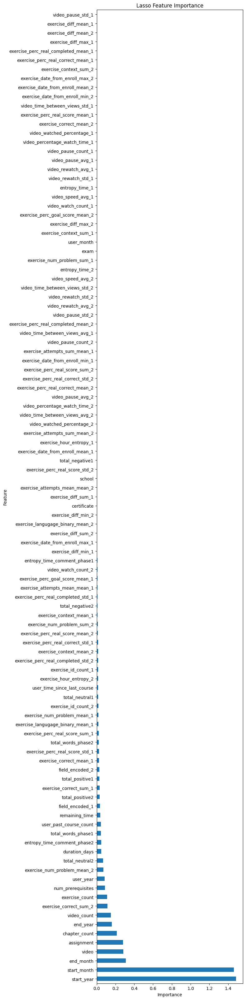

                                Feature  Importance
3                            start_year    1.482769
4                           start_month    1.460831
6                             end_month    0.308565
17                                video    0.282938
16                           assignment    0.281418
..                                  ...         ...
40  exercise_perc_real_completed_mean_1    0.000000
38                  exercise_diff_max_1    0.000000
79                 exercise_diff_mean_2    0.000000
36                 exercise_diff_mean_1    0.000000
53                    video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                               Feature  Importance
15                         certificate    0.121778
17                               video    0.113294
16                          assignment    0.055450
10                      exercise_count    0.023375
14                   num_prerequisi

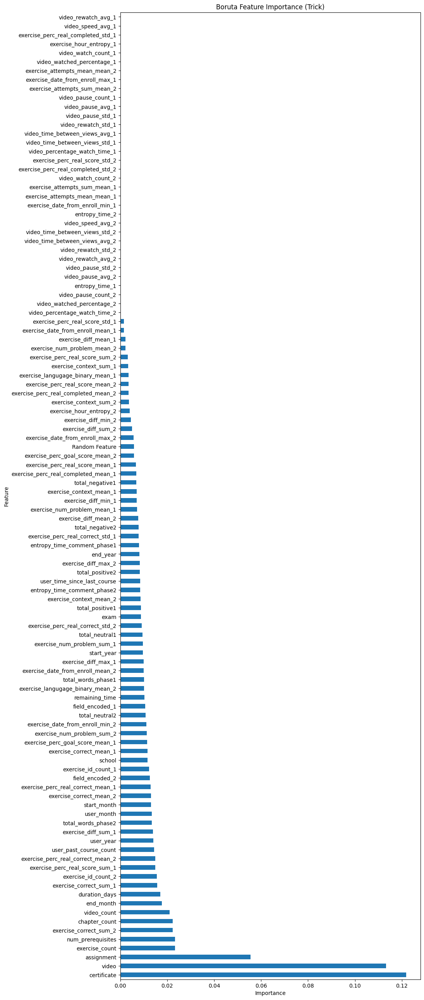

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84372177 0.58127258 0.72263993 0.68368032 0.86642599]
Precision (per class): [0.78540195 0.78117999 0.72023314 0.65089514 0.84210526]
Recall (per class): [0.91139735 0.46283186 0.72506287 0.71994342 0.89219331]
Accuracy: 0.7673
AUC (One-vs-Rest): 0.9457

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      5124
           D       0.78      0.46      0.58      2260
           C       0.72      0.73      0.72      1193
           B       0.65      0.72      0.68       707
           A       0.84      0.89      0.87       269

    accuracy                           0.77      9553
   macr

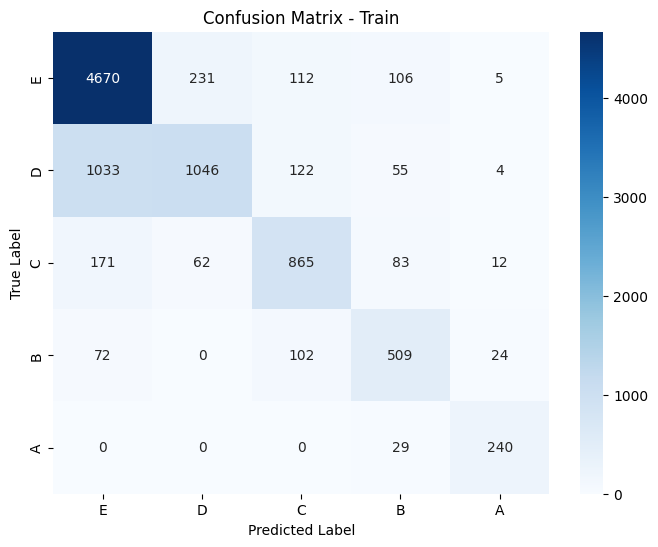

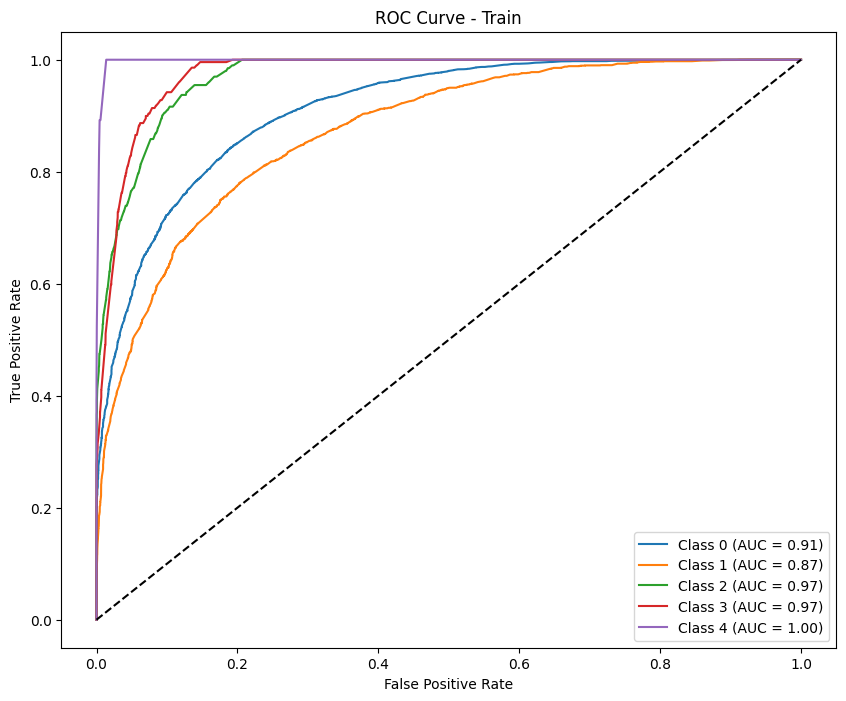

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89184953 0.125      0.08333333 0.         0.        ]
Precision (per class): [0.82703488 0.28       0.25       0.         0.        ]
Recall (per class): [0.96768707 0.08045977 0.05       0.         0.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.6462

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.08      0.12        87
           C       0.25      0.05      0.08        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.27      0.22      0.22       721
weighted avg       0.72      0.80      0.74       721



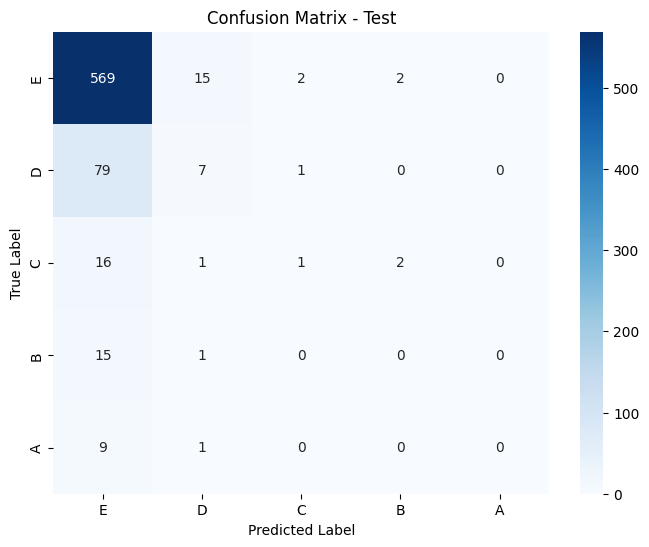

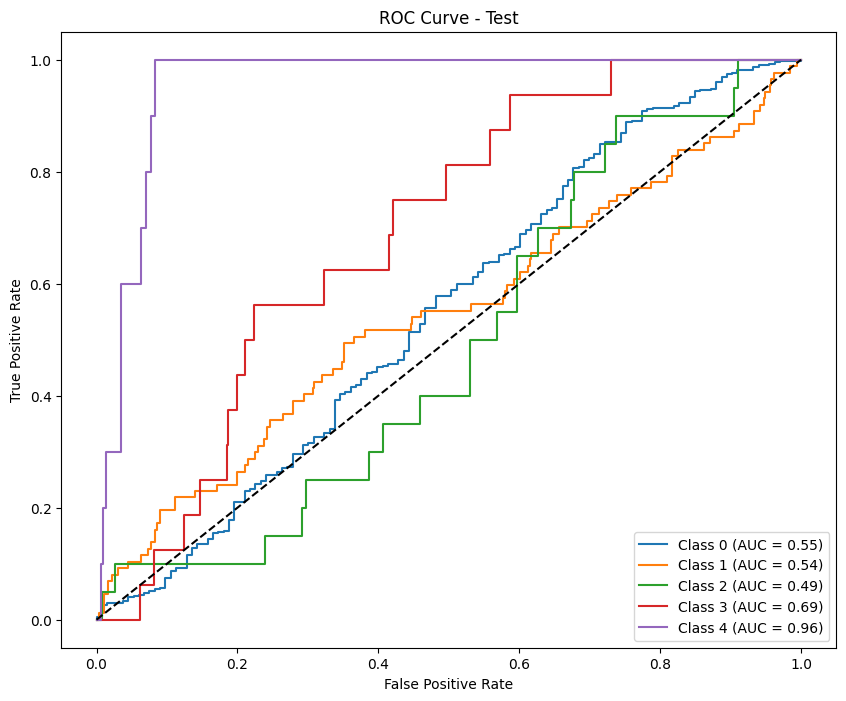

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84161892 0.61077844 0.72522898 0.68724832 0.87114338]
Precision (per class): [0.7992278  0.74193548 0.72043011 0.65389527 0.85106383]
Recall (per class): [0.88875878 0.51902655 0.7300922  0.7241867  0.89219331]
Accuracy: 0.7694
AUC (One-vs-Rest): 0.9462

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.74      0.52      0.61      2260
           C       0.72      0.73      0.73      1193
           B       0.65      0.72      0.69       707
           A       0.85      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.75      0.75      0.75      9553
weighted avg       0.77      0.77      0.76      9553



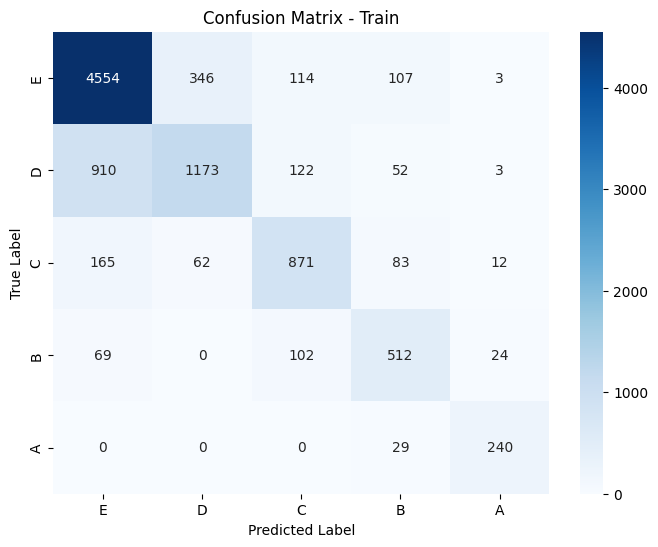

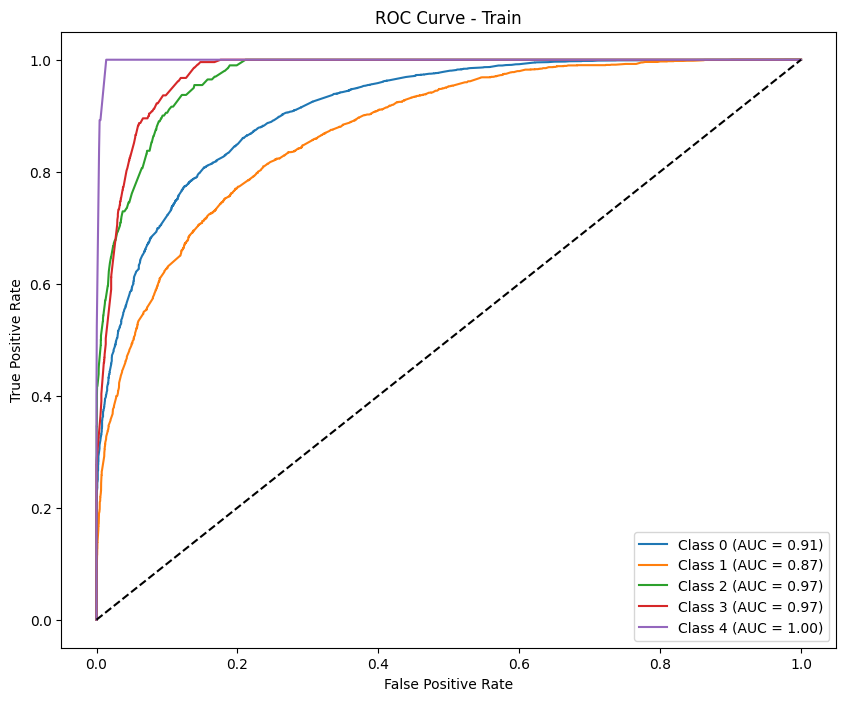

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8923802  0.13793103 0.         0.         0.        ]
Precision (per class): [0.82919708 0.27586207 0.         0.         0.        ]
Recall (per class): [0.96598639 0.09195402 0.         0.         0.        ]
Accuracy: 0.7989
AUC (One-vs-Rest): 0.6167

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.09      0.14        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.22      0.21      0.21       721
weighted avg       0.71      0.80      0.74       721



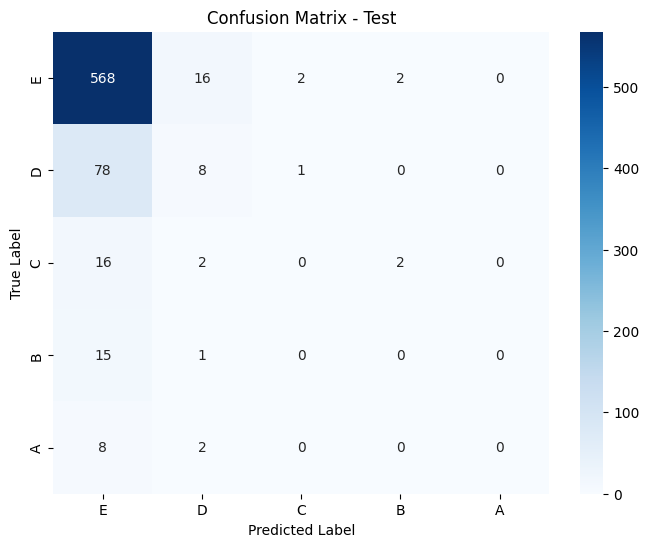

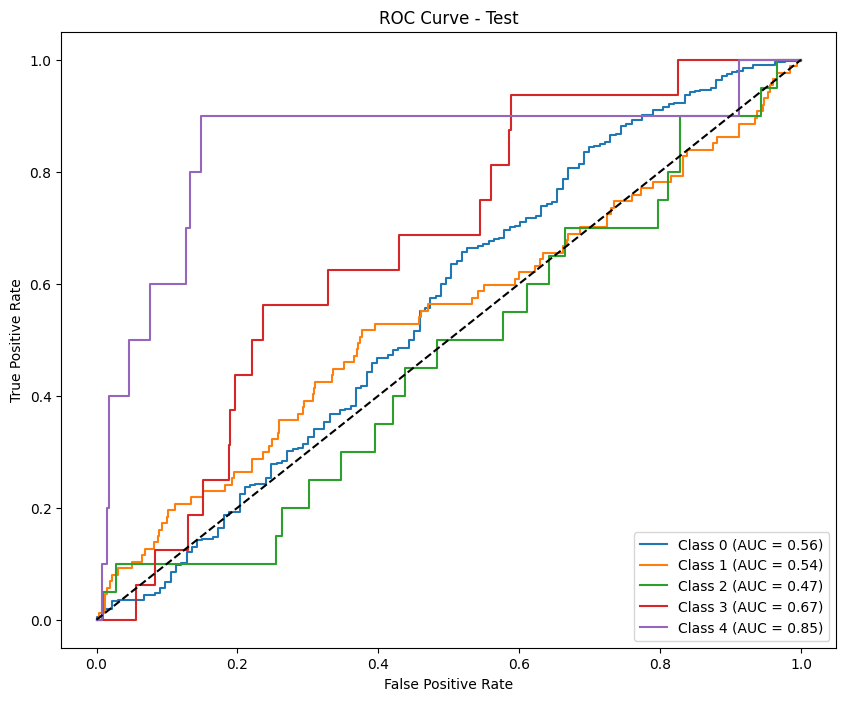

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_standard_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85500544 0.6346229  0.81690141 0.76490747 0.90410959]
Precision (per class): [0.81742523 0.83111566 0.79248506 0.6975     0.825     ]
Recall (per class): [0.89620758 0.51327434 0.84287012 0.84673748 1.        ]
Accuracy: 0.8021
AUC (One-vs-Rest): 0.9594

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.90      0.86      3507
           D       0.83      0.51      0.63      1582
           C       0.79      0.84      0.82      1101
           B       0.70      0.85      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.80      7113
   macr

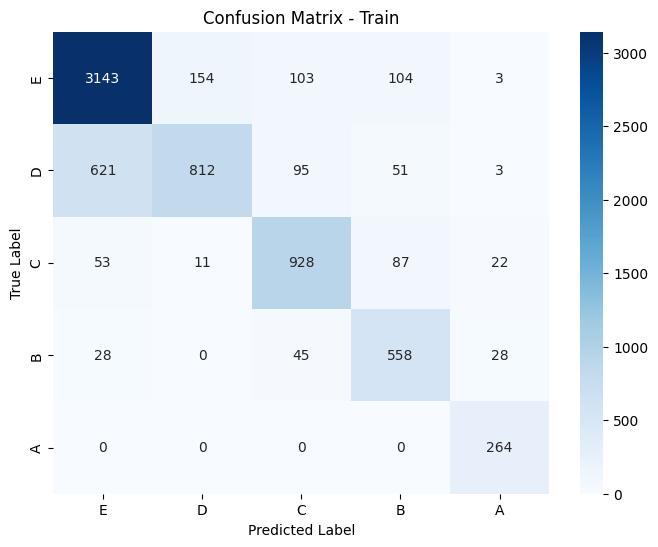

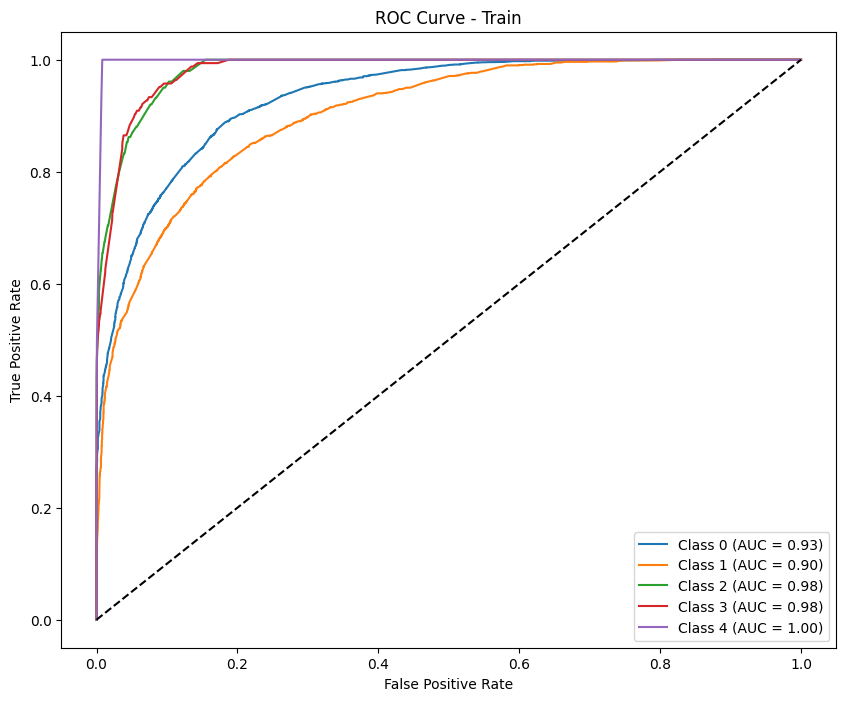

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87593672 0.03703704 0.         0.         0.        ]
Precision (per class): [0.81424149 0.08695652 0.         0.         0.        ]
Recall (per class): [0.94774775 0.02352941 0.         0.         0.        ]
Accuracy: 0.7686
AUC (One-vs-Rest): 0.5852

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.95      0.88       555
           D       0.09      0.02      0.04        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.77       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.77      0.71       687



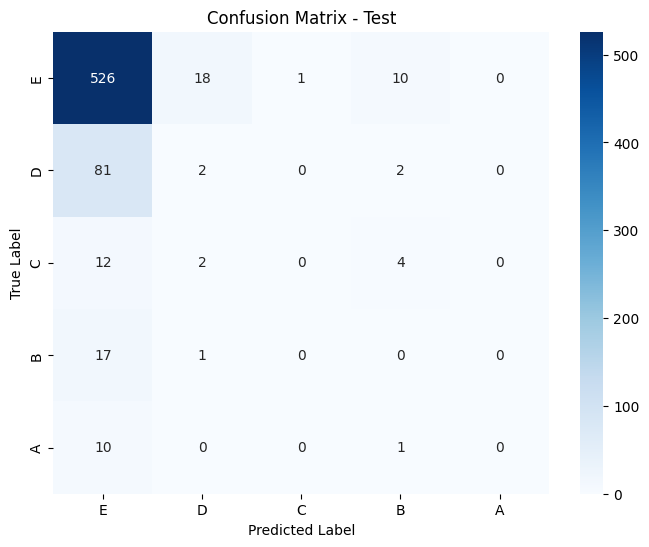

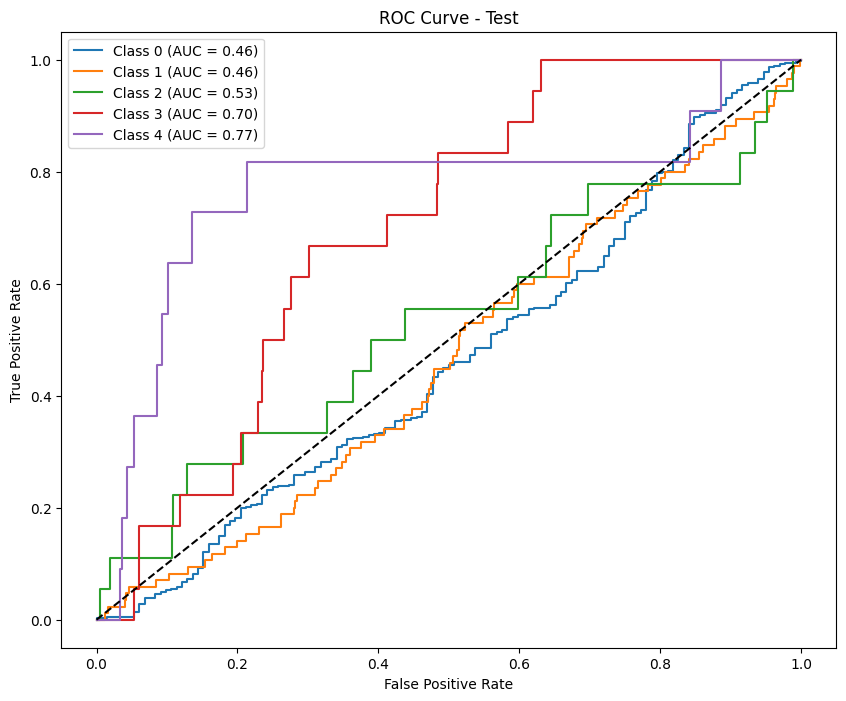

Results saved as test_results_calibrate_undersample_standard_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85564738 0.64971537 0.81726112 0.76641842 0.90566038]
Precision (per class): [0.82760458 0.81291548 0.79316239 0.69193154 0.82758621]
Recall (per class): [0.88565726 0.54108723 0.84287012 0.85887709 1.        ]
Accuracy: 0.8042
AUC (One-vs-Rest): 0.9599

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.89      0.86      3507
           D       0.81      0.54      0.65      1582
           C       0.79      0.84      0.82      1101
           B       0.69      0.86      0.77       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.79      0.83      0.80      7113
weighted avg       0.81      0.80      0.80      7113



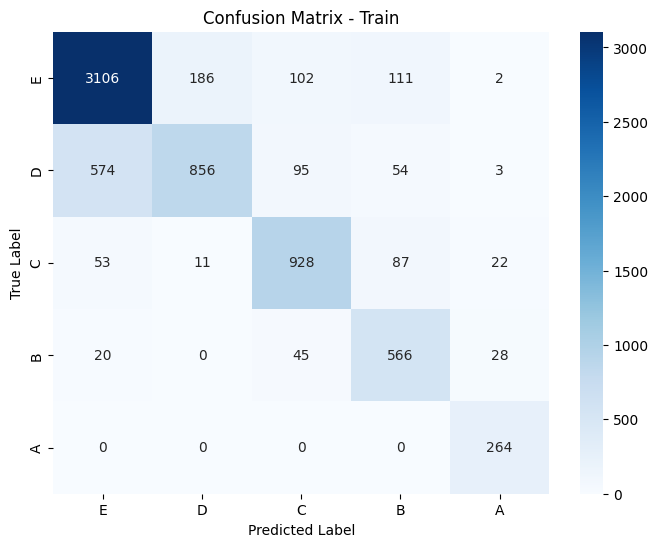

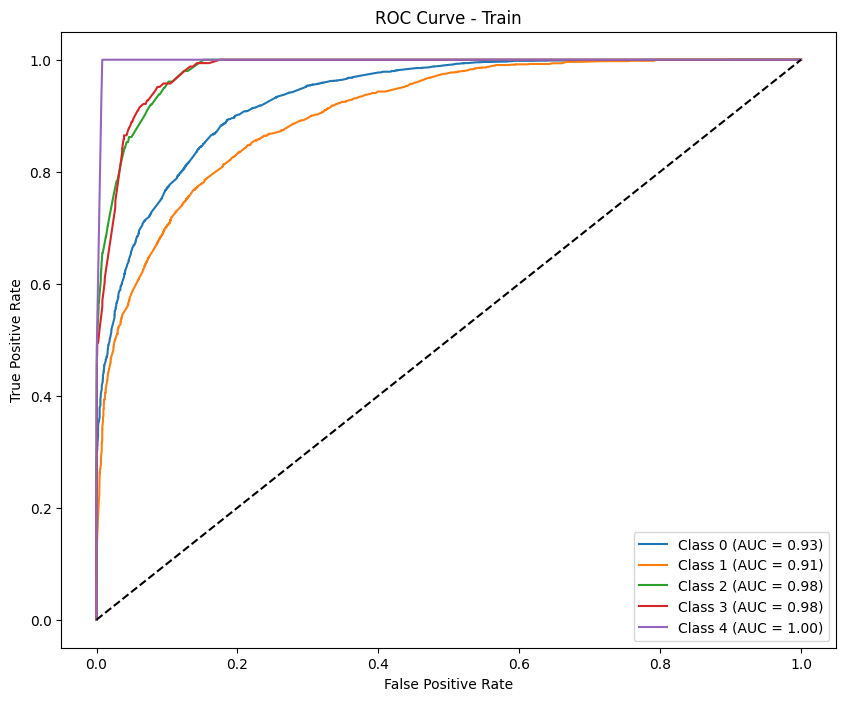

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87102178 0.03478261 0.         0.         0.        ]
Precision (per class): [0.81377152 0.06666667 0.         0.         0.        ]
Recall (per class): [0.93693694 0.02352941 0.         0.         0.        ]
Accuracy: 0.7598
AUC (One-vs-Rest): 0.5719

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.94      0.87       555
           D       0.07      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.76       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.76      0.71       687



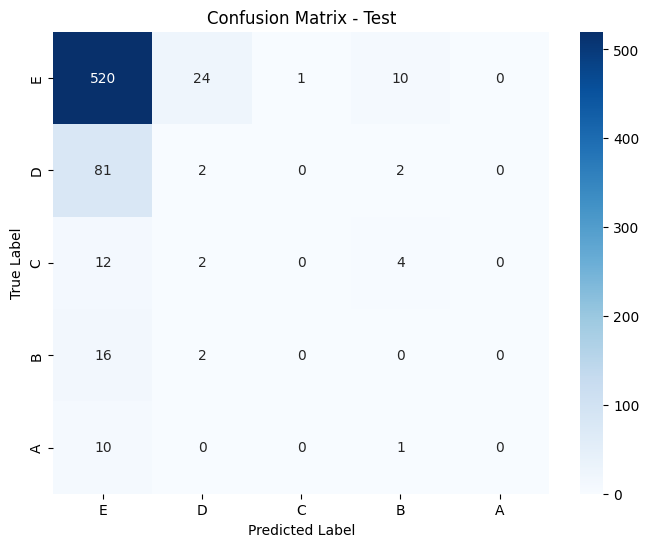

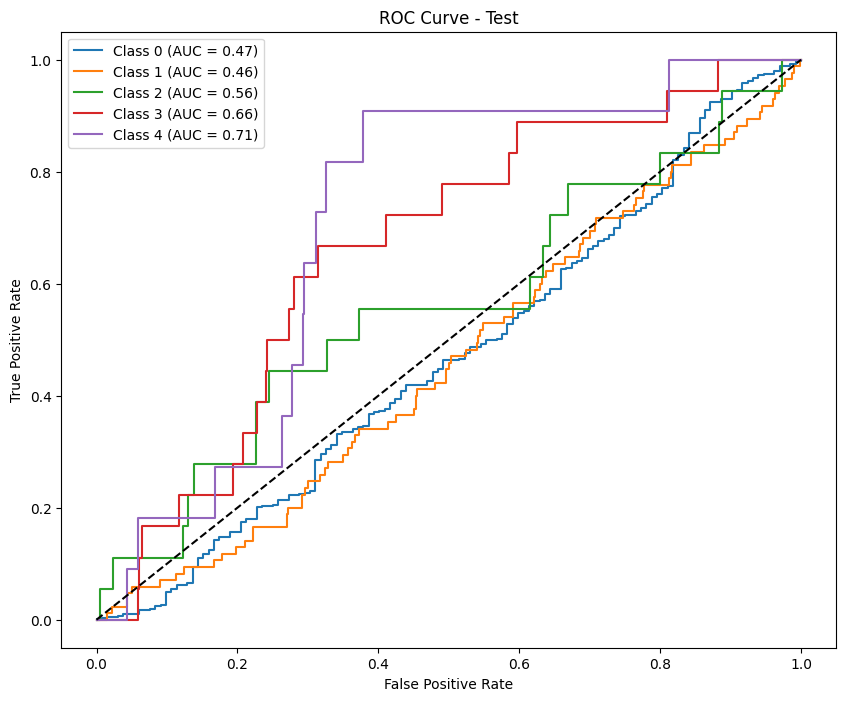

In [19]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, scale='standard', metric='f1_macro')

### Tạo mẫu ảo 

In [20]:
# !pip install -U imbalanced-learn

In [21]:
# khoi dong lai kernal
# import os
# os.kill(os.getpid(), 9)

In [22]:
# from imblearn.over_sampling import SMOTE

# def apply_smote(X, y):
#     smote = SMOTE(sampling_strategy=0.4, random_state=42) 
#     X_resampled, y_resampled = smote.fit_resample(X, y)
#     return X_resampled, y_resampled

In [23]:
# # Đọc và xử lý dữ liệu cho từng phase
# def process_smote_phase(phase, scale='standard', metric='accuracy'):
#     # Đọc dữ liệu
#     X_train, y_train, X_test, y_test = load_data(phase)
#     X_train, y_train = apply_smote(X_train, y_train)
#     # Scale dữ liệu
#     X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
#     X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
#     X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
#     # Thiết lập StratifiedKFold
#     skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
#     # Định nghĩa mô hình XGBoost
#     model = XGBClassifier(random_state=42)
    
#     # Định nghĩa các tham số cần tìm kiếm (cho GridSearchCV hoặc RandomizedSearchCV)
#     param_grid = {
#         'max_depth': [7, 9],
#         'learning_rate': [0.02, 0.1],
#         'n_estimators': [200],
#         'subsample': [0.7, 0.8],
#         'colsample_bytree': [0.7, 0.8, 0.9]
#     }
    
#     # Sử dụng GridSearchCV hoặc RandomizedSearchCV
#     # GridSearchCV: Thử tất cả các kết hợp tham số
#     # grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=skf, scoring='accuracy', n_jobs=-1)
    
#     # RandomizedSearchCV: Thử ngẫu nhiên một số lượng tham số
#     randomized_search = RandomizedSearchCV(
#         estimator=model,
#         param_distributions=param_grid,
#         n_iter=35,
#         cv=skf,
#         scoring=metric,
#         random_state=42,
#         n_jobs=-1,
#         verbose=2 
#     )
    
#     # Huấn luyện mô hình với RandomizedSearchCV
#     randomized_search.fit(X_train_scaled, y_train)
    
#     # In ra tham số tốt nhất
#     print(f"Best Parameters for phase {phase}: {randomized_search.best_params_}")
#     best_params = randomized_search.best_params_

#     # Dự đoán trên tập test
#     y_pred = randomized_search.best_estimator_.predict(X_test_scaled)
    
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(randomized_search.best_estimator_, X_train_scaled, y_train, X_test_scaled, y_test)

#     # Tính toán calibrate model
#     calibrate_train_model = calibrate_model(randomized_search.best_estimator_, X_train_scaled, y_train)
#     # Dự đoán trên tập test
#     y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_calibrate_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_calibrate_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)
    
#     print("\nBoruta Trick:")
#     important_features = boruta_trick(randomized_search.best_estimator_, X_train_scaled, y_train)

In [24]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='standard', metric='f1_macro')

# 2. Scale dữ liệu theo Robust 

### robust

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

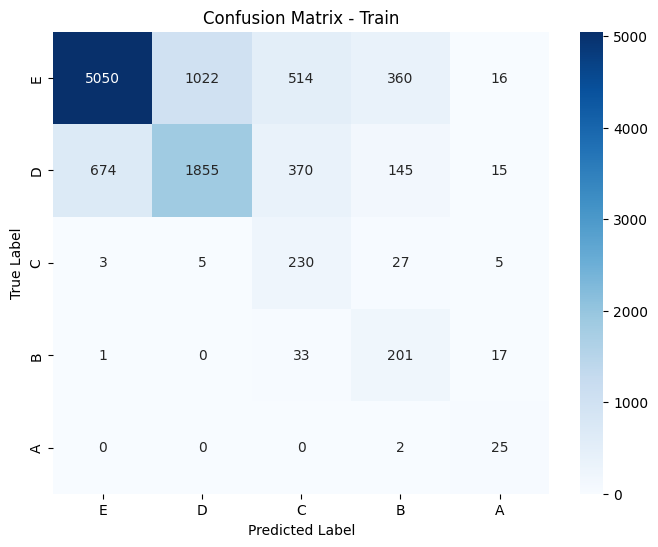

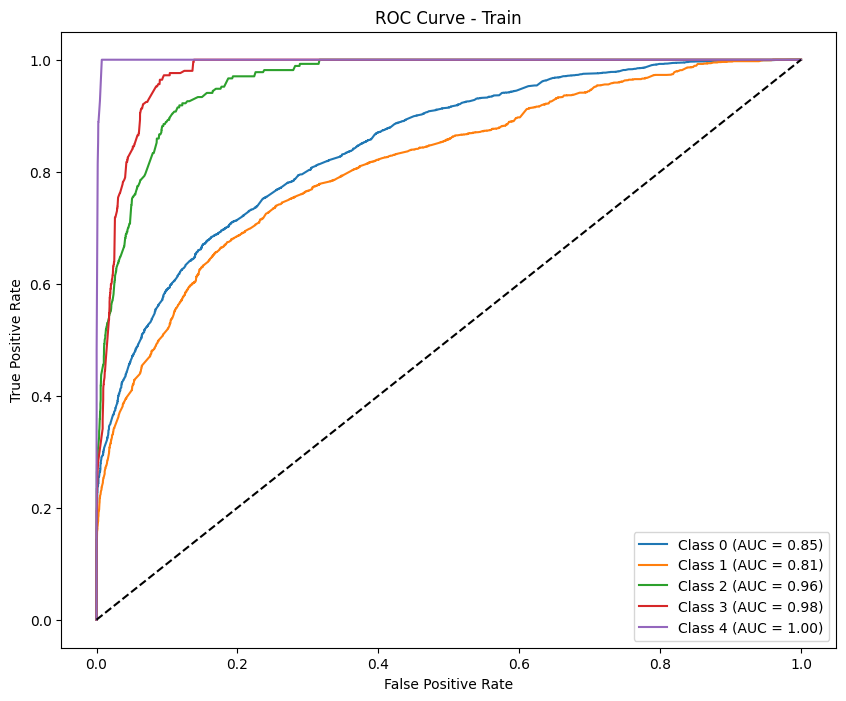

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90923318 0.4260355  0.         0.         0.        ]
Precision (per class): [0.8776435 0.48      0.        0.        0.       ]
Recall (per class): [0.94318182 0.38297872 0.         0.         0.        ]
Accuracy: 0.8161
AUC (One-vs-Rest): 0.7952

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.94      0.91       616
           D       0.48      0.38      0.43        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       756
   macro avg       0.27      0.27      0.27       756
weighted avg       0.77      0.82      0.79       756



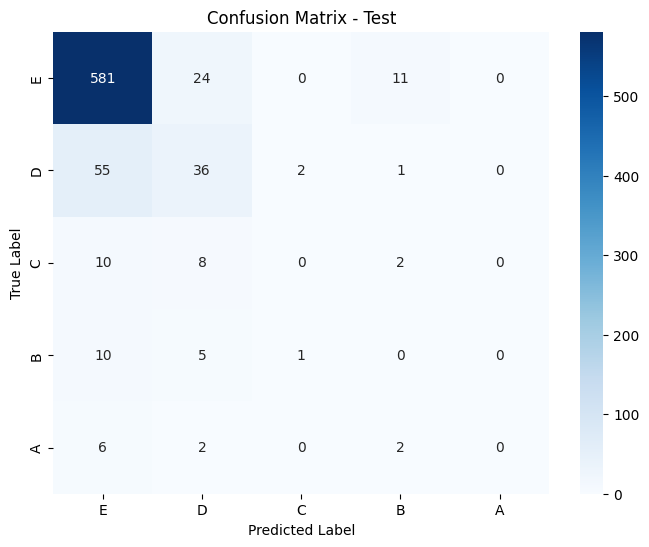

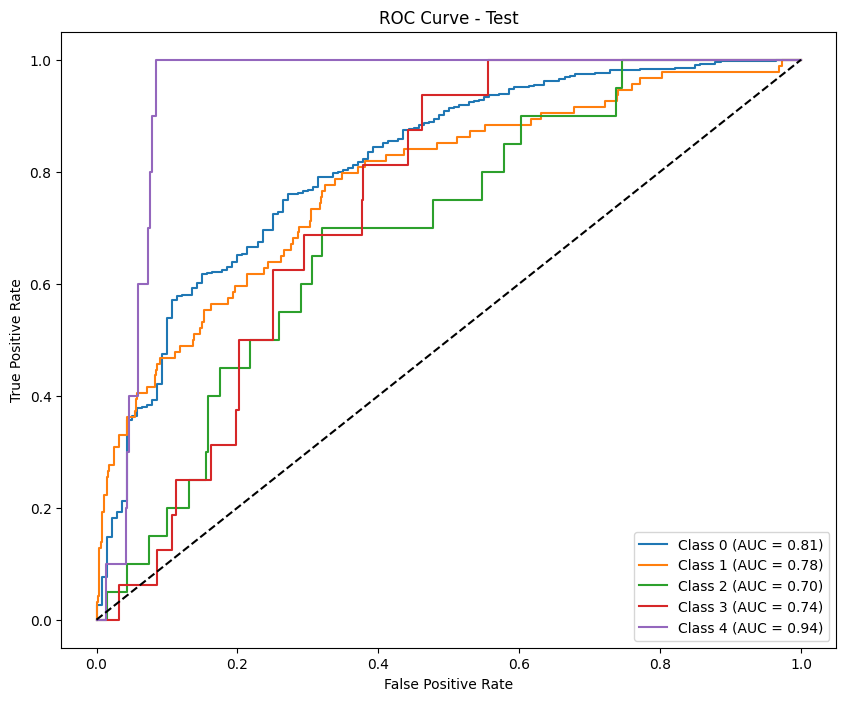

Results saved as test_results_calibrate_robust_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.84385871 0.59070885 0.50943396 0.49916805 0.65671642]
Precision (per class): [0.78975707 0.7622739  0.51923077 0.42979943 0.55      ]
Recall (per class): [0.90591784 0.48218372 0.5        0.5952381  0.81481481]
Accuracy: 0.7653
AUC (One-vs-Rest): 0.9284

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      6962
           D       0.76      0.48      0.59      3059
           C       0.52      0.50      0.51       270
           B       0.43      0.60      0.50       252
           A       0.55      0.81      0.66        27

    accuracy                           0.77     10570
   macro avg       0.61      0.66      0.62     10570
weighted avg       0.77      0.77      0.75     10570



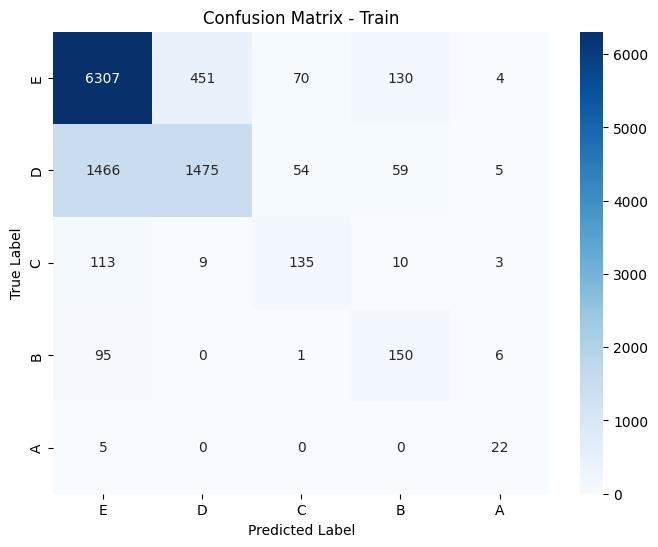

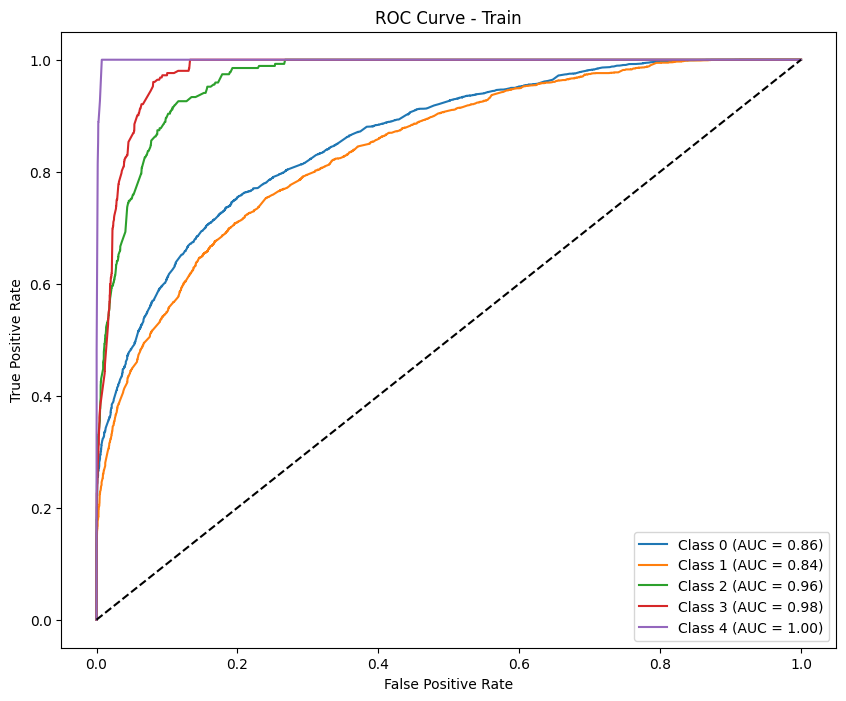

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91238671 0.39130435 0.         0.         0.        ]
Precision (per class): [0.85310734 0.61363636 0.         0.         0.        ]
Recall (per class): [0.98051948 0.28723404 0.         0.         0.        ]
Accuracy: 0.8347
AUC (One-vs-Rest): 0.7426

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.98      0.91       616
           D       0.61      0.29      0.39        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.83      0.79       756



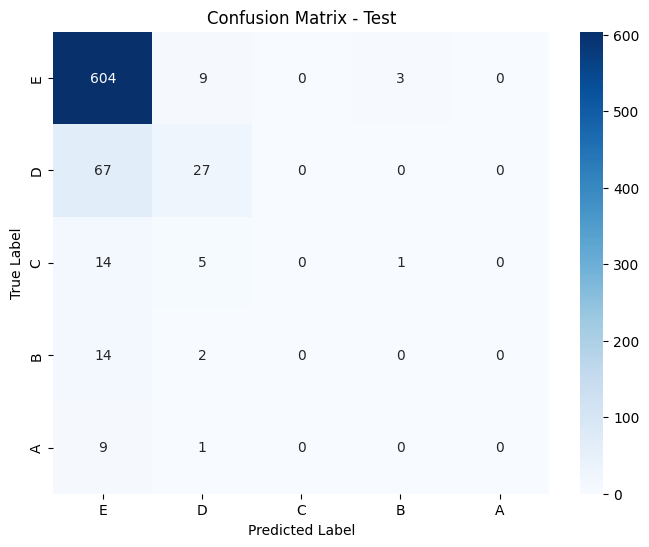

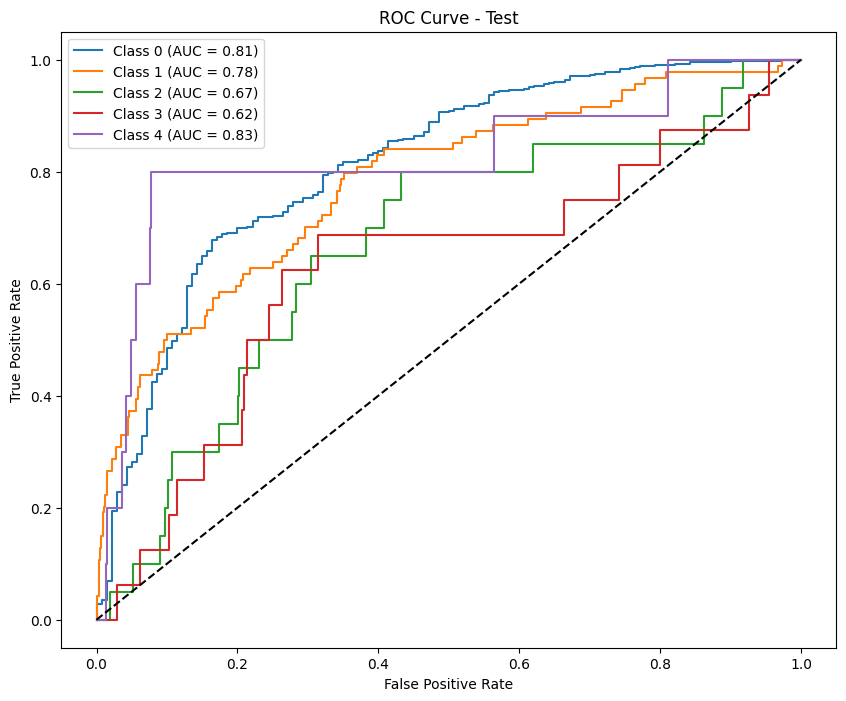


-------------Permutation Importance for phase: phase1---------


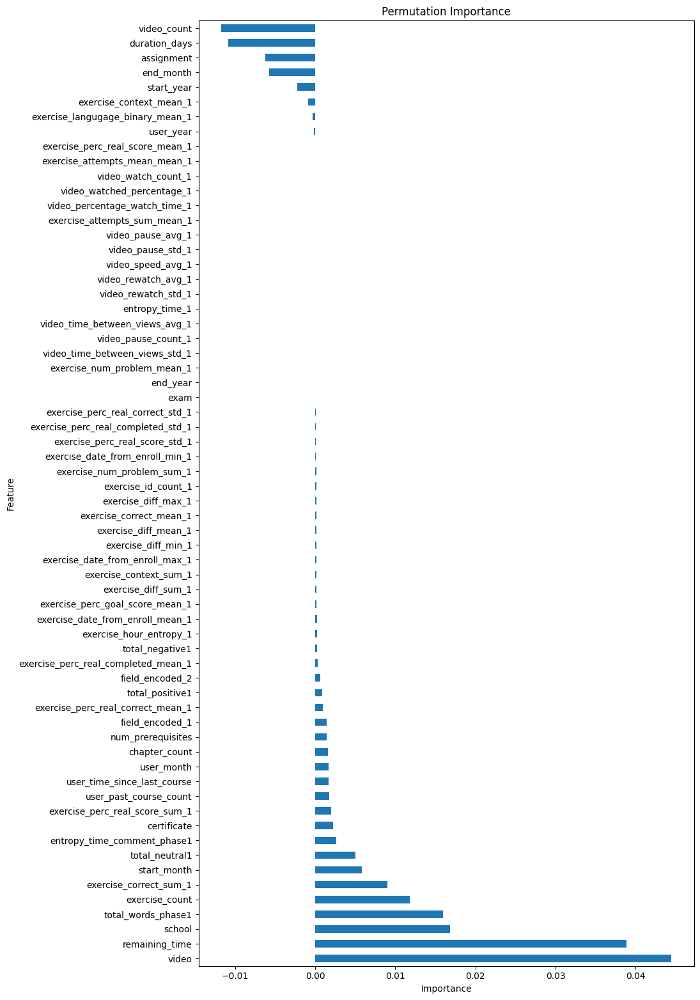

               Feature  Importance
17               video    0.044465
20      remaining_time    0.038895
0               school    0.016864
60  total_words_phase1    0.015989
10      exercise_count    0.011838
..                 ...         ...
3           start_year   -0.002259
6            end_month   -0.005747
16          assignment   -0.006232
19       duration_days   -0.010868
9          video_count   -0.011743

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


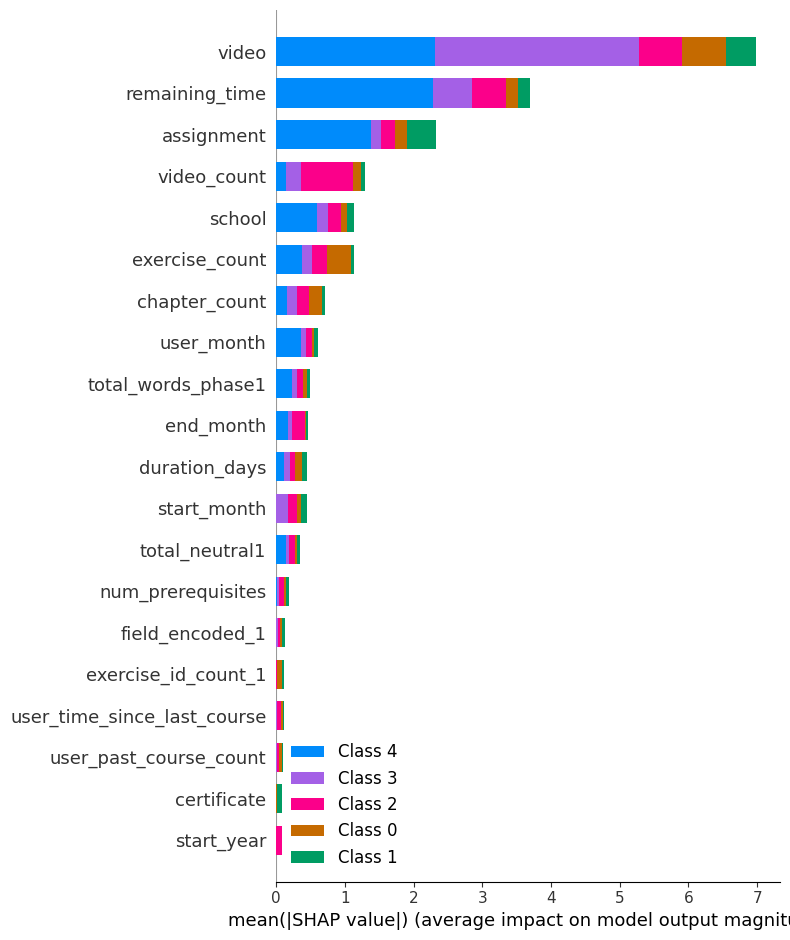


-----Lasso Feature Selection for phase: phase1----------


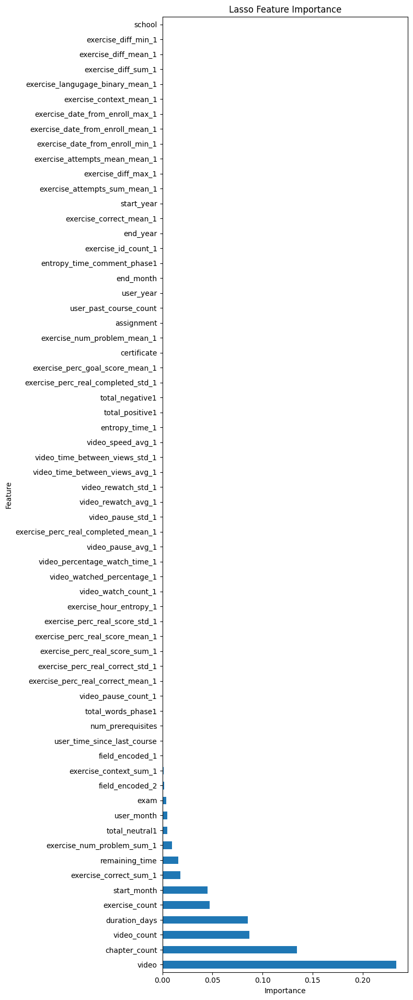

                             Feature  Importance
17                             video    0.233465
11                     chapter_count    0.134253
9                        video_count    0.087082
19                     duration_days    0.085149
10                    exercise_count    0.047206
..                               ...         ...
34  exercise_langugage_binary_mean_1    0.000000
35               exercise_diff_sum_1    0.000000
36              exercise_diff_mean_1    0.000000
37               exercise_diff_min_1    0.000000
0                             school    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                              Feature  Importance
15                        certificate    0.213204
44     exercise_perc_real_score_sum_1    0.146342
22                exercise_id_count_1    0.052200
17                              video    0.041661
42  exercise_perc_real_correct_mean_1    0.032843


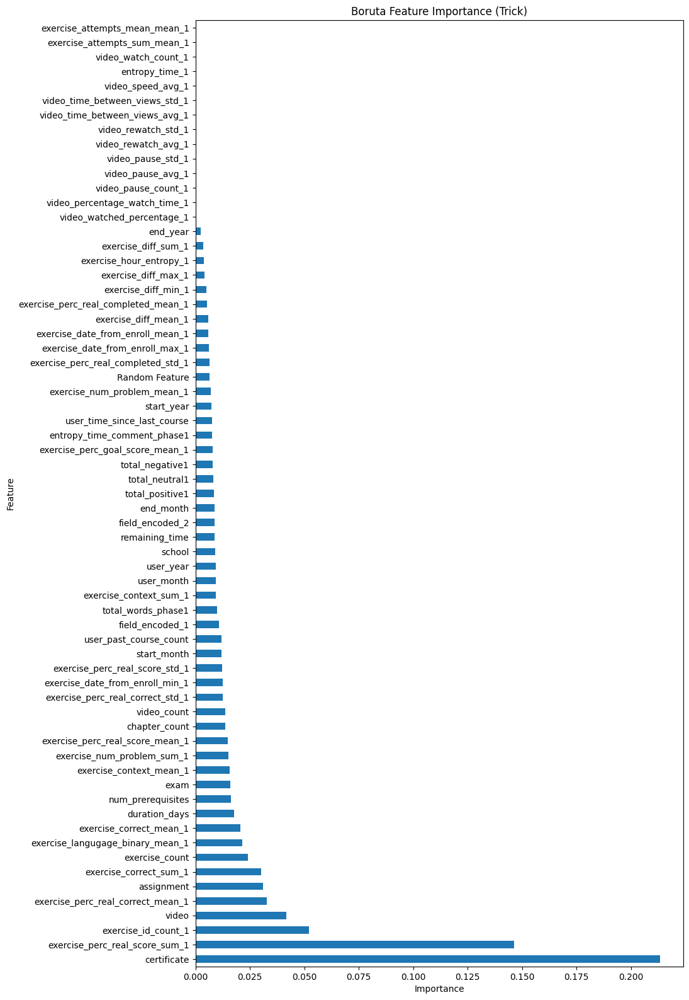

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Label: 0 --> Weight: 0.3042
Label: 1 --> Weight: 0.6998
Label: 2 --> Weight: 7.4330
Label: 3 --> Weight: 7.4330
Label: 4 --> Weight: 68.3840
Results saved as test_results_robust_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.78795015 0.60915999 0.34874759 0.43722944 0.62162162]
Precision (per class): [0.8783636  0.61129431 0.2240099  0.29106628 0.46938776]
Recall (per class): [0.71441281 0.60704052 0.78695652 0.87826087 0.92      ]
Accuracy: 0.6907
AUC (One-vs-Rest): 0.9134

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.71      0.79      5620
           D       0.61      0.61      0.61      2443
           C       0.22      0.79      0.35       230
           B       

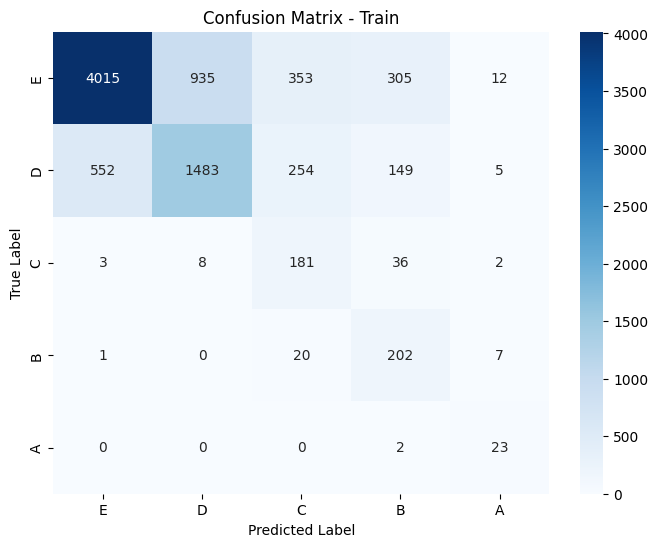

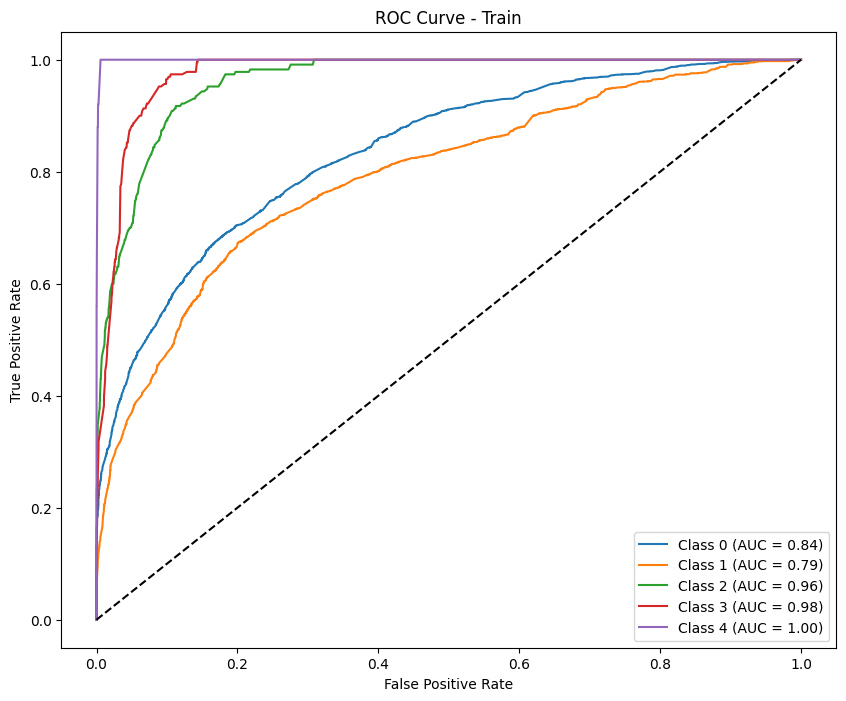


--- Test Metrics ---
F1 Score (per class): [0.8654311  0.26666667 0.         0.03076923 0.        ]
Precision (per class): [0.84968354 0.34482759 0.         0.02       0.        ]
Recall (per class): [0.8817734  0.2173913  0.         0.06666667 0.        ]
Accuracy: 0.7480
AUC (One-vs-Rest): 0.6801

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.88      0.87       609
           D       0.34      0.22      0.27        92
           C       0.00      0.00      0.00        20
           B       0.02      0.07      0.03        15
           A       0.00      0.00      0.00        10

    accuracy                           0.75       746
   macro avg       0.24      0.23      0.23       746
weighted avg       0.74      0.75      0.74       746



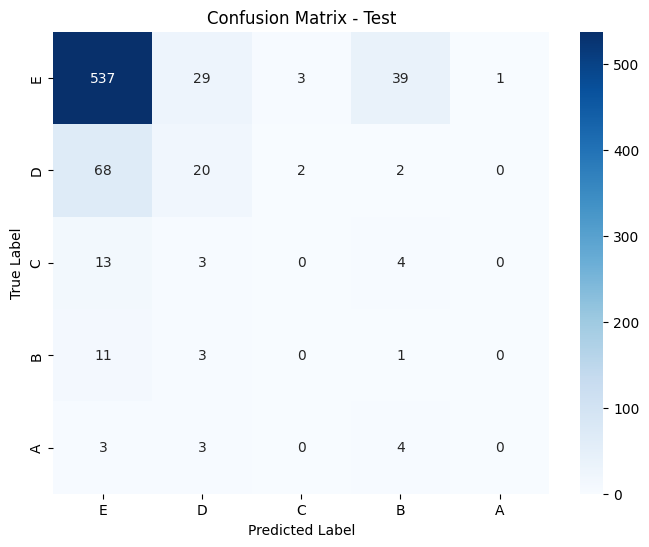

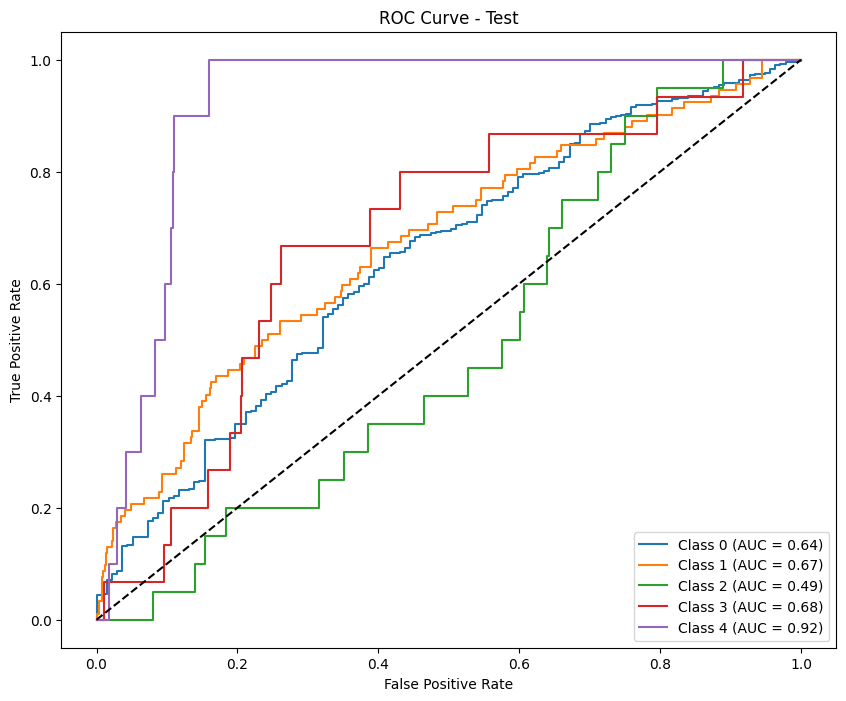

Results saved as test_results_calibrate_robust_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.83837797 0.56118036 0.52609603 0.5        0.68656716]
Precision (per class): [0.78505979 0.74126344 0.5060241  0.42424242 0.54761905]
Recall (per class): [0.89946619 0.45149406 0.54782609 0.60869565 0.92      ]
Accuracy: 0.7542
AUC (One-vs-Rest): 0.9230

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      5620
           D       0.74      0.45      0.56      2443
           C       0.51      0.55      0.53       230
           B       0.42      0.61      0.50       230
           A       0.55      0.92      0.69        25

    accuracy                           0.75      8548
   macro avg       0.60      0.69      0.62      8548
weighted avg       0.75      0.75      0.74      8548



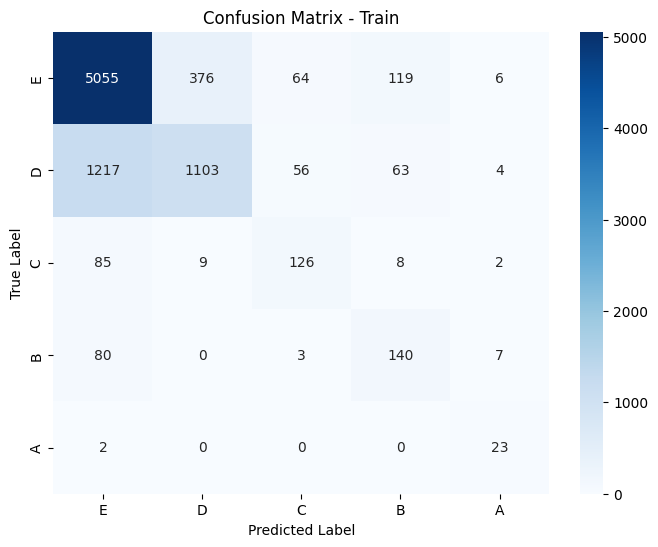

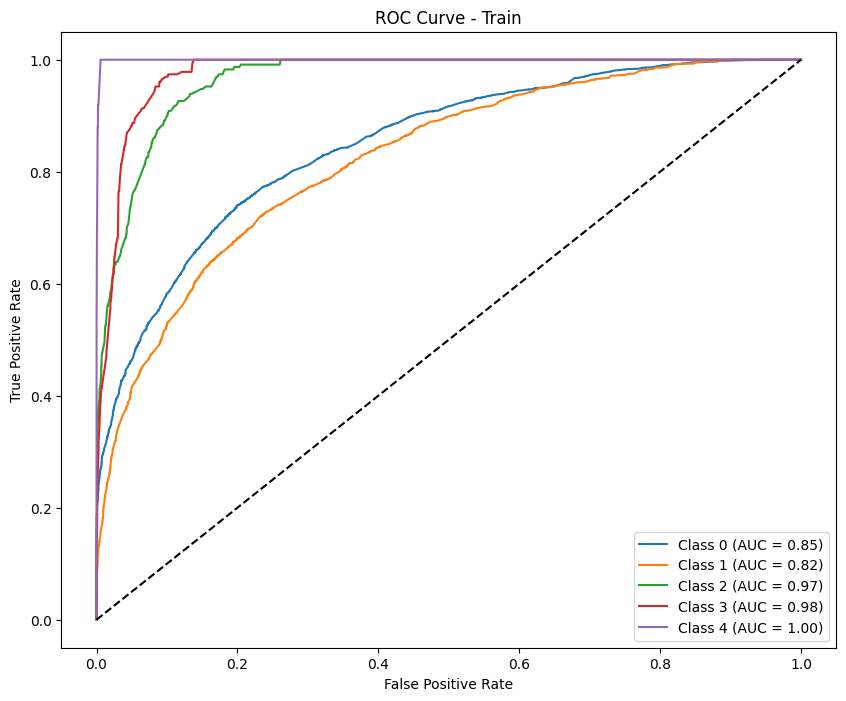

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.892261   0.17699115 0.         0.06451613 0.        ]
Precision (per class): [0.82933709 0.47619048 0.         0.0625     0.        ]
Recall (per class): [0.96551724 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.8029
AUC (One-vs-Rest): 0.6680

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       609
           D       0.48      0.11      0.18        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.80       746
   macro avg       0.27      0.23      0.23       746
weighted avg       0.74      0.80      0.75       746



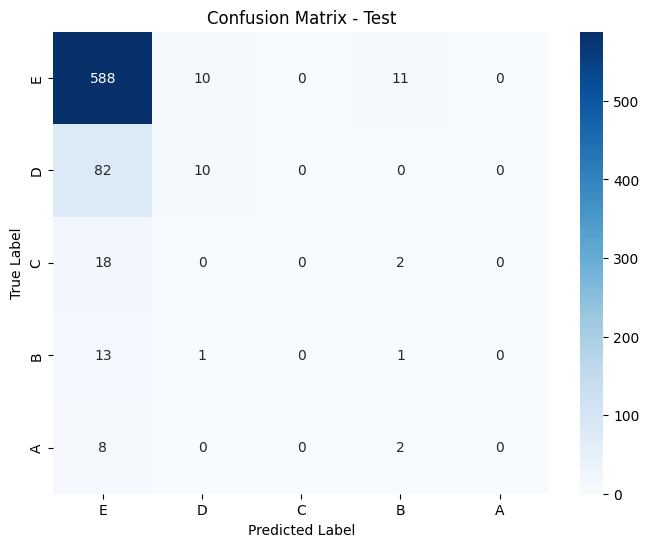

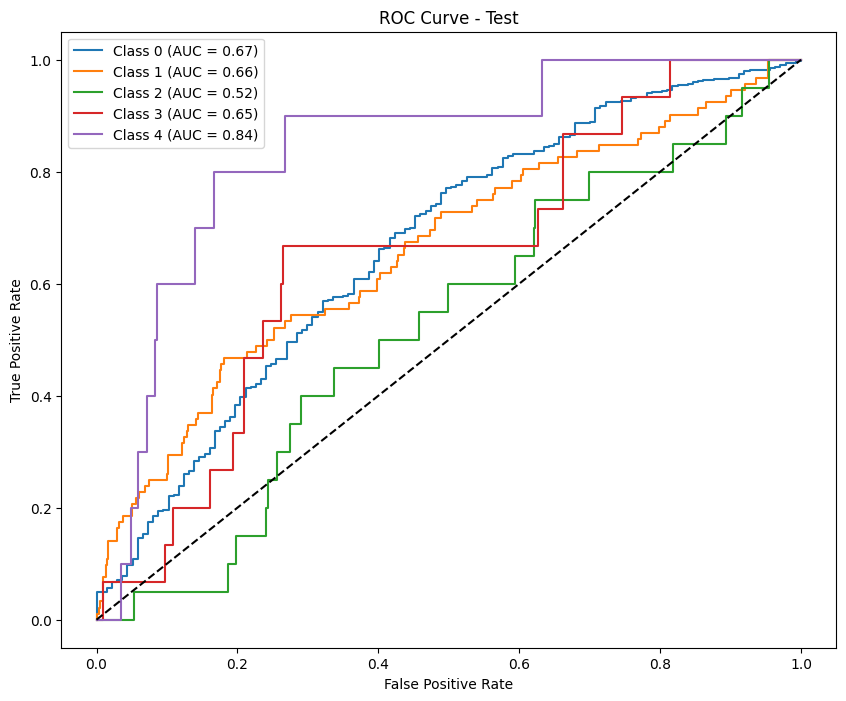


-------------Permutation Importance for phase: phase2---------


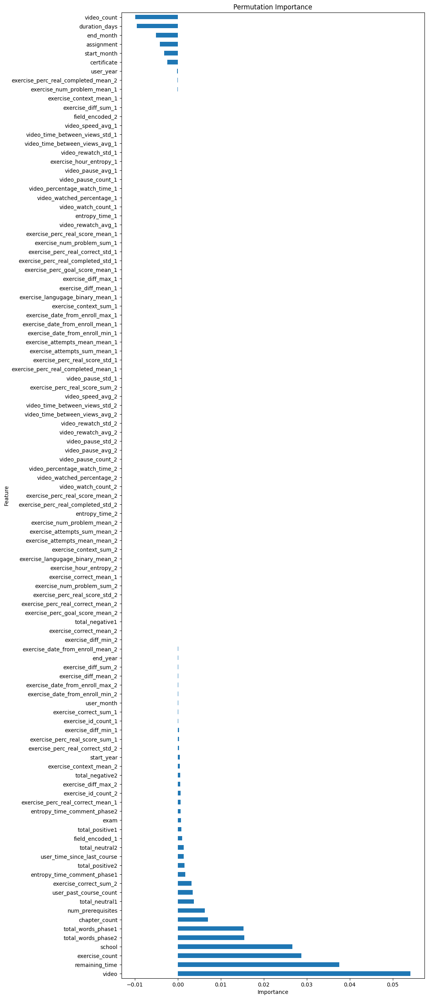

                Feature  Importance
17                video    0.054165
20       remaining_time    0.037597
10       exercise_count    0.028793
0                school    0.026658
103  total_words_phase2    0.015428
..                  ...         ...
4           start_month   -0.003203
16           assignment   -0.004182
6             end_month   -0.005104
19        duration_days   -0.009564
9           video_count   -0.009944

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


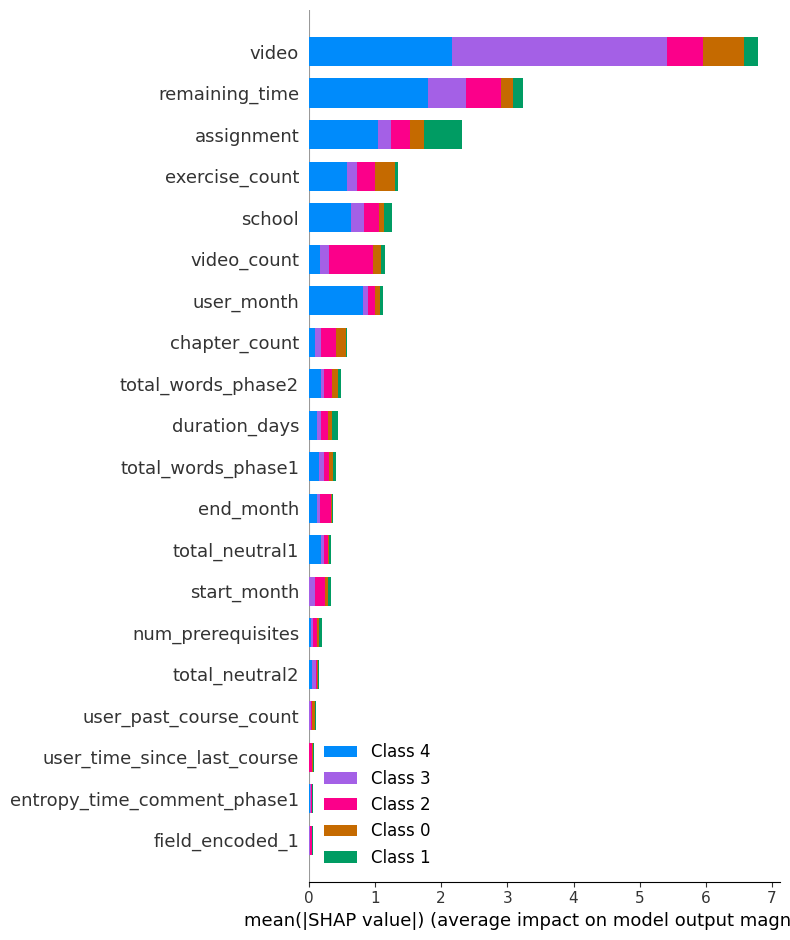


-----Lasso Feature Selection for phase: phase2----------


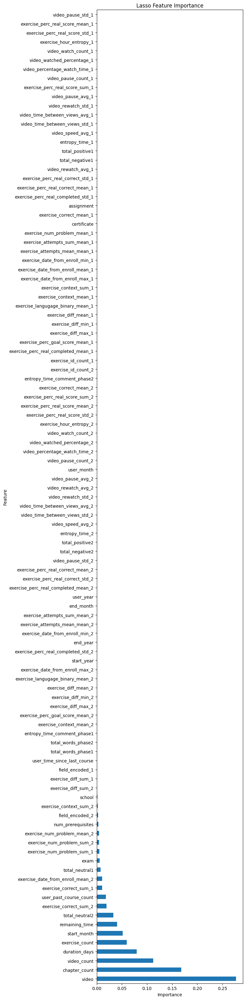

                            Feature  Importance
17                            video    0.276941
11                    chapter_count    0.168214
9                       video_count    0.112384
19                    duration_days    0.079778
10                   exercise_count    0.059750
..                              ...         ...
48              video_watch_count_1    0.000000
47          exercise_hour_entropy_1    0.000000
46   exercise_perc_real_score_std_1    0.000000
45  exercise_perc_real_score_mean_1    0.000000
53                video_pause_std_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                                Feature  Importance
15                          certificate    0.178661
17                                video    0.038542
16                           assignment    0.030408
40  exercise_perc_real_completed_mean_1    0.028679
66               exercise_correct_sum_2    0.027875

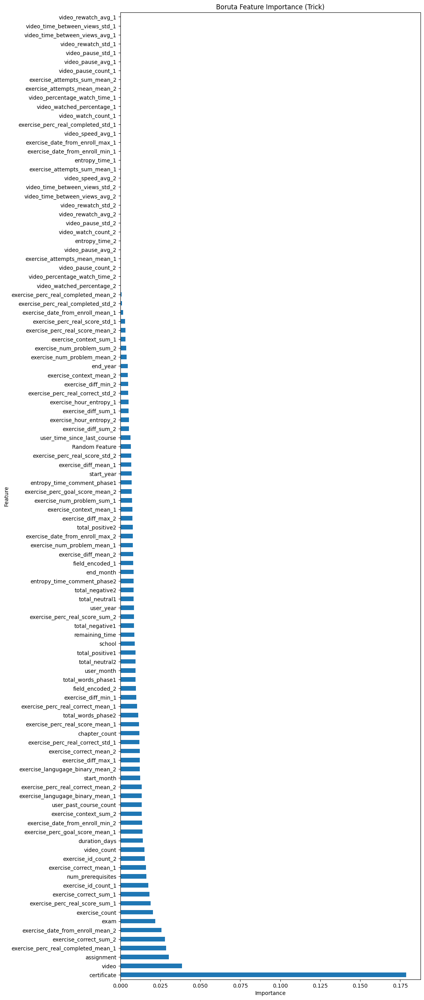

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Label: 0 --> Weight: 0.3046
Label: 1 --> Weight: 0.6905
Label: 2 --> Weight: 8.0860
Label: 3 --> Weight: 7.5391
Label: 4 --> Weight: 82.1368
Results saved as test_results_robust_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.79982973 0.62068966 0.35227273 0.41388175 0.44705882]
Precision (per class): [0.87947578 0.62828649 0.22561863 0.28196147 0.28787879]
Recall (per class): [0.7334114  0.61327434 0.80310881 0.77777778 1.        ]
Accuracy: 0.7022
AUC (One-vs-Rest): 0.9196

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.73      0.80      5124
           D       0.63      0.61      0.62      2260
           C       0.23      0.80      0.35       193
           B       

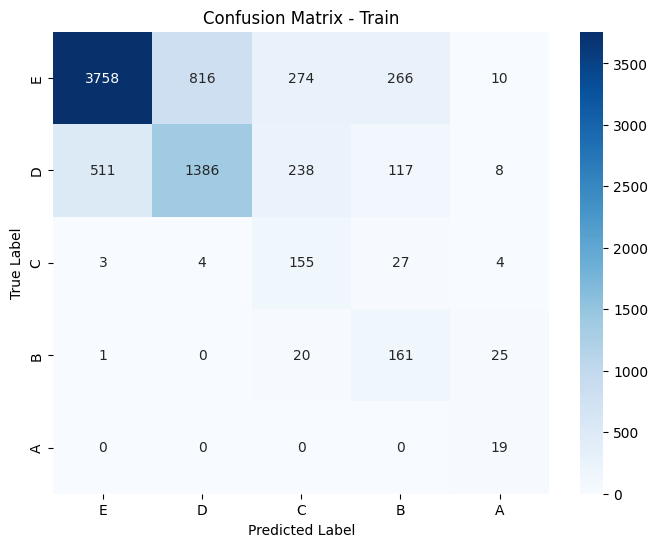

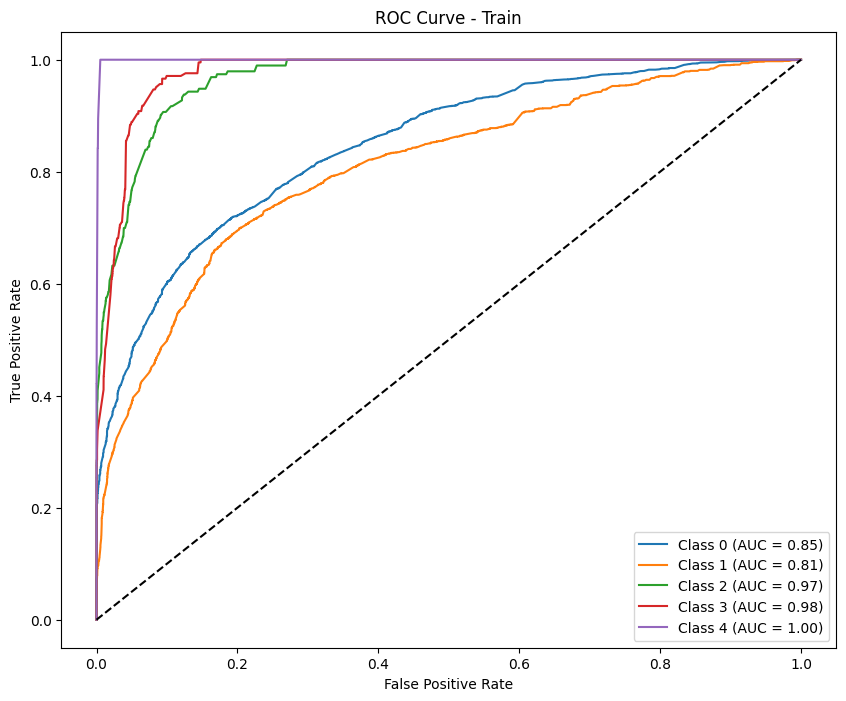

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.78144514 0.15957447 0.         0.04255319 0.        ]
Precision (per class): [0.8217636  0.14851485 0.         0.02564103 0.        ]
Recall (per class): [0.74489796 0.17241379 0.         0.125      0.        ]
Accuracy: 0.6311
AUC (One-vs-Rest): 0.6195

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.74      0.78       588
           D       0.15      0.17      0.16        87
           C       0.00      0.00      0.00        20
           B       0.03      0.12      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.63       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.63      0.66       721



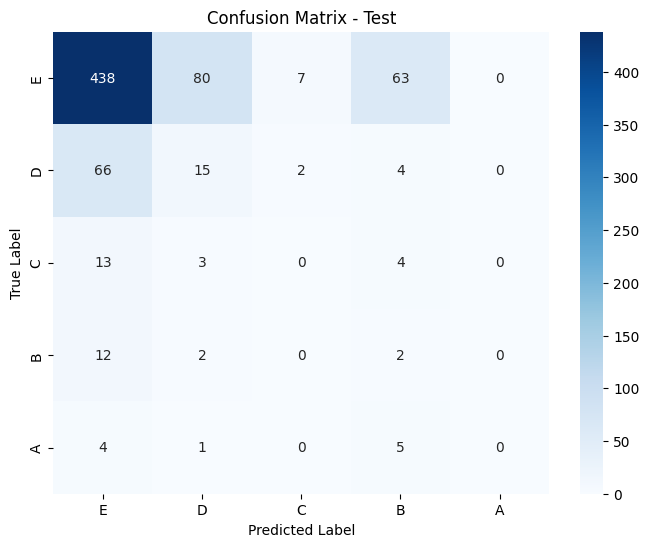

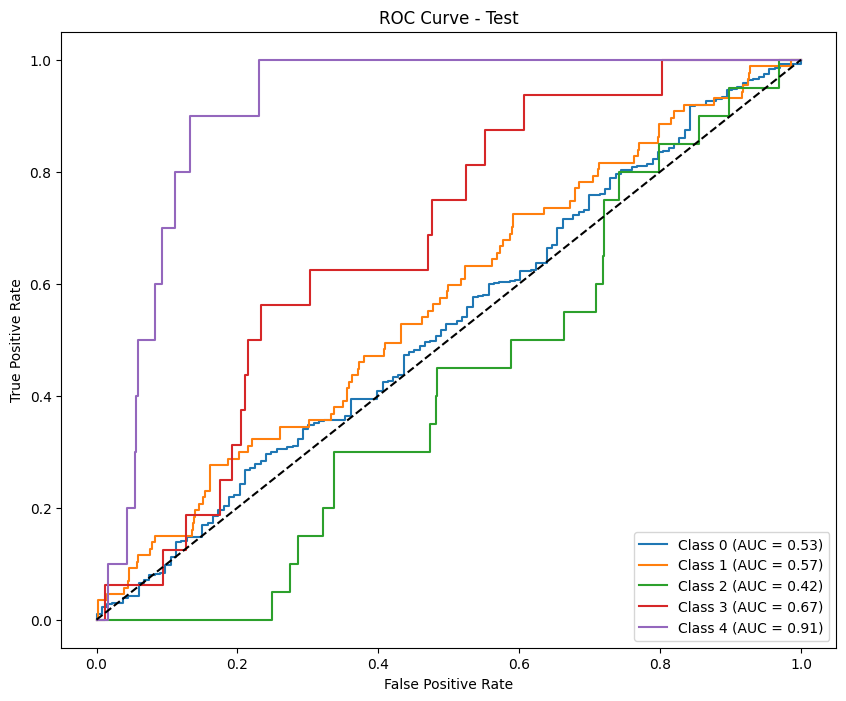

Results saved as test_results_calibrate_robust_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.83941269 0.59465128 0.54320988 0.51881188 0.64150943]
Precision (per class): [0.79666959 0.72972973 0.51886792 0.43959732 0.5       ]
Recall (per class): [0.88700234 0.50176991 0.56994819 0.63285024 0.89473684]
Accuracy: 0.7609
AUC (One-vs-Rest): 0.9287

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.73      0.50      0.59      2260
           C       0.52      0.57      0.54       193
           B       0.44      0.63      0.52       207
           A       0.50      0.89      0.64        19

    accuracy                           0.76      7803
   macro avg       0.60      0.70      0.63      7803
weighted avg       0.76      0.76      0.75      7803



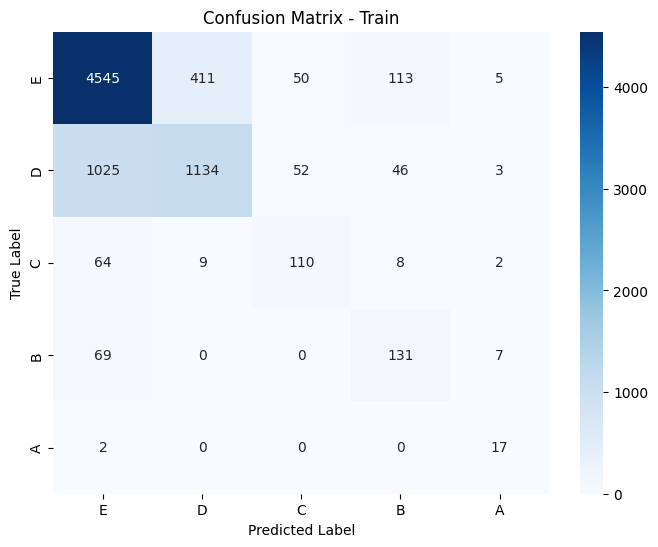

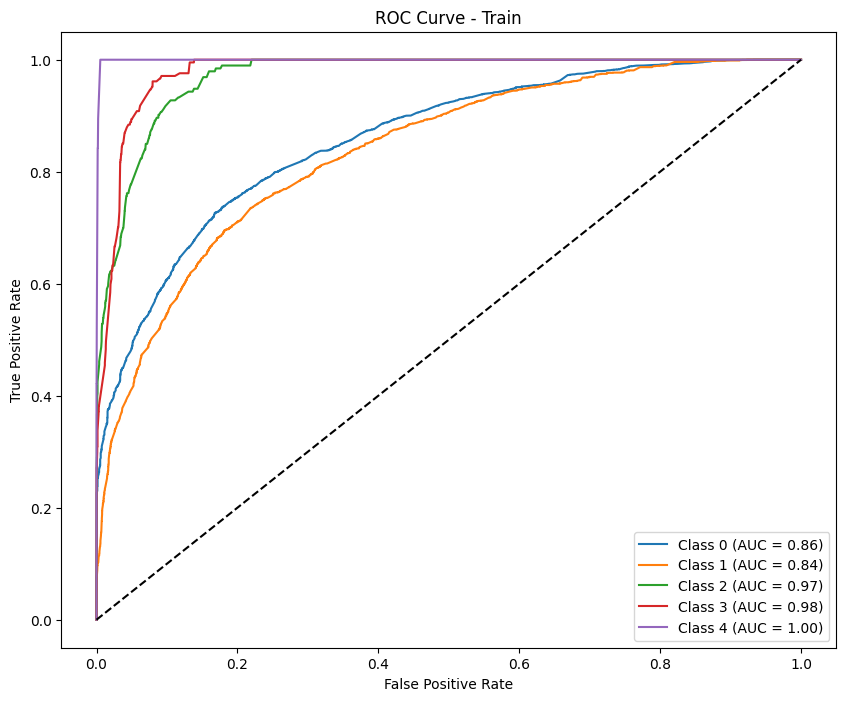

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.86977492 0.09677419 0.         0.04545455 0.        ]
Precision (per class): [0.82469512 0.16216216 0.         0.03571429 0.        ]
Recall (per class): [0.92006803 0.06896552 0.         0.0625     0.        ]
Accuracy: 0.7601
AUC (One-vs-Rest): 0.6057

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.92      0.87       588
           D       0.16      0.07      0.10        87
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.76       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.76      0.72       721



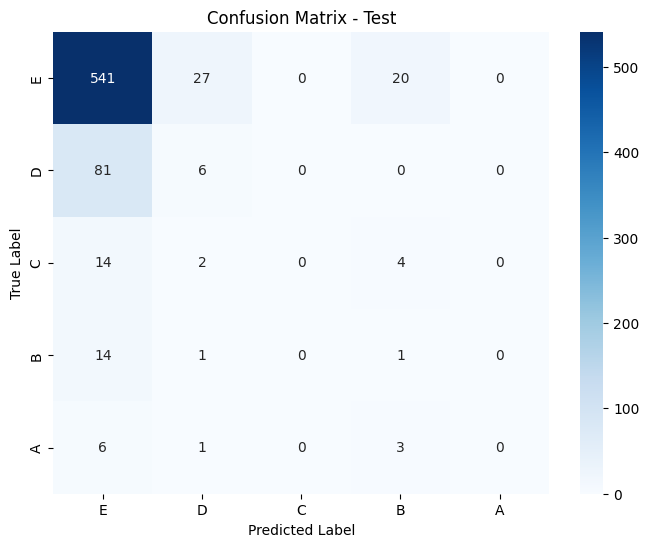

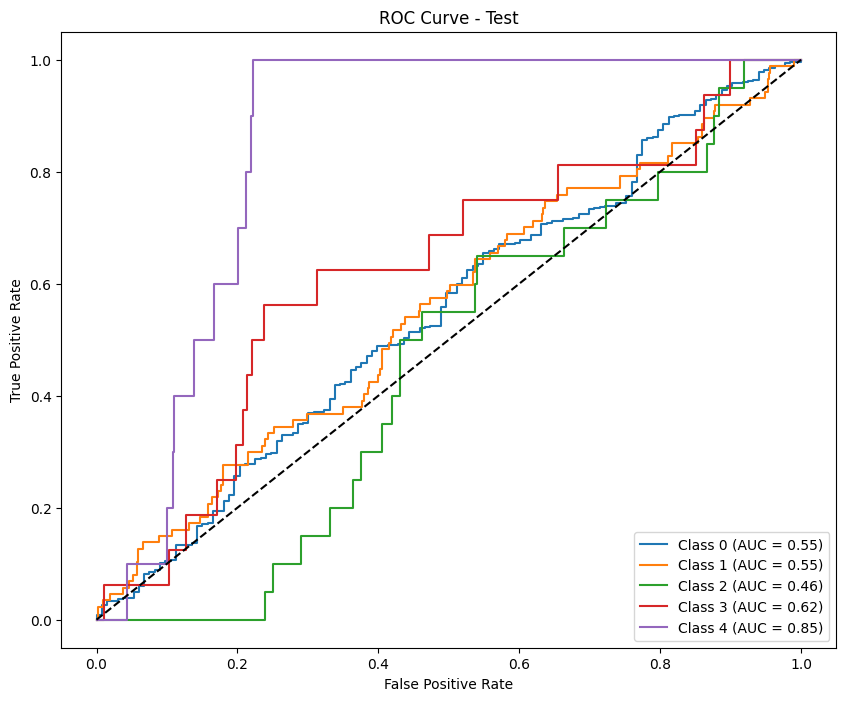

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Label: 0 --> Weight: 0.3058
Label: 1 --> Weight: 0.6780
Label: 2 --> Weight: 10.6198
Label: 3 --> Weight: 6.7459
Label: 4 --> Weight: 76.6143
Results saved as test_results_robust_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.81762546 0.66413662 0.37826087 0.52571429 0.65116279]
Precision (per class): [0.88213932 0.66455696 0.24233983 0.37704918 0.48275862]
Recall (per class): [0.76190476 0.66371681 0.86138614 0.86792453 1.        ]
Accuracy: 0.7386
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.76      0.82      3507
           D       0.66      0.66      0.66      1582
           C       0.24      0.86      0.38       101
           B      

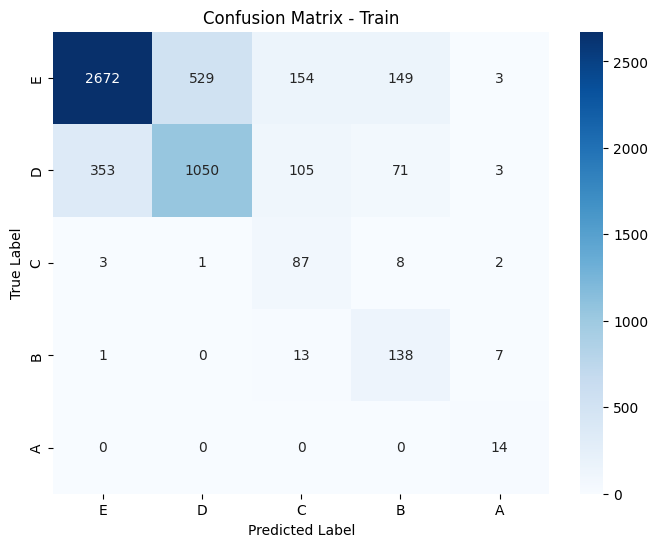

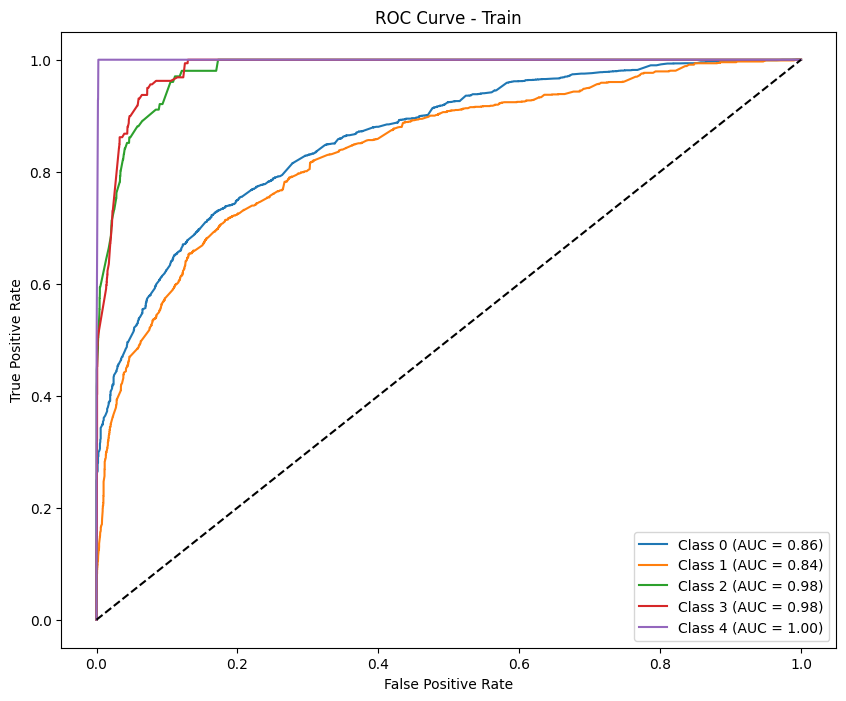

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.75894539 0.11299435 0.         0.04040404 0.        ]
Precision (per class): [0.79487179 0.10869565 0.         0.02469136 0.        ]
Recall (per class): [0.72612613 0.11764706 0.         0.11111111 0.        ]
Accuracy: 0.6041
AUC (One-vs-Rest): 0.5454

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.73      0.76       555
           D       0.11      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.02      0.11      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.60       687
   macro avg       0.19      0.19      0.18       687
weighted avg       0.66      0.60      0.63       687



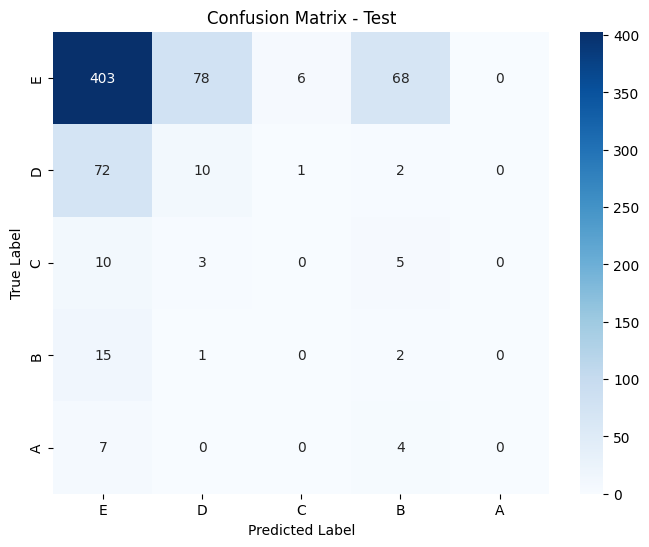

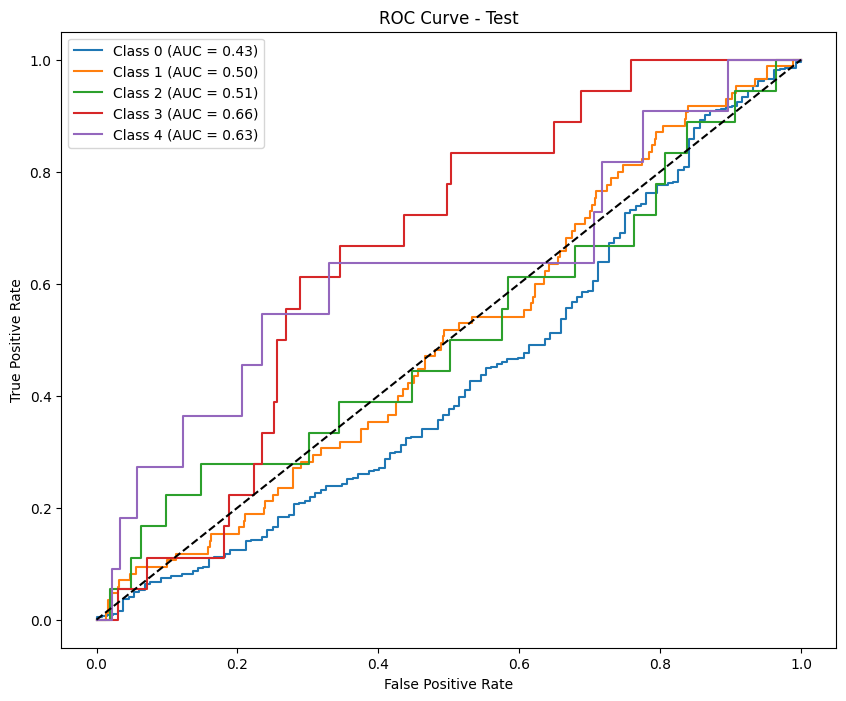

Results saved as test_results_calibrate_robust_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.8556179  0.63727306 0.59907834 0.59002169 0.66666667]
Precision (per class): [0.82263158 0.76991943 0.56034483 0.45033113 0.5       ]
Recall (per class): [0.89136014 0.54361568 0.64356436 0.85534591 1.        ]
Accuracy: 0.7833
AUC (One-vs-Rest): 0.9400

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.89      0.86      3507
           D       0.77      0.54      0.64      1582
           C       0.56      0.64      0.60       101
           B       0.45      0.86      0.59       159
           A       0.50      1.00      0.67        14

    accuracy                           0.78      5363
   macro avg       0.62      0.79      0.67      5363
weighted avg       0.79      0.78      0.78      5363



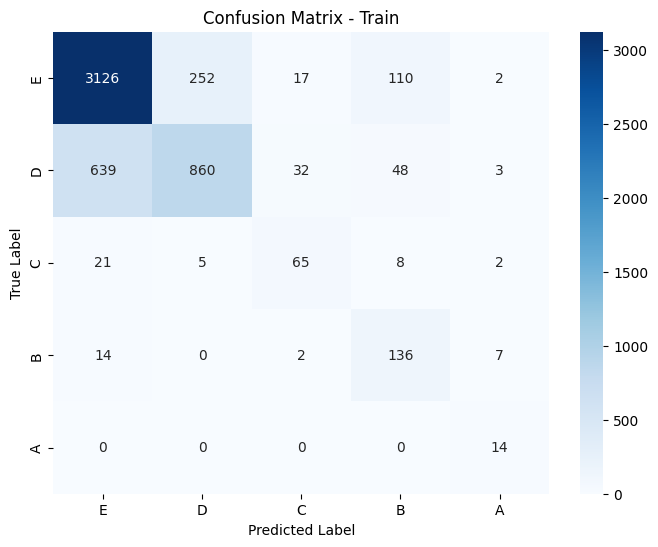

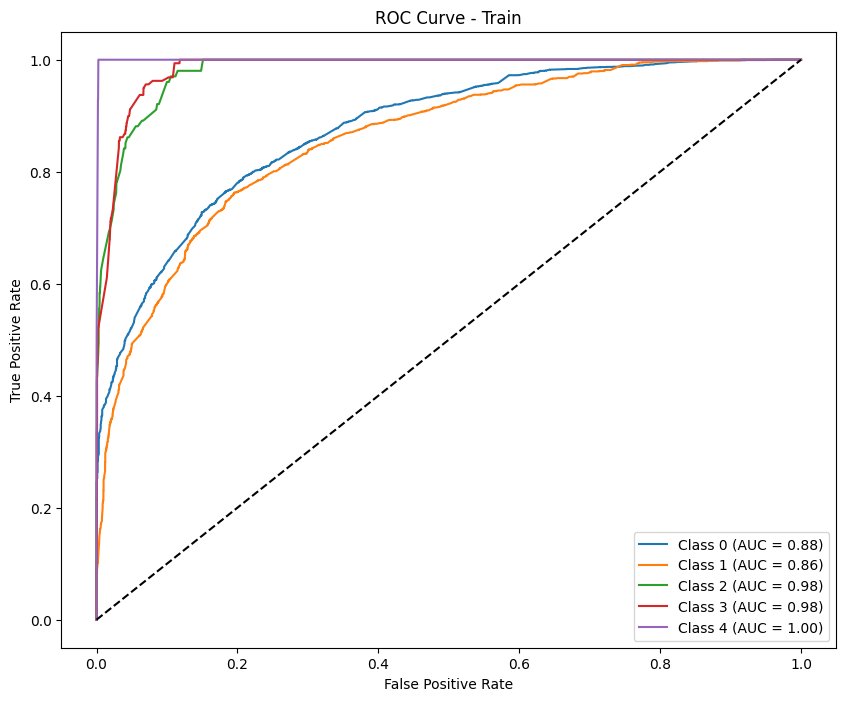

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.85884354 0.1        0.         0.04166667 0.        ]
Precision (per class): [0.81320451 0.17142857 0.         0.03333333 0.        ]
Recall (per class): [0.90990991 0.07058824 0.         0.05555556 0.        ]
Accuracy: 0.7453
AUC (One-vs-Rest): 0.5810

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.91      0.86       555
           D       0.17      0.07      0.10        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.75       687
   macro avg       0.20      0.21      0.20       687
weighted avg       0.68      0.75      0.71       687



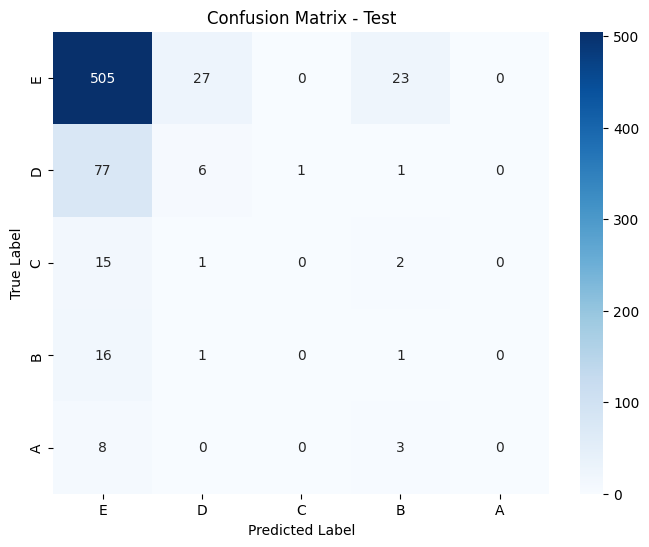

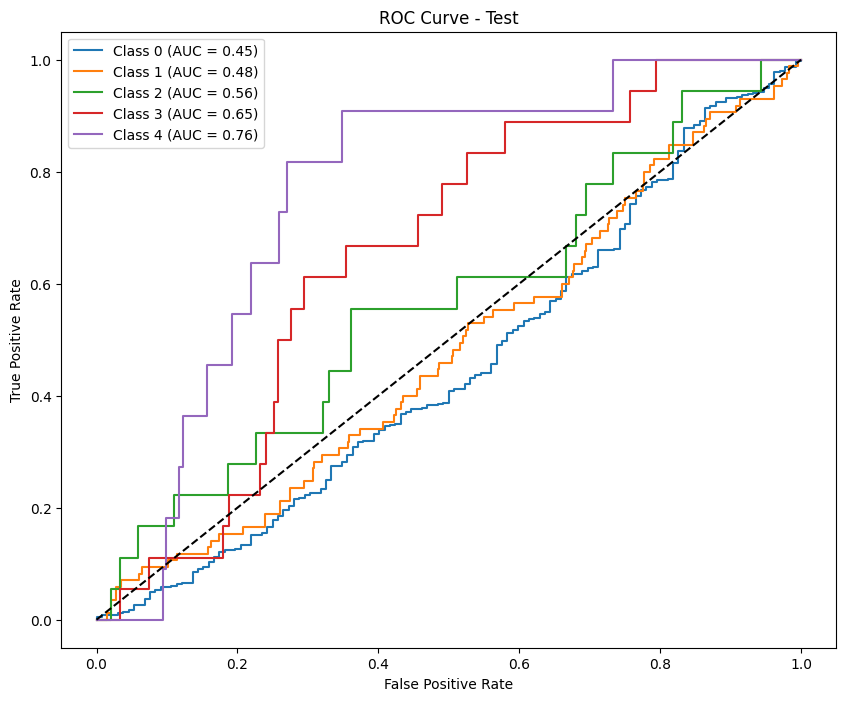

In [25]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, scale='robust', metric='f1_macro')

### undersample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

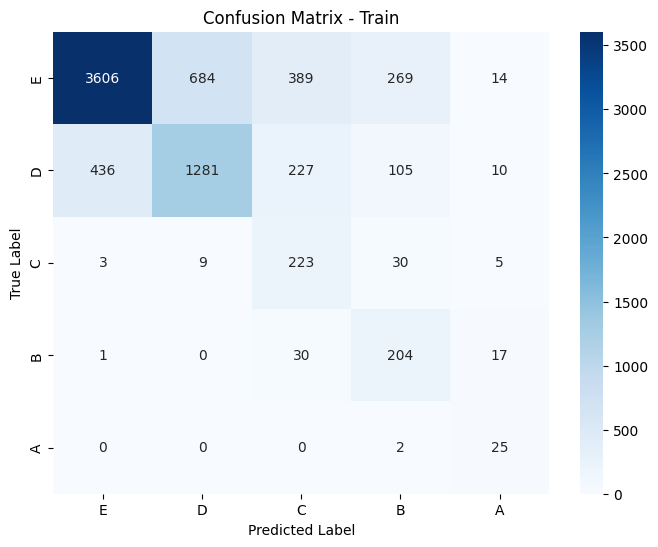

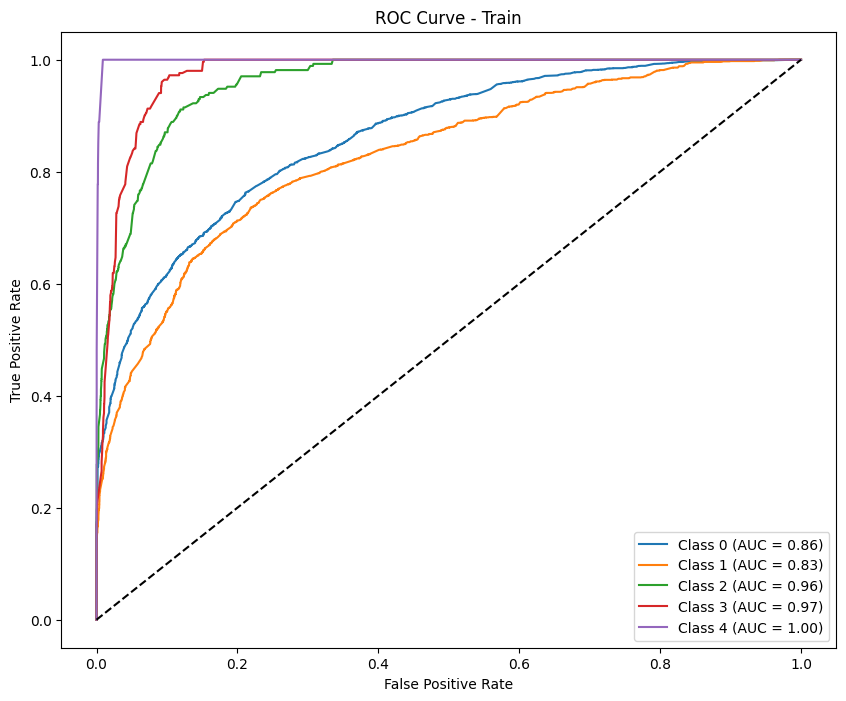

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90793651 0.46242775 0.         0.04761905 0.        ]
Precision (per class): [0.88819876 0.50632911 0.         0.03846154 0.        ]
Recall (per class): [0.92857143 0.42553191 0.         0.0625     0.        ]
Accuracy: 0.8108
AUC (One-vs-Rest): 0.7881

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.93      0.91       616
           D       0.51      0.43      0.46        94
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       756
   macro avg       0.29      0.28      0.28       756
weighted avg       0.79      0.81      0.80       756



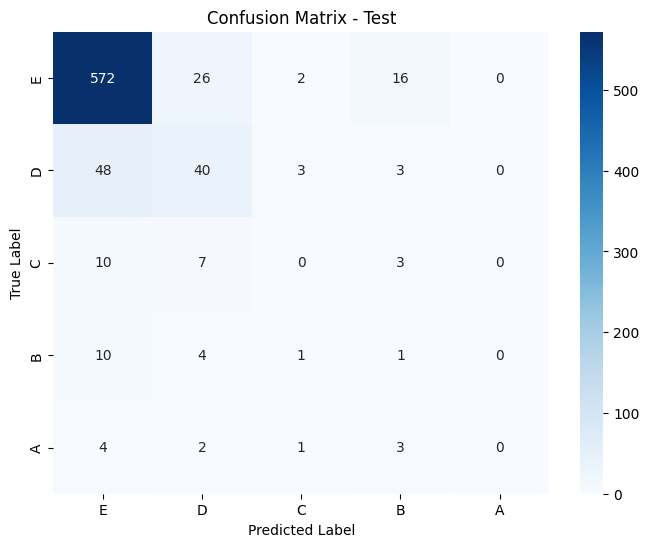

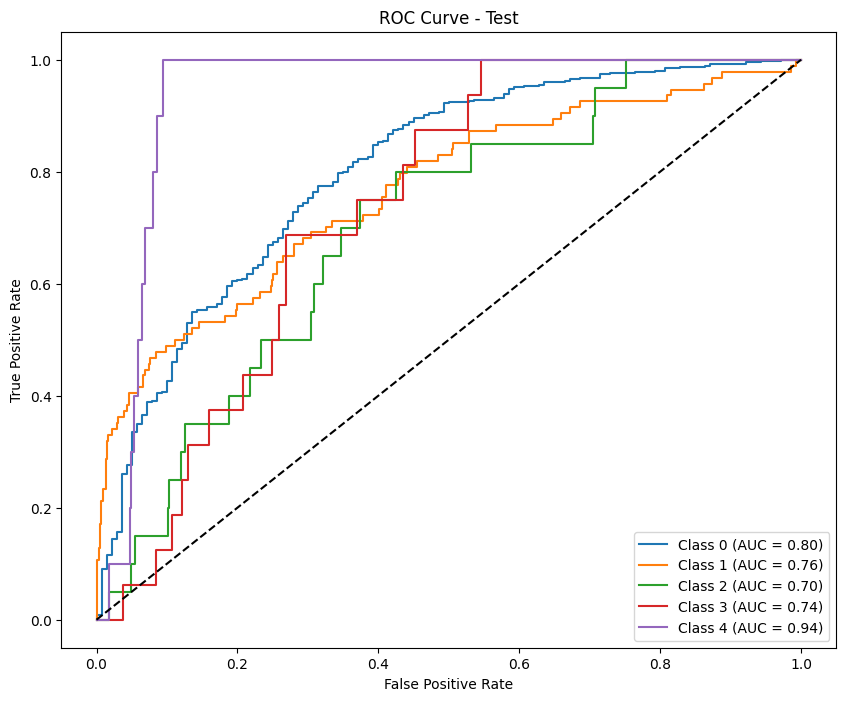

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.8470722  0.60527859 0.54478976 0.54609929 0.67692308]
Precision (per class): [0.79935622 0.76387861 0.53790614 0.49358974 0.57894737]
Recall (per class): [0.90084643 0.50121418 0.55185185 0.61111111 0.81481481]
Accuracy: 0.7697
AUC (One-vs-Rest): 0.9331

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.90      0.85      4962
           D       0.76      0.50      0.61      2059
           C       0.54      0.55      0.54       270
           B       0.49      0.61      0.55       252
           A       0.58      0.81      0.68        27

    accuracy                           0.77      7570
   macro avg       0.63      0.68      0.64      7570
weighted avg       0.77      0.77      0.76      7570



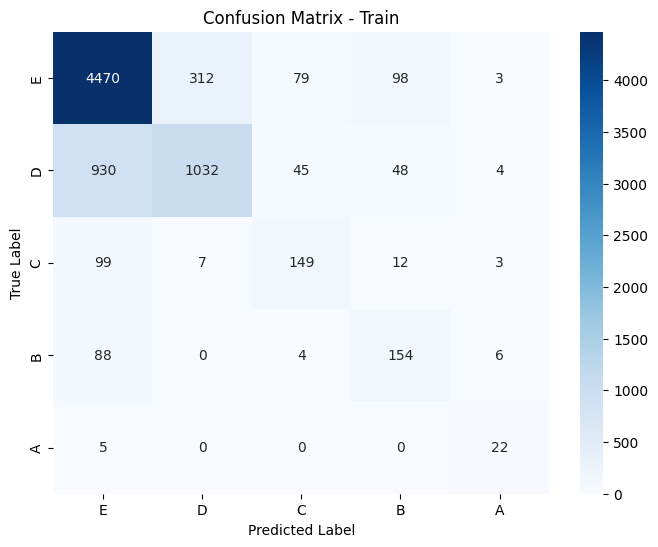

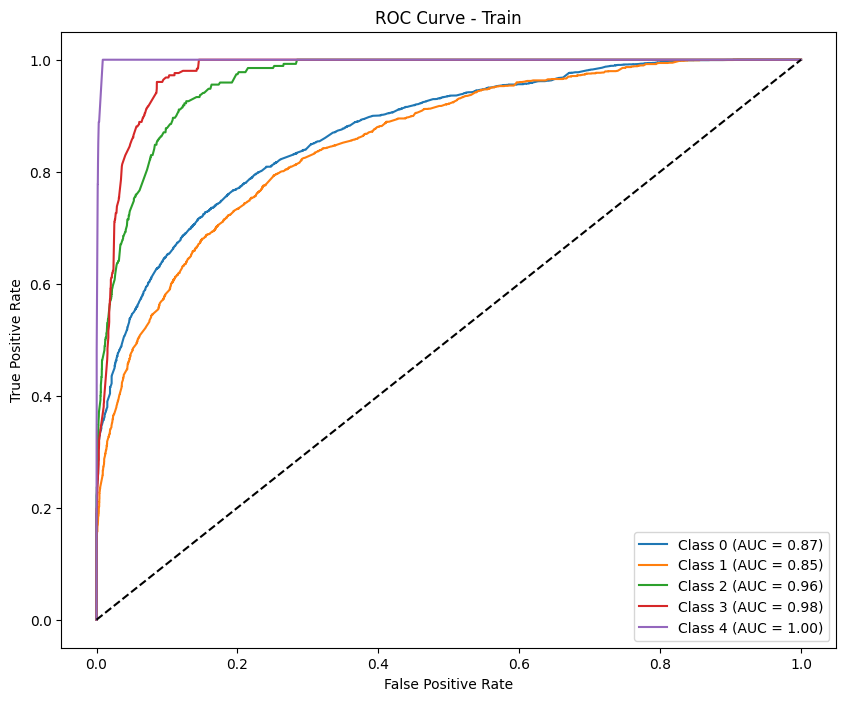

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91641337 0.43971631 0.         0.         0.        ]
Precision (per class): [0.86142857 0.65957447 0.         0.         0.        ]
Recall (per class): [0.9788961  0.32978723 0.         0.         0.        ]
Accuracy: 0.8386
AUC (One-vs-Rest): 0.7701

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.98      0.92       616
           D       0.66      0.33      0.44        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.30      0.26      0.27       756
weighted avg       0.78      0.84      0.80       756



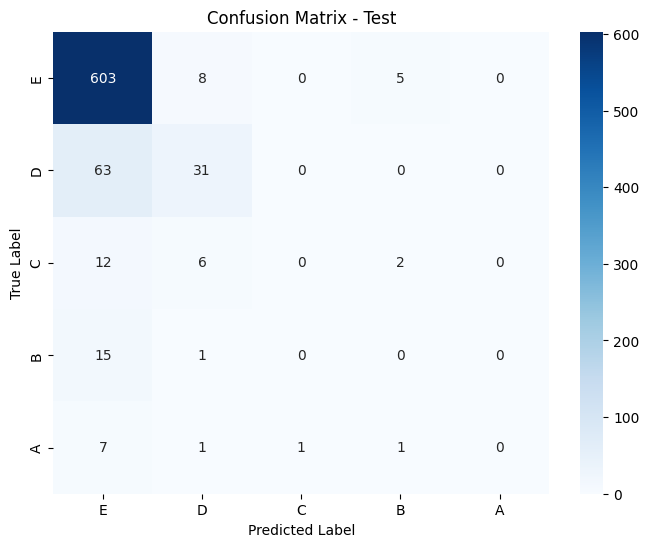

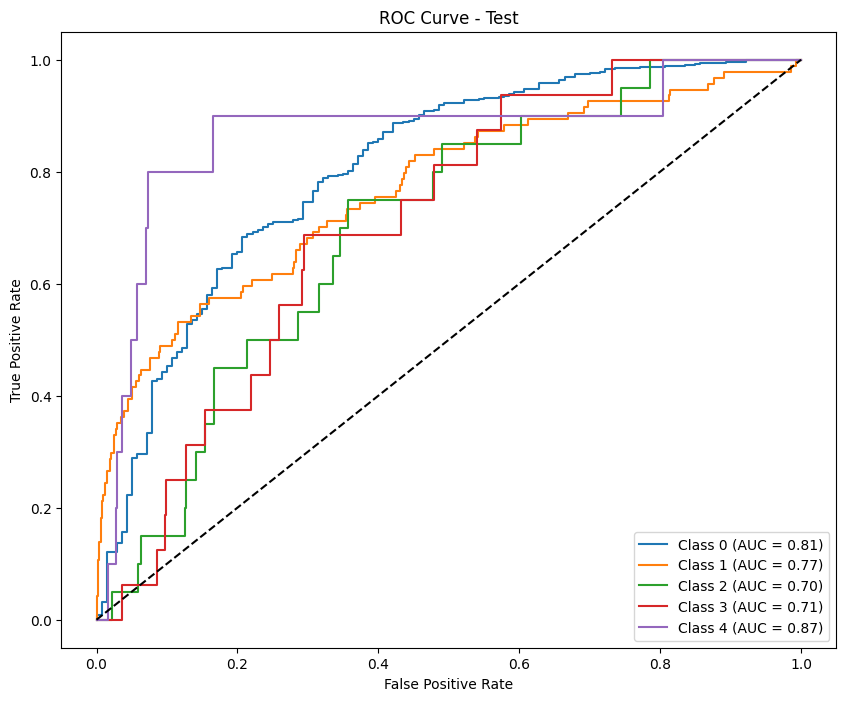


Permutation Importance for phase: phase1


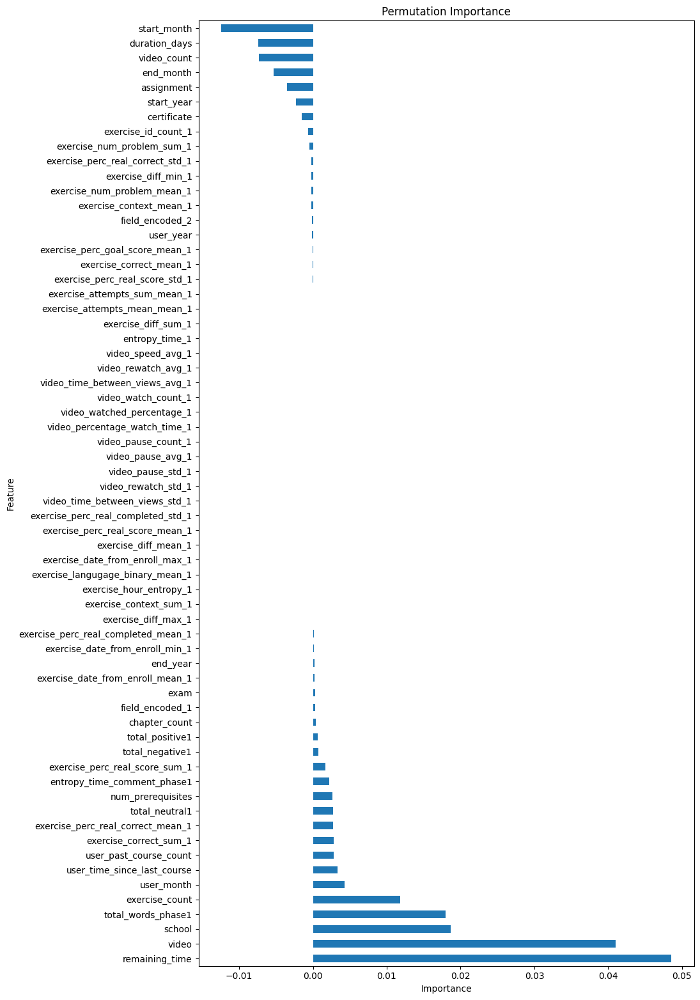

               Feature  Importance
20      remaining_time    0.048563
17               video    0.040984
0               school    0.018676
60  total_words_phase1    0.017966
10      exercise_count    0.011790
..                 ...         ...
16          assignment   -0.003501
6            end_month   -0.005317
9          video_count   -0.007282
19       duration_days   -0.007431
4          start_month   -0.012450

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


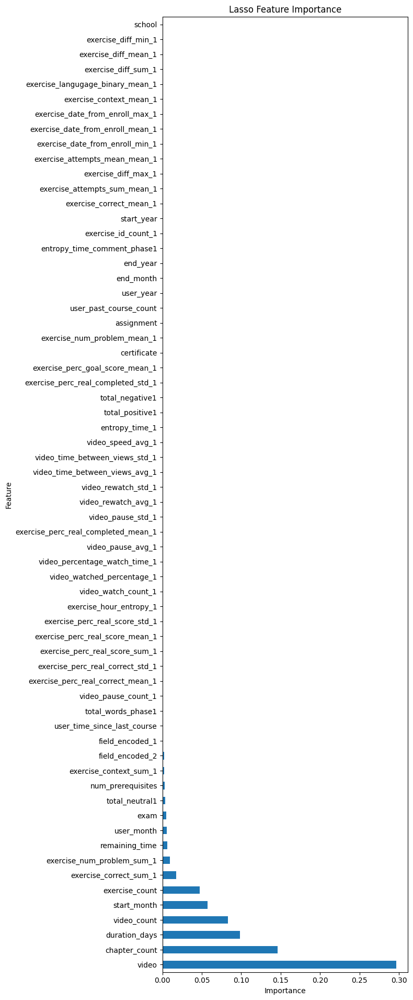

                             Feature  Importance
17                             video    0.296242
11                     chapter_count    0.146293
19                     duration_days    0.098527
9                        video_count    0.082877
4                        start_month    0.057420
..                               ...         ...
34  exercise_langugage_binary_mean_1    0.000000
35               exercise_diff_sum_1    0.000000
36              exercise_diff_mean_1    0.000000
37               exercise_diff_min_1    0.000000
0                             school    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
44     exercise_perc_real_score_sum_1    0.108287
15                        certificate    0.074060
24            exercise_correct_mean_1    0.072423
42  exercise_perc_real_correct_mean_1    0.059648
17                              video    0.046703
..                         

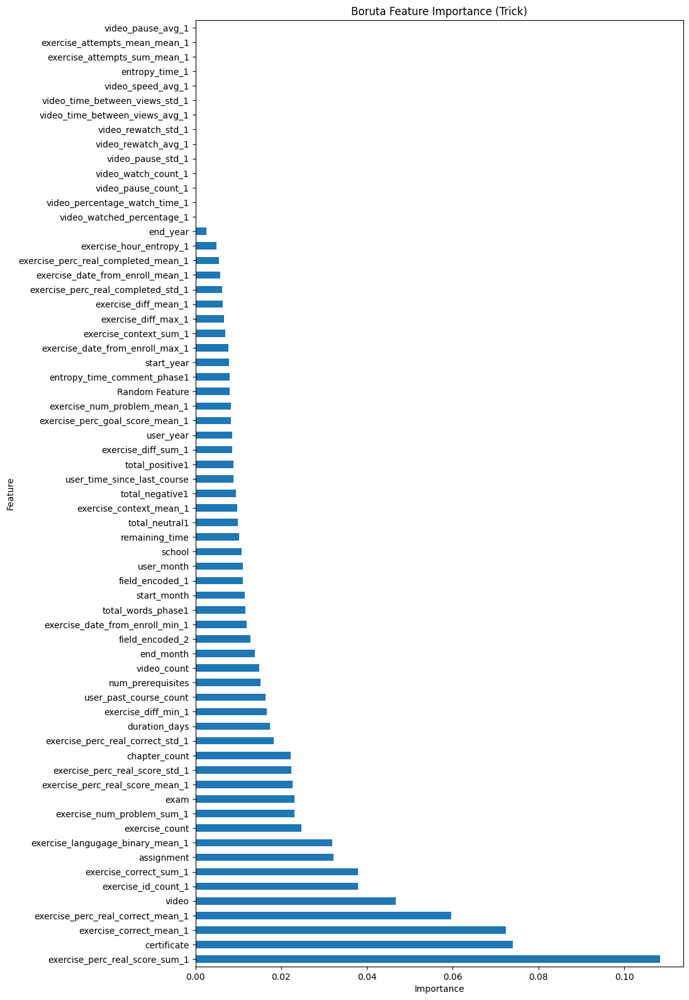

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.79510329 0.61860625 0.43726708 0.53092784 0.68656716]
Precision (per class): [0.89125214 0.61292517 0.30608696 0.37728938 0.54761905]
Recall (per class): [0.71767956 0.62439362 0.76521739 0.89565217 0.92      ]
Accuracy: 0.7037
AUC (One-vs-Rest): 0.9211

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.72      0.80      3620
           D       0.61      0.62      0.62      1443
           C       0.31      0.77      0.44       230
           B       0.38      0.90      0.53       230
           A       0.55      0.92      0.69        25

    accuracy                           0.70      5548
   macro 

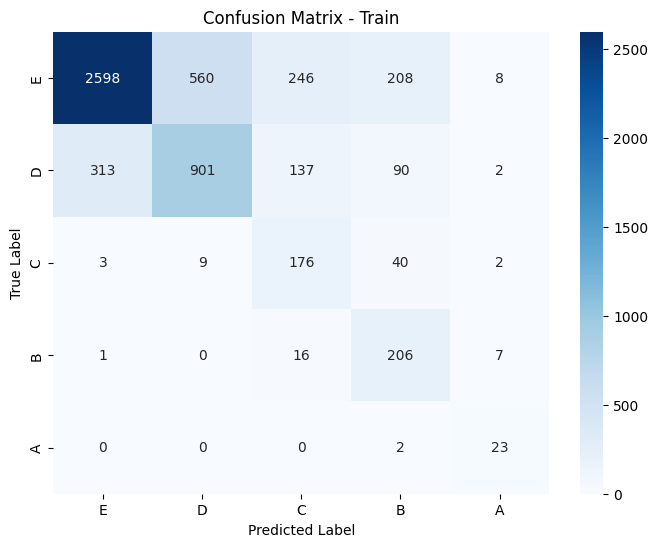

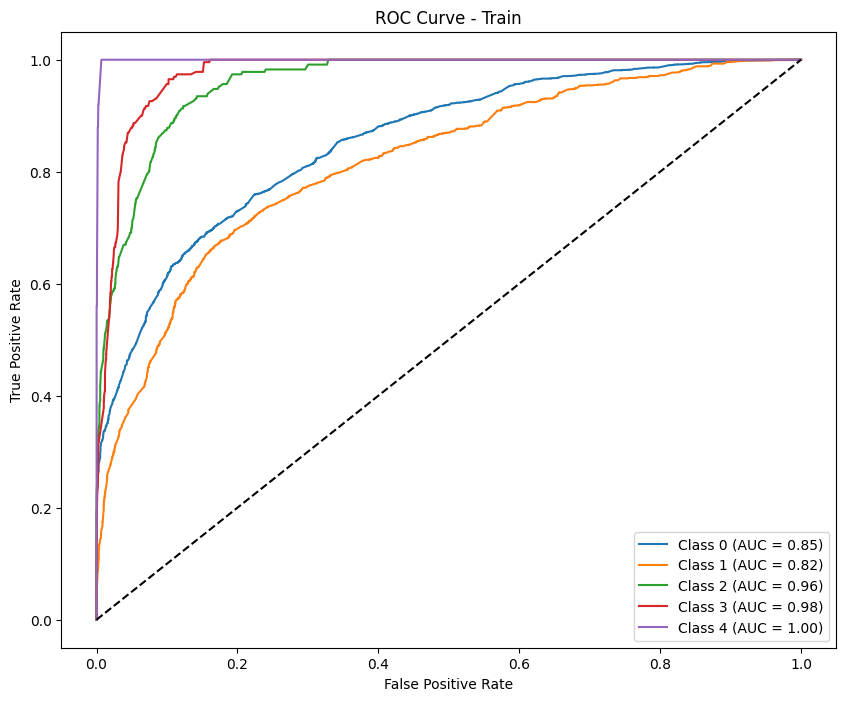


--- Test Metrics ---
F1 Score (per class): [0.83934426 0.20689655 0.         0.06666667 0.        ]
Precision (per class): [0.83797054 0.2195122  0.         0.04444444 0.        ]
Recall (per class): [0.8407225  0.19565217 0.         0.13333333 0.        ]
Accuracy: 0.7131
AUC (One-vs-Rest): 0.6467

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84       609
           D       0.22      0.20      0.21        92
           C       0.00      0.00      0.00        20
           B       0.04      0.13      0.07        15
           A       0.00      0.00      0.00        10

    accuracy                           0.71       746
   macro avg       0.22      0.23      0.22       746
weighted avg       0.71      0.71      0.71       746



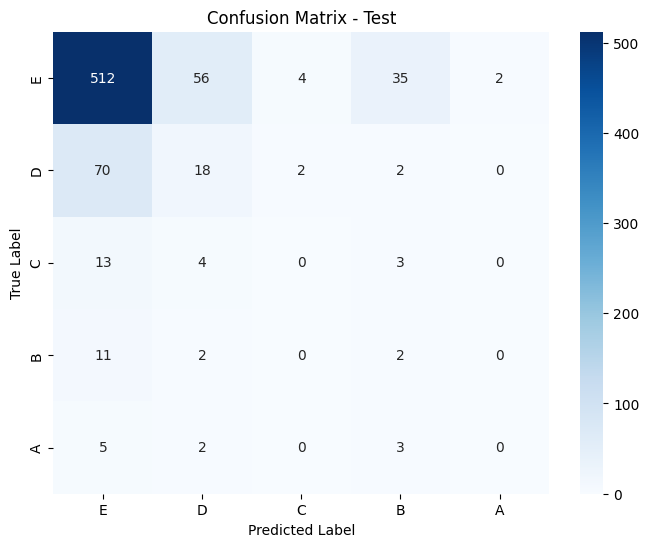

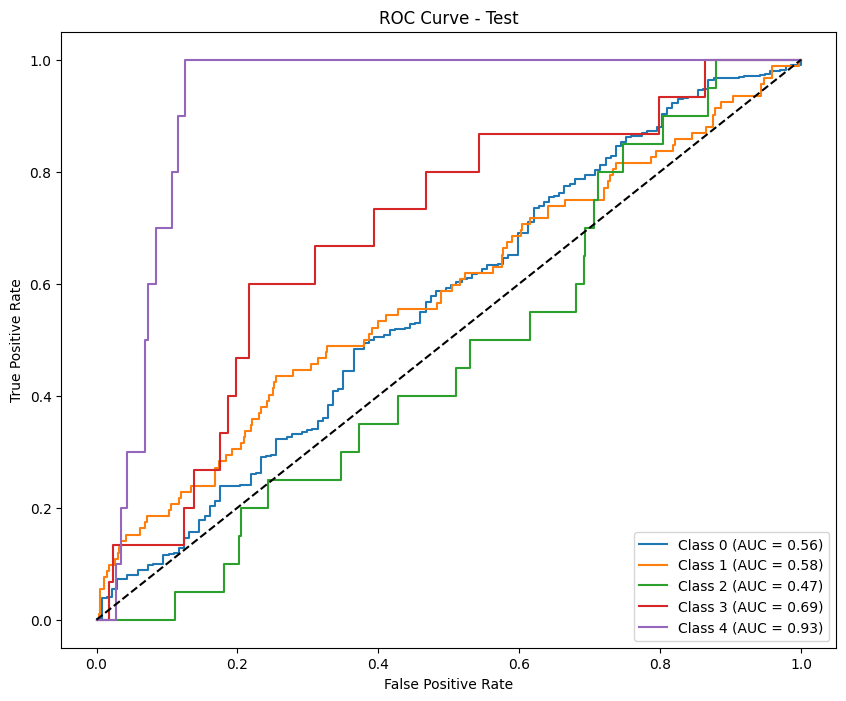

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84203723 0.54840123 0.5518591  0.59920635 0.74193548]
Precision (per class): [0.79130224 0.7452381  0.50177936 0.55109489 0.62162162]
Recall (per class): [0.89972376 0.43381843 0.61304348 0.65652174 0.92      ]
Accuracy: 0.7567
AUC (One-vs-Rest): 0.9290

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      3620
           D       0.75      0.43      0.55      1443
           C       0.50      0.61      0.55       230
           B       0.55      0.66      0.60       230
           A       0.62      0.92      0.74        25

    accuracy                           0.76      5548
   macro avg       0.64      0.70      0.66      5548
weighted avg       0.76      0.76      0.74      5548



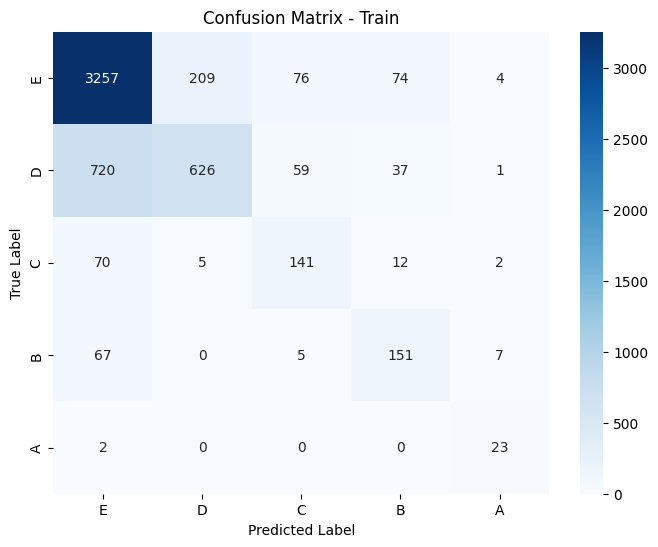

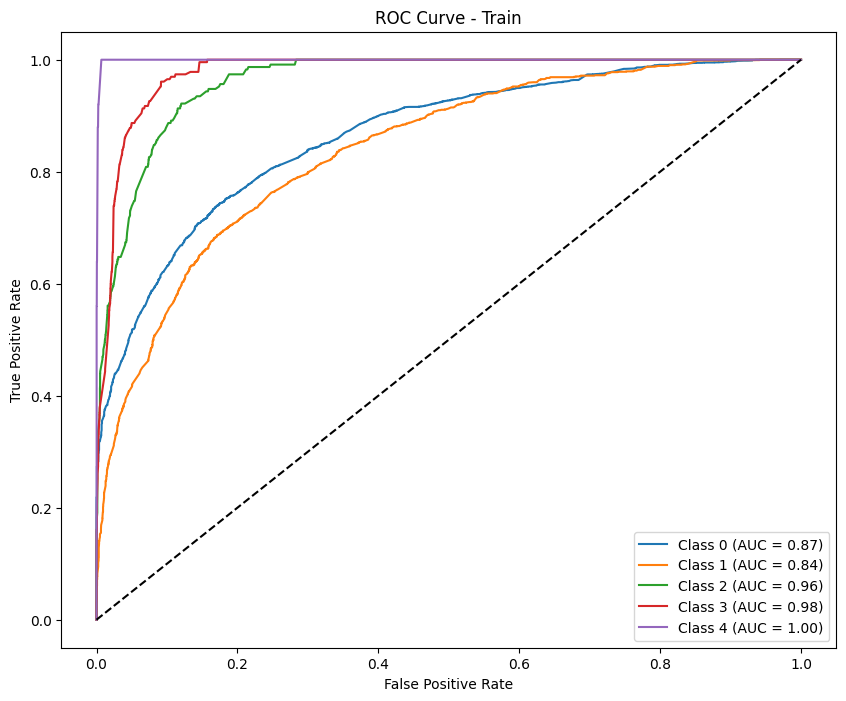

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88803681 0.16       0.         0.06060606 0.        ]
Precision (per class): [0.83309353 0.3030303  0.         0.05555556 0.        ]
Recall (per class): [0.95073892 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.7909
AUC (One-vs-Rest): 0.6330

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.95      0.89       609
           D       0.30      0.11      0.16        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.79       746
   macro avg       0.24      0.23      0.22       746
weighted avg       0.72      0.79      0.75       746



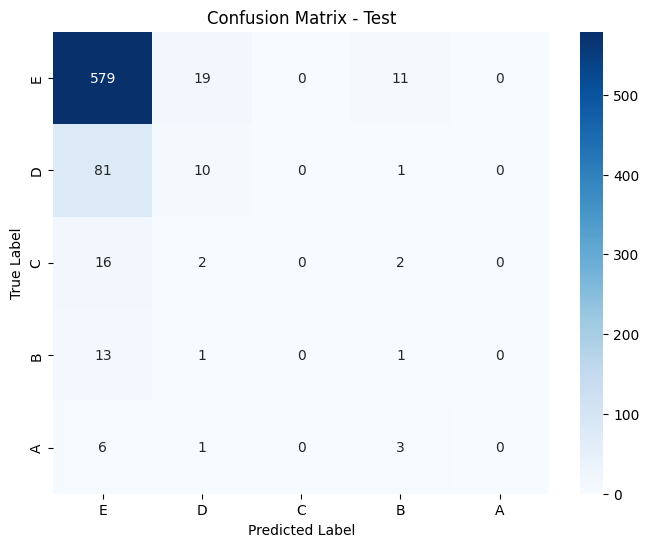

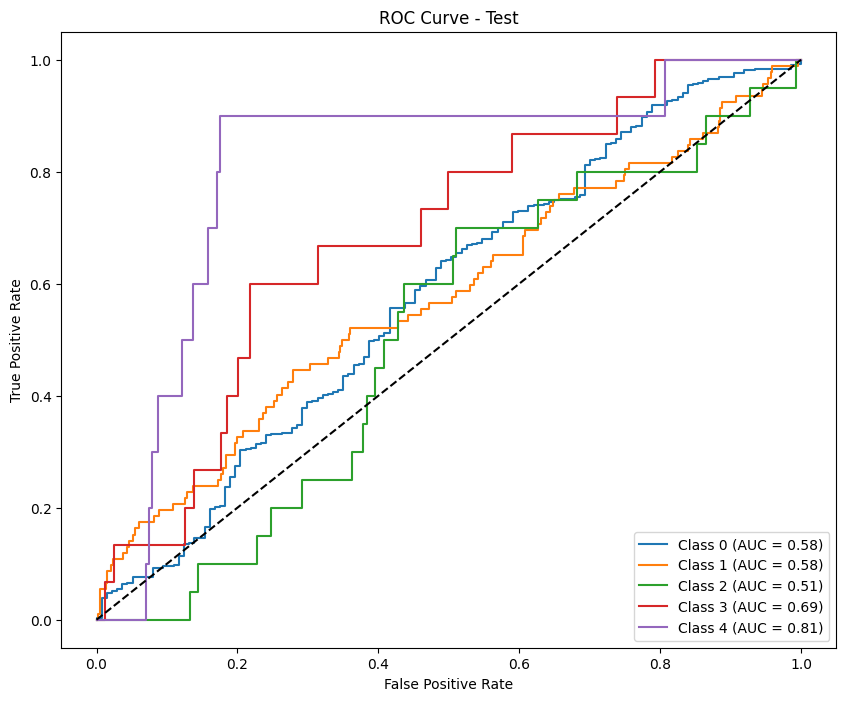


Permutation Importance for phase: phase2


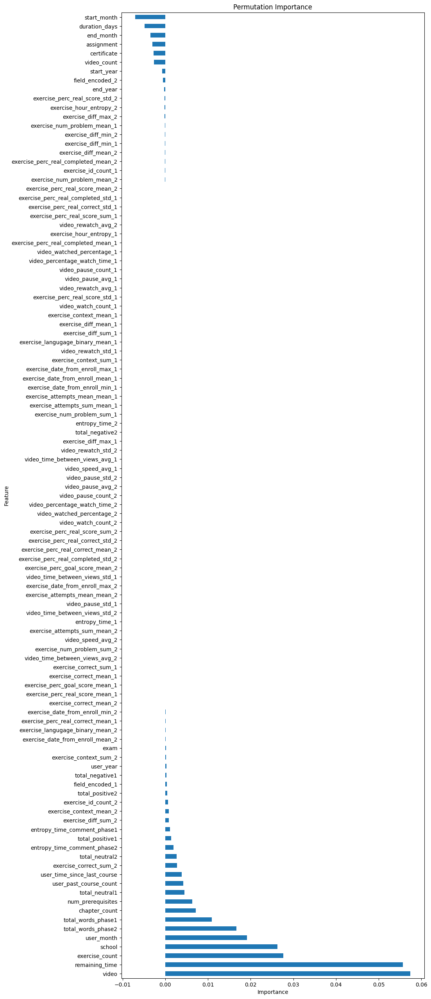

           Feature  Importance
17           video    0.057431
20  remaining_time    0.055651
10  exercise_count    0.027645
0           school    0.026316
8       user_month    0.019106
..             ...         ...
15     certificate   -0.002726
16      assignment   -0.002997
6        end_month   -0.003447
19   duration_days   -0.004822
4      start_month   -0.007052

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


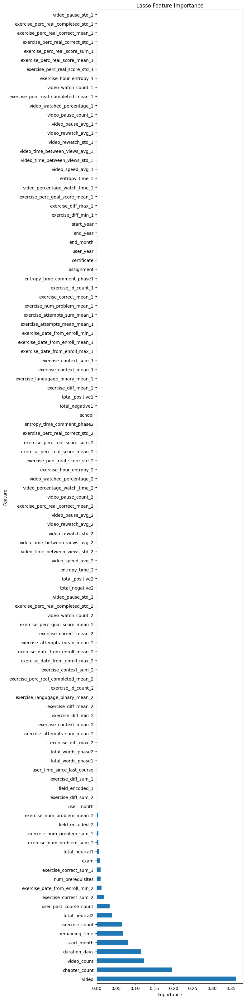

                               Feature  Importance
17                               video    0.362884
11                       chapter_count    0.197127
9                          video_count    0.123460
19                       duration_days    0.115316
4                          start_month    0.081763
..                                 ...         ...
44      exercise_perc_real_score_sum_1    0.000000
43    exercise_perc_real_correct_std_1    0.000000
42   exercise_perc_real_correct_mean_1    0.000000
41  exercise_perc_real_completed_std_1    0.000000
53                   video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
15                      certificate    0.156572
17                            video    0.048592
16                       assignment    0.034226
66           exercise_correct_sum_2    0.031948
18                             exam    0.023246
..            

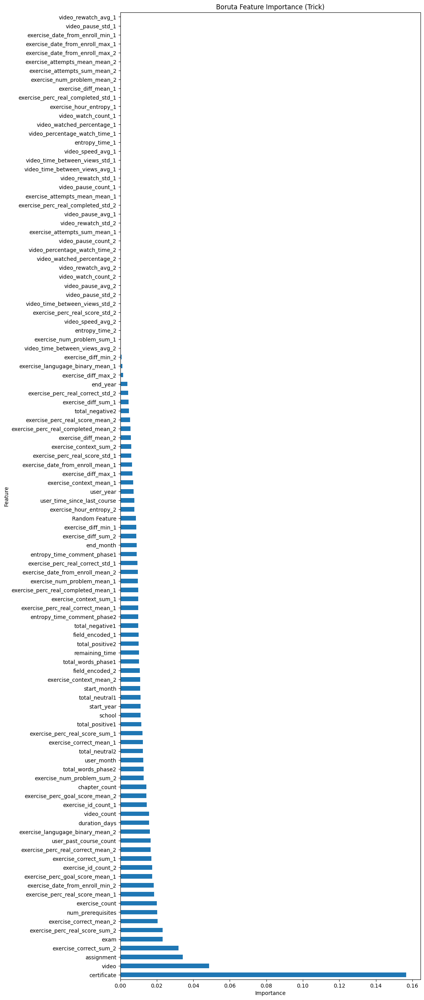

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.80533333 0.6459439  0.47588424 0.51242236 0.49350649]
Precision (per class): [0.90563774 0.61828737 0.34498834 0.37757437 0.32758621]
Recall (per class): [0.72503201 0.67619048 0.76683938 0.79710145 1.        ]
Accuracy: 0.7181
AUC (One-vs-Rest): 0.9296

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.73      0.81      3124
           D       0.62      0.68      0.65      1260
           C       0.34      0.77      0.48       193
           B       0.38      0.80      0.51       207
           A       0.33      1.00      0.49        19

    accuracy                           0.72      4803
   macro 

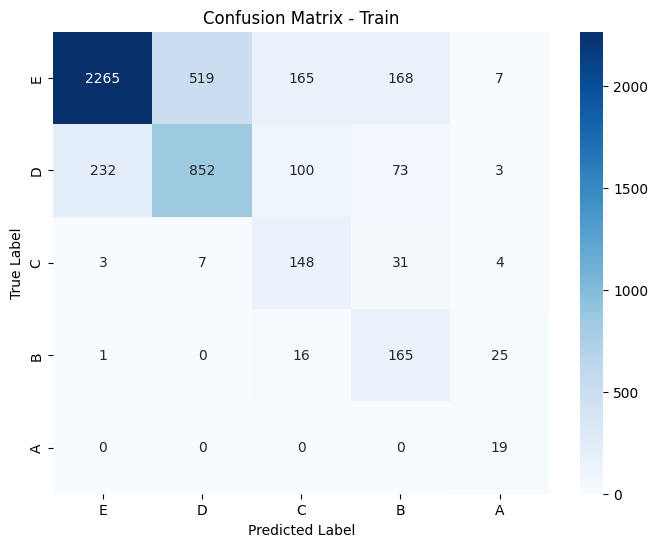

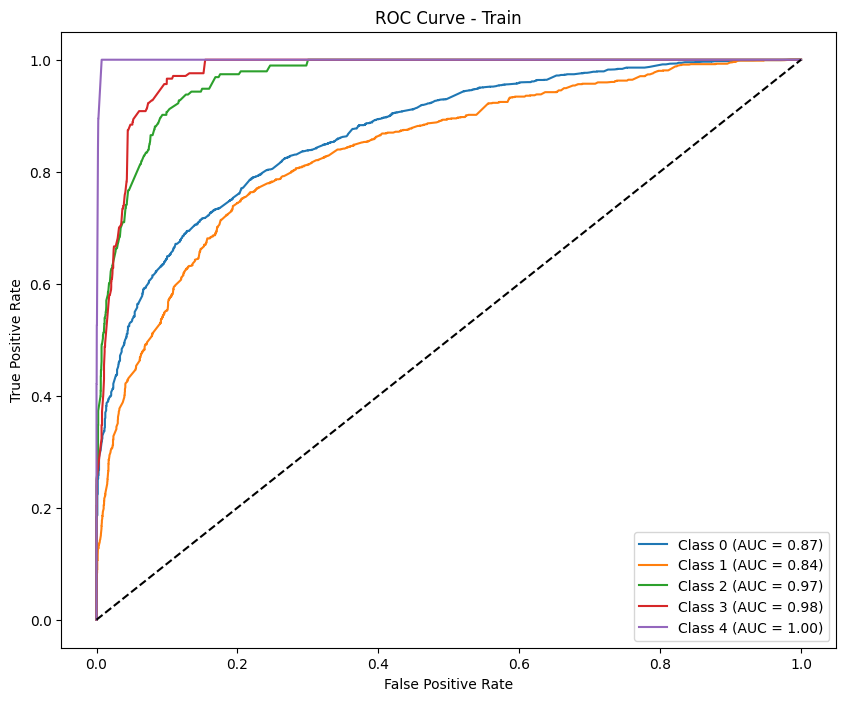


--- Test Metrics ---
F1 Score (per class): [0.73998136 0.20175439 0.         0.0625     0.        ]
Precision (per class): [0.8185567  0.16312057 0.         0.0375     0.        ]
Recall (per class): [0.67517007 0.26436782 0.         0.1875     0.        ]
Accuracy: 0.5867
AUC (One-vs-Rest): 0.6124

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.68      0.74       588
           D       0.16      0.26      0.20        87
           C       0.00      0.00      0.00        20
           B       0.04      0.19      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.59       721
   macro avg       0.20      0.23      0.20       721
weighted avg       0.69      0.59      0.63       721



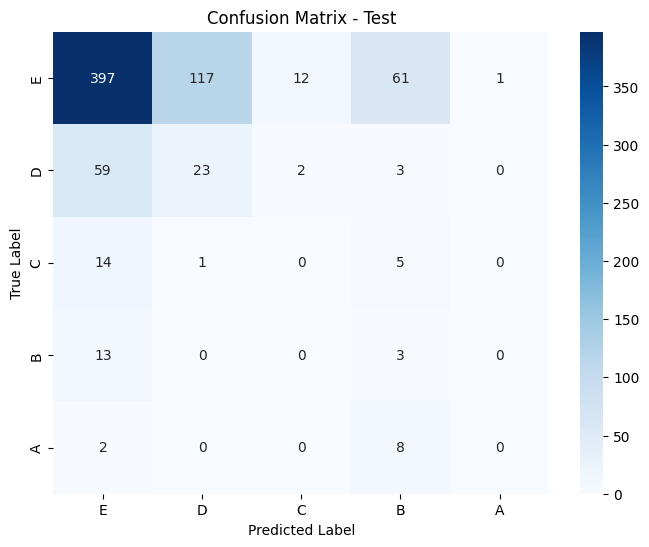

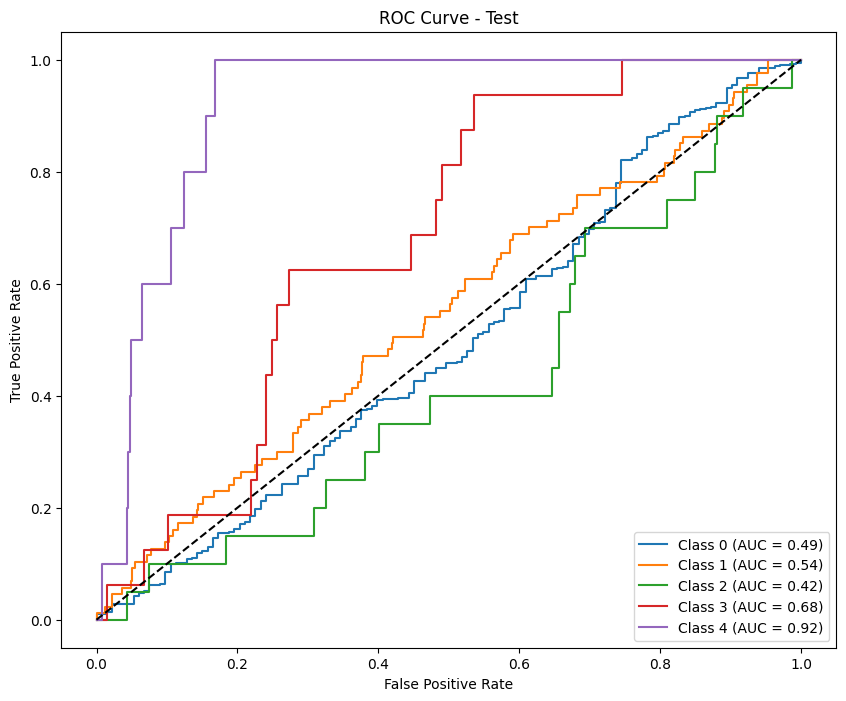

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8525283  0.60769231 0.5955335  0.60444444 0.70833333]
Precision (per class): [0.80662668 0.77073171 0.57142857 0.55967078 0.5862069 ]
Recall (per class): [0.90396927 0.5015873  0.62176166 0.65700483 0.89473684]
Accuracy: 0.7764
AUC (One-vs-Rest): 0.9370

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.90      0.85      3124
           D       0.77      0.50      0.61      1260
           C       0.57      0.62      0.60       193
           B       0.56      0.66      0.60       207
           A       0.59      0.89      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.72      0.67      4803
weighted avg       0.78      0.78      0.77      4803



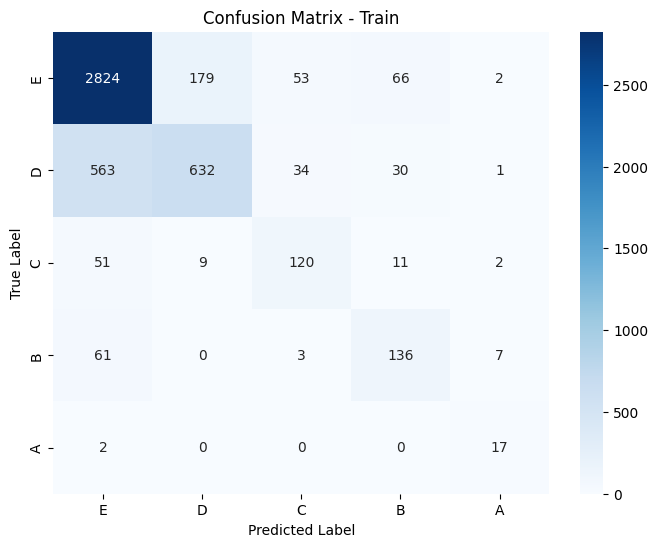

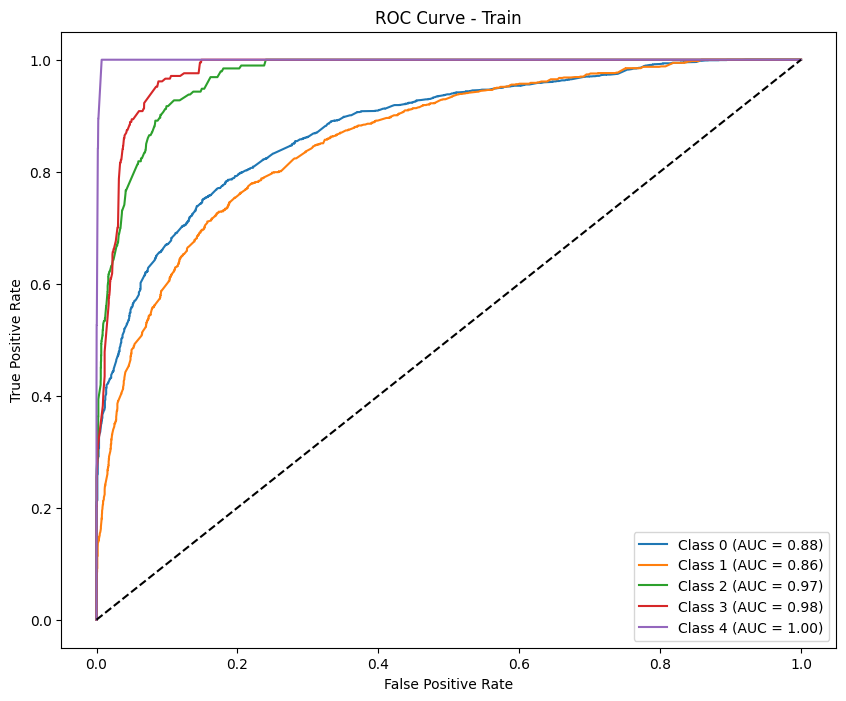

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8452579  0.1509434  0.         0.04081633 0.        ]
Precision (per class): [0.82736156 0.16666667 0.         0.03030303 0.        ]
Recall (per class): [0.86394558 0.13793103 0.         0.0625     0.        ]
Accuracy: 0.7226
AUC (One-vs-Rest): 0.6012

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.85       588
           D       0.17      0.14      0.15        87
           C       0.00      0.00      0.00        20
           B       0.03      0.06      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.72       721
   macro avg       0.20      0.21      0.21       721
weighted avg       0.70      0.72      0.71       721



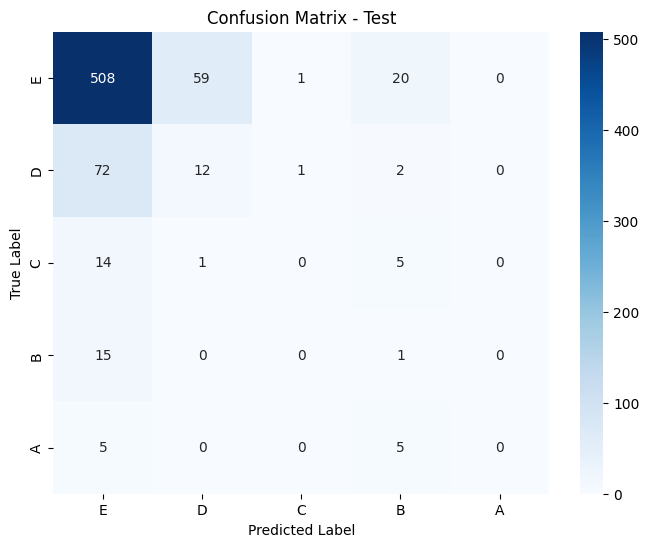

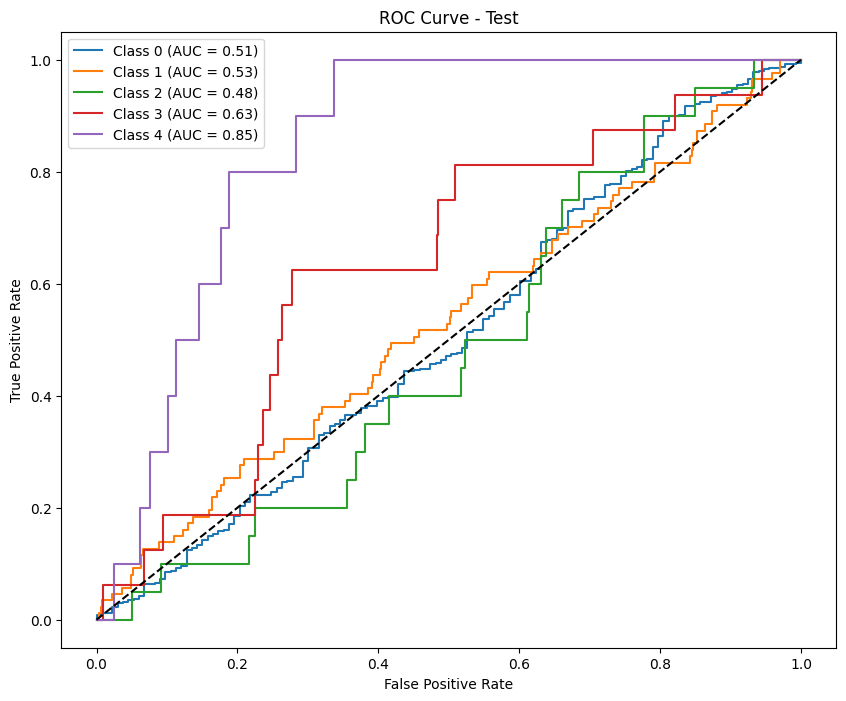

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.81925055 0.66934835 0.53538462 0.69873418 0.68292683]
Precision (per class): [0.91769547 0.62934947 0.38839286 0.58474576 0.51851852]
Recall (per class): [0.73988056 0.71477663 0.86138614 0.86792453 1.        ]
Accuracy: 0.7490
AUC (One-vs-Rest): 0.9460

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.74      0.82      1507
           D       0.63      0.71      0.67       582
           C       0.39      0.86      0.54       101
           B       0.58      0.87      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.75      2363
   macro 

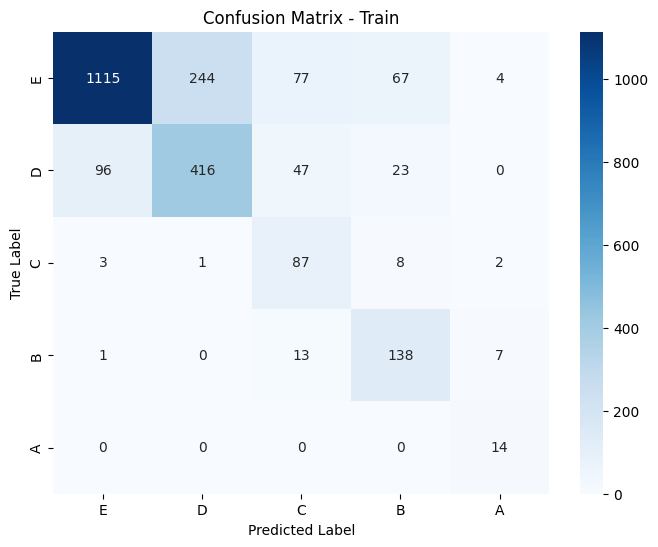

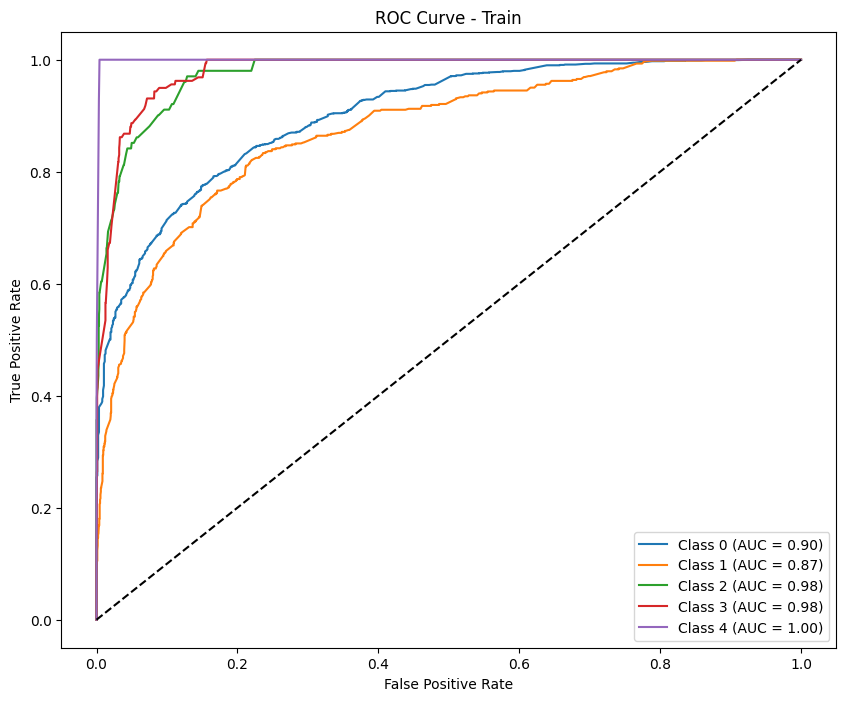

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.76603774 0.11049724 0.         0.06451613 0.        ]
Precision (per class): [0.8039604  0.10416667 0.         0.04       0.        ]
Recall (per class): [0.73153153 0.11764706 0.         0.16666667 0.        ]
Accuracy: 0.6099
AUC (One-vs-Rest): 0.5702

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.73      0.77       555
           D       0.10      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.04      0.17      0.06        18
           A       0.00      0.00      0.00        11

    accuracy                           0.61       687
   macro avg       0.19      0.20      0.19       687
weighted avg       0.66      0.61      0.63       687



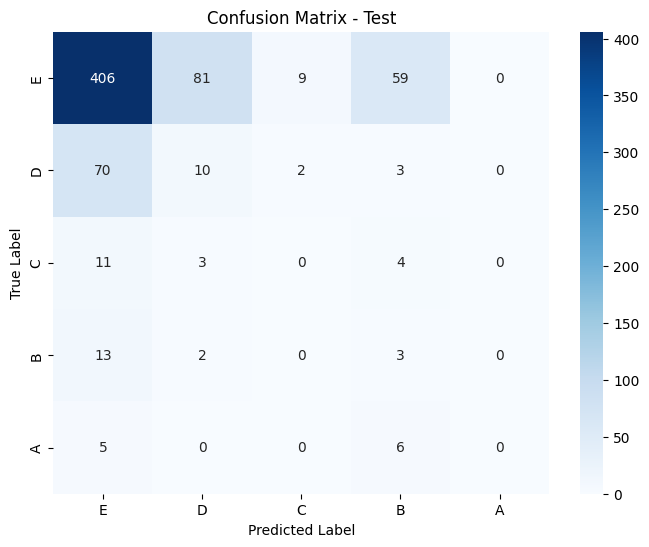

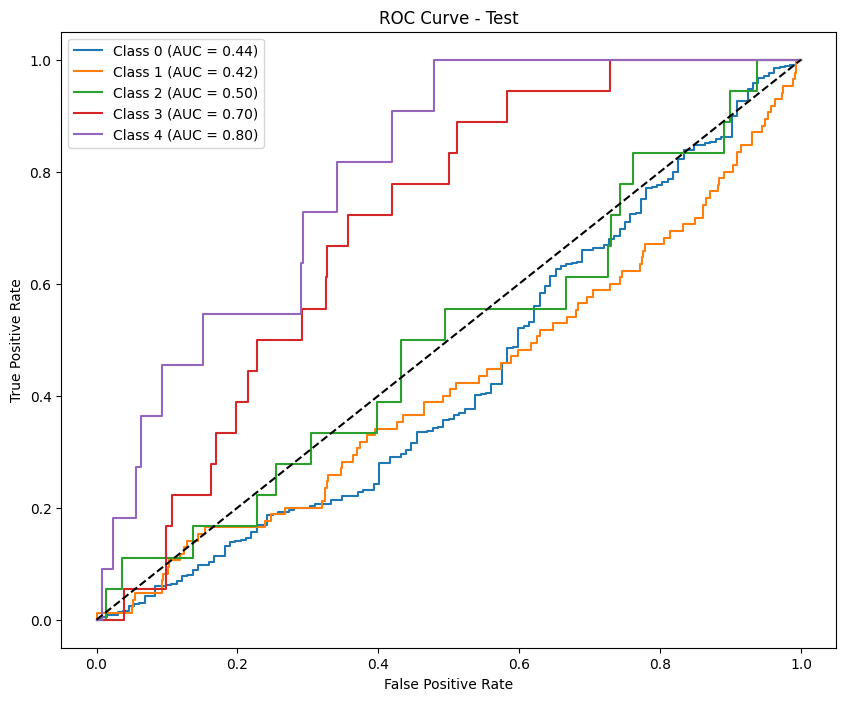

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87144703 0.64065708 0.63967611 0.73854447 0.73684211]
Precision (per class): [0.84896161 0.79591837 0.54109589 0.64622642 0.58333333]
Recall (per class): [0.89515594 0.53608247 0.78217822 0.86163522 1.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.9512

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.90      0.87      1507
           D       0.80      0.54      0.64       582
           C       0.54      0.78      0.64       101
           B       0.65      0.86      0.74       159
           A       0.58      1.00      0.74        14

    accuracy                           0.80      2363
   macro avg       0.68      0.82      0.73      2363
weighted avg       0.81      0.80      0.79      2363



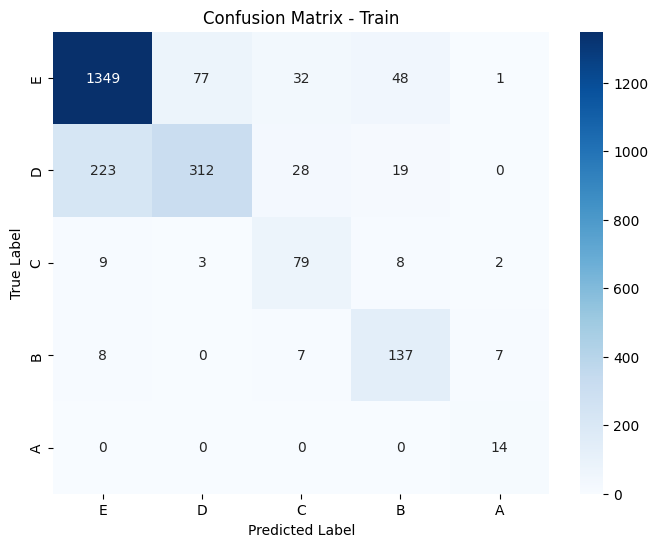

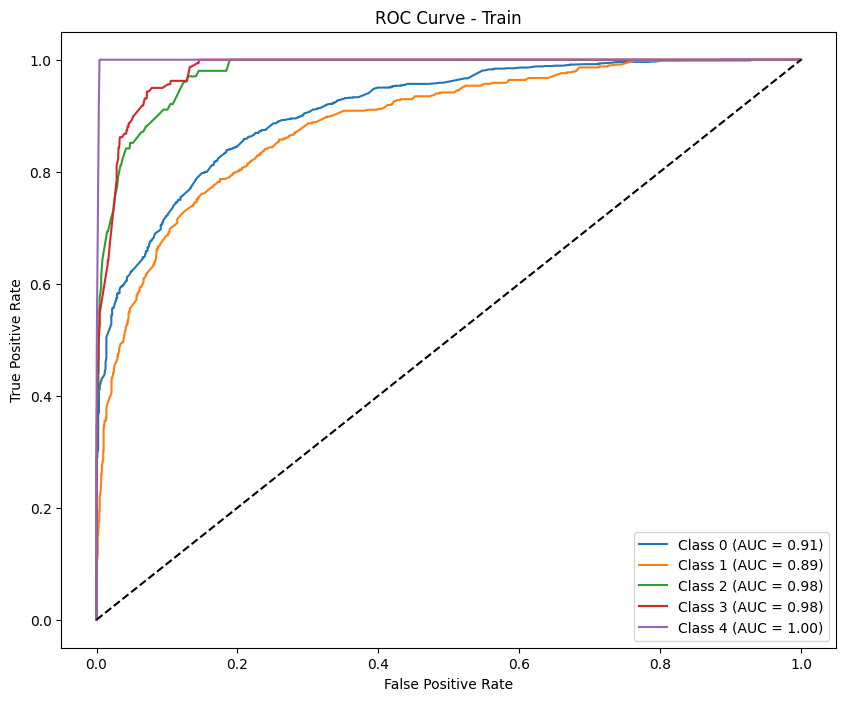

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.84687767 0.03278689 0.         0.03773585 0.        ]
Precision (per class): [0.80618893 0.05405405 0.         0.02857143 0.        ]
Recall (per class): [0.89189189 0.02352941 0.         0.05555556 0.        ]
Accuracy: 0.7249
AUC (One-vs-Rest): 0.5843

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85       555
           D       0.05      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.72       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.66      0.72      0.69       687



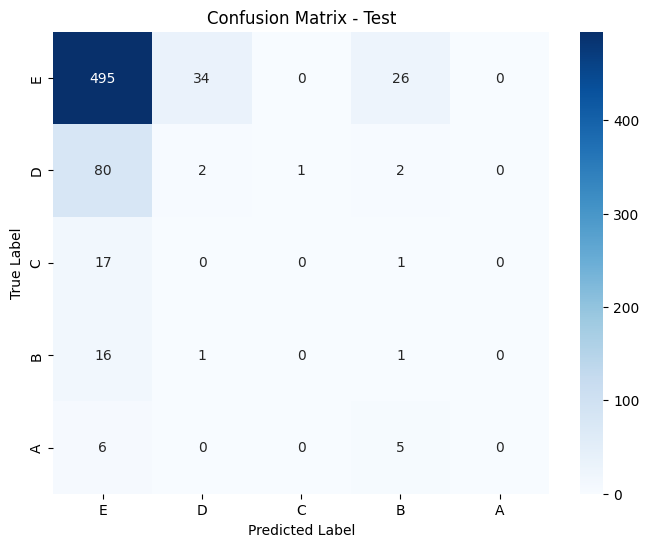

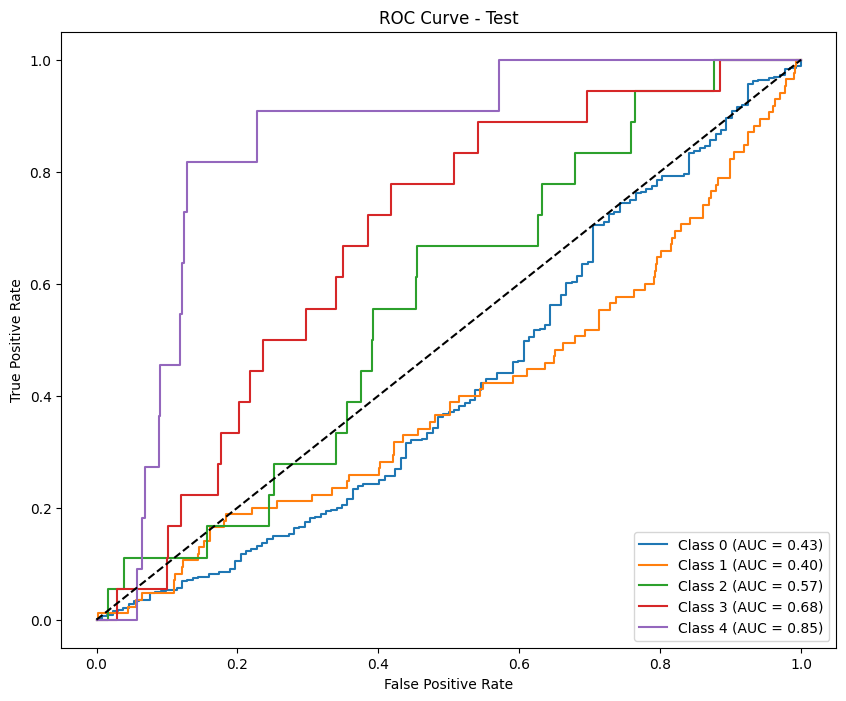

In [26]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, scale='robust', metric='f1_macro')

### oversample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

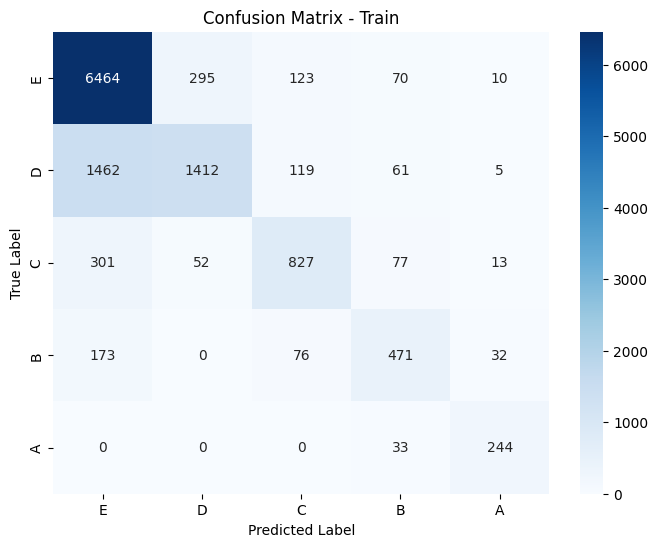

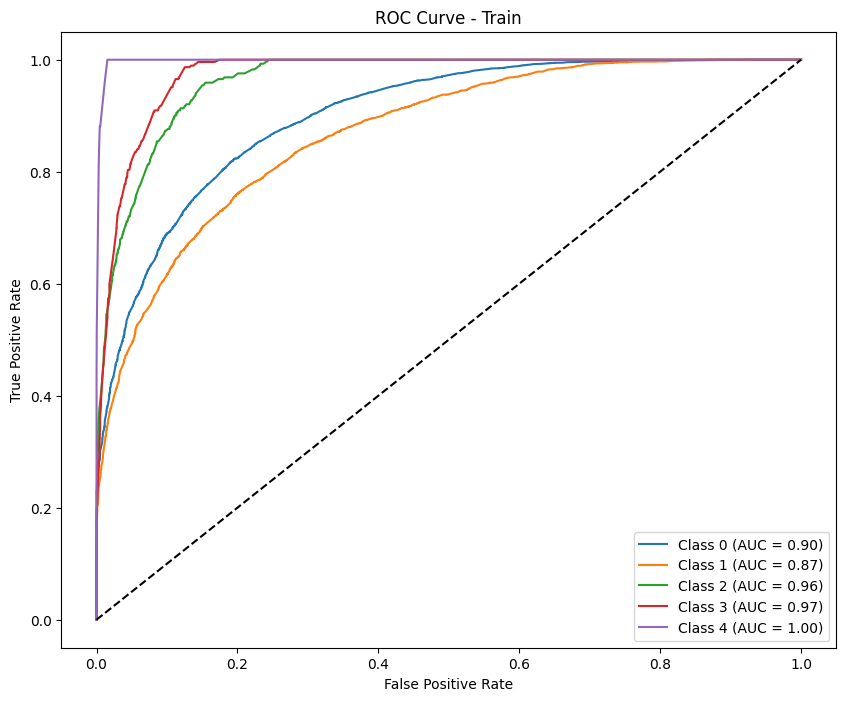

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92331526 0.45882353 0.         0.         0.        ]
Precision (per class): [0.88296296 0.51315789 0.         0.         0.        ]
Recall (per class): [0.96753247 0.41489362 0.         0.         0.        ]
Accuracy: 0.8399
AUC (One-vs-Rest): 0.8160

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.97      0.92       616
           D       0.51      0.41      0.46        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.28      0.28       756
weighted avg       0.78      0.84      0.81       756



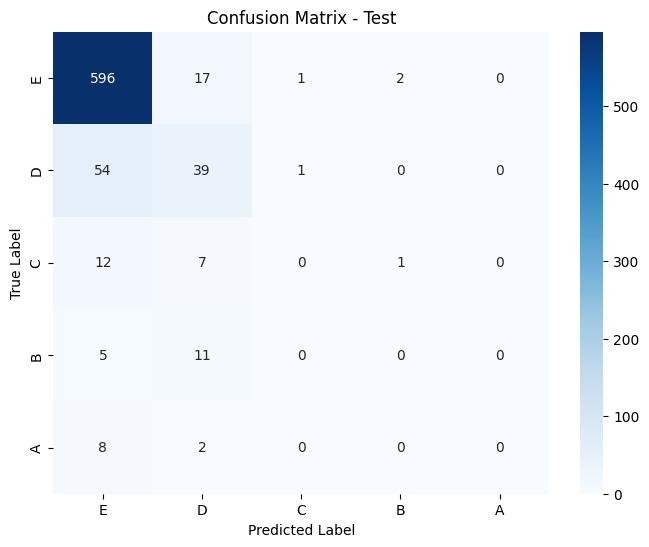

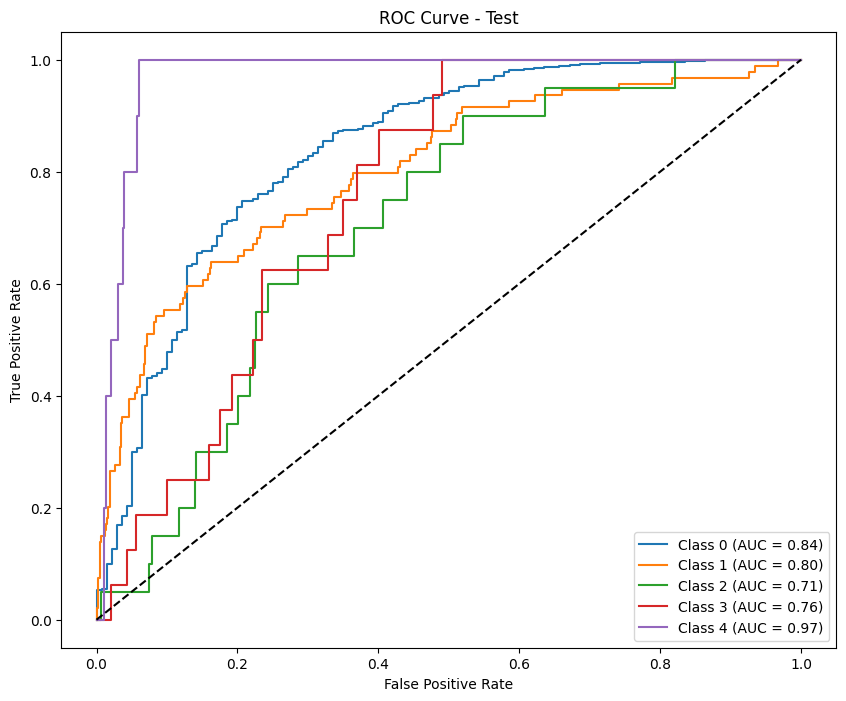

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.84045184 0.61813292 0.68423219 0.64485344 0.8457539 ]
Precision (per class): [0.78597325 0.74941779 0.71699741 0.66153846 0.81333333]
Recall (per class): [0.9030451  0.52598889 0.65433071 0.62898936 0.88086643]
Accuracy: 0.7666
AUC (One-vs-Rest): 0.9413

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      6962
           D       0.75      0.53      0.62      3059
           C       0.72      0.65      0.68      1270
           B       0.66      0.63      0.64       752
           A       0.81      0.88      0.85       277

    accuracy                           0.77     12320
   macro avg       0.75      0.72      0.73     12320
weighted avg       0.76      0.77      0.76     12320



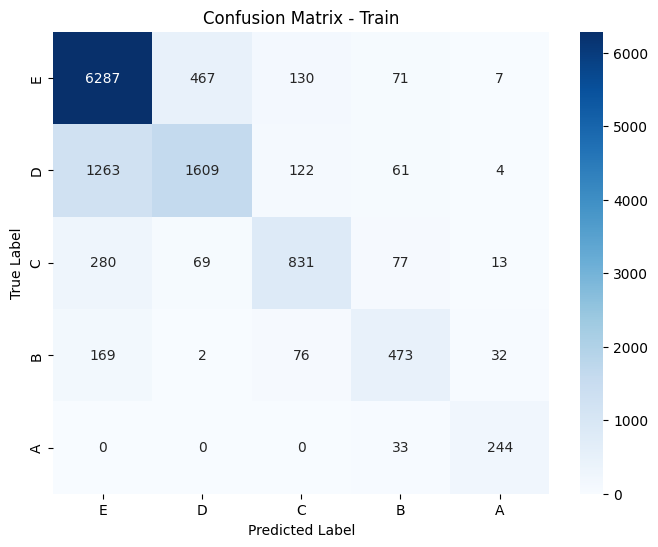

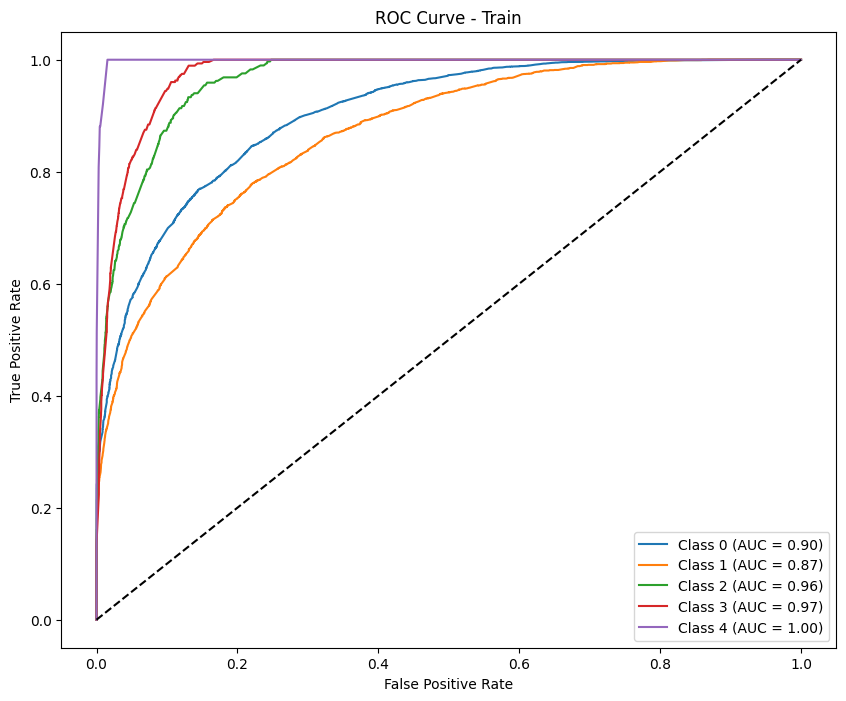

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9222395  0.44827586 0.         0.         0.        ]
Precision (per class): [0.88507463 0.4875     0.         0.         0.        ]
Recall (per class): [0.96266234 0.41489362 0.         0.         0.        ]
Accuracy: 0.8360
AUC (One-vs-Rest): 0.7772

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.96      0.92       616
           D       0.49      0.41      0.45        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.27      0.28      0.27       756
weighted avg       0.78      0.84      0.81       756



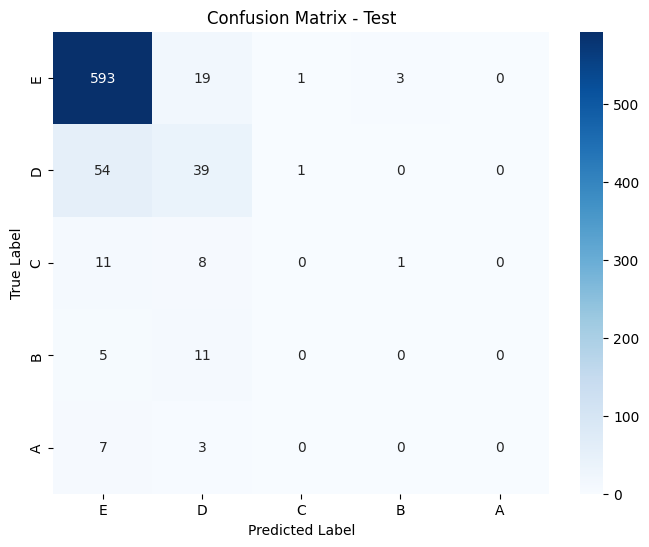

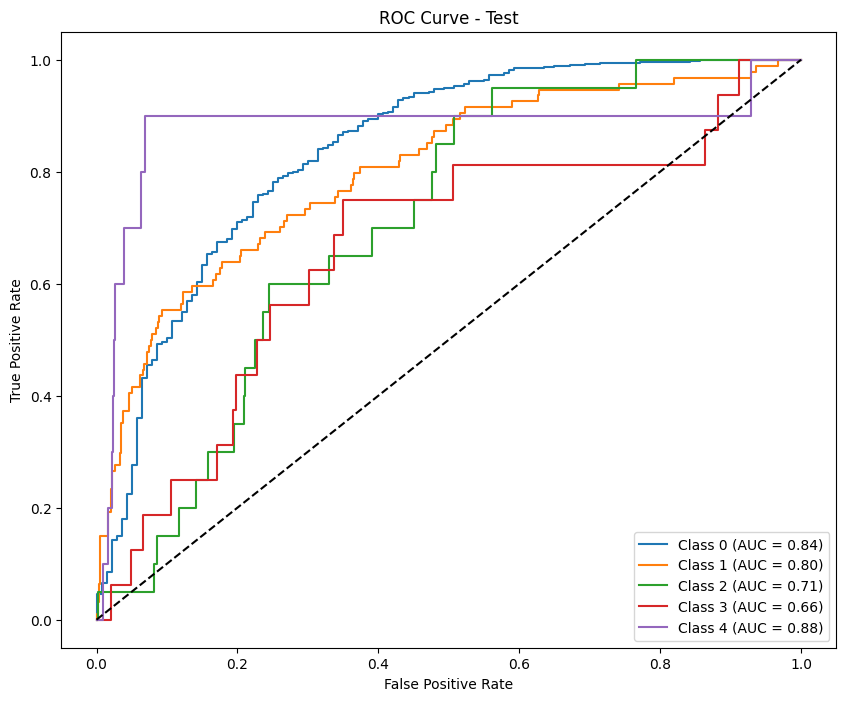


Permutation Importance for phase: phase1


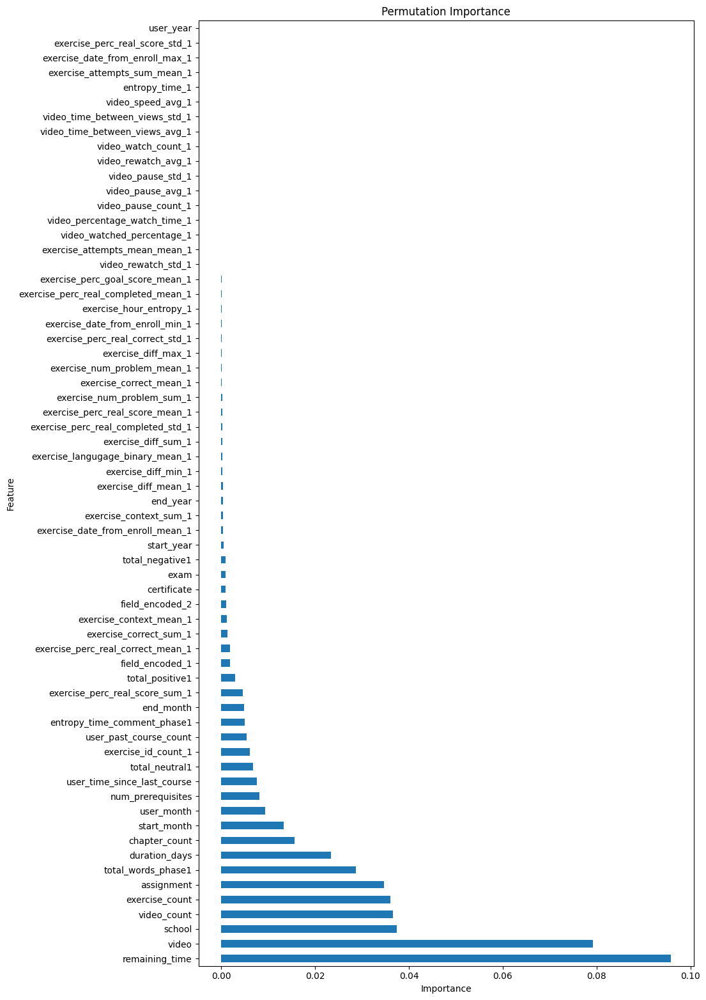

                            Feature  Importance
20                   remaining_time    0.095881
17                            video    0.079261
0                            school    0.037459
9                       video_count    0.036526
10                   exercise_count    0.035988
..                              ...         ...
59                   entropy_time_1    0.000000
27     exercise_attempts_sum_mean_1    0.000000
31  exercise_date_from_enroll_max_1   -0.000030
46   exercise_perc_real_score_std_1   -0.000041
7                         user_year   -0.000101

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


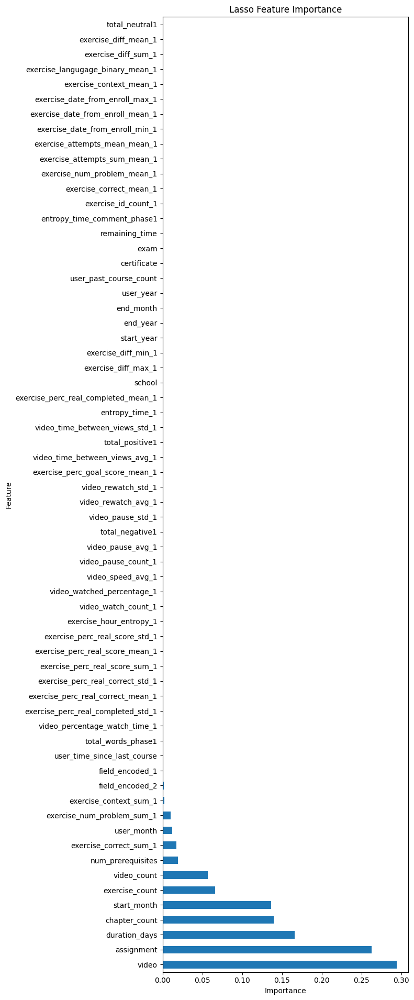

                             Feature  Importance
17                             video    0.294129
16                        assignment    0.263042
19                     duration_days    0.166154
11                     chapter_count    0.139806
4                        start_month    0.136260
..                               ...         ...
33           exercise_context_mean_1    0.000000
34  exercise_langugage_binary_mean_1    0.000000
35               exercise_diff_sum_1    0.000000
36              exercise_diff_mean_1    0.000000
63                    total_neutral1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                             Feature  Importance
15                       certificate    0.132228
44    exercise_perc_real_score_sum_1    0.119650
17                             video    0.093657
16                        assignment    0.060909
34  exercise_langugage_binary_mean_1    0.035227
..                               

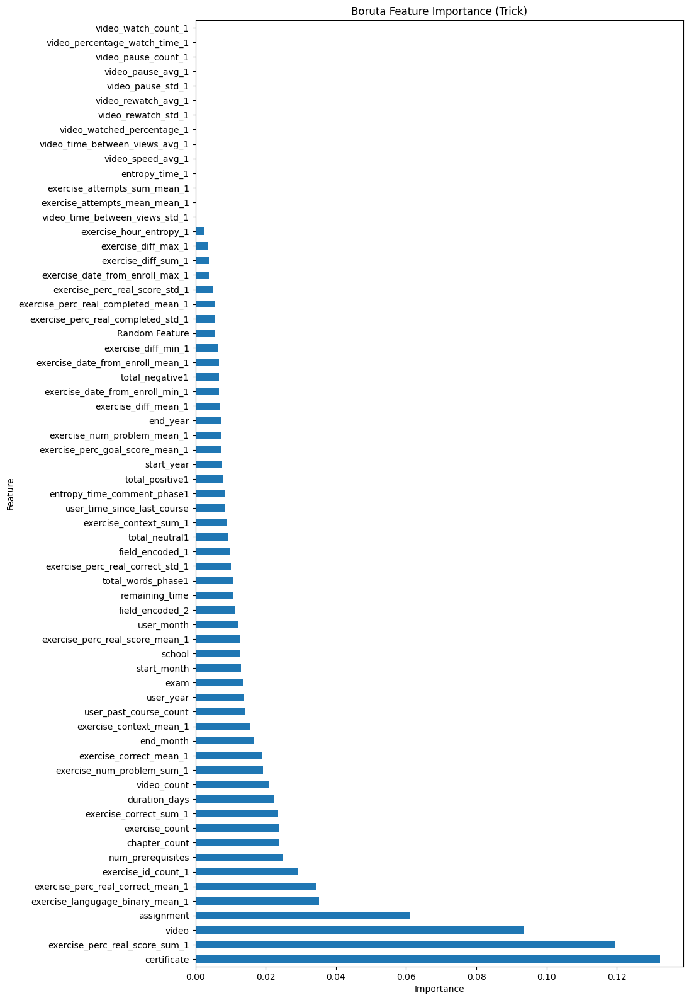

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83901484 0.55692874 0.70787402 0.65398168 0.88461538]
Precision (per class): [0.77446552 0.77867647 0.68625954 0.67343977 0.85185185]
Recall (per class): [0.91530249 0.43348342 0.73089431 0.63561644 0.92      ]
Accuracy: 0.7593
AUC (One-vs-Rest): 0.9408

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.92      0.84      5620
           D       0.78      0.43      0.56      2443
           C       0.69      0.73      0.71      1230
           B       0.67      0.64      0.65       730
           A       0.85      0.92      0.88       275

    accuracy                           0.76     10298
   macro 

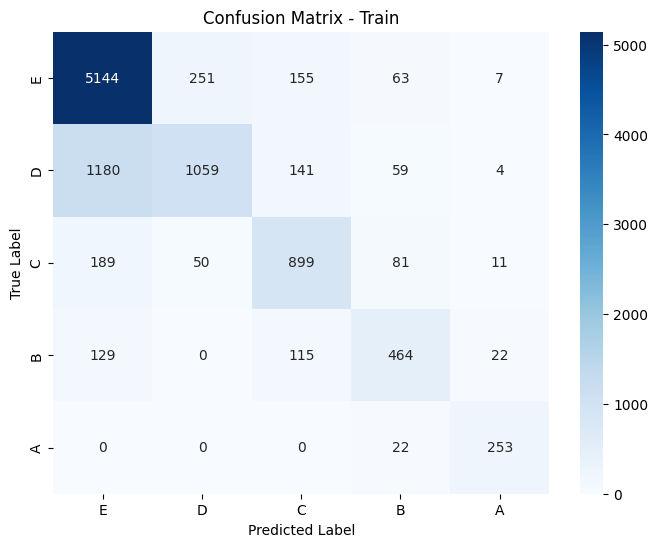

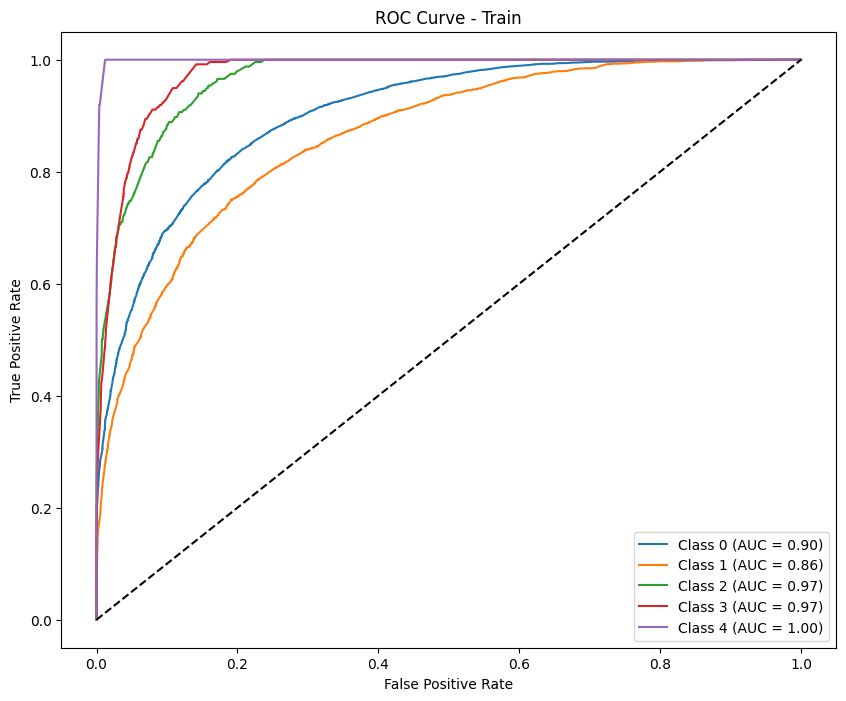

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90253262 0.28148148 0.         0.         0.        ]
Precision (per class): [0.84726225 0.44186047 0.         0.         0.        ]
Recall (per class): [0.96551724 0.20652174 0.         0.         0.        ]
Accuracy: 0.8137
AUC (One-vs-Rest): 0.7568

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.97      0.90       609
           D       0.44      0.21      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.26      0.23      0.24       746
weighted avg       0.75      0.81      0.77       746



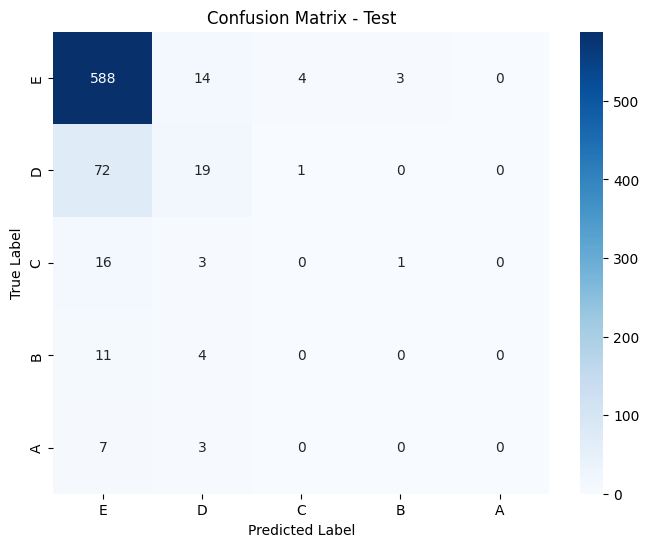

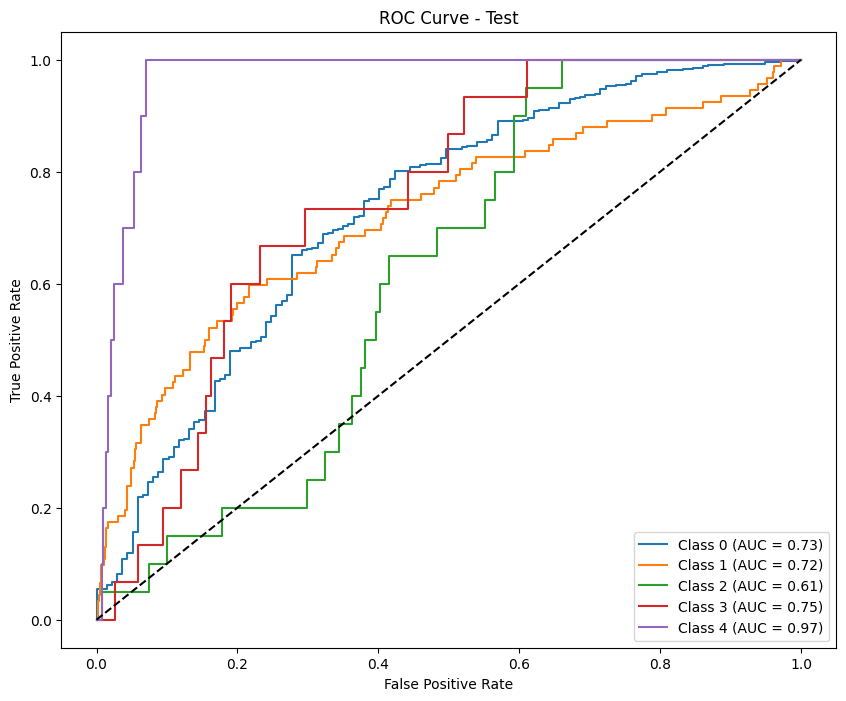

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83616679 0.59113772 0.71263452 0.66710526 0.88927944]
Precision (per class): [0.79687248 0.71247113 0.69898358 0.64177215 0.86054422]
Recall (per class): [0.87953737 0.50511666 0.72682927 0.69452055 0.92      ]
Accuracy: 0.7604
AUC (One-vs-Rest): 0.9411

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.88      0.84      5620
           D       0.71      0.51      0.59      2443
           C       0.70      0.73      0.71      1230
           B       0.64      0.69      0.67       730
           A       0.86      0.92      0.89       275

    accuracy                           0.76     10298
   macro avg       0.74      0.75      0.74     10298
weighted avg       0.76      0.76      0.75     10298



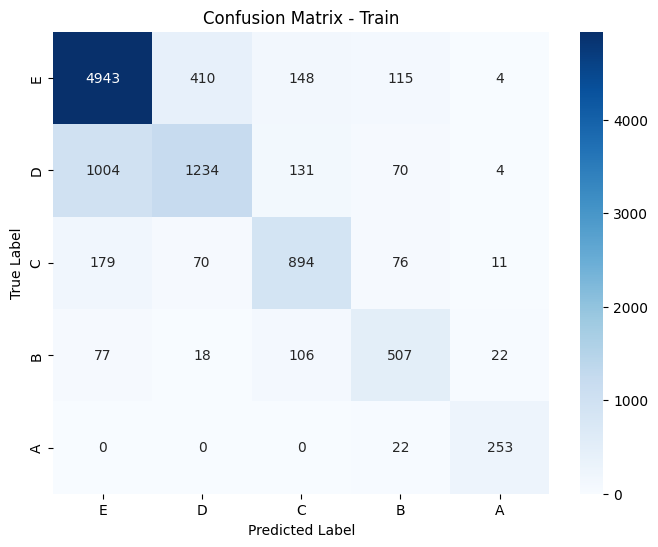

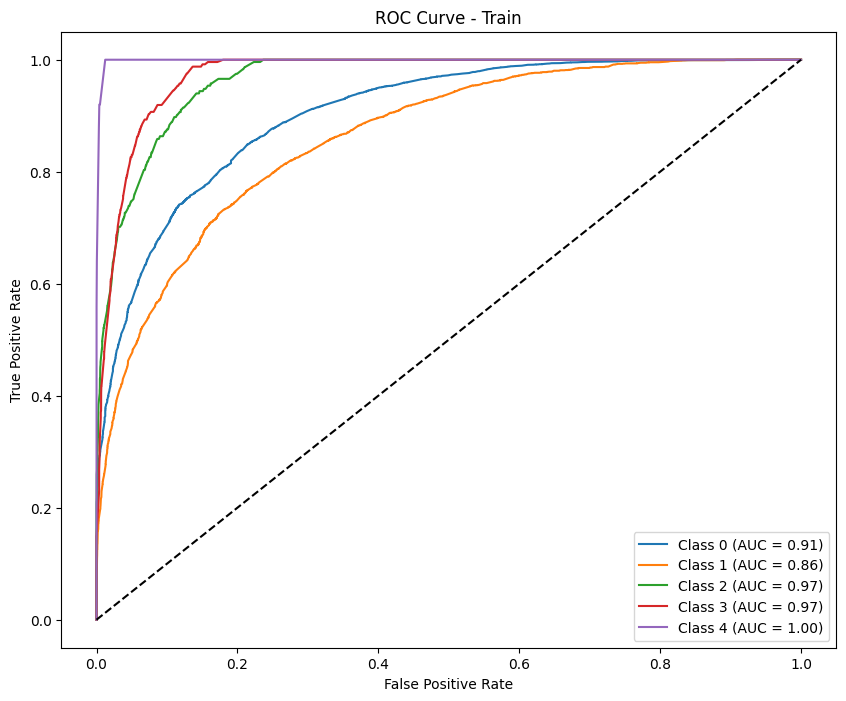

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9003861  0.28169014 0.         0.         0.        ]
Precision (per class): [0.84985423 0.4        0.         0.         0.        ]
Recall (per class): [0.95730706 0.2173913  0.         0.         0.        ]
Accuracy: 0.8083
AUC (One-vs-Rest): 0.7287

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.96      0.90       609
           D       0.40      0.22      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.25      0.23      0.24       746
weighted avg       0.74      0.81      0.77       746



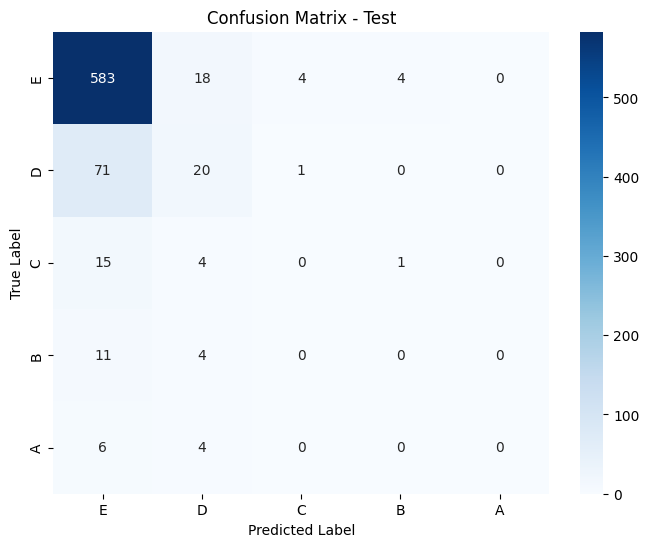

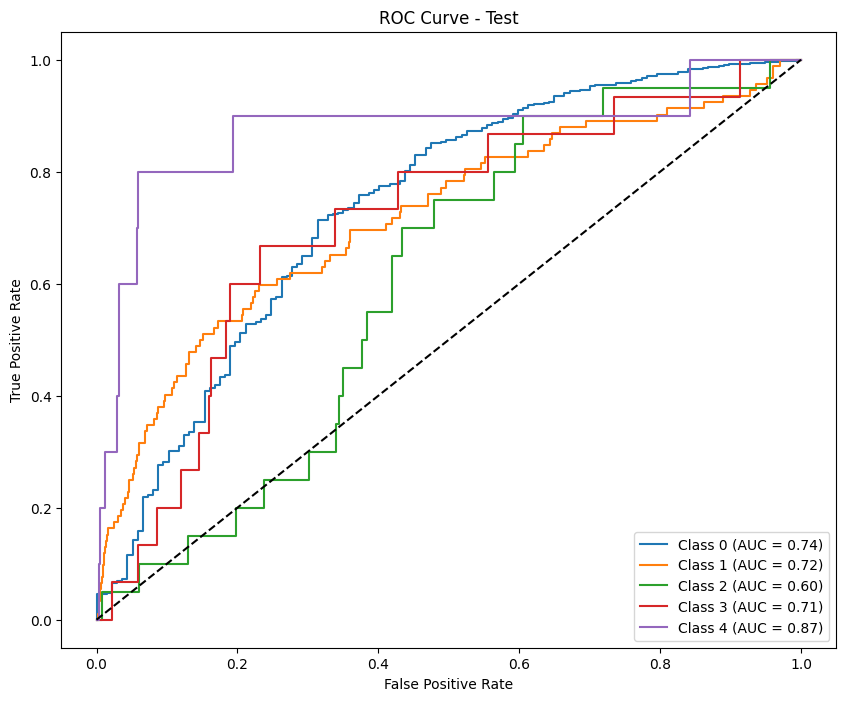


Permutation Importance for phase: phase2


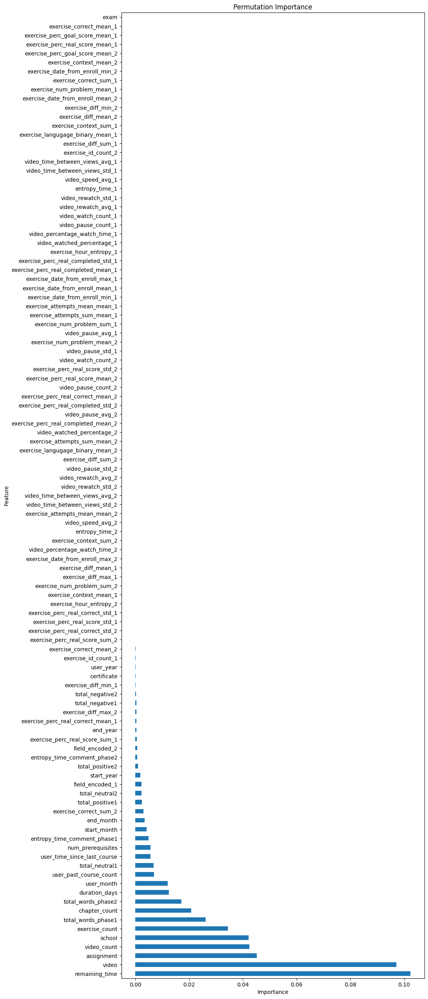

                            Feature  Importance
20                   remaining_time    0.102399
17                            video    0.097191
16                       assignment    0.045227
9                       video_count    0.042472
0                            school    0.042120
..                              ...         ...
82  exercise_perc_goal_score_mean_2   -0.000049
45  exercise_perc_real_score_mean_1   -0.000049
39  exercise_perc_goal_score_mean_1   -0.000061
24          exercise_correct_mean_1   -0.000061
18                             exam   -0.000073

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


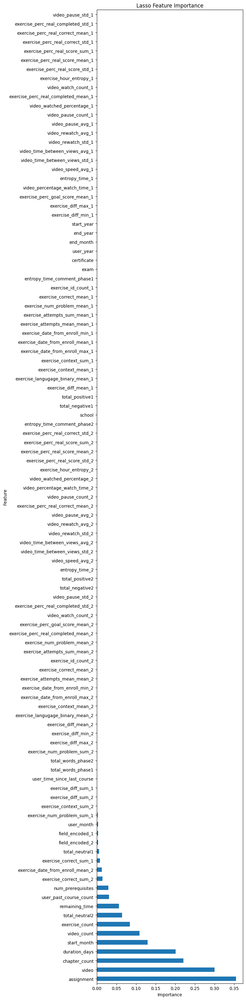

                               Feature  Importance
16                          assignment    0.354874
17                               video    0.300730
11                       chapter_count    0.220789
19                       duration_days    0.201159
4                          start_month    0.129558
..                                 ...         ...
44      exercise_perc_real_score_sum_1    0.000000
43    exercise_perc_real_correct_std_1    0.000000
42   exercise_perc_real_correct_mean_1    0.000000
41  exercise_perc_real_completed_std_1    0.000000
53                   video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                           Feature  Importance
15                     certificate    0.121583
17                           video    0.113528
16                      assignment    0.055979
10                  exercise_count    0.022794
66          exercise_correct_sum_2    0.022522
..                  

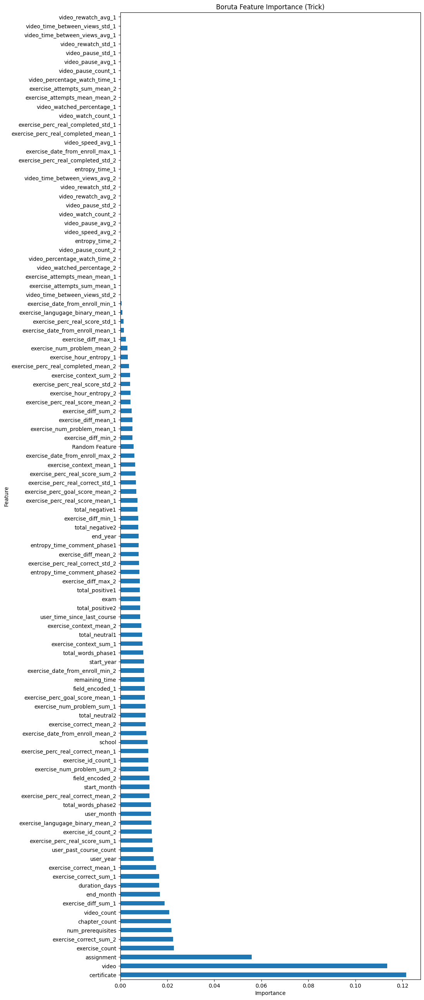

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84372177 0.58127258 0.72263993 0.68368032 0.86642599]
Precision (per class): [0.78540195 0.78117999 0.72023314 0.65089514 0.84210526]
Recall (per class): [0.91139735 0.46283186 0.72506287 0.71994342 0.89219331]
Accuracy: 0.7673
AUC (One-vs-Rest): 0.9457

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      5124
           D       0.78      0.46      0.58      2260
           C       0.72      0.73      0.72      1193
           B       0.65      0.72      0.68       707
           A       0.84      0.89      0.87       269

    accuracy                           0.77      9553
   macro 

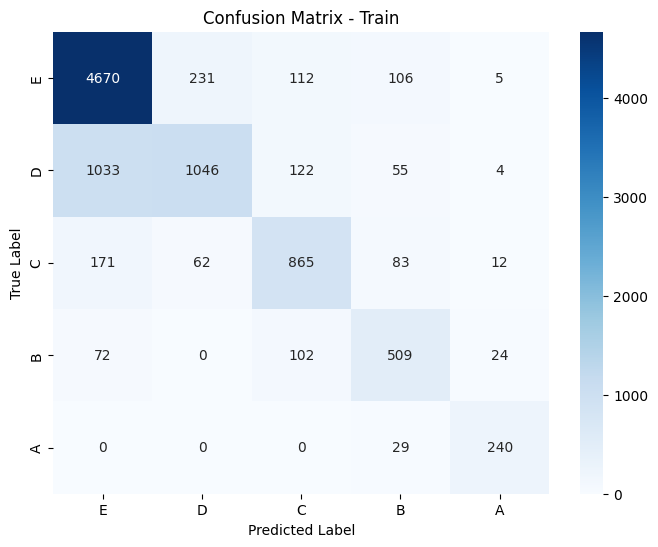

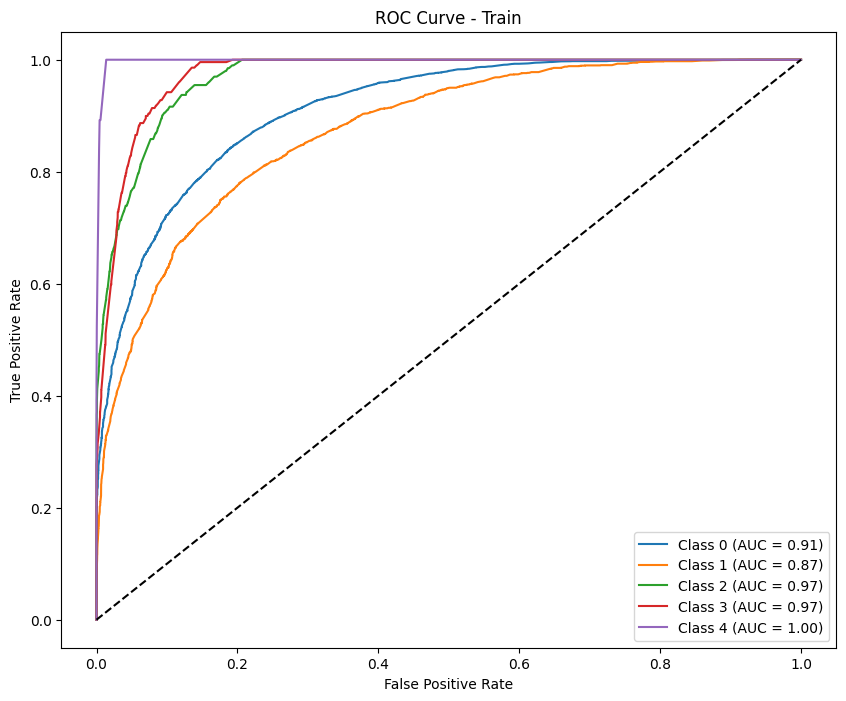

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89184953 0.125      0.08333333 0.         0.        ]
Precision (per class): [0.82703488 0.28       0.25       0.         0.        ]
Recall (per class): [0.96768707 0.08045977 0.05       0.         0.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.6462

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.08      0.12        87
           C       0.25      0.05      0.08        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.27      0.22      0.22       721
weighted avg       0.72      0.80      0.74       721



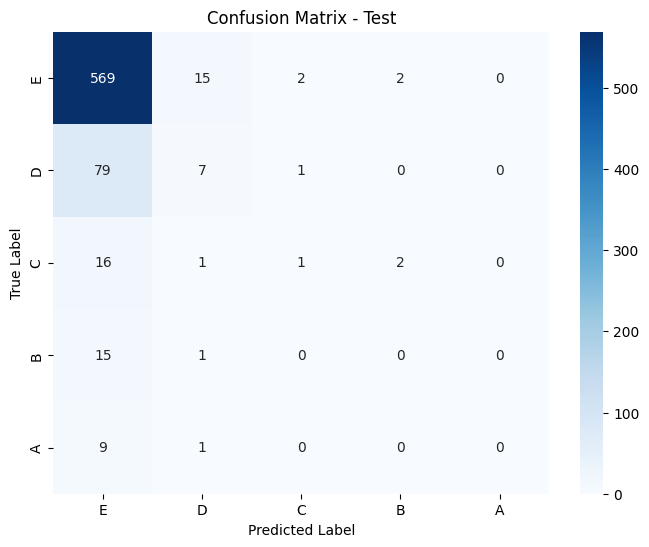

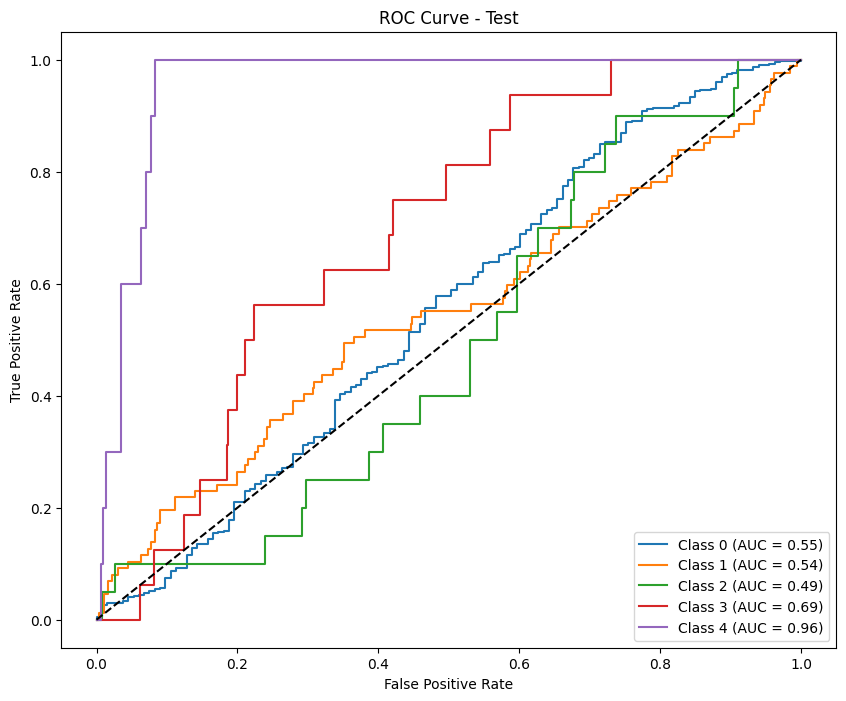

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84161892 0.61077844 0.72522898 0.68724832 0.87114338]
Precision (per class): [0.7992278  0.74193548 0.72043011 0.65389527 0.85106383]
Recall (per class): [0.88875878 0.51902655 0.7300922  0.7241867  0.89219331]
Accuracy: 0.7694
AUC (One-vs-Rest): 0.9462

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.74      0.52      0.61      2260
           C       0.72      0.73      0.73      1193
           B       0.65      0.72      0.69       707
           A       0.85      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.75      0.75      0.75      9553
weighted avg       0.77      0.77      0.76      9553



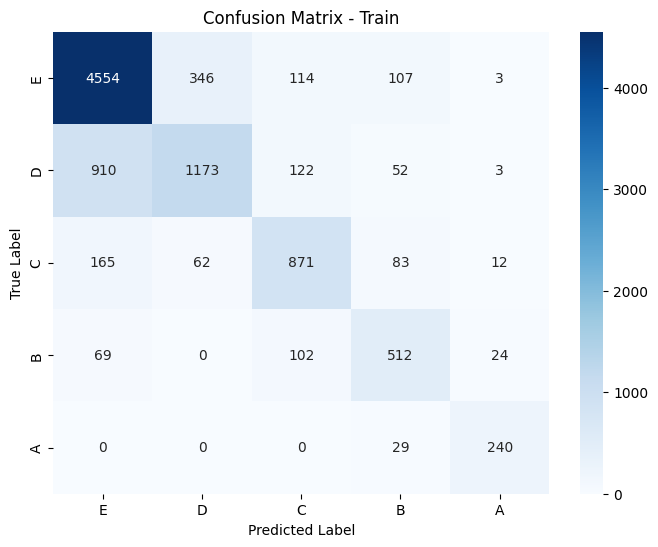

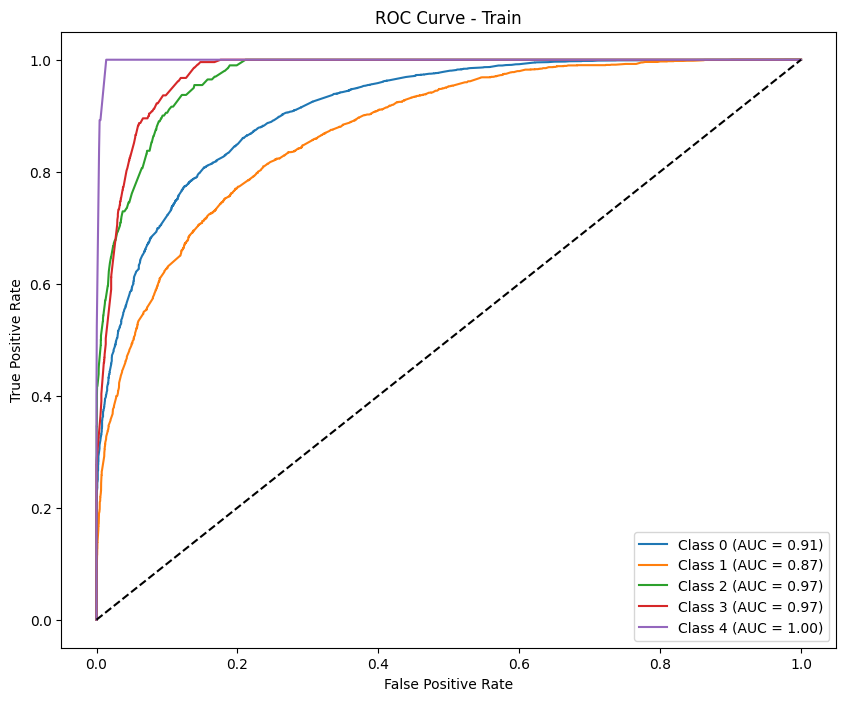

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8923802  0.13793103 0.         0.         0.        ]
Precision (per class): [0.82919708 0.27586207 0.         0.         0.        ]
Recall (per class): [0.96598639 0.09195402 0.         0.         0.        ]
Accuracy: 0.7989
AUC (One-vs-Rest): 0.6167

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.09      0.14        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.22      0.21      0.21       721
weighted avg       0.71      0.80      0.74       721



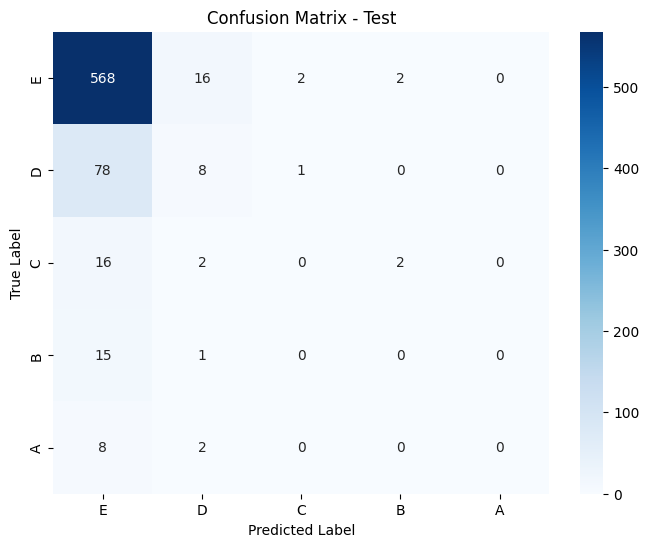

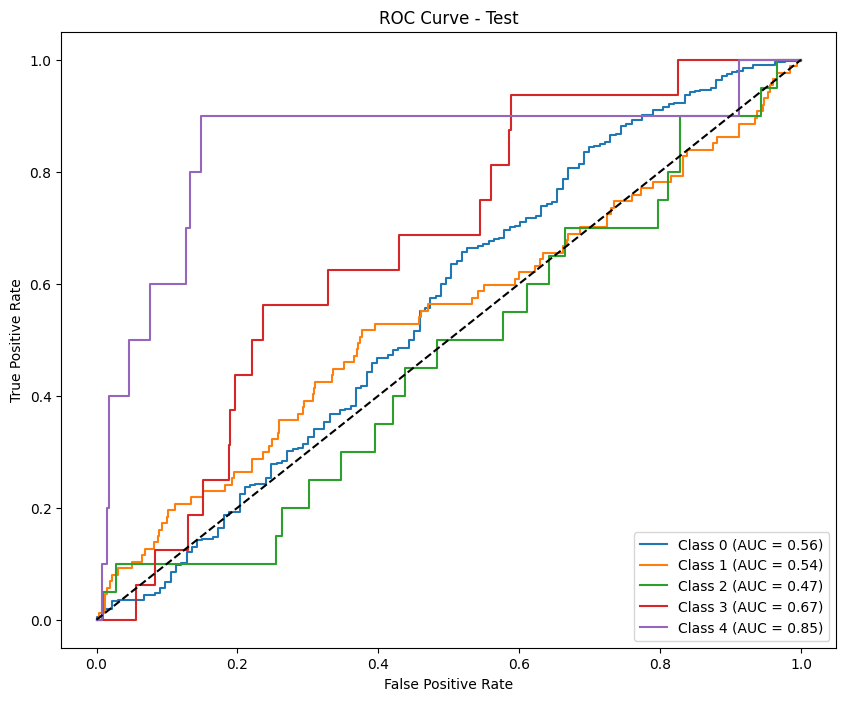

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85500544 0.6346229  0.81690141 0.76490747 0.90410959]
Precision (per class): [0.81742523 0.83111566 0.79248506 0.6975     0.825     ]
Recall (per class): [0.89620758 0.51327434 0.84287012 0.84673748 1.        ]
Accuracy: 0.8021
AUC (One-vs-Rest): 0.9594

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.90      0.86      3507
           D       0.83      0.51      0.63      1582
           C       0.79      0.84      0.82      1101
           B       0.70      0.85      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.80      7113
   macro 

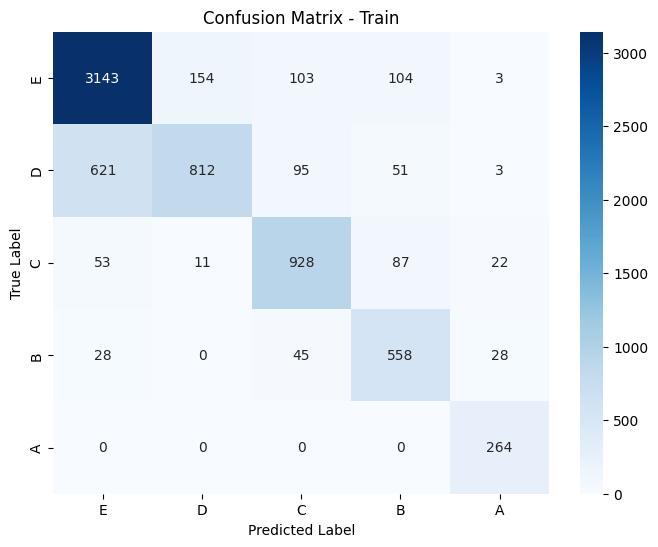

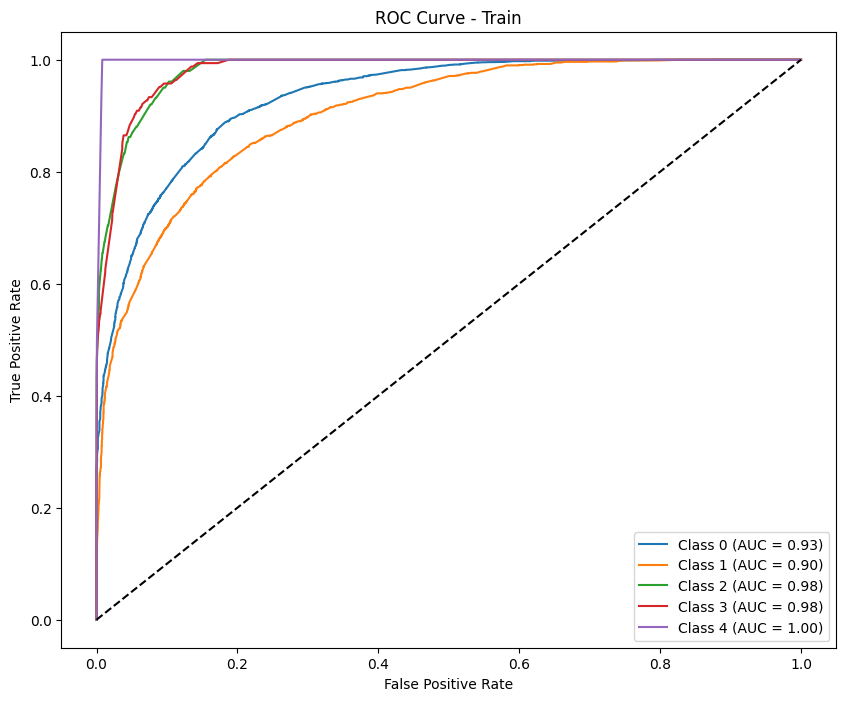

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87593672 0.03703704 0.         0.         0.        ]
Precision (per class): [0.81424149 0.08695652 0.         0.         0.        ]
Recall (per class): [0.94774775 0.02352941 0.         0.         0.        ]
Accuracy: 0.7686
AUC (One-vs-Rest): 0.5852

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.95      0.88       555
           D       0.09      0.02      0.04        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.77       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.77      0.71       687



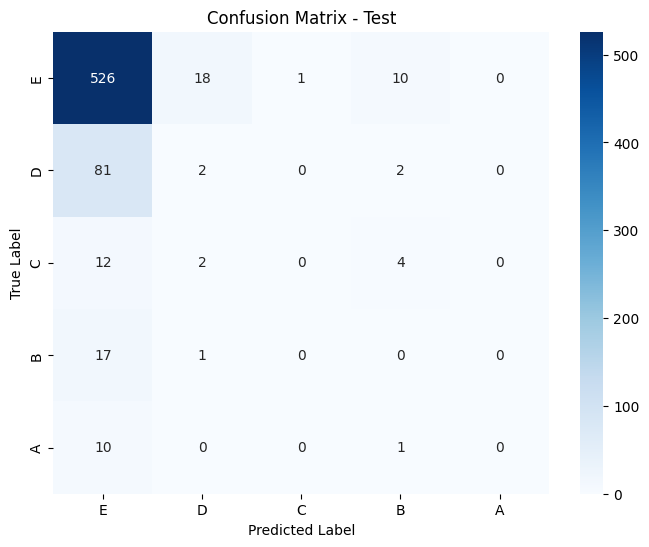

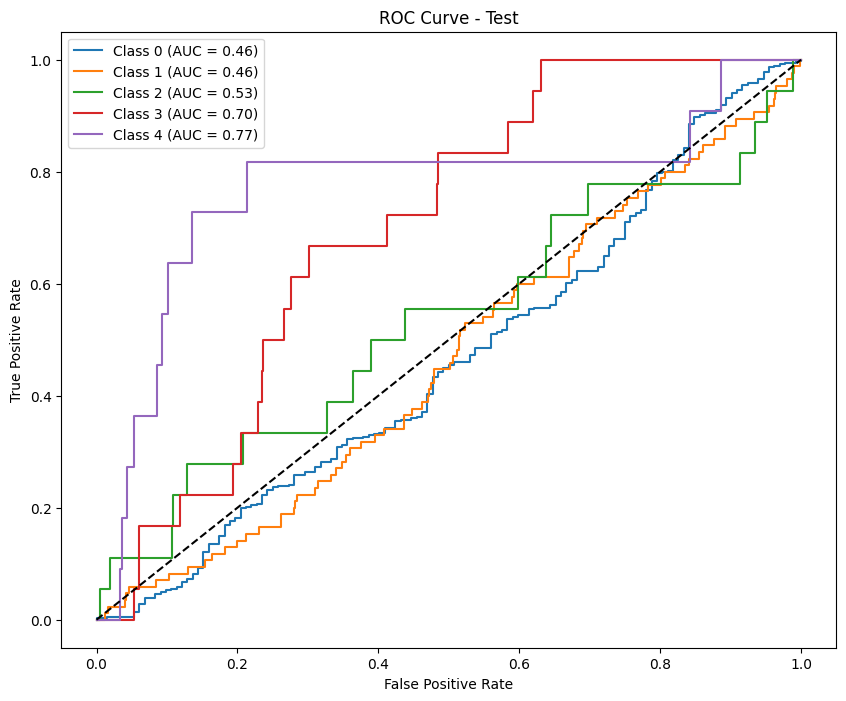

Results saved as test_results_calibrate_undersample_robust_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85564738 0.64971537 0.81726112 0.76641842 0.90566038]
Precision (per class): [0.82760458 0.81291548 0.79316239 0.69193154 0.82758621]
Recall (per class): [0.88565726 0.54108723 0.84287012 0.85887709 1.        ]
Accuracy: 0.8042
AUC (One-vs-Rest): 0.9599

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.89      0.86      3507
           D       0.81      0.54      0.65      1582
           C       0.79      0.84      0.82      1101
           B       0.69      0.86      0.77       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.79      0.83      0.80      7113
weighted avg       0.81      0.80      0.80      7113



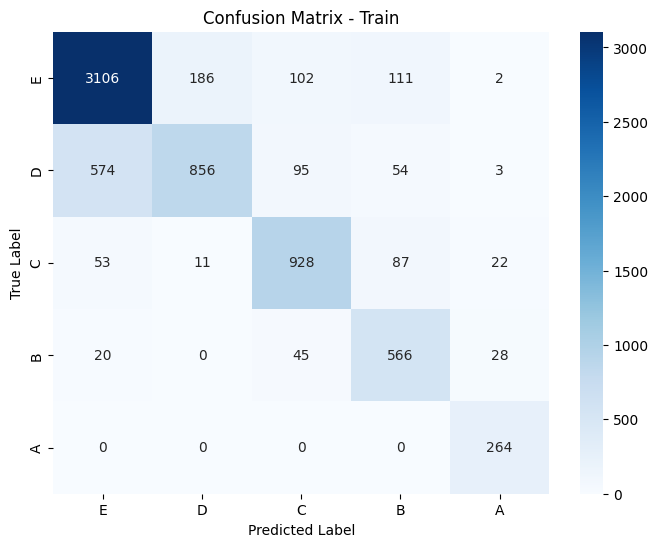

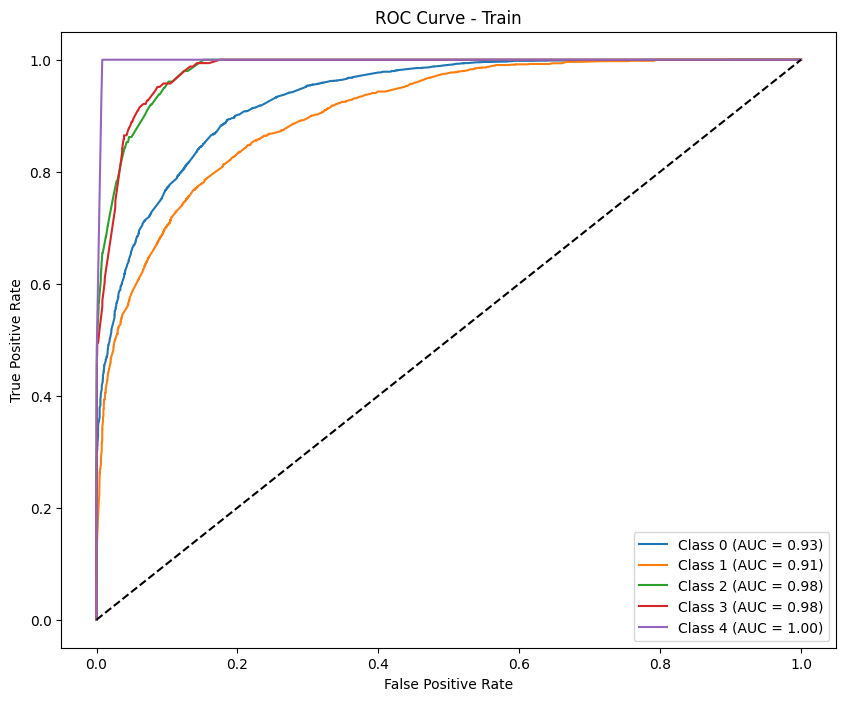

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87102178 0.03478261 0.         0.         0.        ]
Precision (per class): [0.81377152 0.06666667 0.         0.         0.        ]
Recall (per class): [0.93693694 0.02352941 0.         0.         0.        ]
Accuracy: 0.7598
AUC (One-vs-Rest): 0.5719

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.94      0.87       555
           D       0.07      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.76       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.76      0.71       687



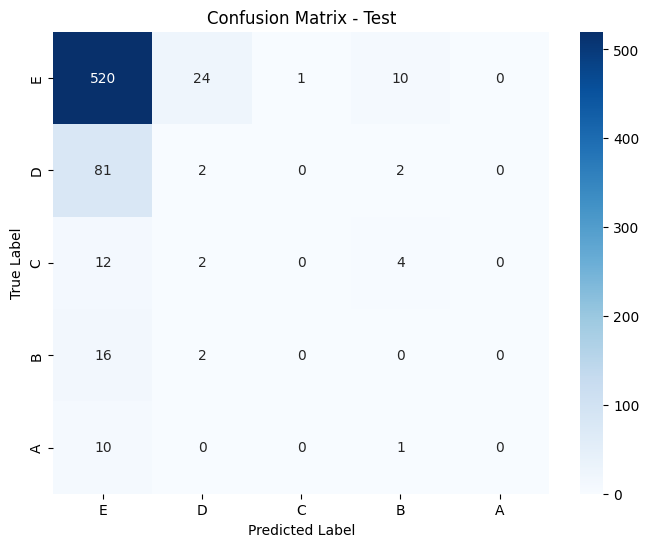

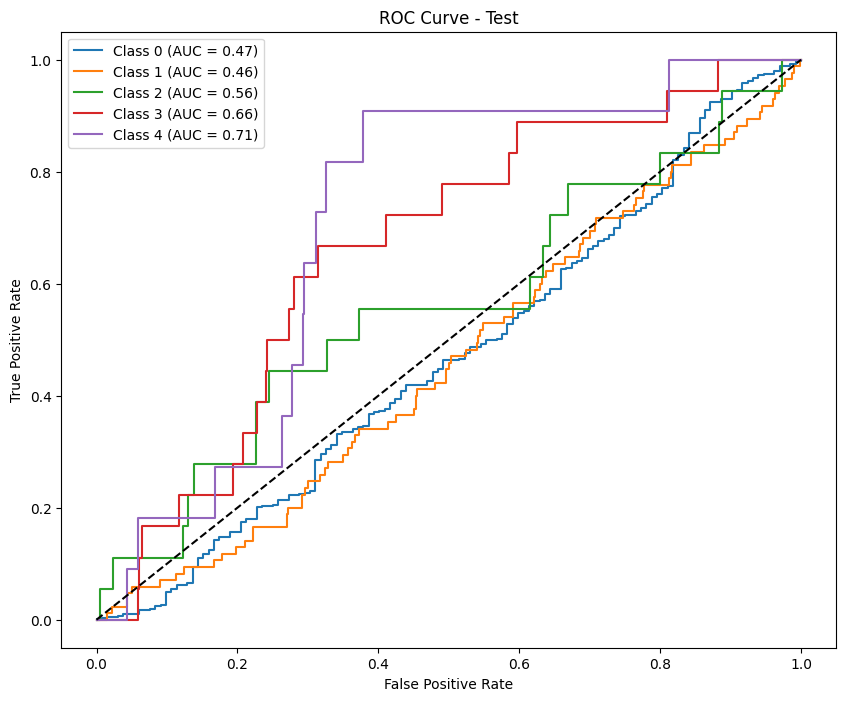

In [27]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, scale='robust', metric='f1_macro')

### smote

In [28]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='robust', metric='f1_macro')

# 3. Scale dữ liệu theo Log

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

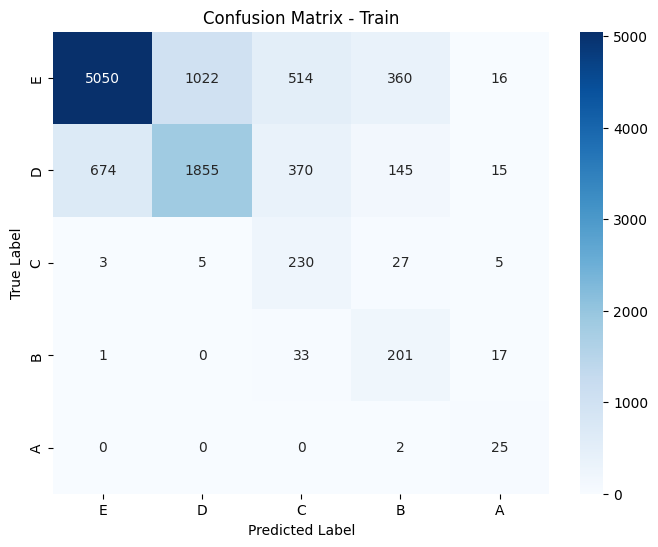

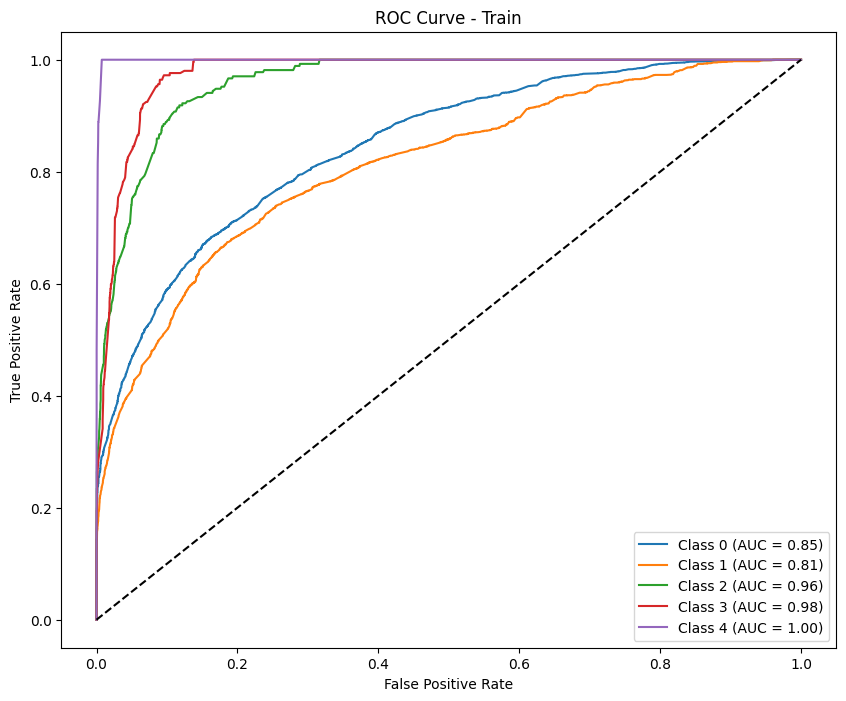

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90923318 0.4260355  0.         0.         0.        ]
Precision (per class): [0.8776435 0.48      0.        0.        0.       ]
Recall (per class): [0.94318182 0.38297872 0.         0.         0.        ]
Accuracy: 0.8161
AUC (One-vs-Rest): 0.7952

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.94      0.91       616
           D       0.48      0.38      0.43        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       756
   macro avg       0.27      0.27      0.27       756
weighted avg       0.77      0.82      0.79       756



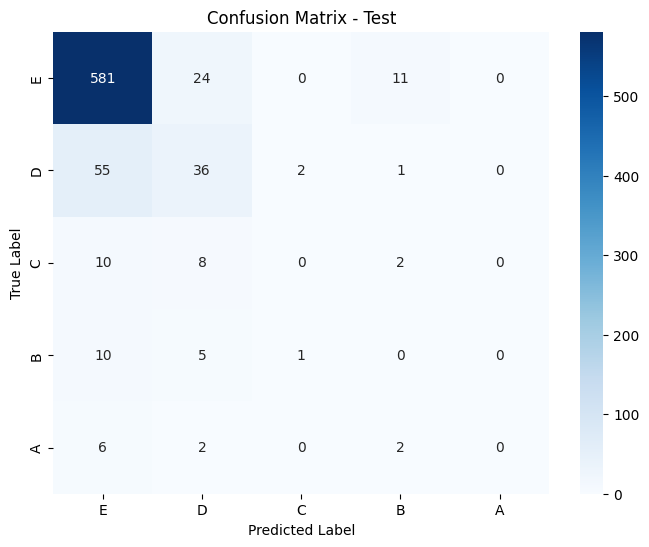

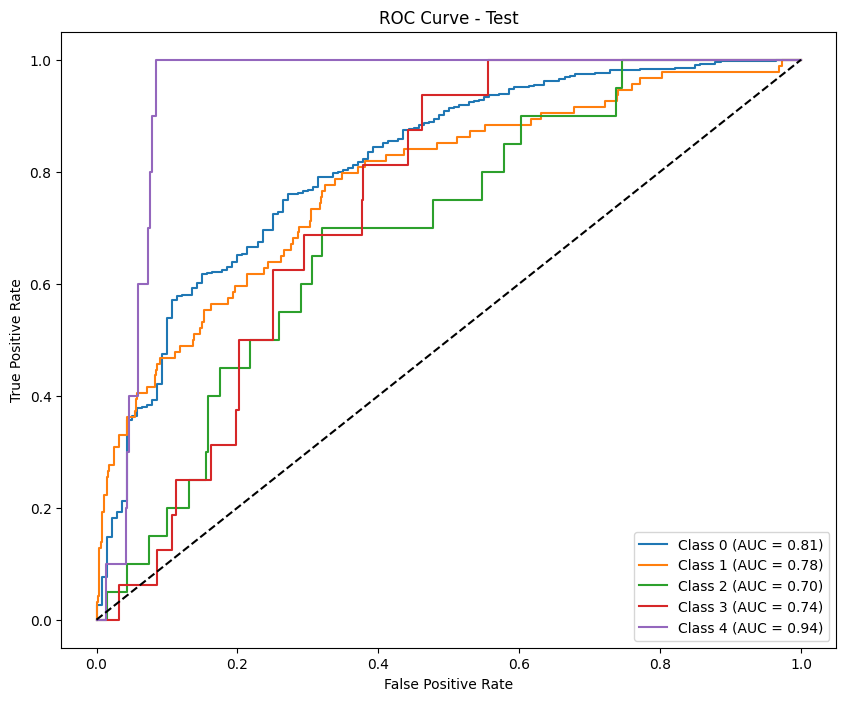

Results saved as test_results_calibrate_log_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.84385871 0.59070885 0.50943396 0.49916805 0.65671642]
Precision (per class): [0.78975707 0.7622739  0.51923077 0.42979943 0.55      ]
Recall (per class): [0.90591784 0.48218372 0.5        0.5952381  0.81481481]
Accuracy: 0.7653
AUC (One-vs-Rest): 0.9284

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      6962
           D       0.76      0.48      0.59      3059
           C       0.52      0.50      0.51       270
           B       0.43      0.60      0.50       252
           A       0.55      0.81      0.66        27

    accuracy                           0.77     10570
   macro avg       0.61      0.66      0.62     10570
weighted avg       0.77      0.77      0.75     10570



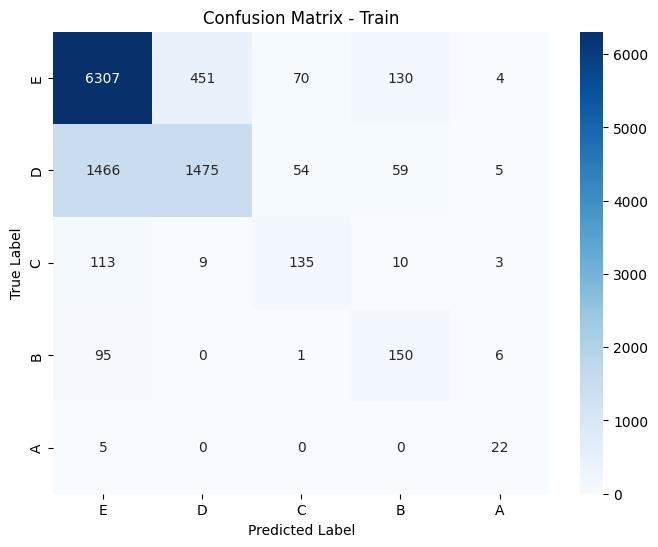

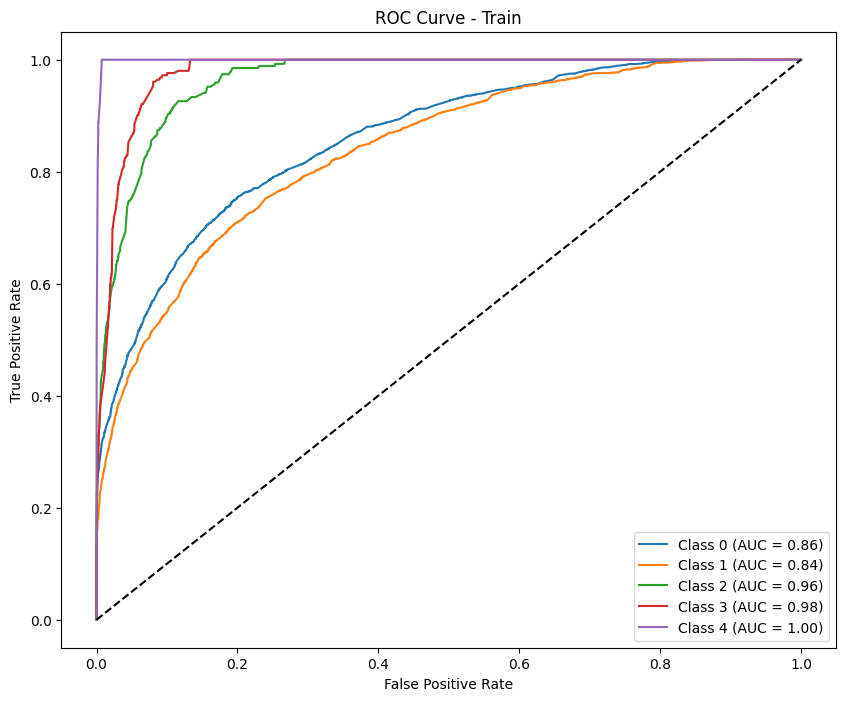

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91238671 0.39130435 0.         0.         0.        ]
Precision (per class): [0.85310734 0.61363636 0.         0.         0.        ]
Recall (per class): [0.98051948 0.28723404 0.         0.         0.        ]
Accuracy: 0.8347
AUC (One-vs-Rest): 0.7426

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.98      0.91       616
           D       0.61      0.29      0.39        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.83      0.79       756



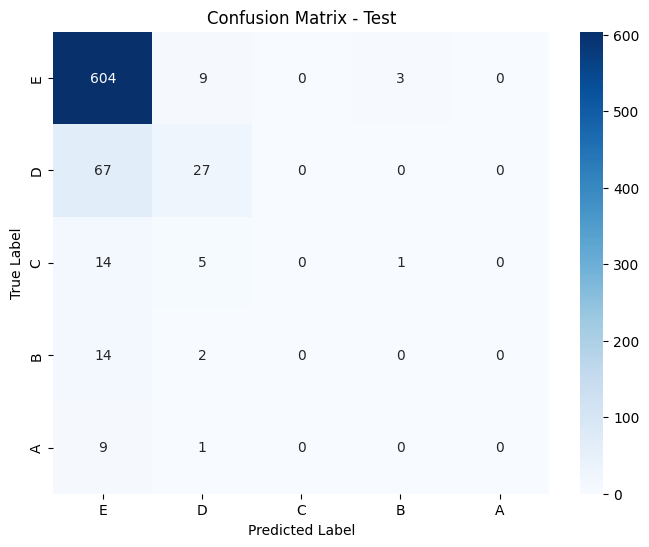

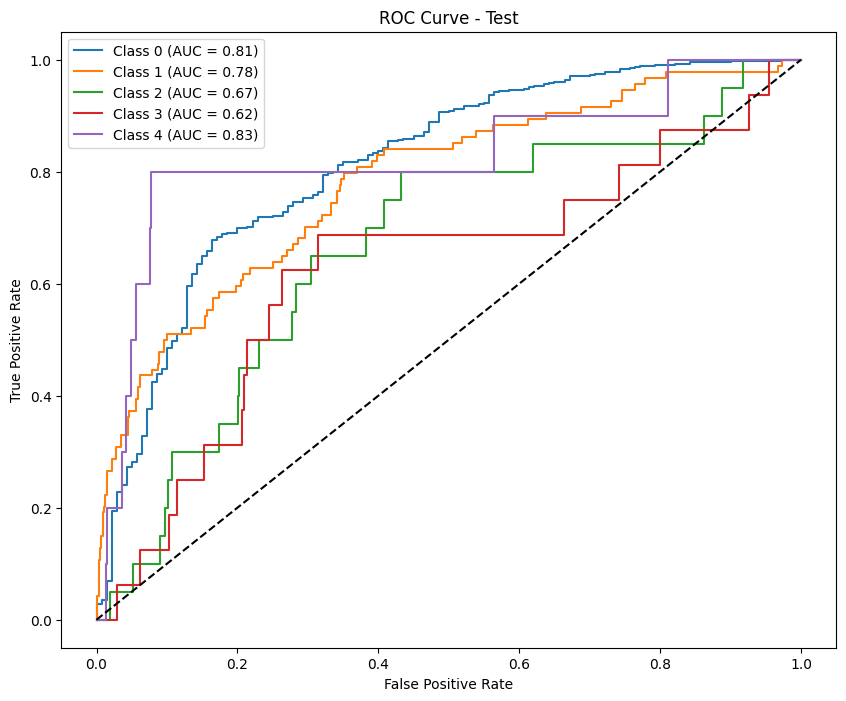


-------------Permutation Importance for phase: phase1---------


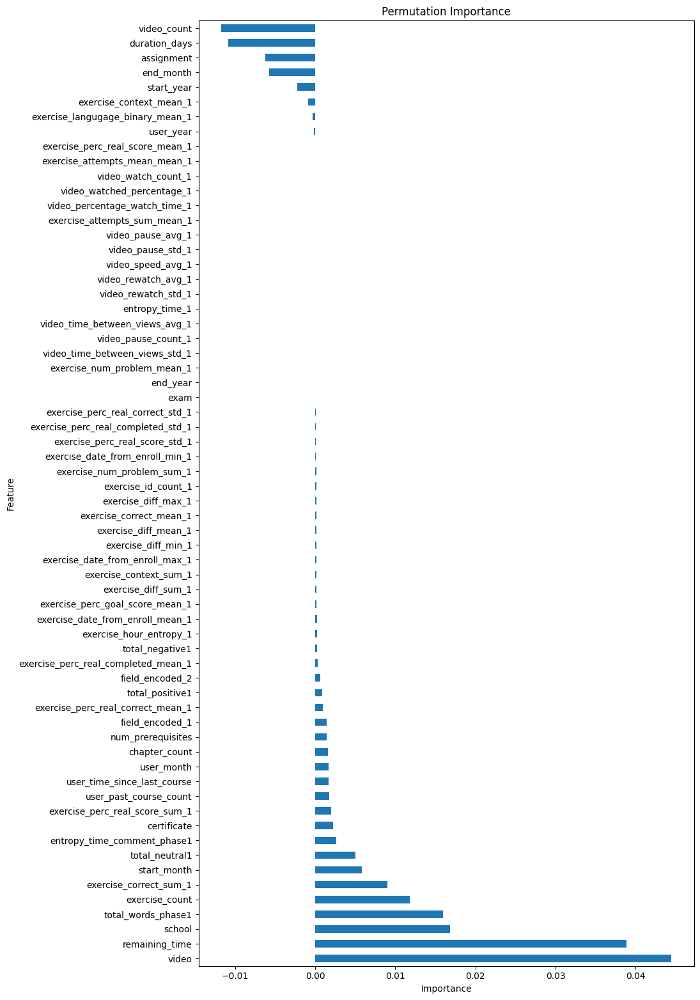

               Feature  Importance
17               video    0.044465
20      remaining_time    0.038895
0               school    0.016864
60  total_words_phase1    0.015989
10      exercise_count    0.011838
..                 ...         ...
3           start_year   -0.002259
6            end_month   -0.005747
16          assignment   -0.006232
19       duration_days   -0.010868
9          video_count   -0.011743

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


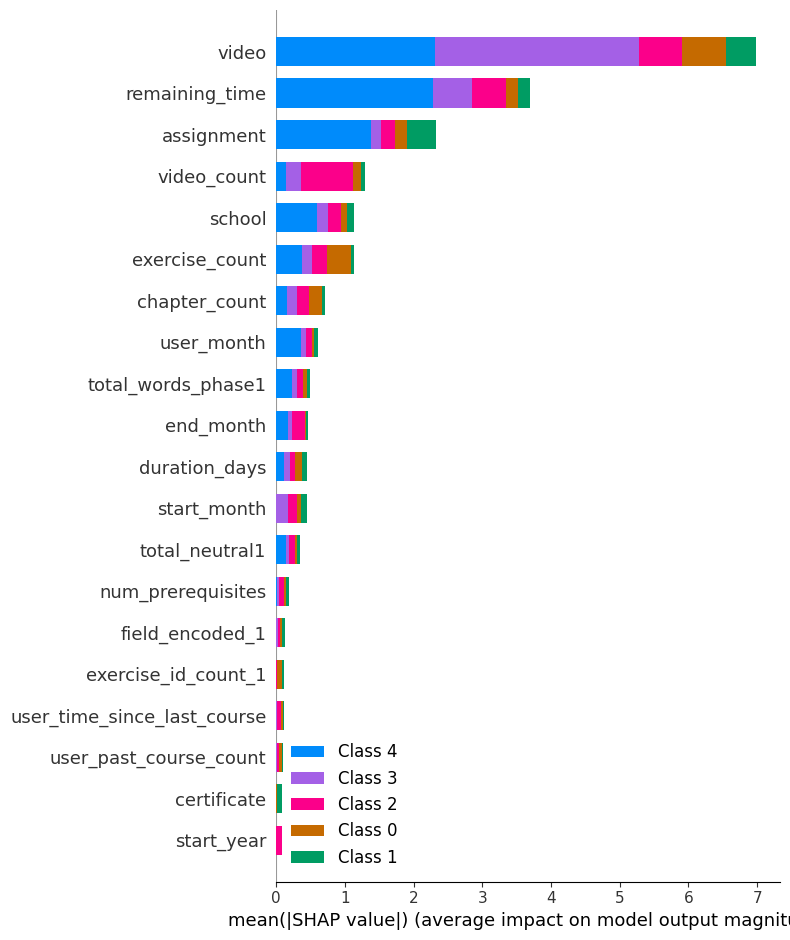


-----Lasso Feature Selection for phase: phase1----------


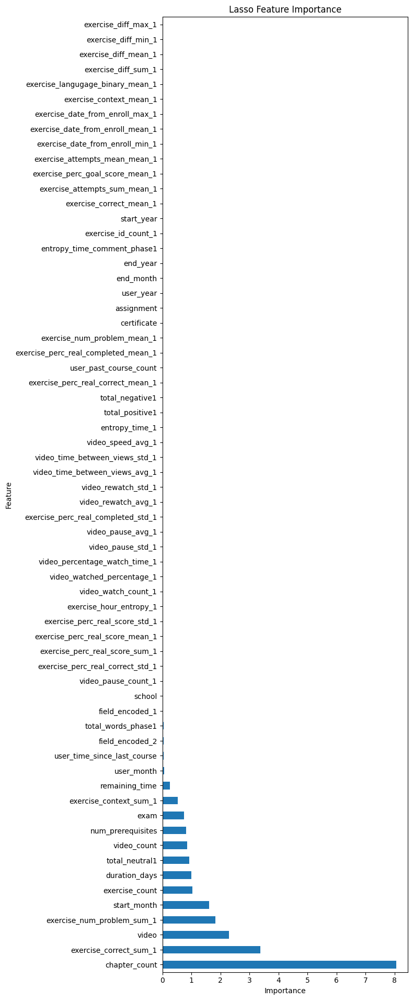

                             Feature  Importance
11                     chapter_count    8.053936
23            exercise_correct_sum_1    3.377562
17                             video    2.305080
25        exercise_num_problem_sum_1    1.825495
4                        start_month    1.603638
..                               ...         ...
34  exercise_langugage_binary_mean_1    0.000000
35               exercise_diff_sum_1    0.000000
36              exercise_diff_mean_1    0.000000
37               exercise_diff_min_1    0.000000
38               exercise_diff_max_1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                           Feature  Importance
15                     certificate    0.241595
44  exercise_perc_real_score_sum_1    0.150068
22             exercise_id_count_1    0.045477
17                           video    0.037486
16                      assignment    0.029394
..                

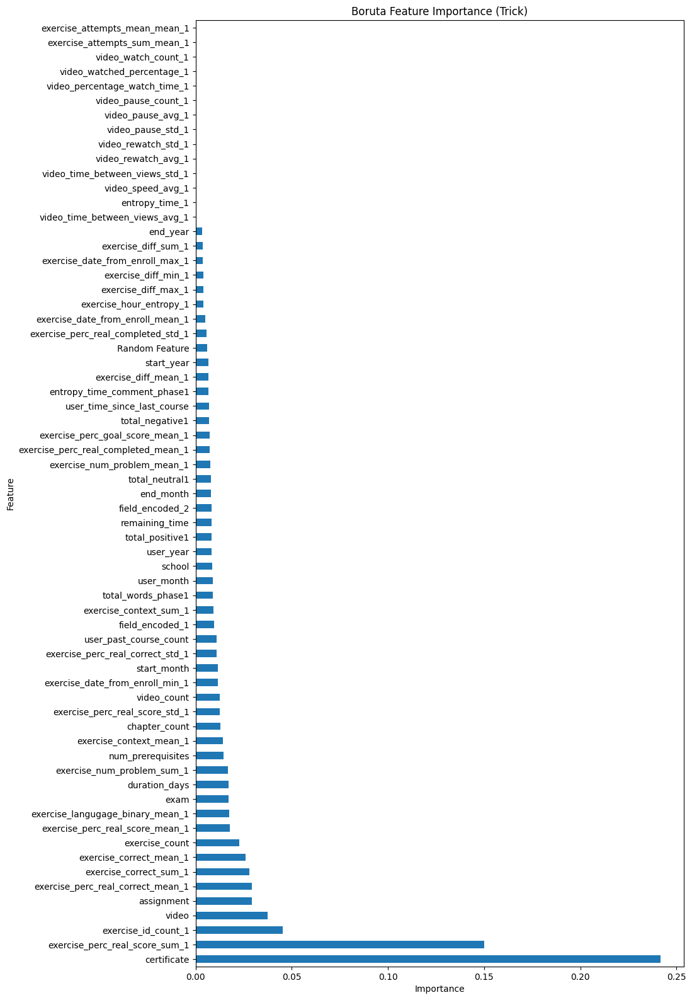

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Label: 0 --> Weight: 0.3042
Label: 1 --> Weight: 0.6998
Label: 2 --> Weight: 7.4330
Label: 3 --> Weight: 7.4330
Label: 4 --> Weight: 68.3840
Results saved as test_results_log_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.78795015 0.60915999 0.34874759 0.43722944 0.62162162]
Precision (per class): [0.8783636  0.61129431 0.2240099  0.29106628 0.46938776]
Recall (per class): [0.71441281 0.60704052 0.78695652 0.87826087 0.92      ]
Accuracy: 0.6907
AUC (One-vs-Rest): 0.9134

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.71      0.79      5620
           D       0.61      0.61      0.61      2443
           C       0.22      0.79      0.35       230
           B       0.2

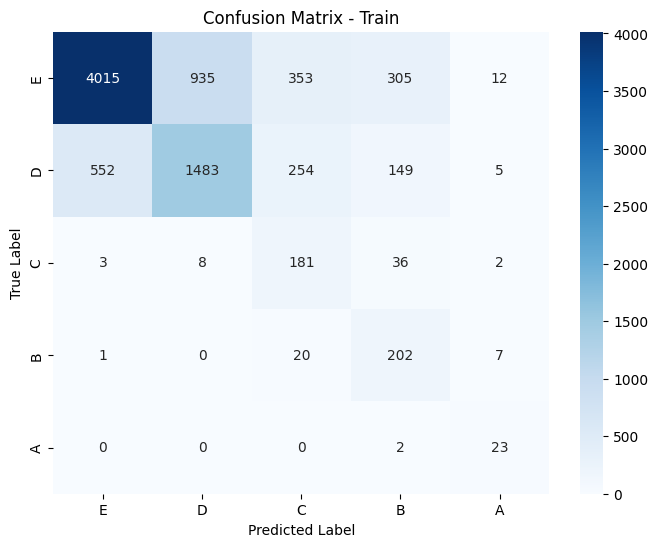

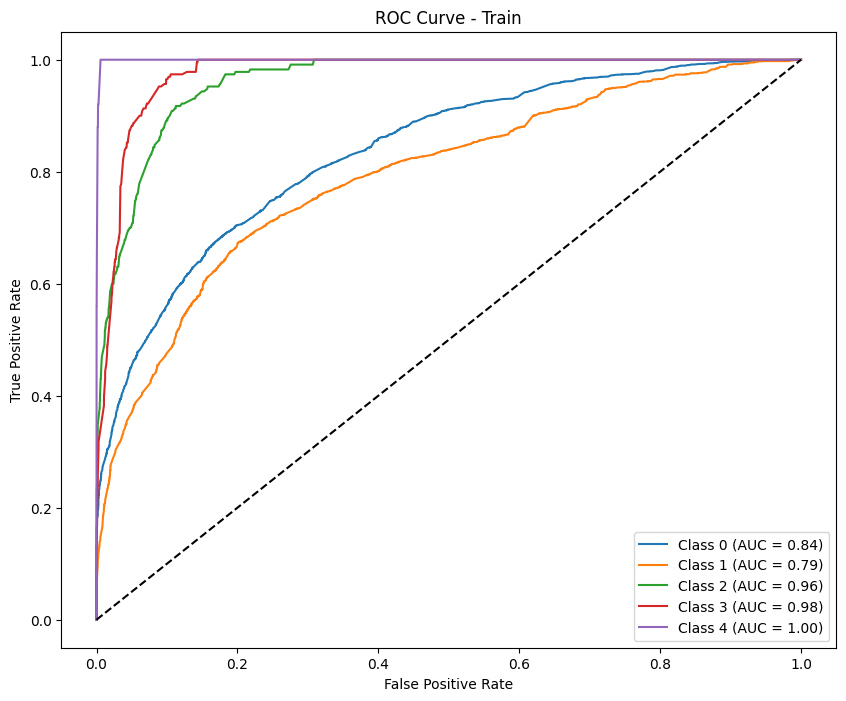


--- Test Metrics ---
F1 Score (per class): [0.8654311  0.26666667 0.         0.03076923 0.        ]
Precision (per class): [0.84968354 0.34482759 0.         0.02       0.        ]
Recall (per class): [0.8817734  0.2173913  0.         0.06666667 0.        ]
Accuracy: 0.7480
AUC (One-vs-Rest): 0.6801

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.88      0.87       609
           D       0.34      0.22      0.27        92
           C       0.00      0.00      0.00        20
           B       0.02      0.07      0.03        15
           A       0.00      0.00      0.00        10

    accuracy                           0.75       746
   macro avg       0.24      0.23      0.23       746
weighted avg       0.74      0.75      0.74       746



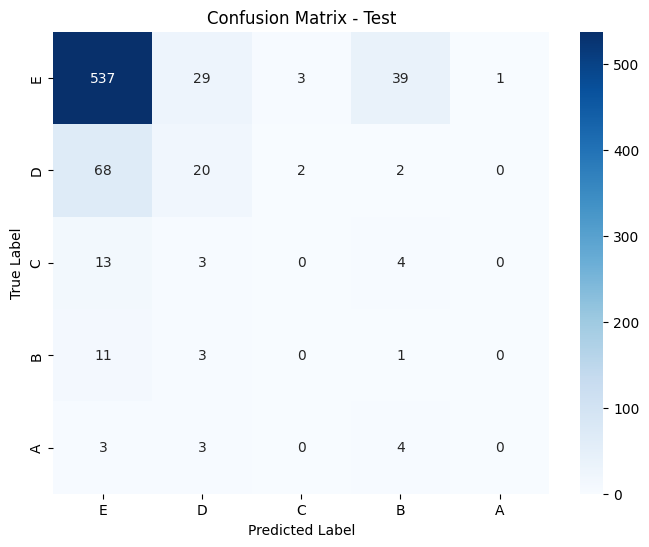

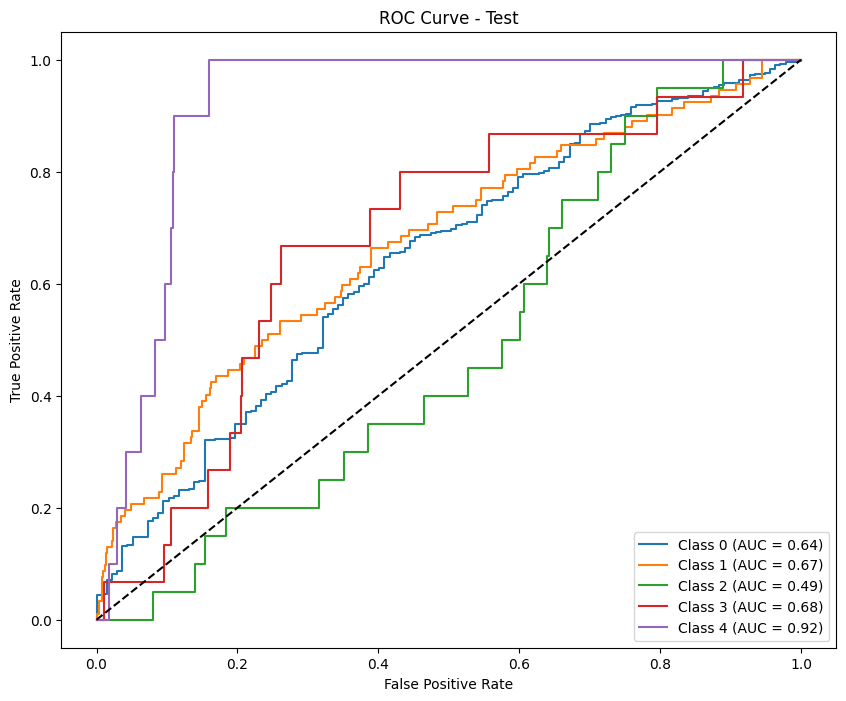

Results saved as test_results_calibrate_log_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.83837797 0.56118036 0.52609603 0.5        0.68656716]
Precision (per class): [0.78505979 0.74126344 0.5060241  0.42424242 0.54761905]
Recall (per class): [0.89946619 0.45149406 0.54782609 0.60869565 0.92      ]
Accuracy: 0.7542
AUC (One-vs-Rest): 0.9230

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      5620
           D       0.74      0.45      0.56      2443
           C       0.51      0.55      0.53       230
           B       0.42      0.61      0.50       230
           A       0.55      0.92      0.69        25

    accuracy                           0.75      8548
   macro avg       0.60      0.69      0.62      8548
weighted avg       0.75      0.75      0.74      8548



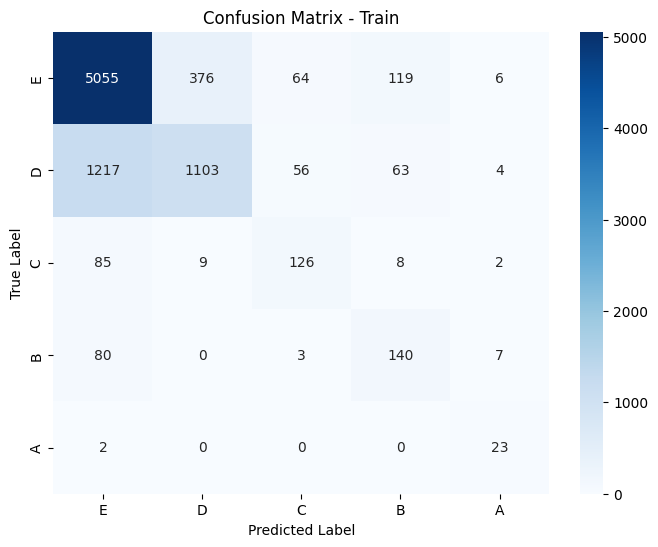

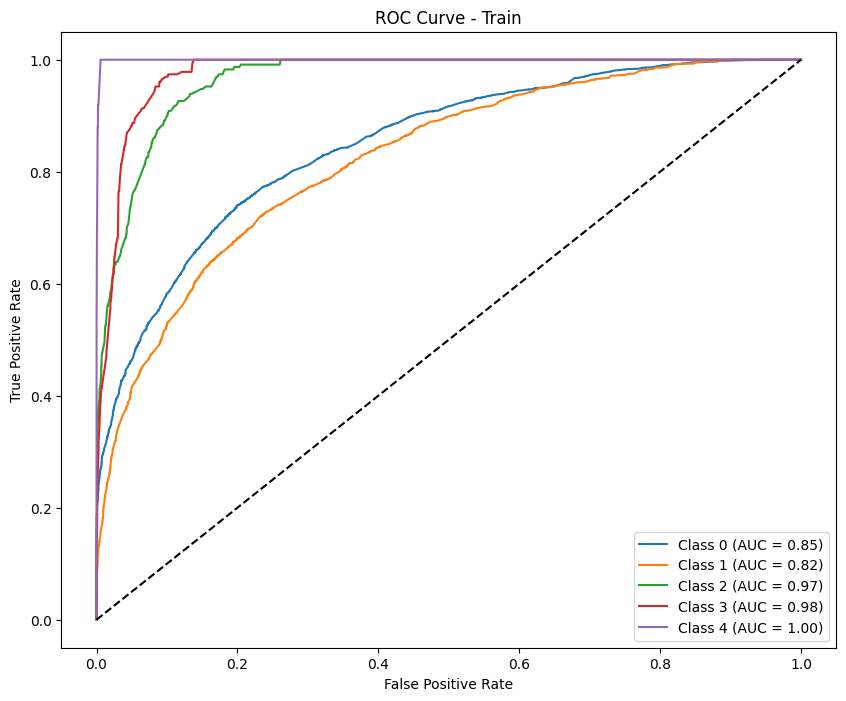

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.892261   0.17699115 0.         0.06451613 0.        ]
Precision (per class): [0.82933709 0.47619048 0.         0.0625     0.        ]
Recall (per class): [0.96551724 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.8029
AUC (One-vs-Rest): 0.6680

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       609
           D       0.48      0.11      0.18        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.80       746
   macro avg       0.27      0.23      0.23       746
weighted avg       0.74      0.80      0.75       746



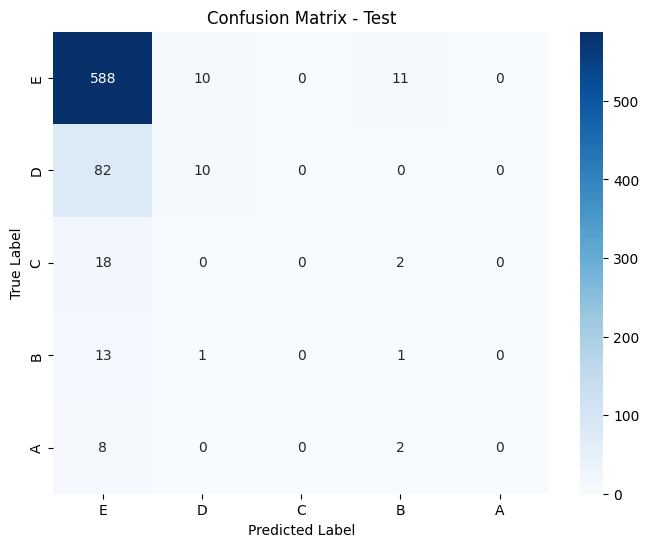

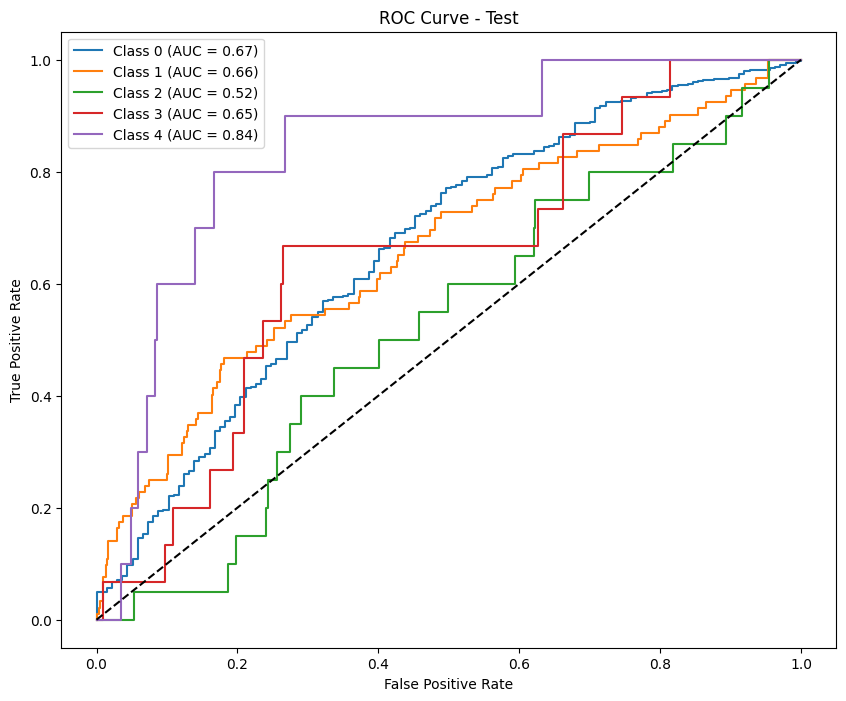


-------------Permutation Importance for phase: phase2---------


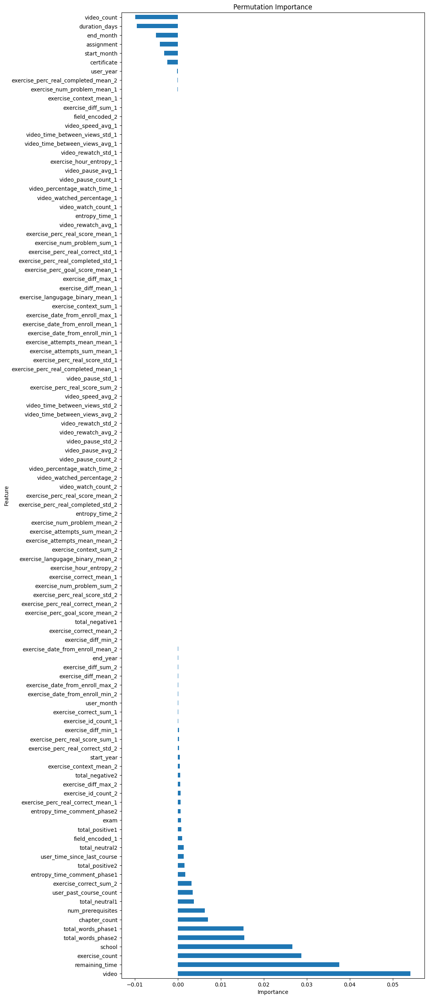

                Feature  Importance
17                video    0.054165
20       remaining_time    0.037597
10       exercise_count    0.028793
0                school    0.026658
103  total_words_phase2    0.015428
..                  ...         ...
4           start_month   -0.003203
16           assignment   -0.004182
6             end_month   -0.005104
19        duration_days   -0.009564
9           video_count   -0.009944

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


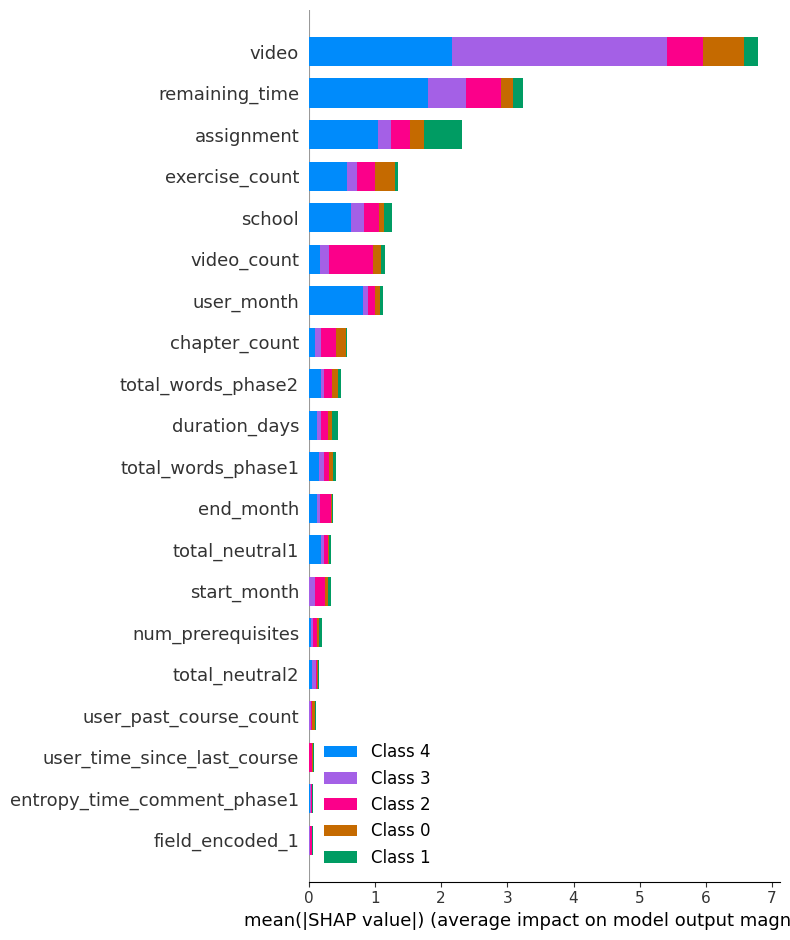


-----Lasso Feature Selection for phase: phase2----------


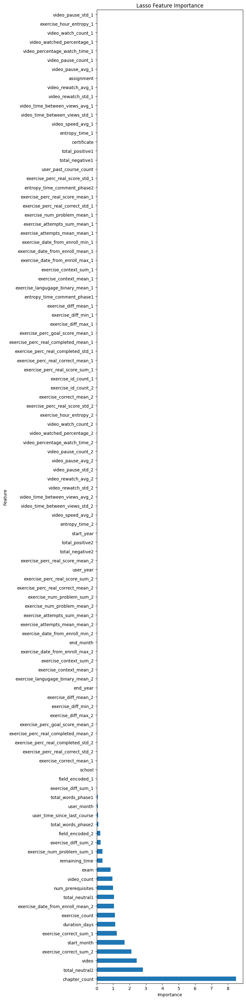

                           Feature  Importance
11                   chapter_count    8.482410
106                 total_neutral2    2.812168
17                           video    2.432504
66          exercise_correct_sum_2    2.110226
4                      start_month    1.698064
..                             ...         ...
50   video_percentage_watch_time_1    0.000000
49      video_watched_percentage_1    0.000000
48             video_watch_count_1    0.000000
47         exercise_hour_entropy_1    0.000000
53               video_pause_std_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                               Feature  Importance
15                         certificate    0.148284
17                               video    0.043573
16                          assignment    0.031051
66              exercise_correct_sum_2    0.030122
73    exercise_date_from_enroll_mean_2    0.024162
..               

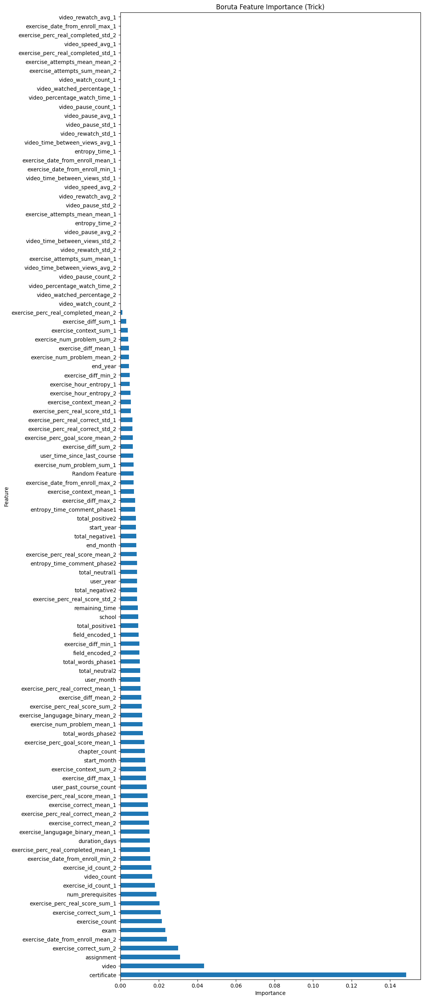

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Label: 0 --> Weight: 0.3046
Label: 1 --> Weight: 0.6905
Label: 2 --> Weight: 8.0860
Label: 3 --> Weight: 7.5391
Label: 4 --> Weight: 82.1368
Results saved as test_results_log_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.79982973 0.62068966 0.35227273 0.41388175 0.44705882]
Precision (per class): [0.87947578 0.62828649 0.22561863 0.28196147 0.28787879]
Recall (per class): [0.7334114  0.61327434 0.80310881 0.77777778 1.        ]
Accuracy: 0.7022
AUC (One-vs-Rest): 0.9196

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.73      0.80      5124
           D       0.63      0.61      0.62      2260
           C       0.23      0.80      0.35       193
           B       0.2

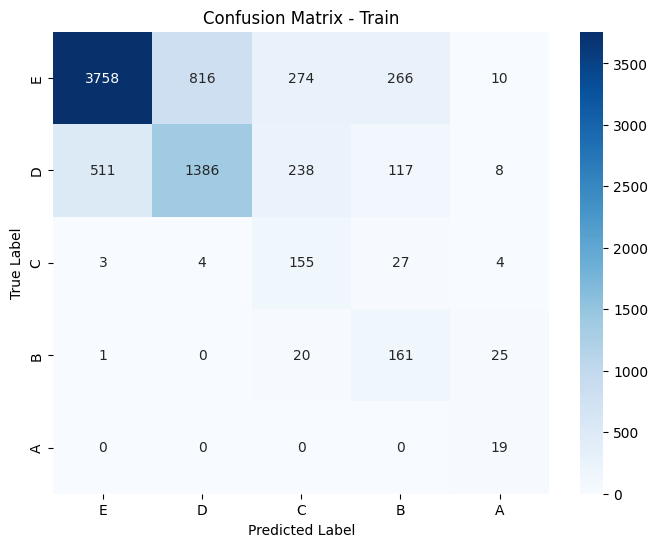

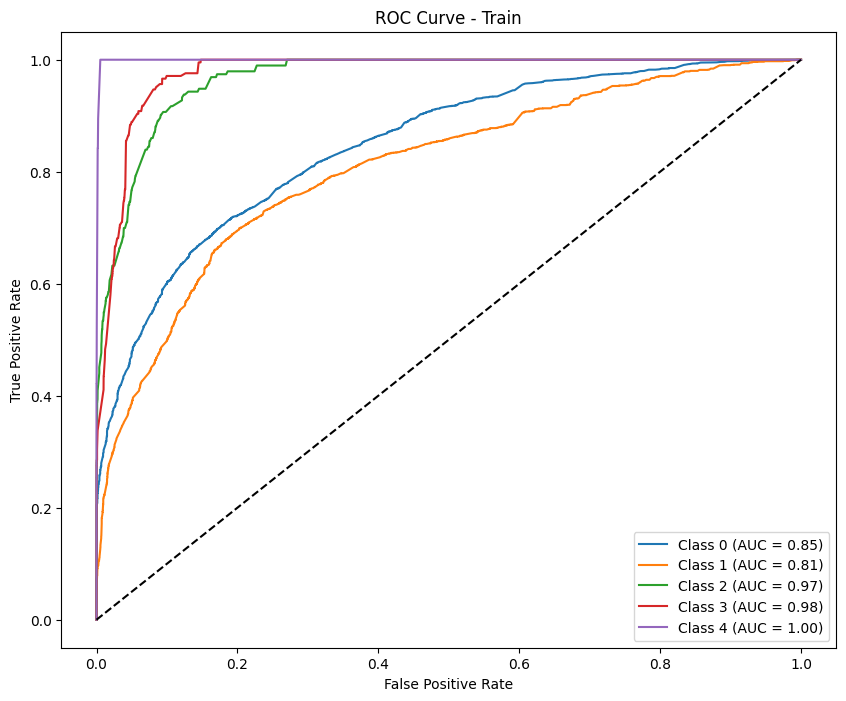

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.78144514 0.15957447 0.         0.04255319 0.        ]
Precision (per class): [0.8217636  0.14851485 0.         0.02564103 0.        ]
Recall (per class): [0.74489796 0.17241379 0.         0.125      0.        ]
Accuracy: 0.6311
AUC (One-vs-Rest): 0.6195

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.74      0.78       588
           D       0.15      0.17      0.16        87
           C       0.00      0.00      0.00        20
           B       0.03      0.12      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.63       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.63      0.66       721



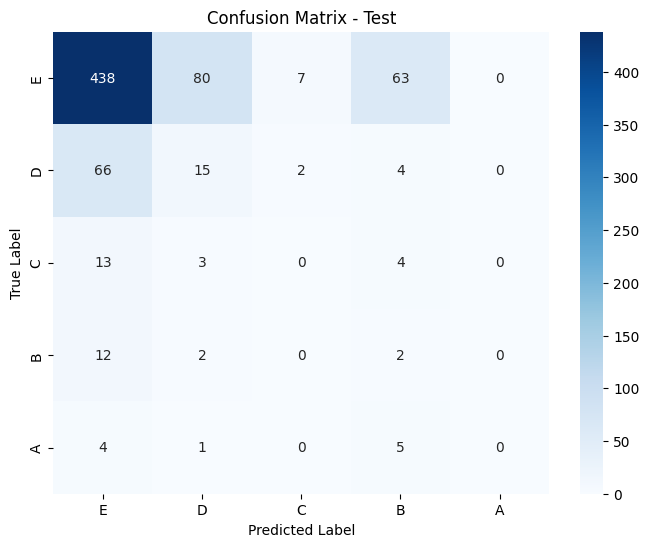

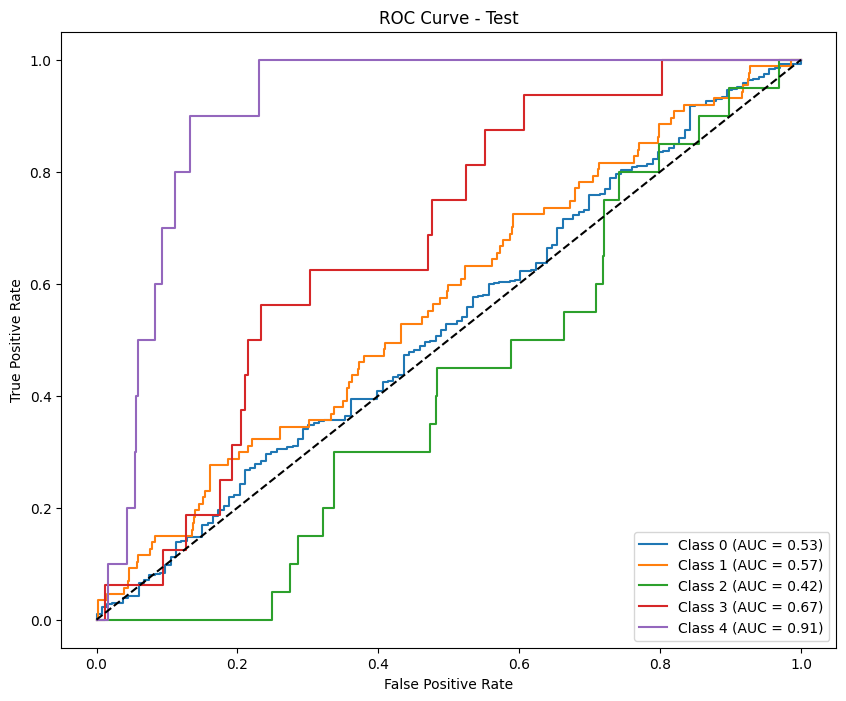

Results saved as test_results_calibrate_log_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.83941269 0.59465128 0.54320988 0.51881188 0.64150943]
Precision (per class): [0.79666959 0.72972973 0.51886792 0.43959732 0.5       ]
Recall (per class): [0.88700234 0.50176991 0.56994819 0.63285024 0.89473684]
Accuracy: 0.7609
AUC (One-vs-Rest): 0.9287

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.73      0.50      0.59      2260
           C       0.52      0.57      0.54       193
           B       0.44      0.63      0.52       207
           A       0.50      0.89      0.64        19

    accuracy                           0.76      7803
   macro avg       0.60      0.70      0.63      7803
weighted avg       0.76      0.76      0.75      7803



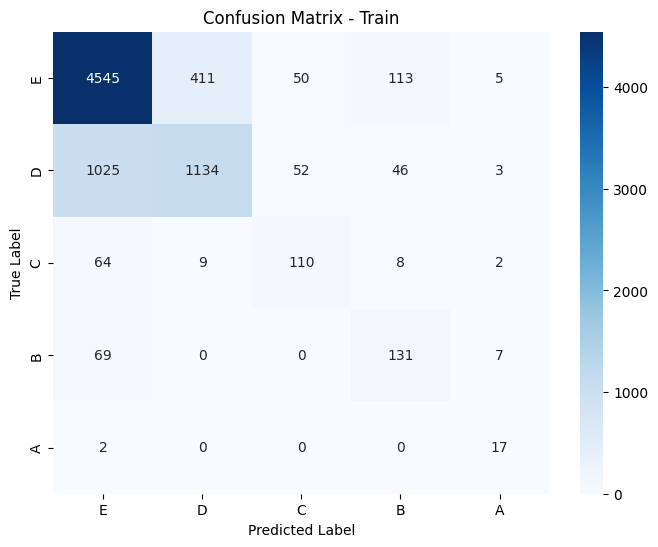

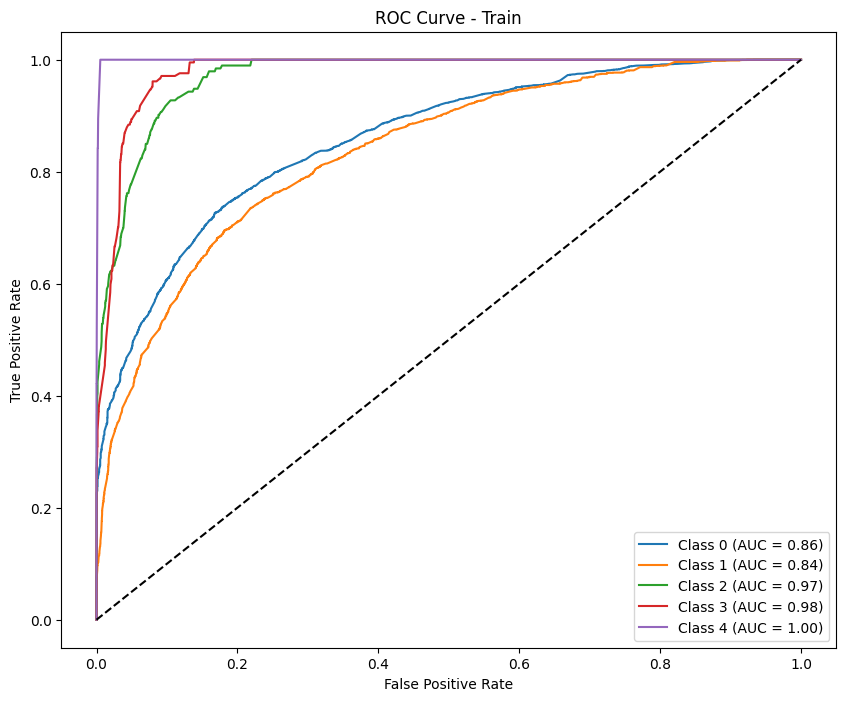

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.86977492 0.09677419 0.         0.04545455 0.        ]
Precision (per class): [0.82469512 0.16216216 0.         0.03571429 0.        ]
Recall (per class): [0.92006803 0.06896552 0.         0.0625     0.        ]
Accuracy: 0.7601
AUC (One-vs-Rest): 0.6057

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.92      0.87       588
           D       0.16      0.07      0.10        87
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.76       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.76      0.72       721



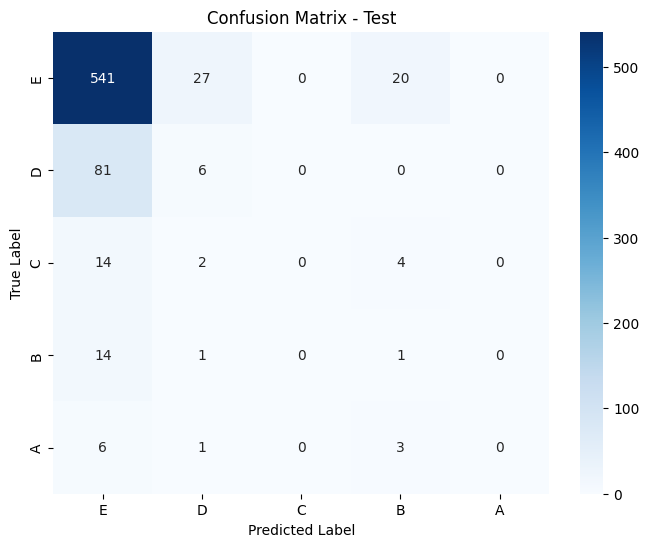

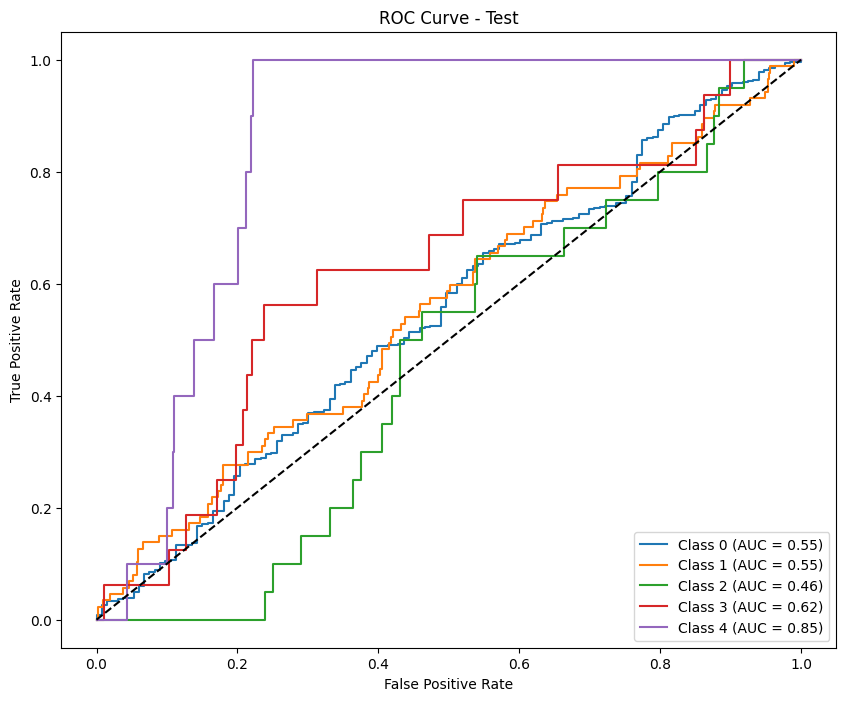

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Label: 0 --> Weight: 0.3058
Label: 1 --> Weight: 0.6780
Label: 2 --> Weight: 10.6198
Label: 3 --> Weight: 6.7459
Label: 4 --> Weight: 76.6143
Results saved as test_results_log_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.81706944 0.662868   0.37826087 0.52471483 0.65116279]
Precision (per class): [0.88122732 0.66391883 0.24233983 0.3760218  0.48275862]
Recall (per class): [0.76161962 0.66182048 0.86138614 0.86792453 1.        ]
Accuracy: 0.7378
AUC (One-vs-Rest): 0.9327

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.76      0.82      3507
           D       0.66      0.66      0.66      1582
           C       0.24      0.86      0.38       101
           B       0.

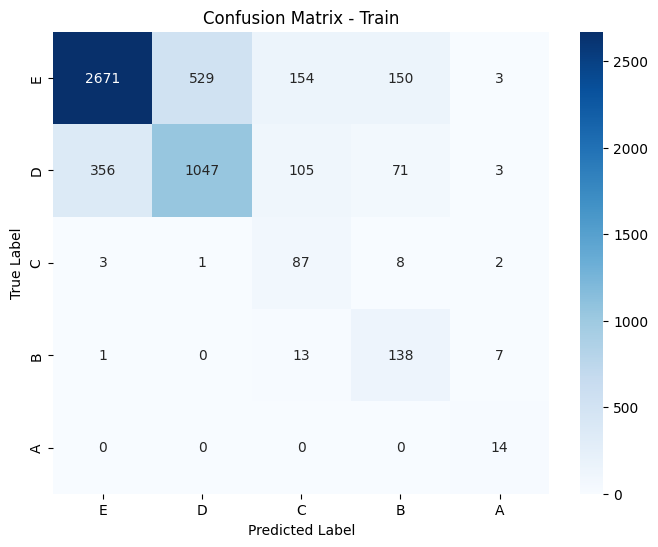

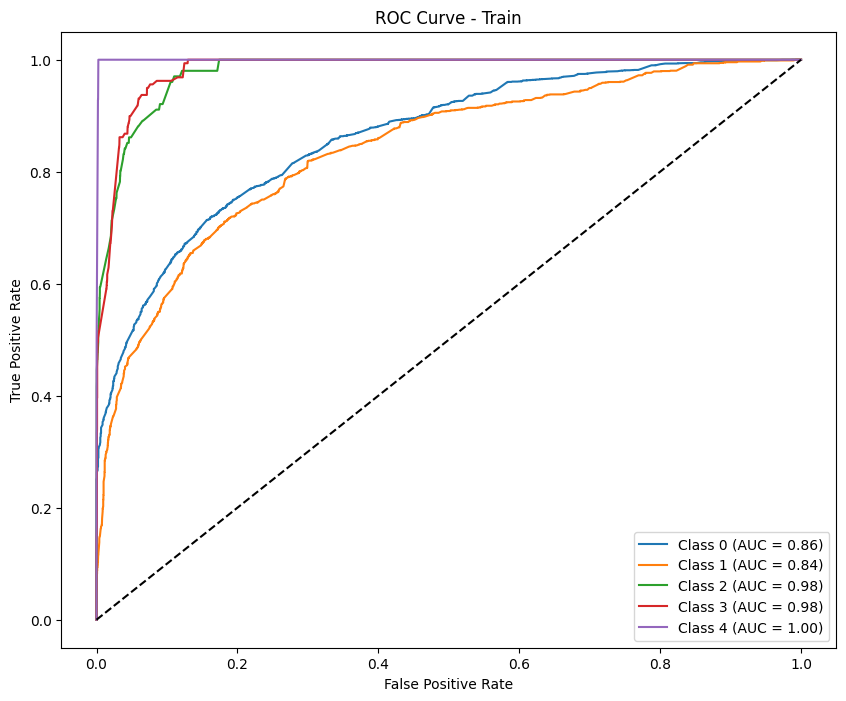

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.7612782  0.11299435 0.         0.04123711 0.        ]
Precision (per class): [0.7956778  0.10869565 0.         0.02531646 0.        ]
Recall (per class): [0.72972973 0.11764706 0.         0.11111111 0.        ]
Accuracy: 0.6070
AUC (One-vs-Rest): 0.5388

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.73      0.76       555
           D       0.11      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.03      0.11      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.61       687
   macro avg       0.19      0.19      0.18       687
weighted avg       0.66      0.61      0.63       687



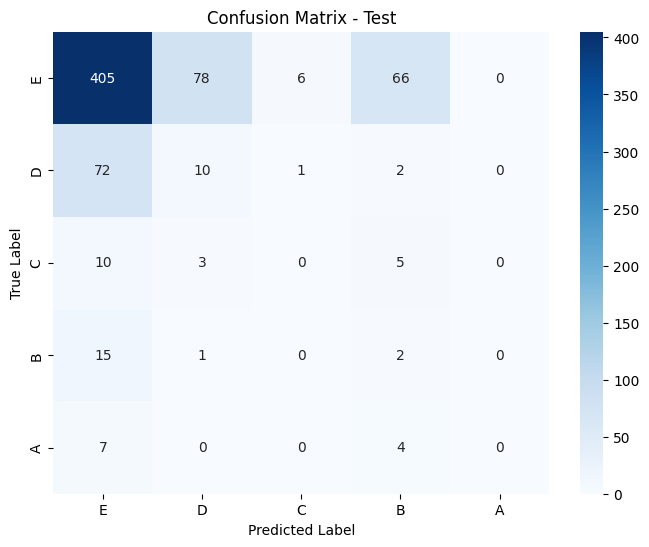

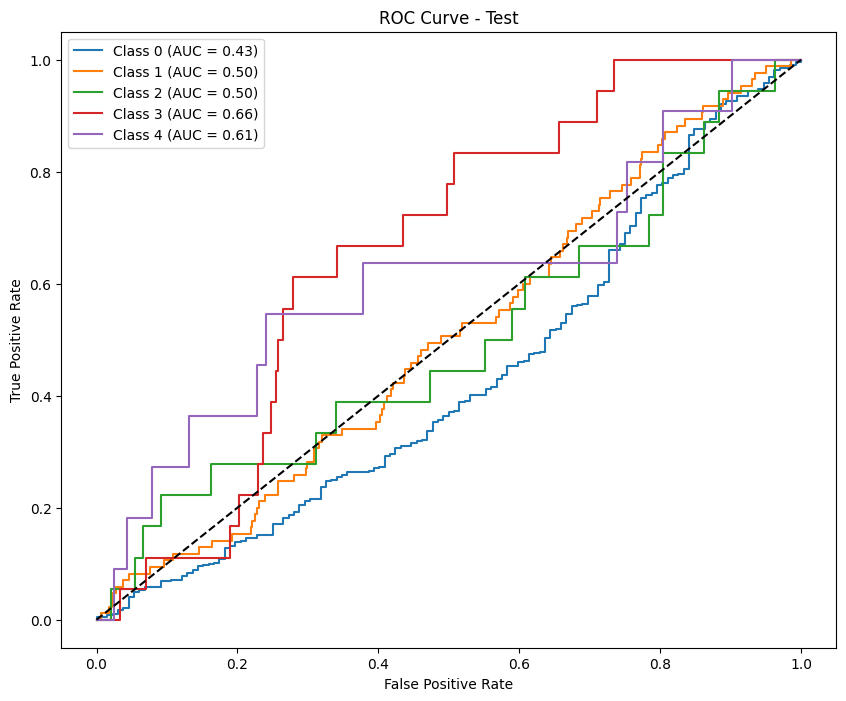

Results saved as test_results_calibrate_log_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.85573501 0.63828212 0.60185185 0.59002169 0.66666667]
Precision (per class): [0.82284812 0.77033065 0.56521739 0.45033113 0.5       ]
Recall (per class): [0.89136014 0.5448799  0.64356436 0.85534591 1.        ]
Accuracy: 0.7837
AUC (One-vs-Rest): 0.9402

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.89      0.86      3507
           D       0.77      0.54      0.64      1582
           C       0.57      0.64      0.60       101
           B       0.45      0.86      0.59       159
           A       0.50      1.00      0.67        14

    accuracy                           0.78      5363
   macro avg       0.62      0.79      0.67      5363
weighted avg       0.79      0.78      0.78      5363



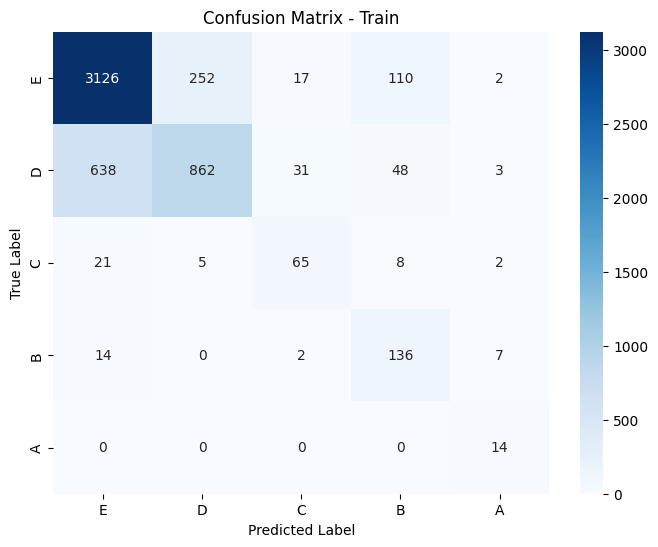

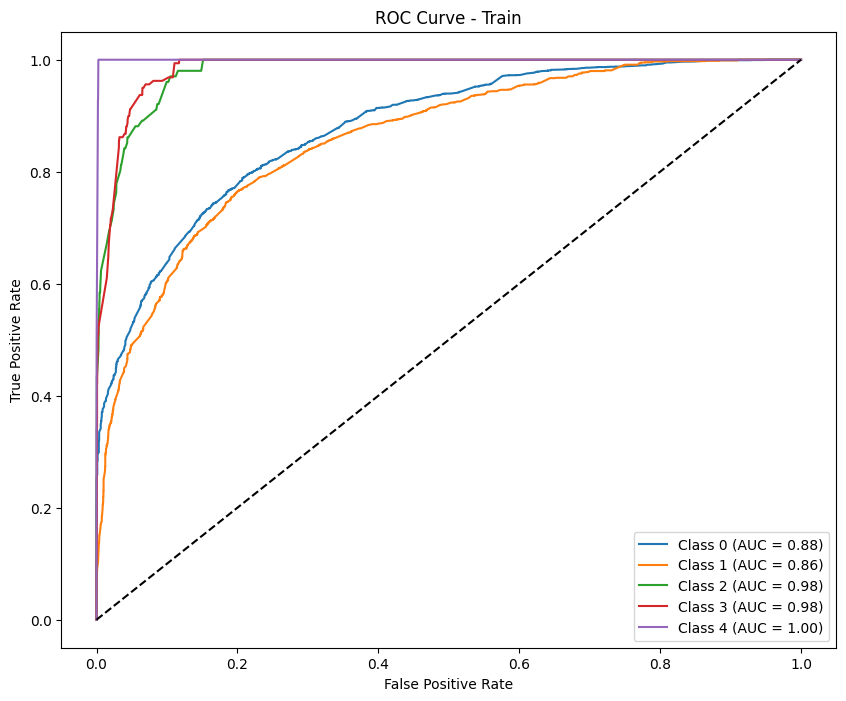

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.85787234 0.10084034 0.         0.04       0.        ]
Precision (per class): [0.81290323 0.17647059 0.         0.03125    0.        ]
Recall (per class): [0.90810811 0.07058824 0.         0.05555556 0.        ]
Accuracy: 0.7438
AUC (One-vs-Rest): 0.5755

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.91      0.86       555
           D       0.18      0.07      0.10        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.74       687
   macro avg       0.20      0.21      0.20       687
weighted avg       0.68      0.74      0.71       687



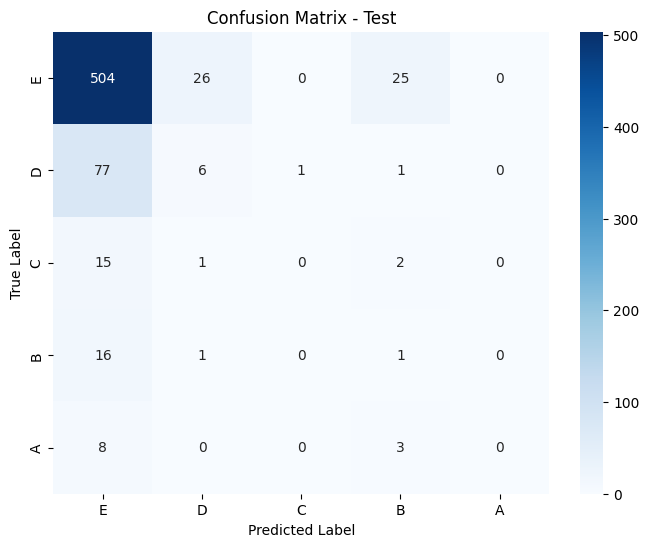

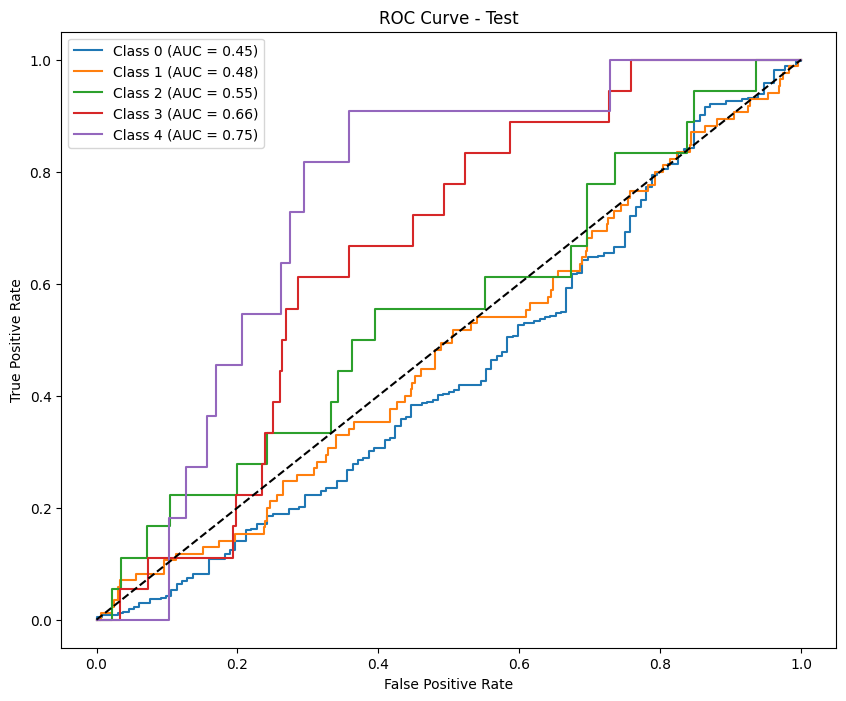

In [29]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, scale='log', metric='f1_macro')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

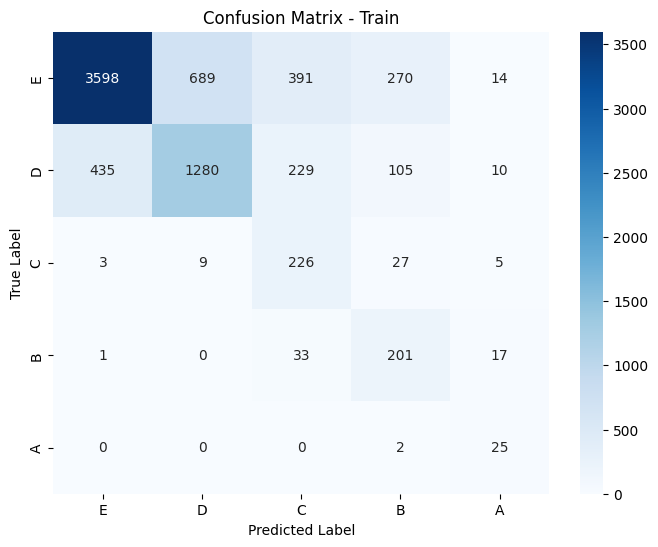

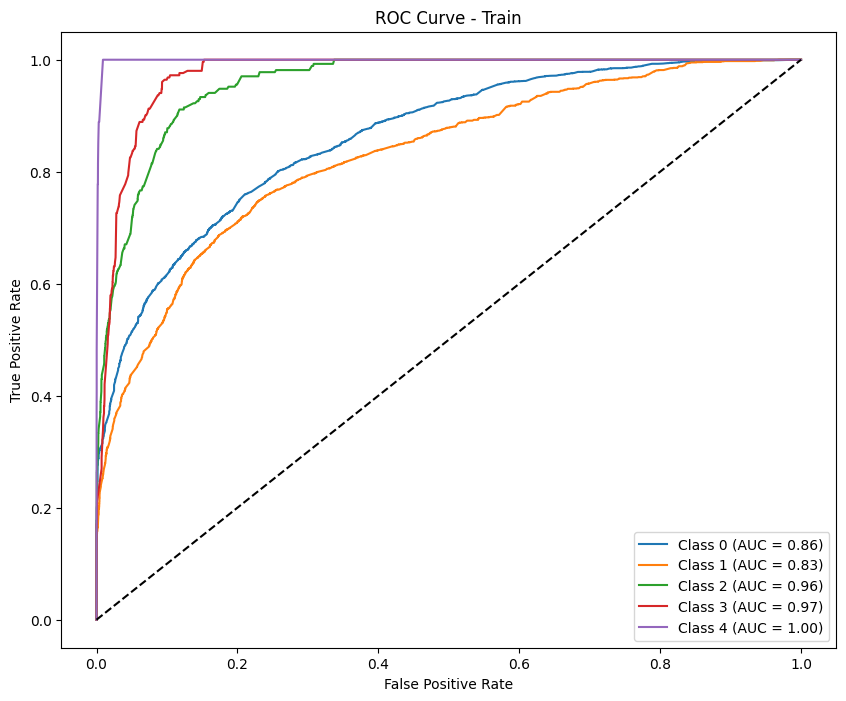

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90808241 0.46783626 0.         0.04651163 0.        ]
Precision (per class): [0.8869969  0.51948052 0.         0.03703704 0.        ]
Recall (per class): [0.93019481 0.42553191 0.         0.0625     0.        ]
Accuracy: 0.8122
AUC (One-vs-Rest): 0.7878

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.93      0.91       616
           D       0.52      0.43      0.47        94
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       756
   macro avg       0.29      0.28      0.28       756
weighted avg       0.79      0.81      0.80       756



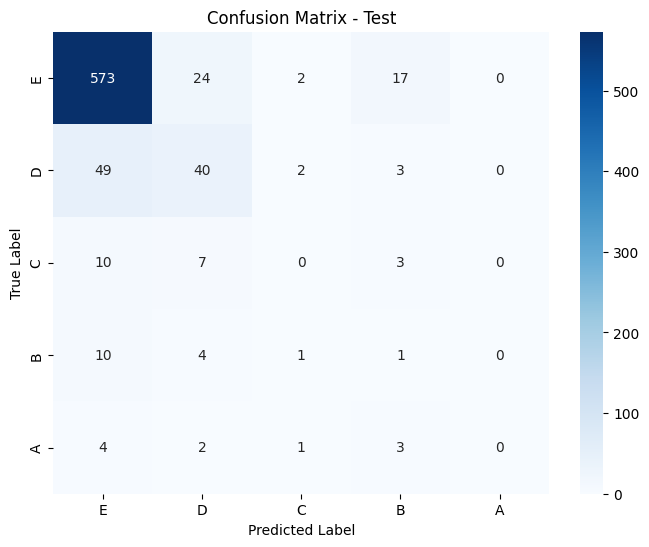

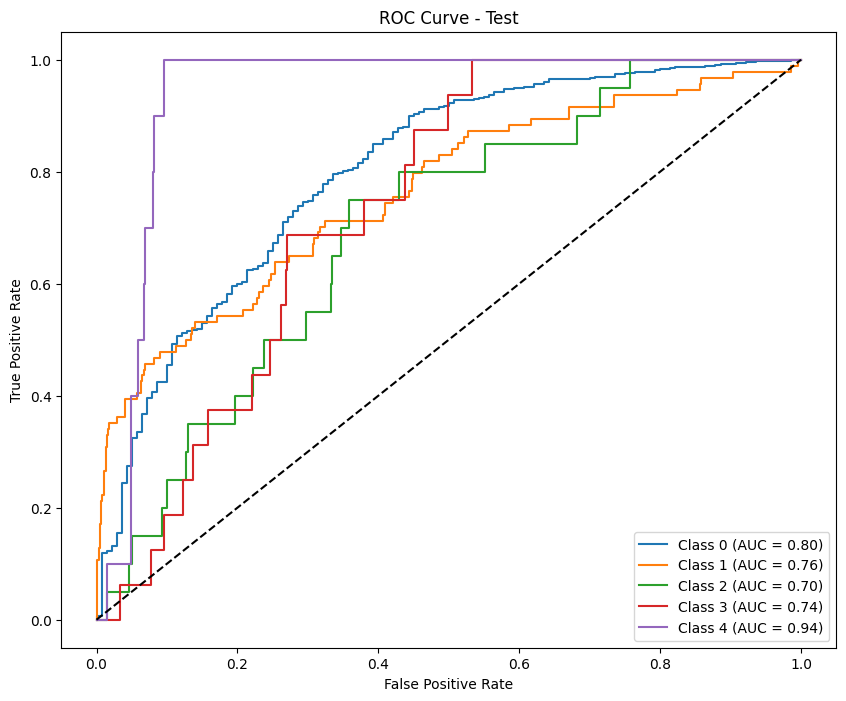

Results saved as test_results_calibrate_undersample_log_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.84742229 0.60486946 0.54113346 0.54706927 0.66666667]
Precision (per class): [0.79982111 0.7637037  0.53429603 0.49517685 0.54761905]
Recall (per class): [0.90104796 0.50072851 0.54814815 0.61111111 0.85185185]
Accuracy: 0.7697
AUC (One-vs-Rest): 0.9330

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.90      0.85      4962
           D       0.76      0.50      0.60      2059
           C       0.53      0.55      0.54       270
           B       0.50      0.61      0.55       252
           A       0.55      0.85      0.67        27

    accuracy                           0.77      7570
   macro avg       0.63      0.68      0.64      7570
weighted avg       0.77      0.77      0.76      7570



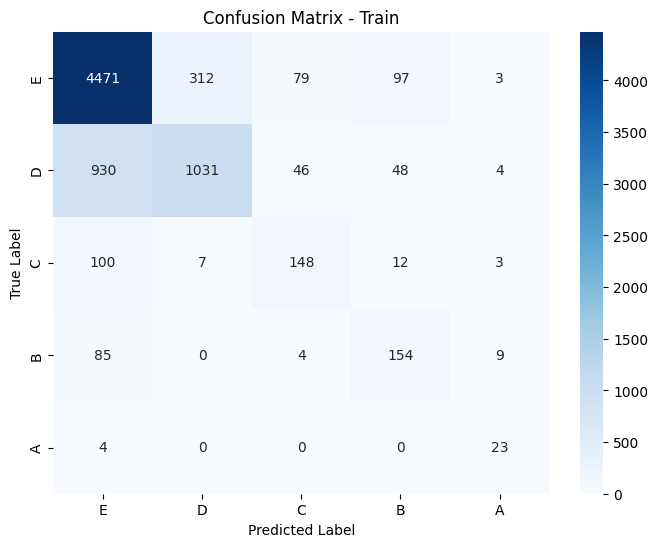

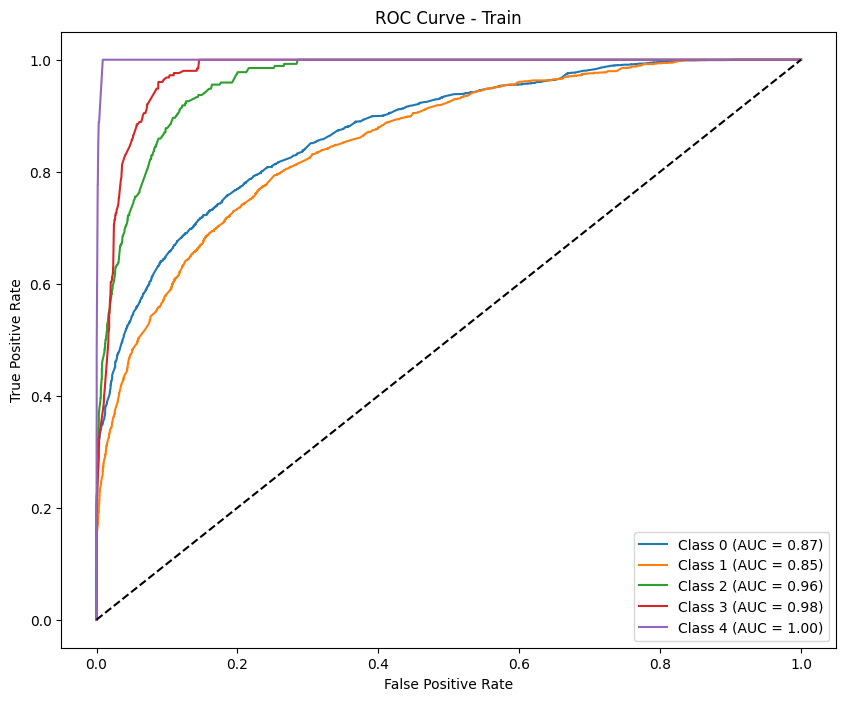

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91337386 0.41726619 0.         0.         0.        ]
Precision (per class): [0.85857143 0.64444444 0.         0.         0.        ]
Recall (per class): [0.97564935 0.30851064 0.         0.         0.        ]
Accuracy: 0.8333
AUC (One-vs-Rest): 0.7679

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.98      0.91       616
           D       0.64      0.31      0.42        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.30      0.26      0.27       756
weighted avg       0.78      0.83      0.80       756



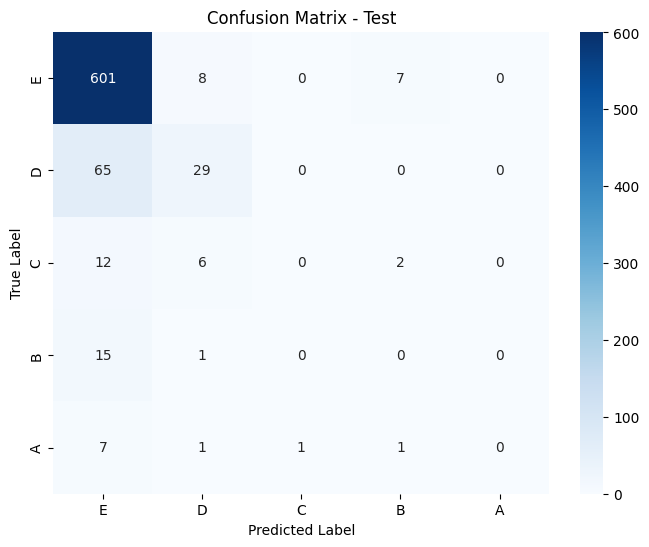

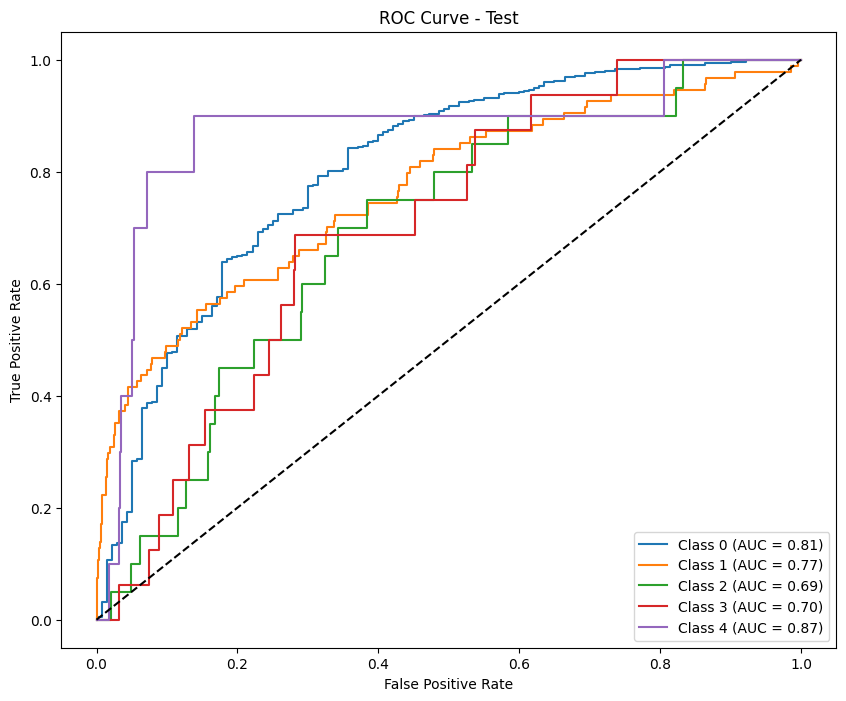


Permutation Importance for phase: phase1


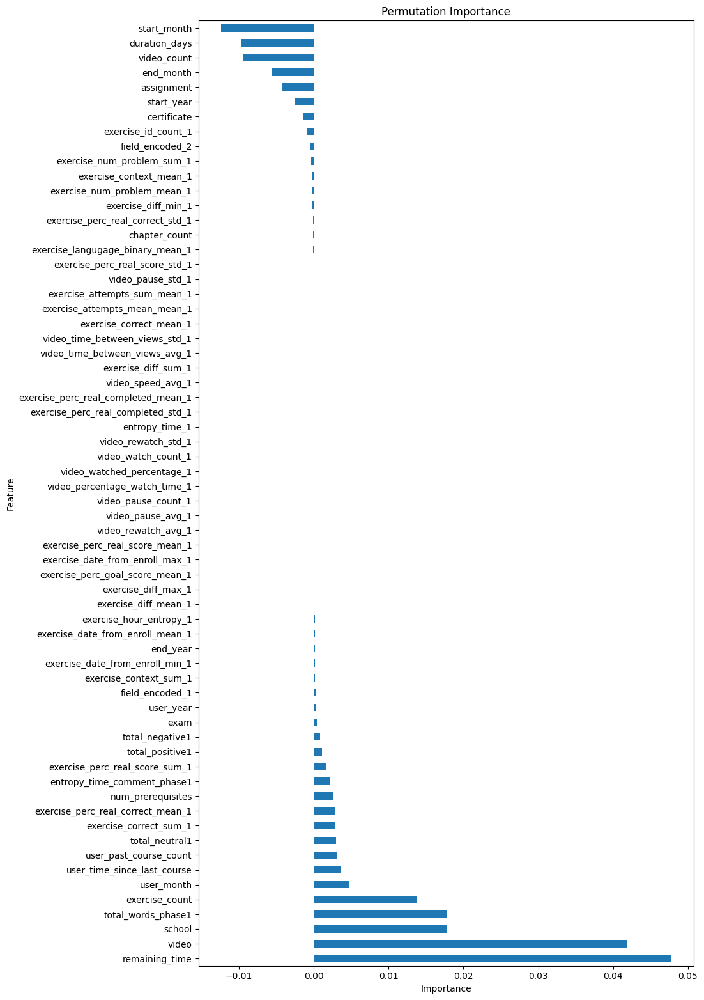

               Feature  Importance
20      remaining_time    0.047738
17               video    0.041925
0               school    0.017784
60  total_words_phase1    0.017701
10      exercise_count    0.013838
..                 ...         ...
16          assignment   -0.004260
6            end_month   -0.005680
9          video_count   -0.009478
19       duration_days   -0.009676
4          start_month   -0.012417

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.177e+00, tolerance: 4.255e-01


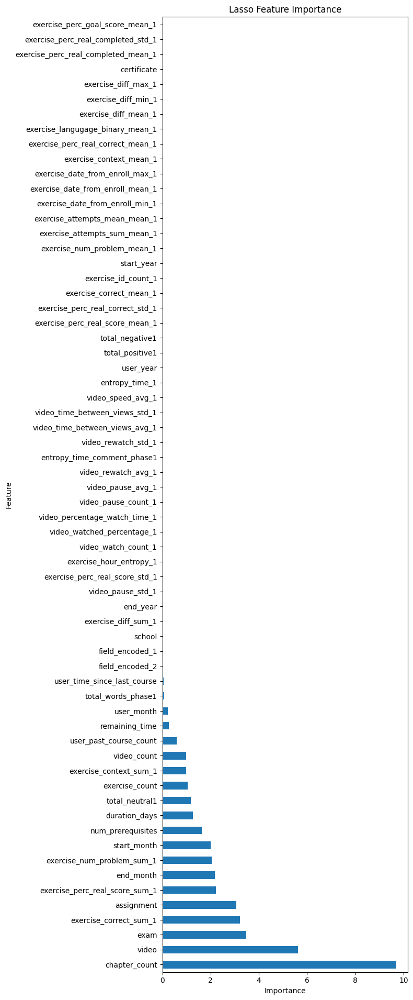

                                Feature  Importance
11                        chapter_count    9.691239
17                                video    5.618284
18                                 exam    3.478487
23               exercise_correct_sum_1    3.219016
16                           assignment    3.068723
..                                  ...         ...
38                  exercise_diff_max_1    0.000000
15                          certificate    0.000000
40  exercise_perc_real_completed_mean_1    0.000000
41   exercise_perc_real_completed_std_1    0.000000
39      exercise_perc_goal_score_mean_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
44     exercise_perc_real_score_sum_1    0.116982
24            exercise_correct_mean_1    0.074260
15                        certificate    0.068329
42  exercise_perc_real_correct_mean_1    0.059386
17                              video    

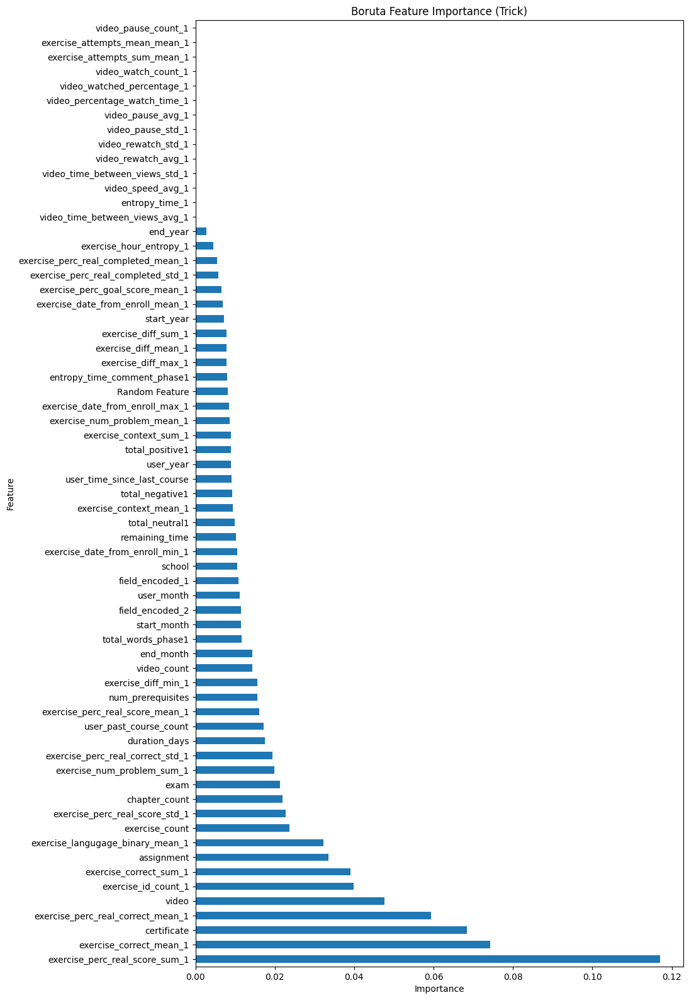

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.79510329 0.61860625 0.43726708 0.53092784 0.68656716]
Precision (per class): [0.89125214 0.61292517 0.30608696 0.37728938 0.54761905]
Recall (per class): [0.71767956 0.62439362 0.76521739 0.89565217 0.92      ]
Accuracy: 0.7037
AUC (One-vs-Rest): 0.9211

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.72      0.80      3620
           D       0.61      0.62      0.62      1443
           C       0.31      0.77      0.44       230
           B       0.38      0.90      0.53       230
           A       0.55      0.92      0.69        25

    accuracy                           0.70      5548
   macro avg

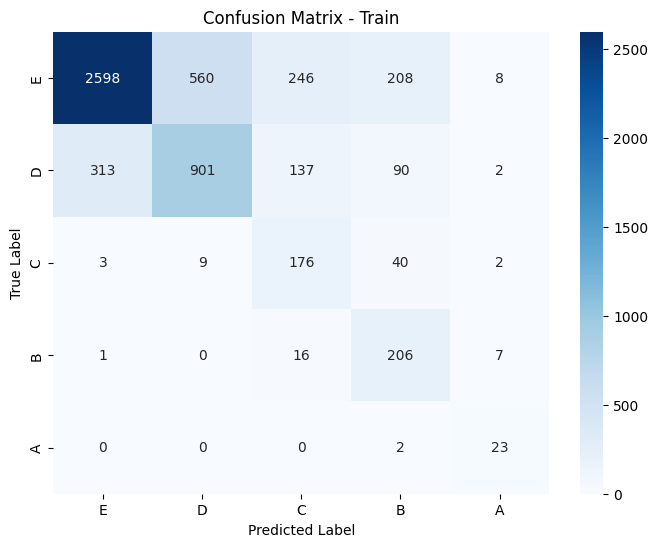

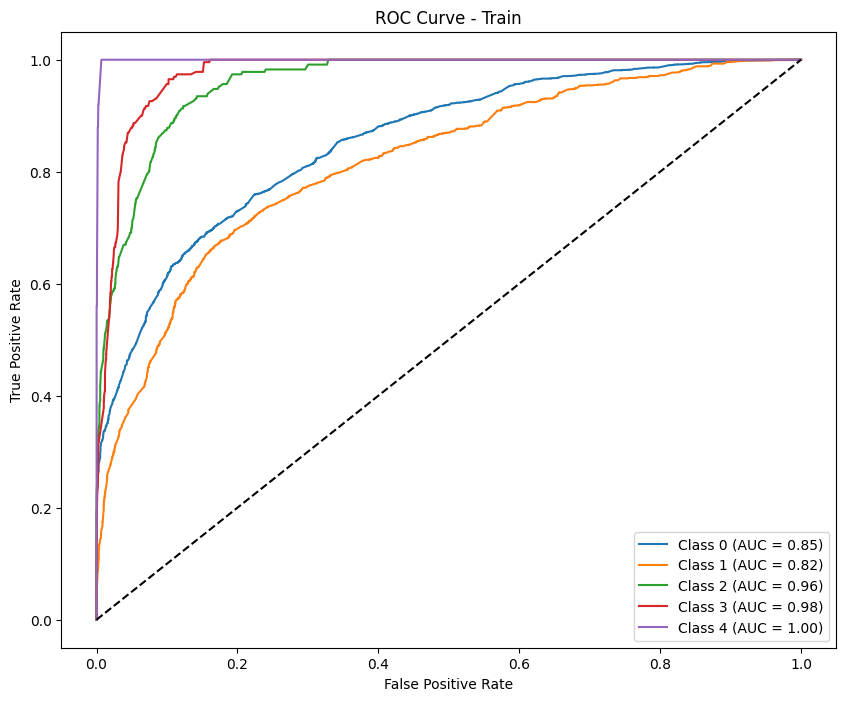


--- Test Metrics ---
F1 Score (per class): [0.83934426 0.20689655 0.         0.06666667 0.        ]
Precision (per class): [0.83797054 0.2195122  0.         0.04444444 0.        ]
Recall (per class): [0.8407225  0.19565217 0.         0.13333333 0.        ]
Accuracy: 0.7131
AUC (One-vs-Rest): 0.6467

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84       609
           D       0.22      0.20      0.21        92
           C       0.00      0.00      0.00        20
           B       0.04      0.13      0.07        15
           A       0.00      0.00      0.00        10

    accuracy                           0.71       746
   macro avg       0.22      0.23      0.22       746
weighted avg       0.71      0.71      0.71       746



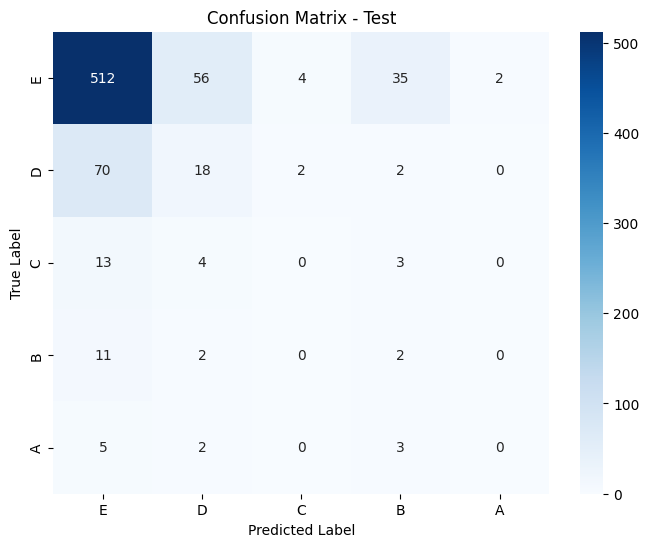

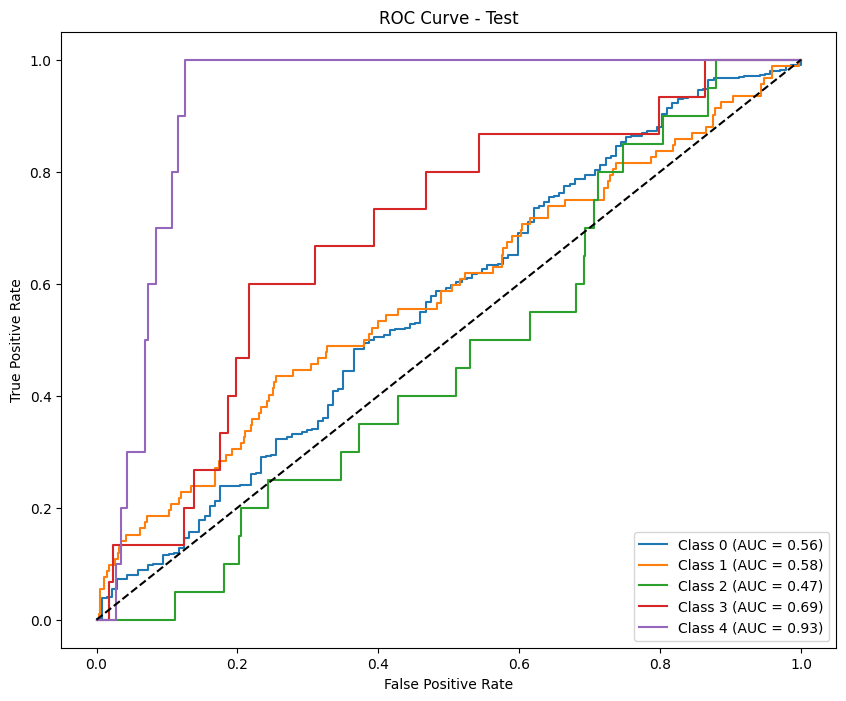

Results saved as test_results_calibrate_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84203723 0.54840123 0.5518591  0.59920635 0.74193548]
Precision (per class): [0.79130224 0.7452381  0.50177936 0.55109489 0.62162162]
Recall (per class): [0.89972376 0.43381843 0.61304348 0.65652174 0.92      ]
Accuracy: 0.7567
AUC (One-vs-Rest): 0.9290

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      3620
           D       0.75      0.43      0.55      1443
           C       0.50      0.61      0.55       230
           B       0.55      0.66      0.60       230
           A       0.62      0.92      0.74        25

    accuracy                           0.76      5548
   macro avg       0.64      0.70      0.66      5548
weighted avg       0.76      0.76      0.74      5548



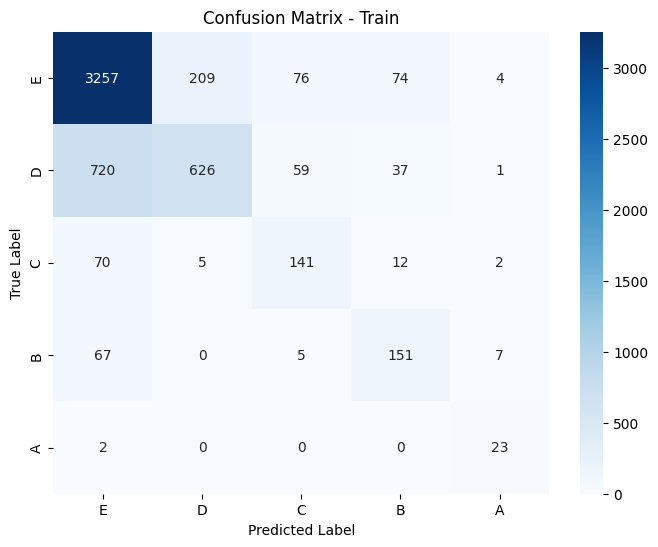

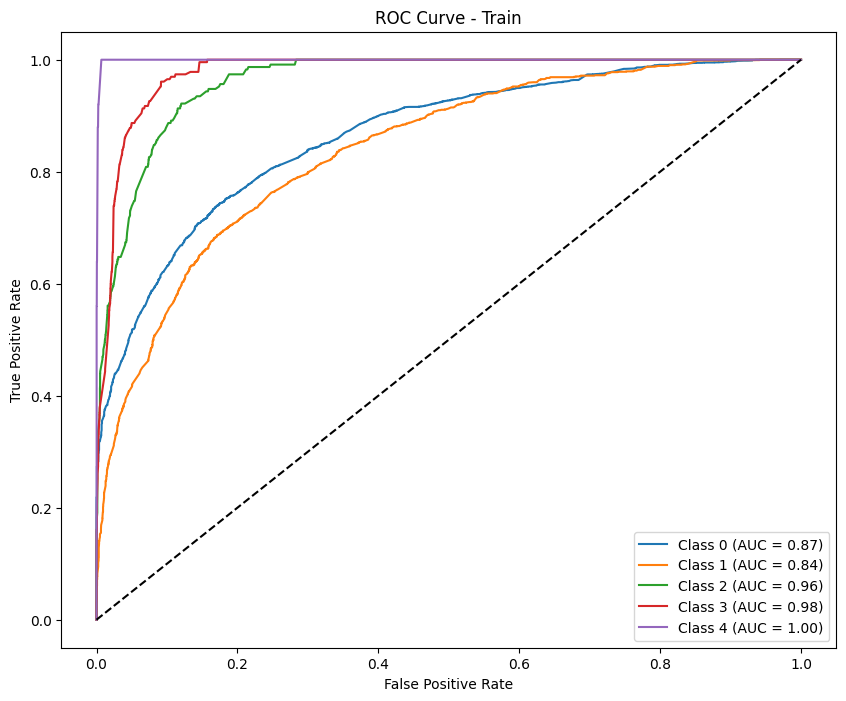

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88803681 0.16       0.         0.06060606 0.        ]
Precision (per class): [0.83309353 0.3030303  0.         0.05555556 0.        ]
Recall (per class): [0.95073892 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.7909
AUC (One-vs-Rest): 0.6330

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.95      0.89       609
           D       0.30      0.11      0.16        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.79       746
   macro avg       0.24      0.23      0.22       746
weighted avg       0.72      0.79      0.75       746



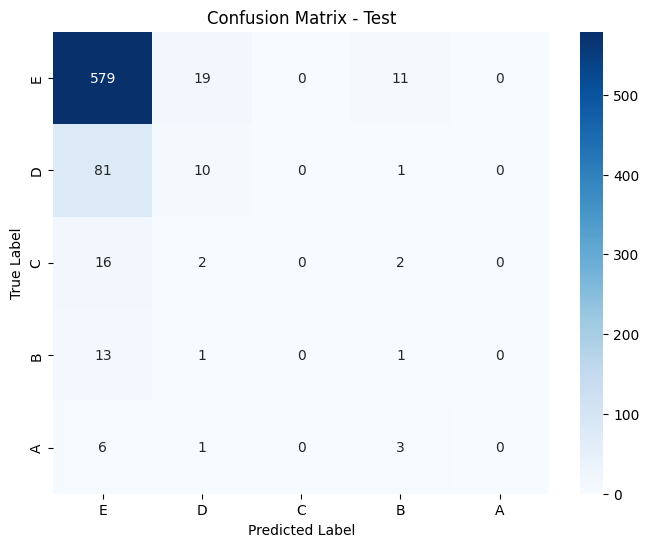

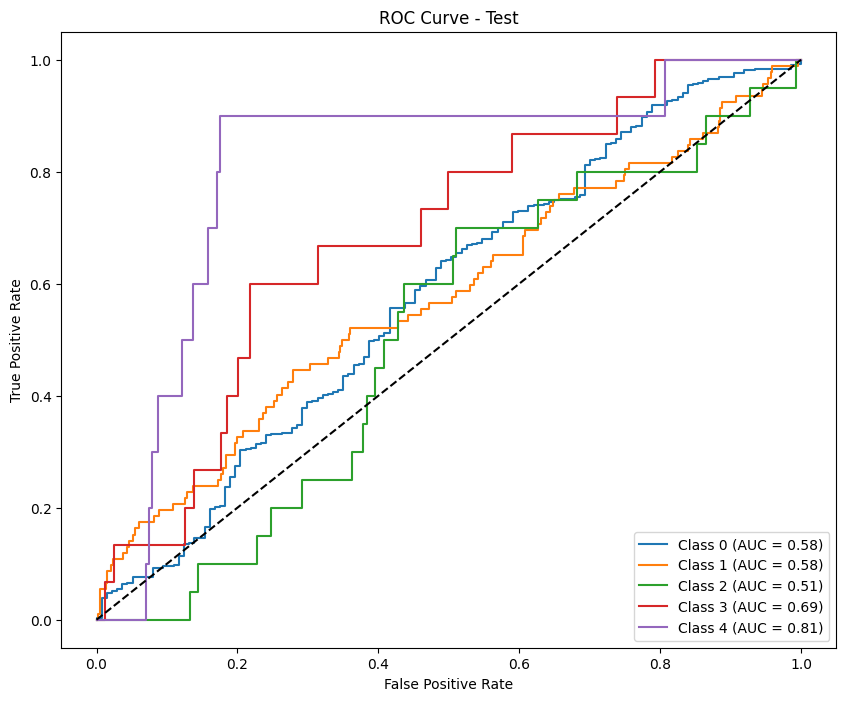


Permutation Importance for phase: phase2


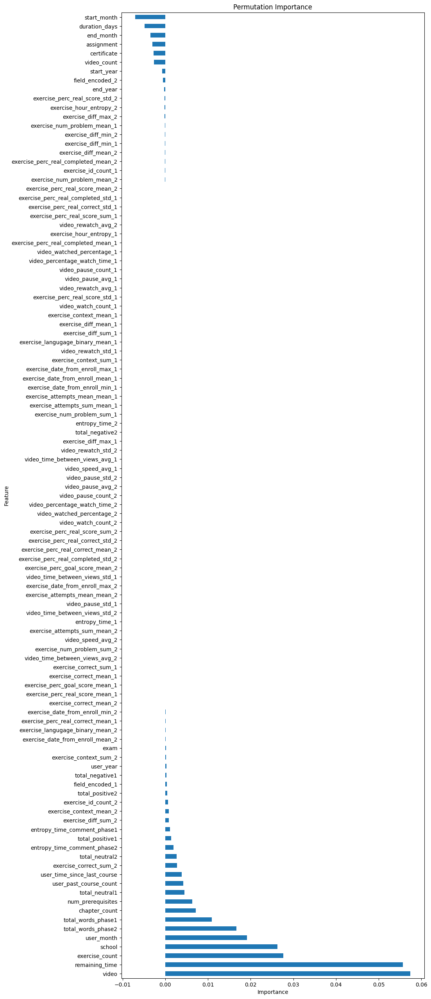

           Feature  Importance
17           video    0.057431
20  remaining_time    0.055651
10  exercise_count    0.027645
0           school    0.026316
8       user_month    0.019106
..             ...         ...
15     certificate   -0.002726
16      assignment   -0.002997
6        end_month   -0.003447
19   duration_days   -0.004822
4      start_month   -0.007052

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.601e+00, tolerance: 3.526e-01


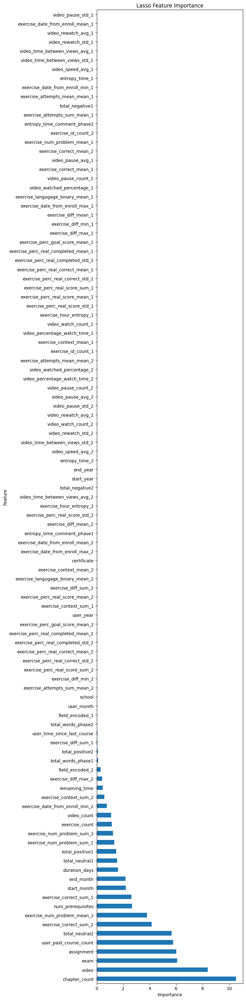

                             Feature  Importance
11                     chapter_count   10.507989
17                             video    8.368181
18                              exam    6.068094
16                        assignment    5.993612
12            user_past_course_count    5.779950
..                               ...         ...
56    video_time_between_views_avg_1    0.000000
55               video_rewatch_std_1    0.000000
54               video_rewatch_avg_1    0.000000
30  exercise_date_from_enroll_mean_1    0.000000
53                 video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                               Feature  Importance
15                         certificate    0.147562
17                               video    0.046438
16                          assignment    0.031623
66              exercise_correct_sum_2    0.027584
84  exercise_perc_real_completed_std_2    0.019738
..                  

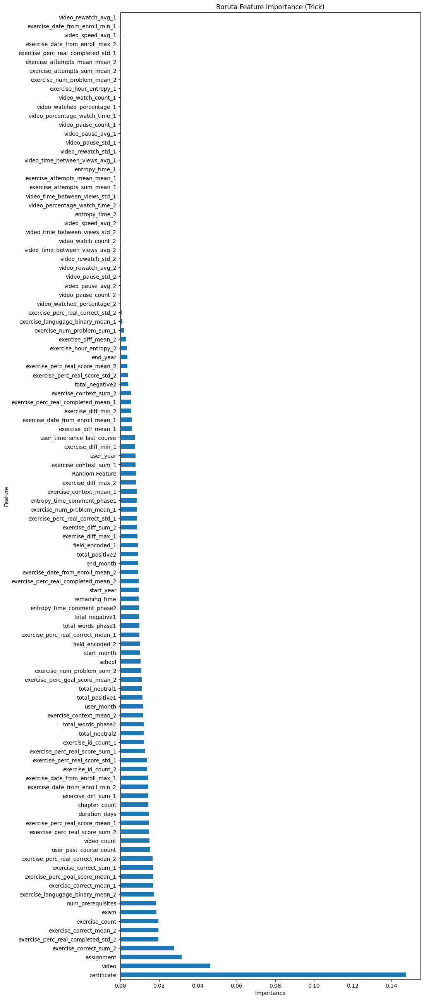

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.80533333 0.6459439  0.47588424 0.51242236 0.49350649]
Precision (per class): [0.90563774 0.61828737 0.34498834 0.37757437 0.32758621]
Recall (per class): [0.72503201 0.67619048 0.76683938 0.79710145 1.        ]
Accuracy: 0.7181
AUC (One-vs-Rest): 0.9296

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.73      0.81      3124
           D       0.62      0.68      0.65      1260
           C       0.34      0.77      0.48       193
           B       0.38      0.80      0.51       207
           A       0.33      1.00      0.49        19

    accuracy                           0.72      4803
   macro avg

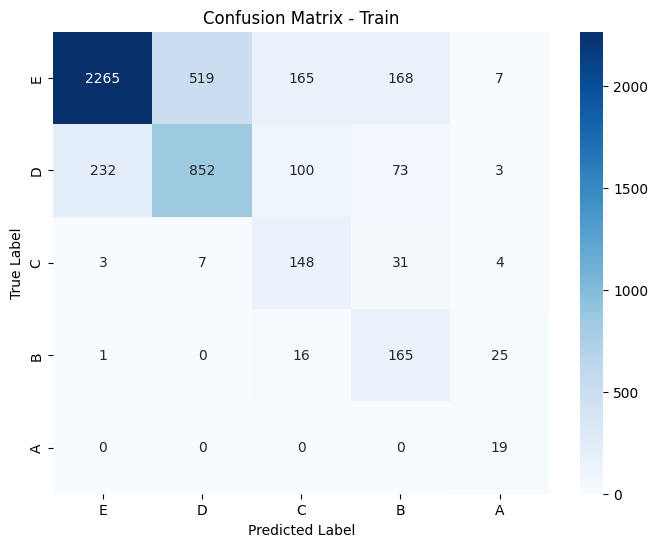

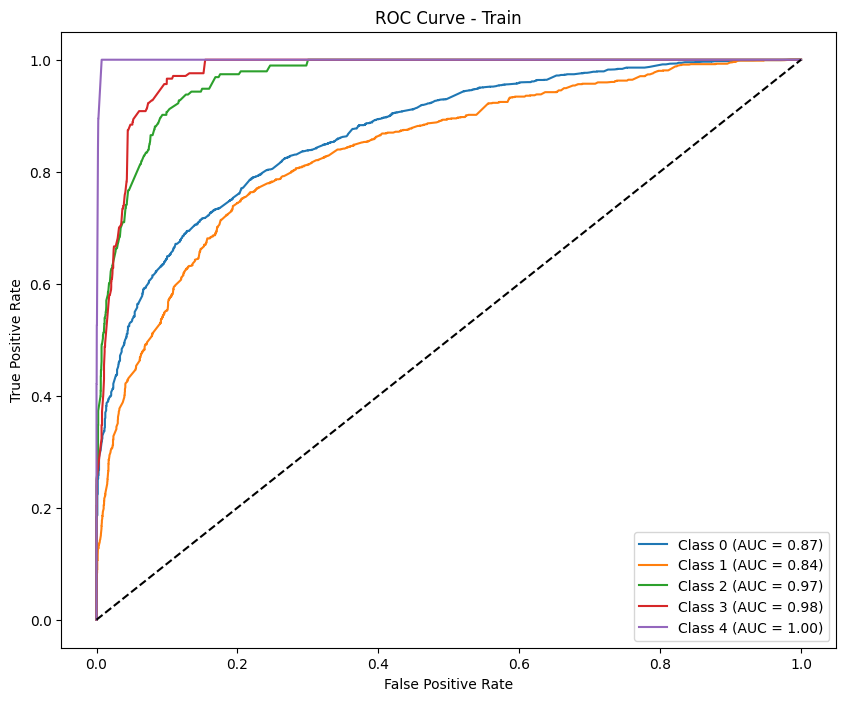


--- Test Metrics ---
F1 Score (per class): [0.73998136 0.20175439 0.         0.0625     0.        ]
Precision (per class): [0.8185567  0.16312057 0.         0.0375     0.        ]
Recall (per class): [0.67517007 0.26436782 0.         0.1875     0.        ]
Accuracy: 0.5867
AUC (One-vs-Rest): 0.6124

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.68      0.74       588
           D       0.16      0.26      0.20        87
           C       0.00      0.00      0.00        20
           B       0.04      0.19      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.59       721
   macro avg       0.20      0.23      0.20       721
weighted avg       0.69      0.59      0.63       721



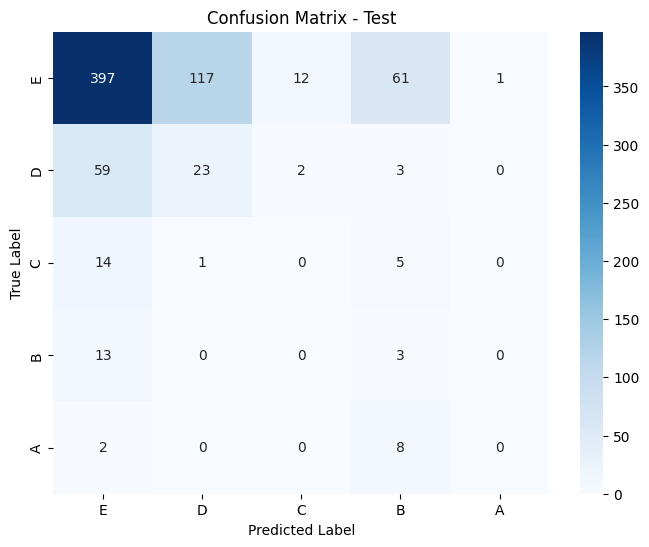

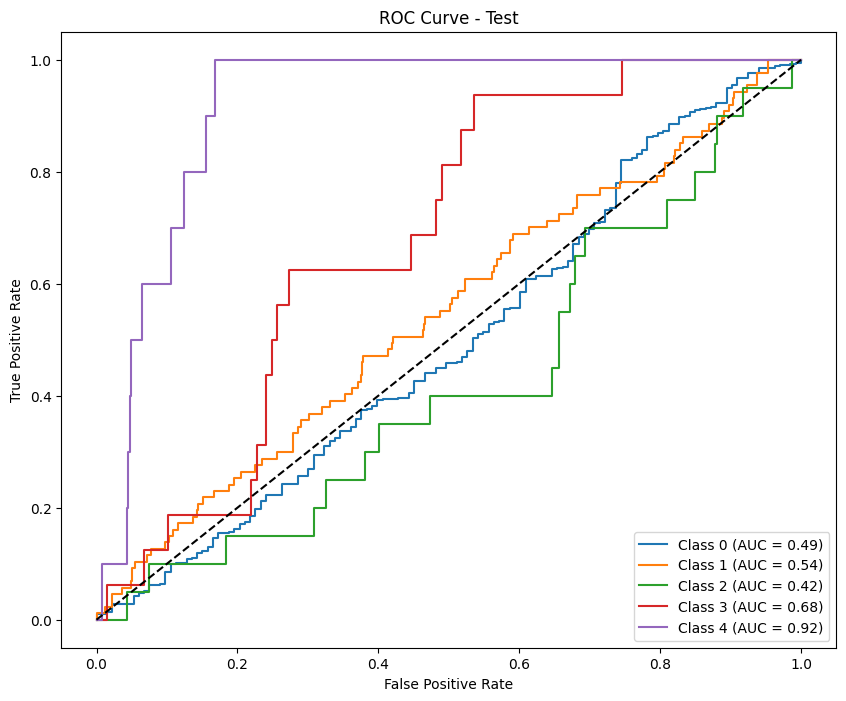

Results saved as test_results_calibrate_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8525283  0.60769231 0.5955335  0.60444444 0.70833333]
Precision (per class): [0.80662668 0.77073171 0.57142857 0.55967078 0.5862069 ]
Recall (per class): [0.90396927 0.5015873  0.62176166 0.65700483 0.89473684]
Accuracy: 0.7764
AUC (One-vs-Rest): 0.9370

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.90      0.85      3124
           D       0.77      0.50      0.61      1260
           C       0.57      0.62      0.60       193
           B       0.56      0.66      0.60       207
           A       0.59      0.89      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.72      0.67      4803
weighted avg       0.78      0.78      0.77      4803



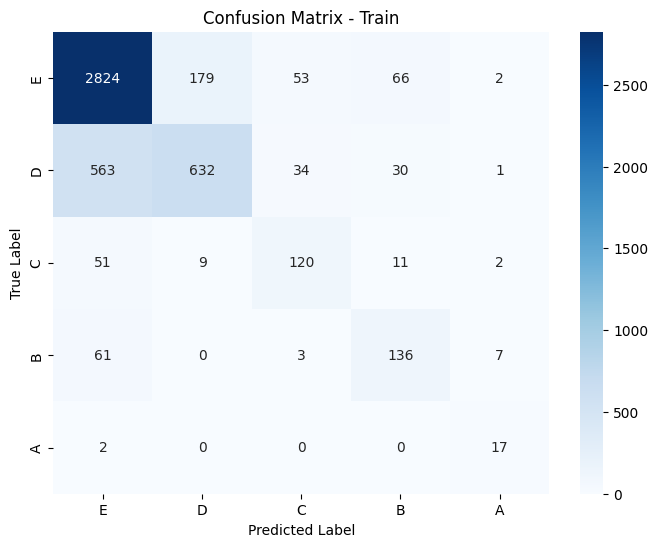

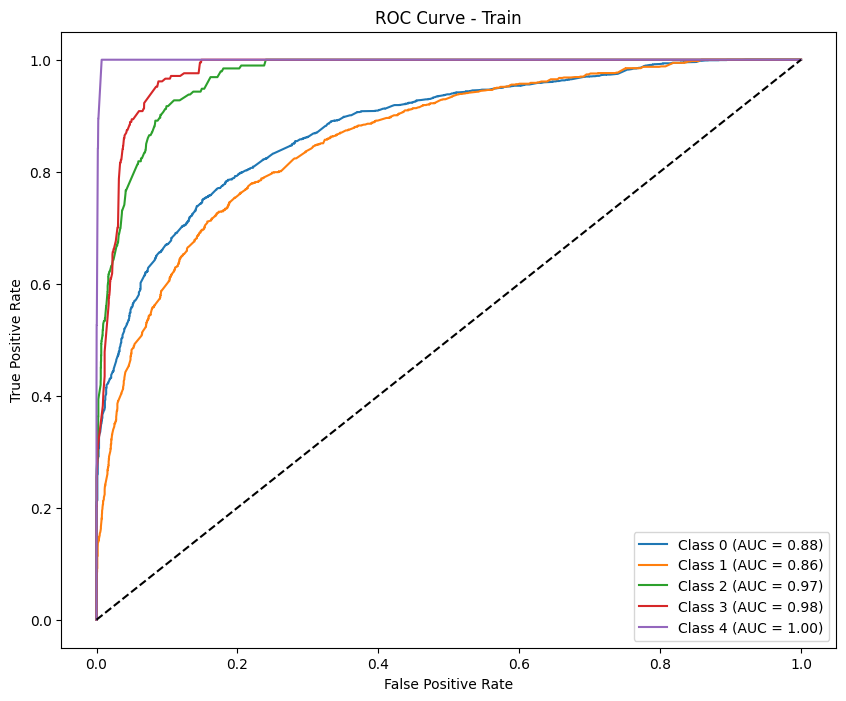

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8452579  0.1509434  0.         0.04081633 0.        ]
Precision (per class): [0.82736156 0.16666667 0.         0.03030303 0.        ]
Recall (per class): [0.86394558 0.13793103 0.         0.0625     0.        ]
Accuracy: 0.7226
AUC (One-vs-Rest): 0.6012

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.85       588
           D       0.17      0.14      0.15        87
           C       0.00      0.00      0.00        20
           B       0.03      0.06      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.72       721
   macro avg       0.20      0.21      0.21       721
weighted avg       0.70      0.72      0.71       721



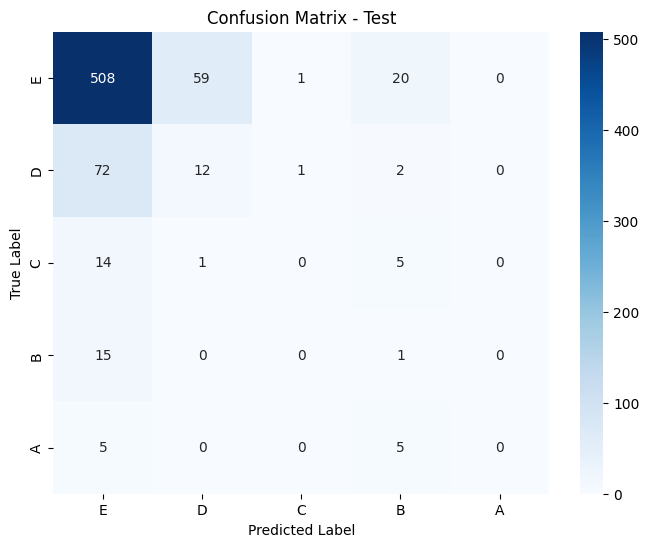

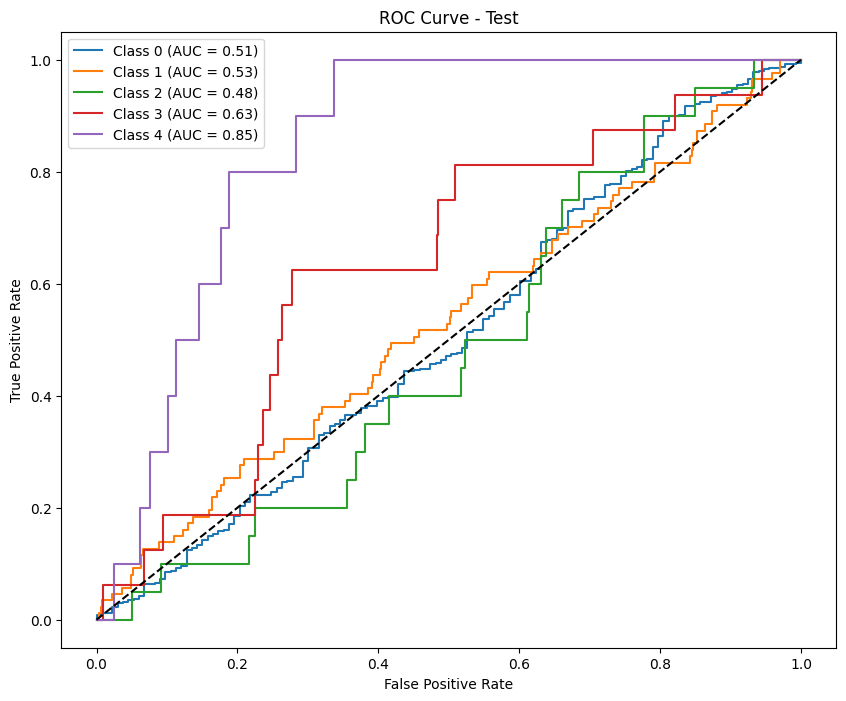

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.81925055 0.66934835 0.53538462 0.69873418 0.68292683]
Precision (per class): [0.91769547 0.62934947 0.38839286 0.58474576 0.51851852]
Recall (per class): [0.73988056 0.71477663 0.86138614 0.86792453 1.        ]
Accuracy: 0.7490
AUC (One-vs-Rest): 0.9460

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.74      0.82      1507
           D       0.63      0.71      0.67       582
           C       0.39      0.86      0.54       101
           B       0.58      0.87      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.75      2363
   macro avg

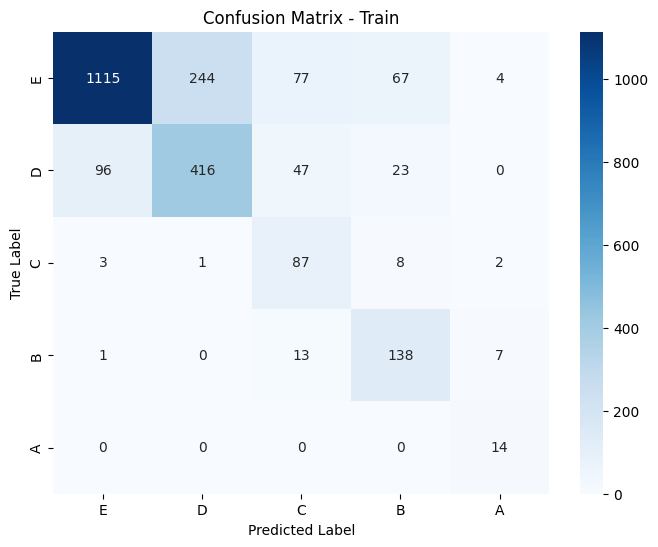

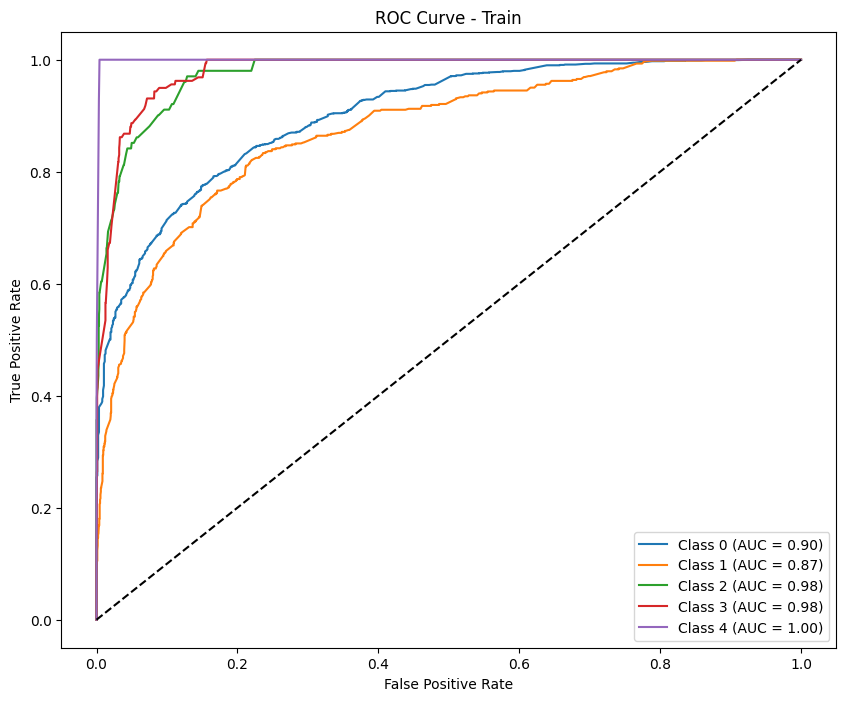

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.76603774 0.11049724 0.         0.06451613 0.        ]
Precision (per class): [0.8039604  0.10416667 0.         0.04       0.        ]
Recall (per class): [0.73153153 0.11764706 0.         0.16666667 0.        ]
Accuracy: 0.6099
AUC (One-vs-Rest): 0.5702

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.73      0.77       555
           D       0.10      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.04      0.17      0.06        18
           A       0.00      0.00      0.00        11

    accuracy                           0.61       687
   macro avg       0.19      0.20      0.19       687
weighted avg       0.66      0.61      0.63       687



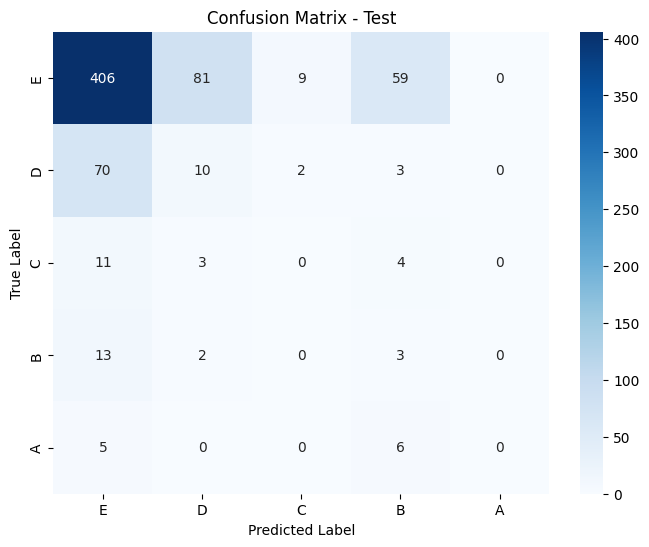

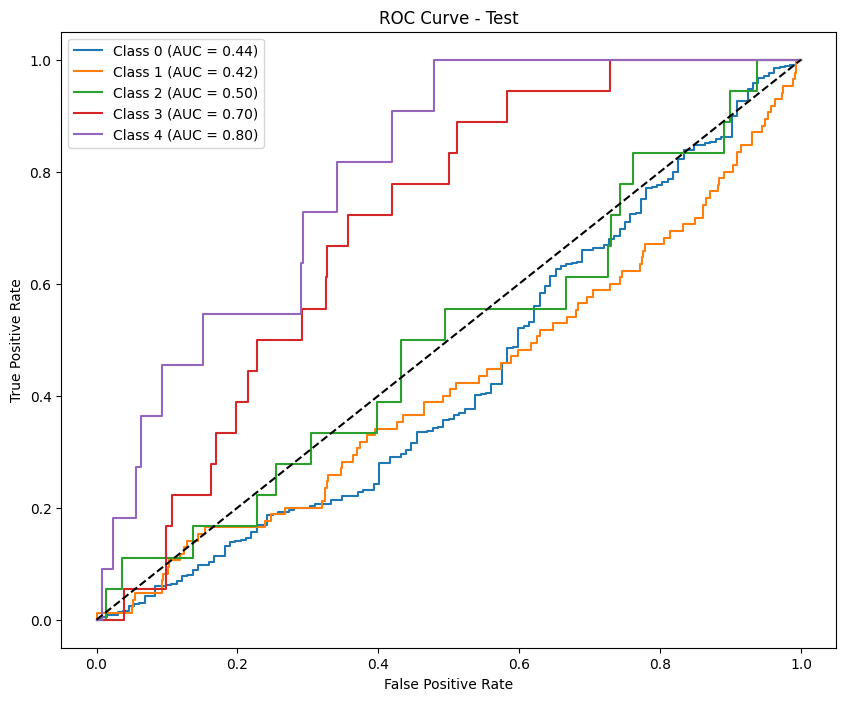

Results saved as test_results_calibrate_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87144703 0.64065708 0.63967611 0.73854447 0.73684211]
Precision (per class): [0.84896161 0.79591837 0.54109589 0.64622642 0.58333333]
Recall (per class): [0.89515594 0.53608247 0.78217822 0.86163522 1.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.9512

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.90      0.87      1507
           D       0.80      0.54      0.64       582
           C       0.54      0.78      0.64       101
           B       0.65      0.86      0.74       159
           A       0.58      1.00      0.74        14

    accuracy                           0.80      2363
   macro avg       0.68      0.82      0.73      2363
weighted avg       0.81      0.80      0.79      2363



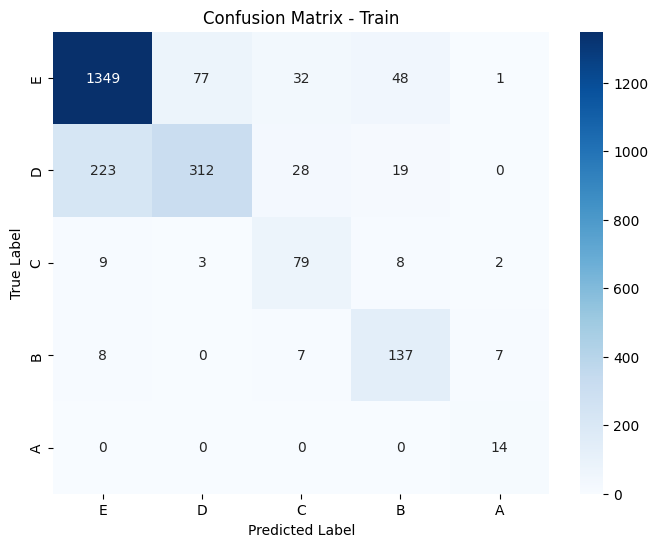

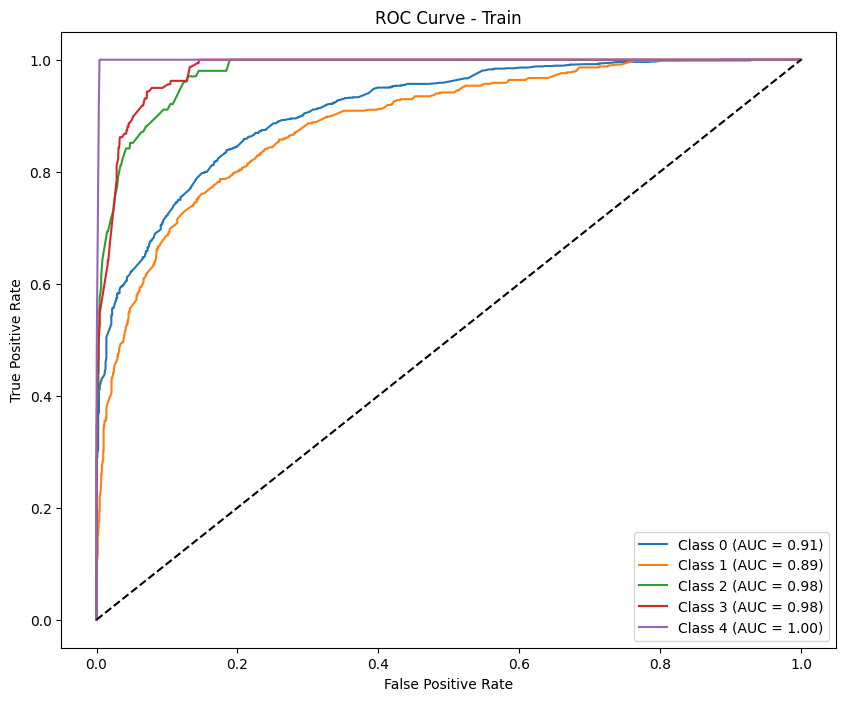

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.84687767 0.03278689 0.         0.03773585 0.        ]
Precision (per class): [0.80618893 0.05405405 0.         0.02857143 0.        ]
Recall (per class): [0.89189189 0.02352941 0.         0.05555556 0.        ]
Accuracy: 0.7249
AUC (One-vs-Rest): 0.5843

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85       555
           D       0.05      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.72       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.66      0.72      0.69       687



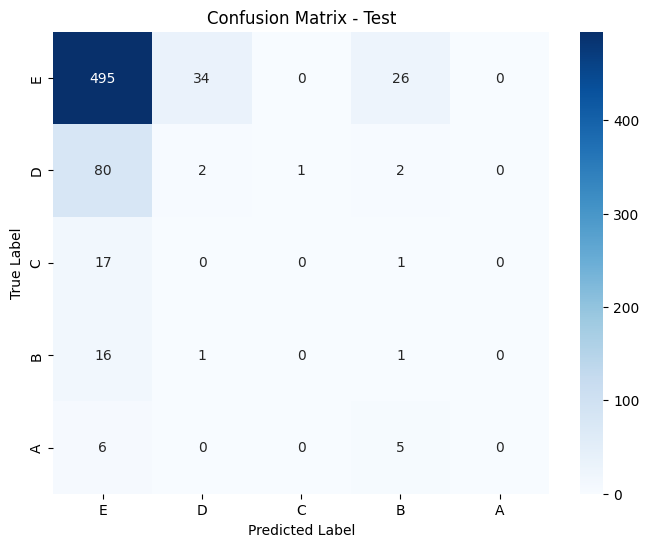

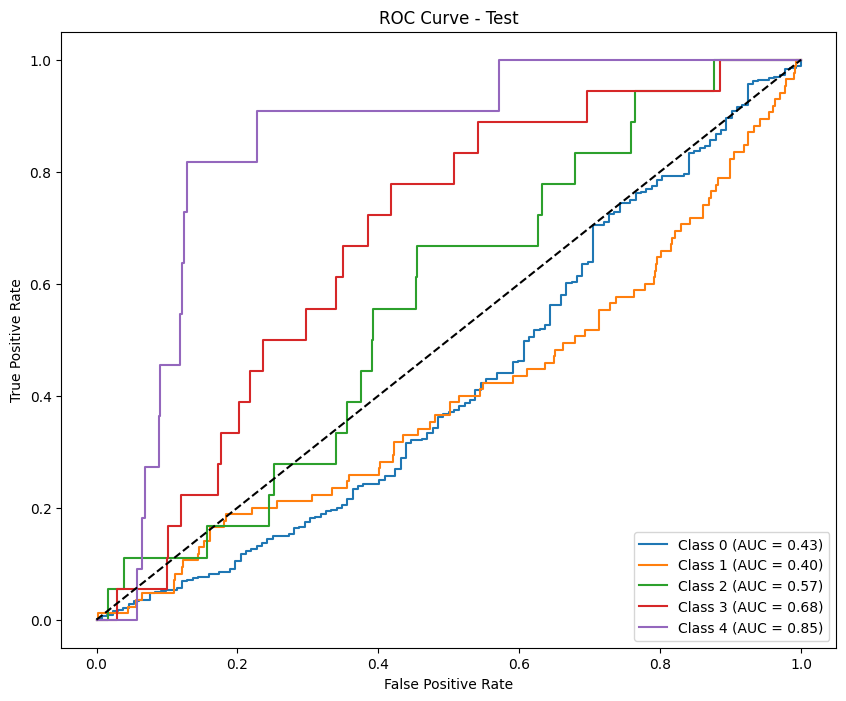

In [30]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, scale='log', metric='f1_macro')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

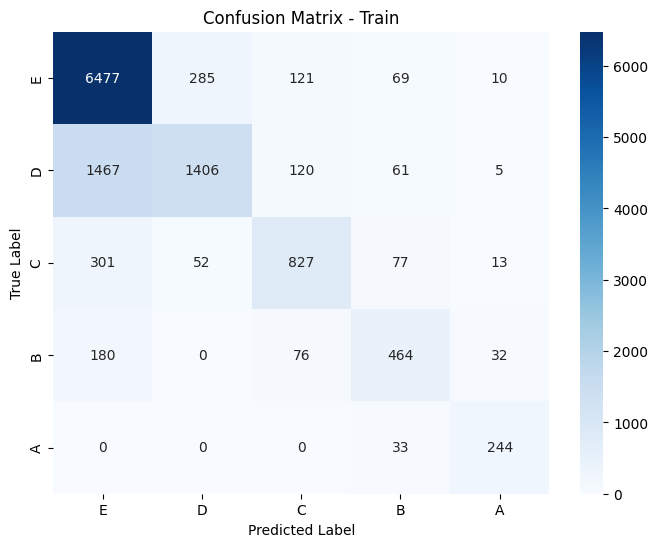

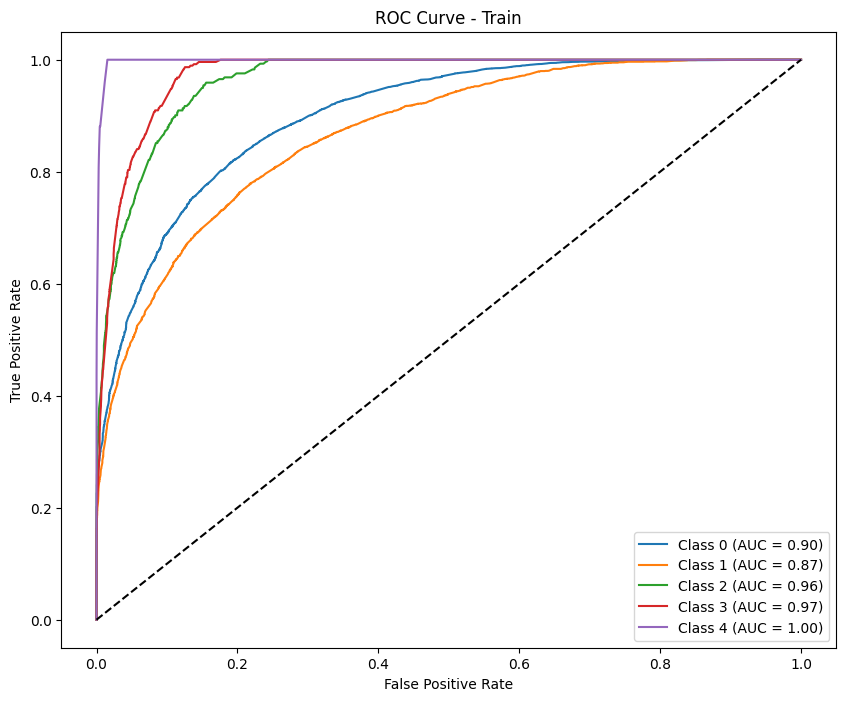

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92509653 0.45508982 0.         0.         0.        ]
Precision (per class): [0.88217968 0.52054795 0.         0.         0.        ]
Recall (per class): [0.9724026  0.40425532 0.         0.         0.        ]
Accuracy: 0.8426
AUC (One-vs-Rest): 0.8220

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.97      0.93       616
           D       0.52      0.40      0.46        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.28      0.28       756
weighted avg       0.78      0.84      0.81       756



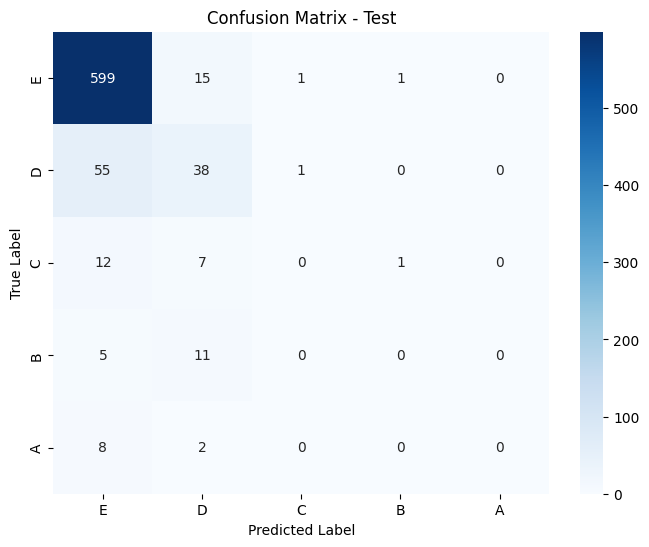

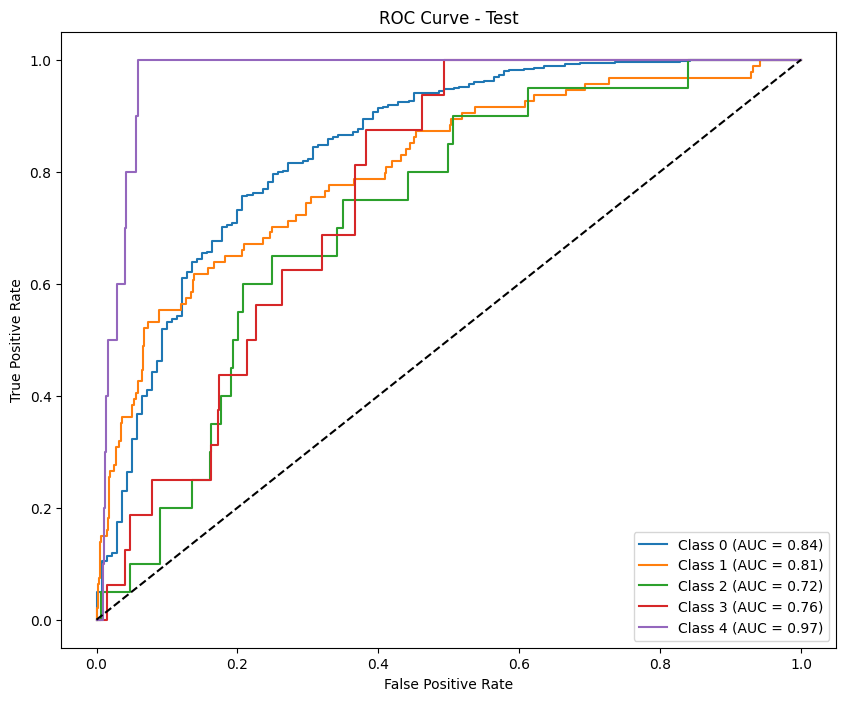

Results saved as test_results_calibrate_undersample_log_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.84180377 0.61583236 0.68580804 0.64060357 0.8457539 ]
Precision (per class): [0.78487144 0.7575179  0.71575342 0.66147309 0.81333333]
Recall (per class): [0.90764148 0.51879699 0.65826772 0.62101064 0.88086643]
Accuracy: 0.7673
AUC (One-vs-Rest): 0.9414

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.91      0.84      6962
           D       0.76      0.52      0.62      3059
           C       0.72      0.66      0.69      1270
           B       0.66      0.62      0.64       752
           A       0.81      0.88      0.85       277

    accuracy                           0.77     12320
   macro avg       0.75      0.72      0.73     12320
weighted avg       0.76      0.77      0.76     12320



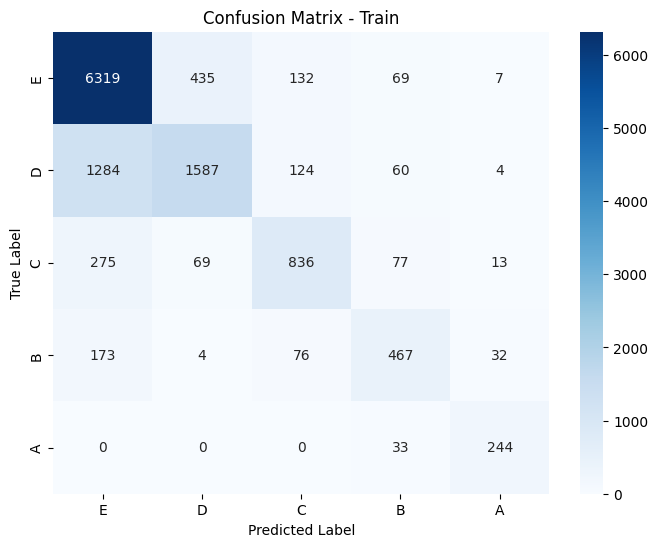

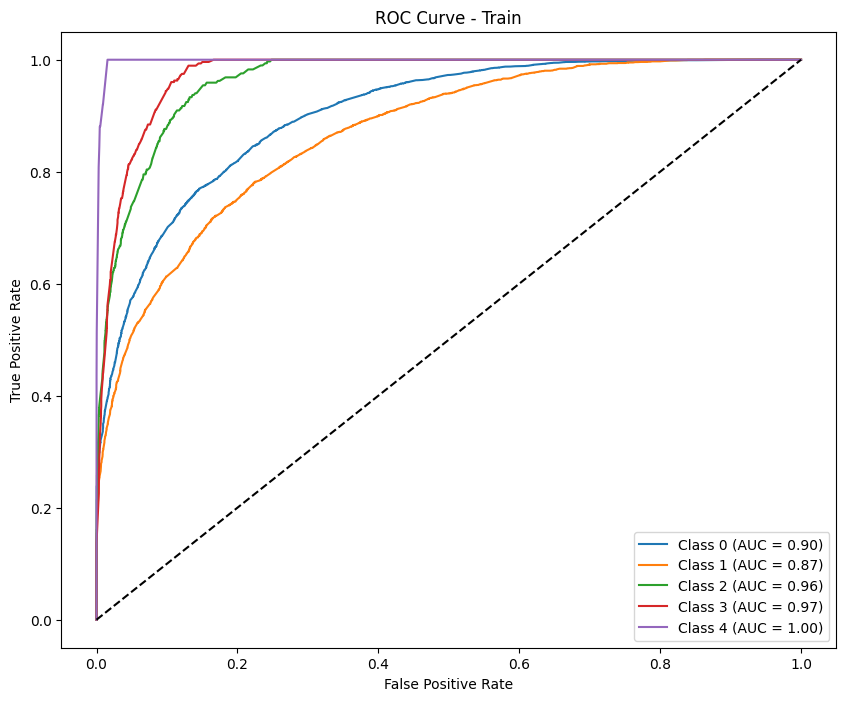

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92463092 0.45714286 0.         0.         0.        ]
Precision (per class): [0.88673621 0.49382716 0.         0.         0.        ]
Recall (per class): [0.96590909 0.42553191 0.         0.         0.        ]
Accuracy: 0.8399
AUC (One-vs-Rest): 0.7725

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.97      0.92       616
           D       0.49      0.43      0.46        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.28      0.28       756
weighted avg       0.78      0.84      0.81       756



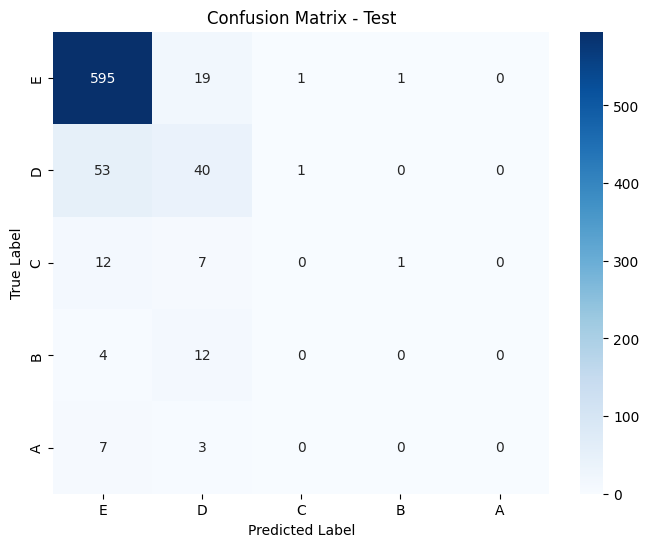

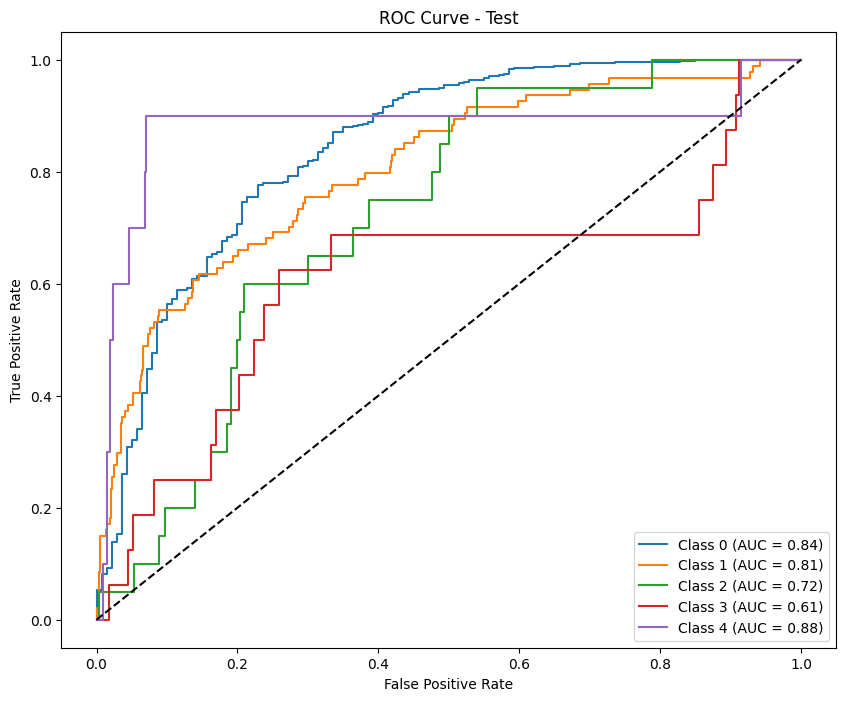


Permutation Importance for phase: phase1


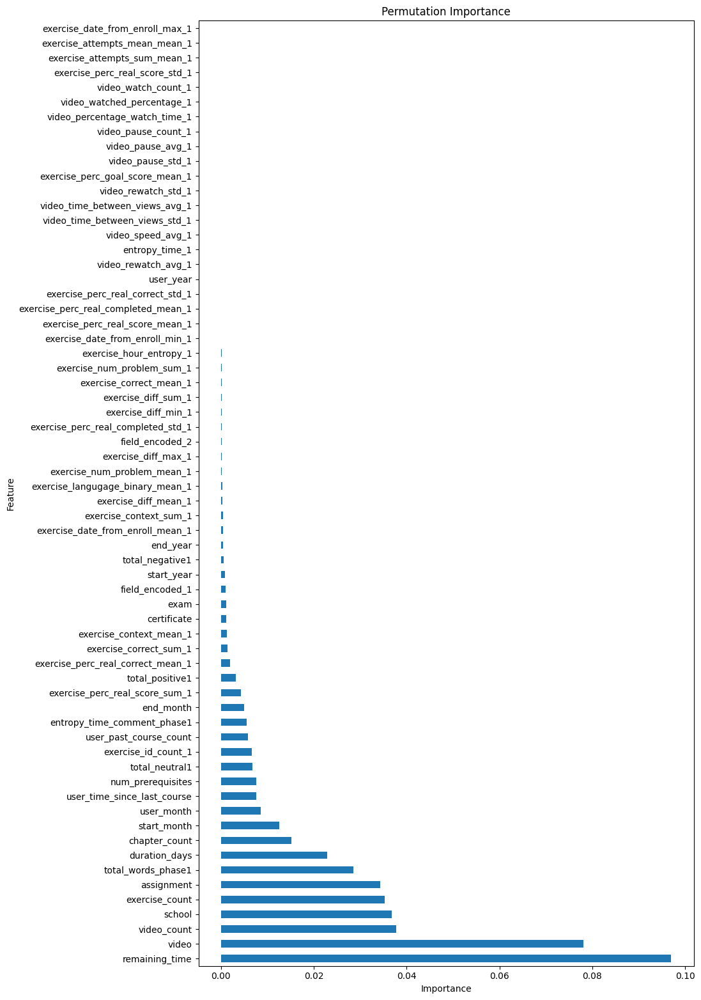

                            Feature  Importance
20                   remaining_time    0.096987
17                            video    0.078105
9                       video_count    0.037774
0                            school    0.036739
10                   exercise_count    0.035268
..                              ...         ...
48              video_watch_count_1    0.000000
46   exercise_perc_real_score_std_1    0.000000
27     exercise_attempts_sum_mean_1    0.000000
28    exercise_attempts_mean_mean_1    0.000000
31  exercise_date_from_enroll_max_1   -0.000010

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.314e+01, tolerance: 1.282e+00


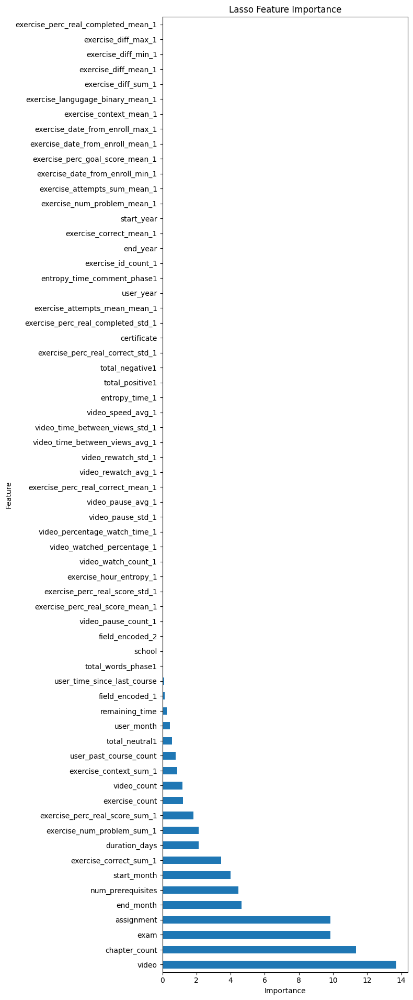

                                Feature  Importance
17                                video   13.697189
11                        chapter_count   11.344376
18                                 exam    9.859732
16                           assignment    9.851117
6                             end_month    4.650374
..                                  ...         ...
35                  exercise_diff_sum_1    0.000000
36                 exercise_diff_mean_1    0.000000
37                  exercise_diff_min_1    0.000000
38                  exercise_diff_max_1    0.000000
40  exercise_perc_real_completed_mean_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
15                        certificate    0.142068
44     exercise_perc_real_score_sum_1    0.117161
17                              video    0.090715
16                         assignment    0.063636
42  exercise_perc_real_correct_mean_1    

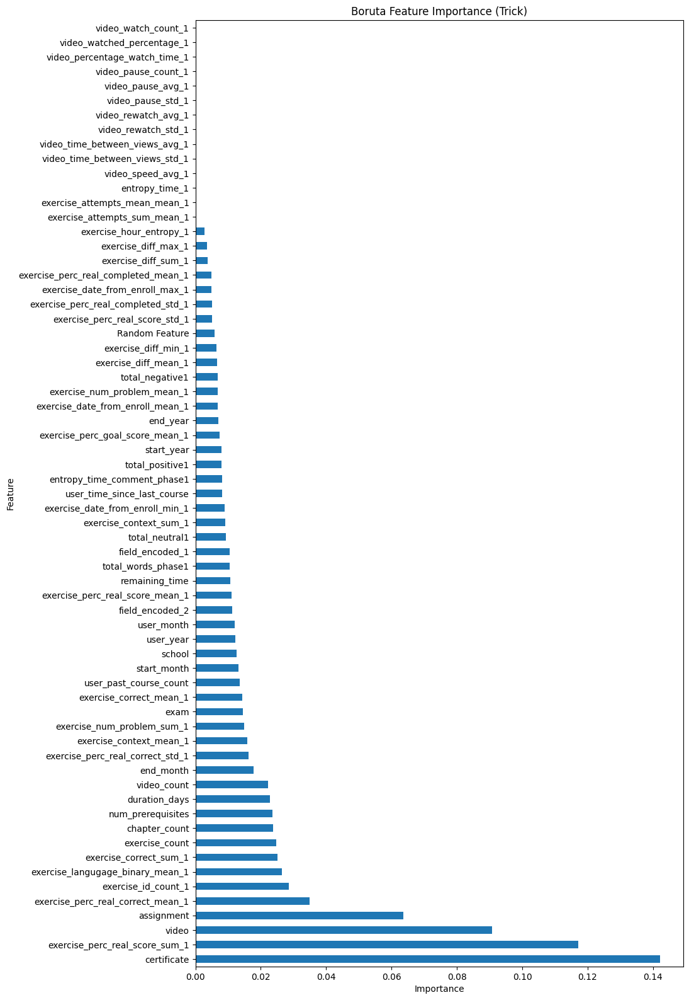

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83818981 0.55379747 0.70387965 0.65306122 0.88616462]
Precision (per class): [0.77242724 0.77835434 0.68595679 0.67149059 0.85472973]
Recall (per class): [0.91619217 0.42979943 0.72276423 0.63561644 0.92      ]
Accuracy: 0.7579
AUC (One-vs-Rest): 0.9407

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.92      0.84      5620
           D       0.78      0.43      0.55      2443
           C       0.69      0.72      0.70      1230
           B       0.67      0.64      0.65       730
           A       0.85      0.92      0.89       275

    accuracy                           0.76     10298
   macro avg

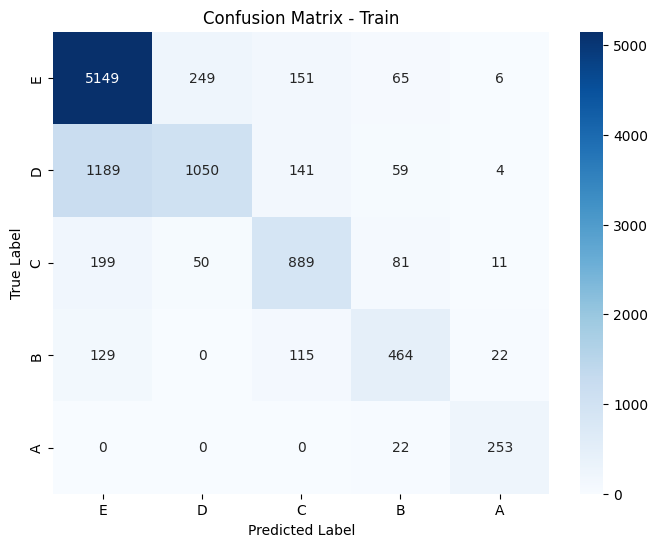

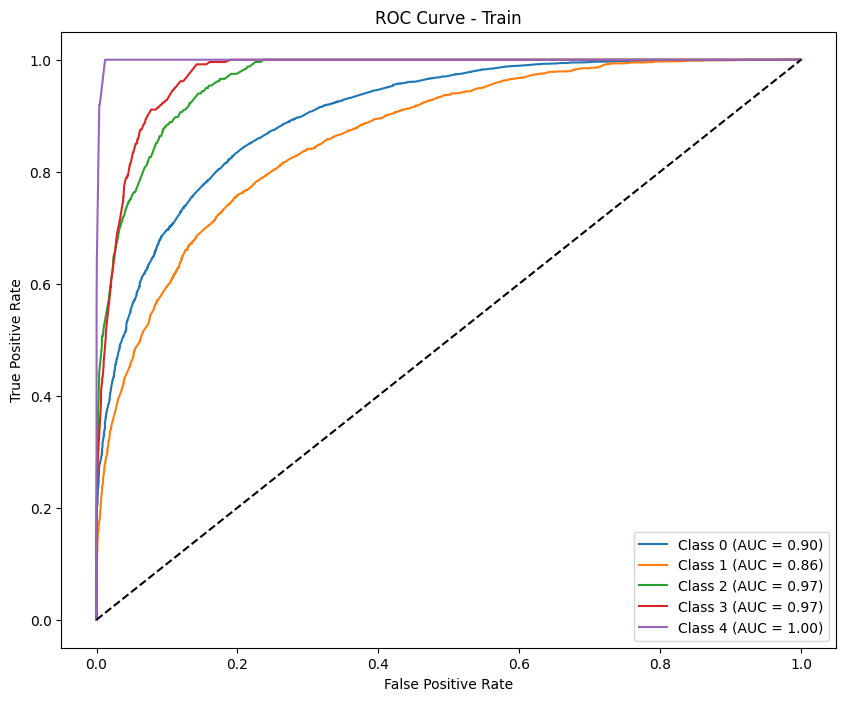

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9047619 0.2962963 0.        0.        0.       ]
Precision (per class): [0.84992785 0.46511628 0.         0.         0.        ]
Recall (per class): [0.96715928 0.2173913  0.         0.         0.        ]
Accuracy: 0.8164
AUC (One-vs-Rest): 0.7539

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.97      0.90       609
           D       0.47      0.22      0.30        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.82       746
   macro avg       0.26      0.24      0.24       746
weighted avg       0.75      0.82      0.78       746



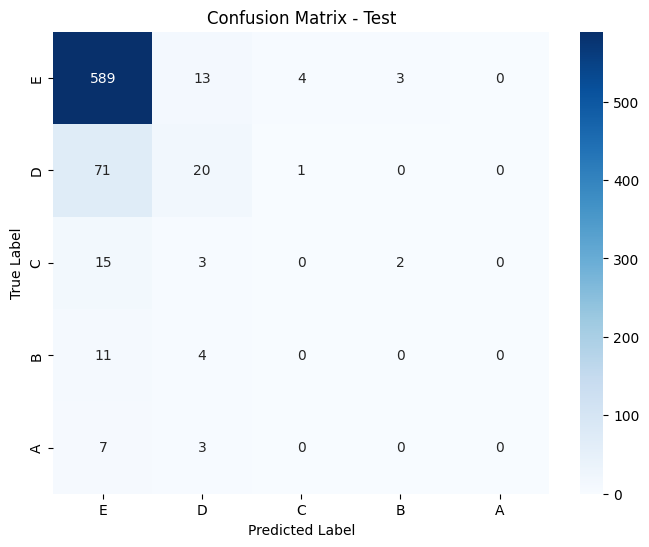

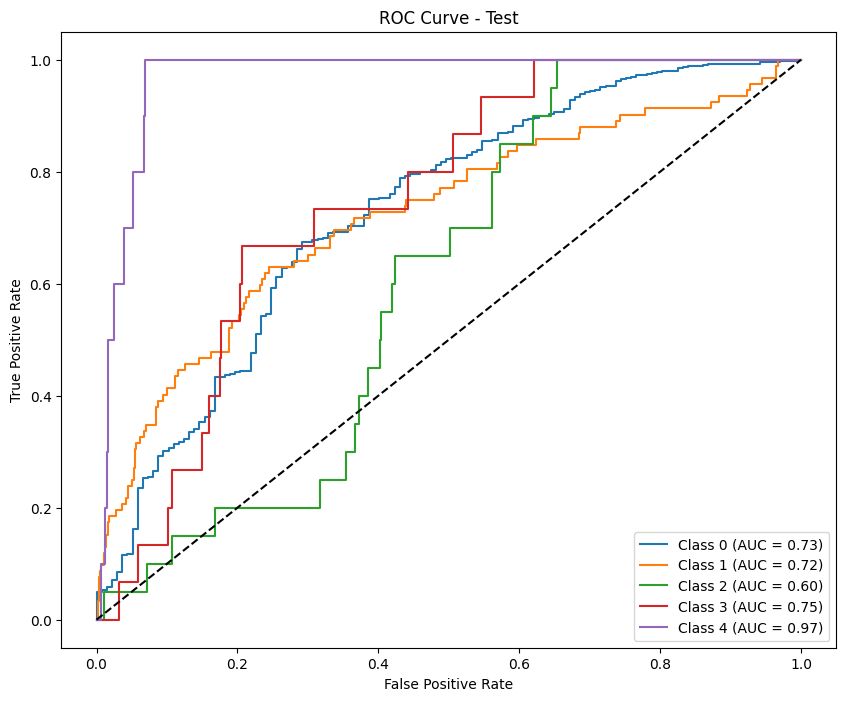

Results saved as test_results_calibrate_undersample_log_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83575778 0.59031257 0.71377246 0.66887857 0.88927944]
Precision (per class): [0.79642166 0.7076659  0.70117647 0.64864865 0.86054422]
Recall (per class): [0.87918149 0.50634466 0.72682927 0.69041096 0.92      ]
Accuracy: 0.7602
AUC (One-vs-Rest): 0.9410

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.88      0.84      5620
           D       0.71      0.51      0.59      2443
           C       0.70      0.73      0.71      1230
           B       0.65      0.69      0.67       730
           A       0.86      0.92      0.89       275

    accuracy                           0.76     10298
   macro avg       0.74      0.74      0.74     10298
weighted avg       0.76      0.76      0.75     10298



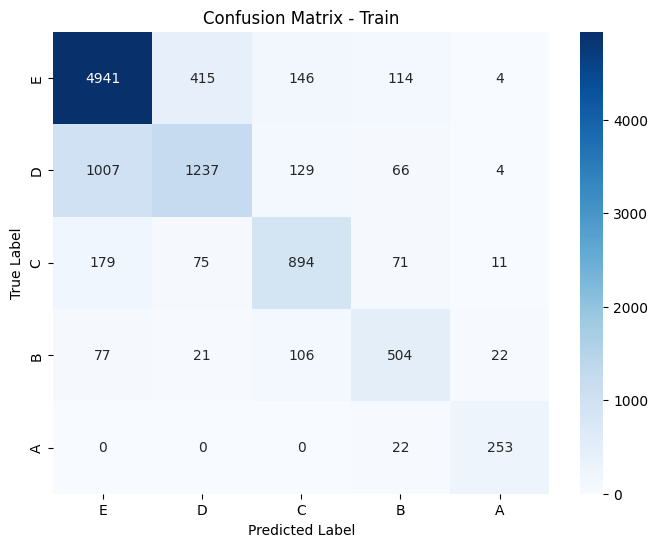

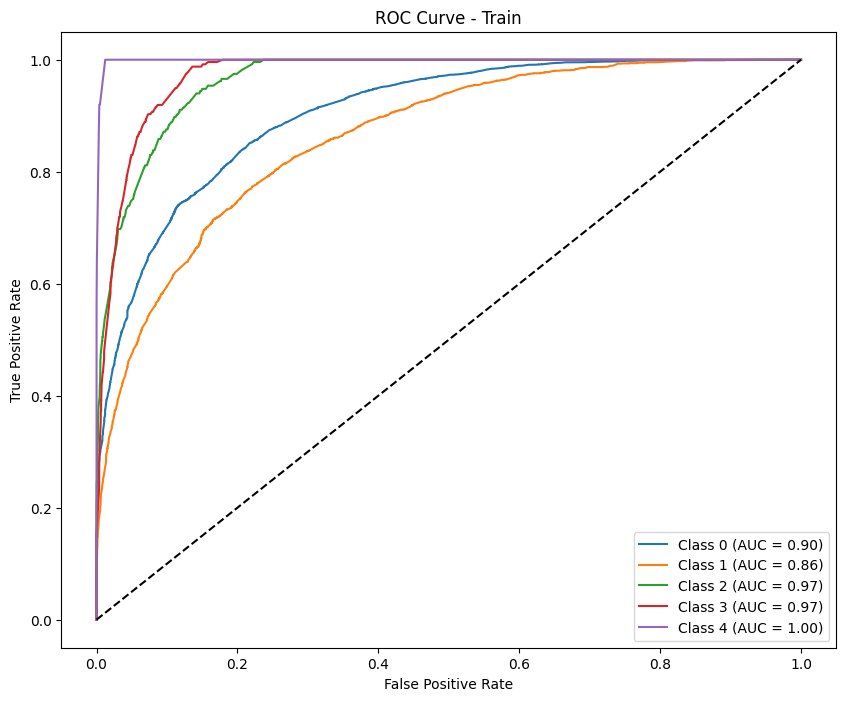

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90262751 0.29577465 0.         0.         0.        ]
Precision (per class): [0.85255474 0.42       0.         0.         0.        ]
Recall (per class): [0.9589491  0.22826087 0.         0.         0.        ]
Accuracy: 0.8110
AUC (One-vs-Rest): 0.7163

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.96      0.90       609
           D       0.42      0.23      0.30        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.25      0.24      0.24       746
weighted avg       0.75      0.81      0.77       746



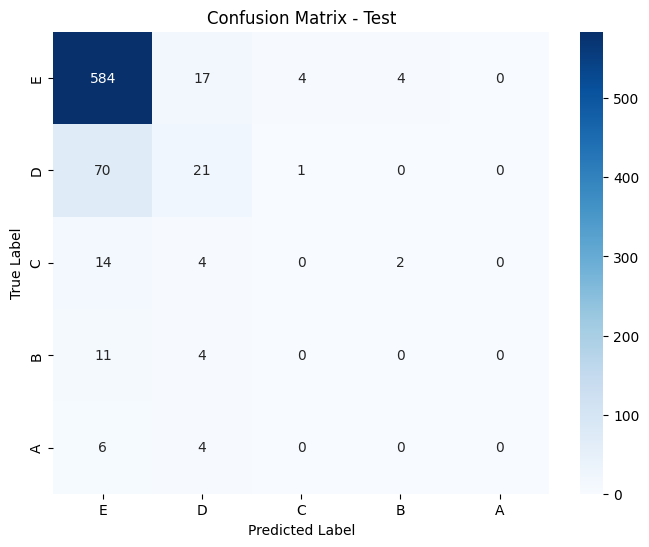

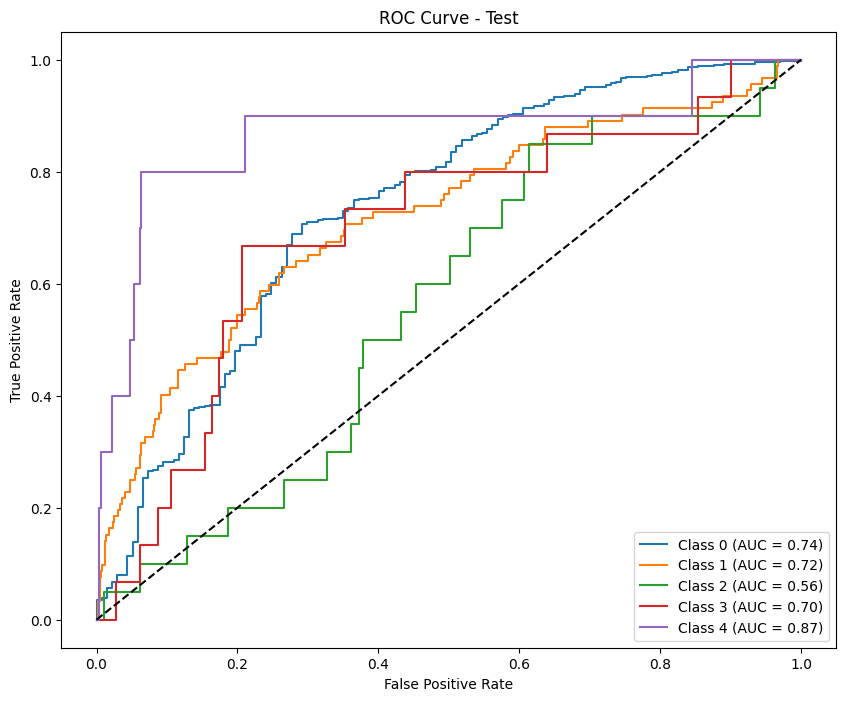


Permutation Importance for phase: phase2


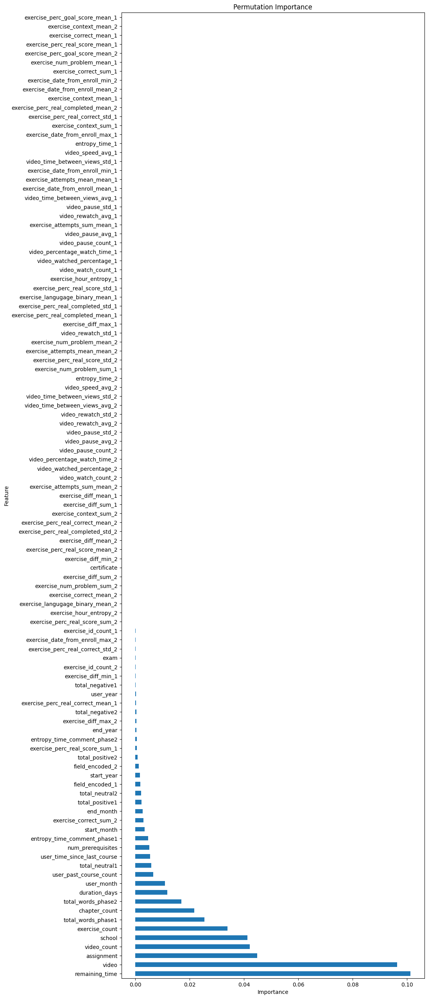

                            Feature  Importance
20                   remaining_time    0.101330
17                            video    0.096426
16                       assignment    0.044924
9                       video_count    0.042205
0                            school    0.041294
..                              ...         ...
82  exercise_perc_goal_score_mean_2   -0.000049
45  exercise_perc_real_score_mean_1   -0.000049
24          exercise_correct_mean_1   -0.000061
76          exercise_context_mean_2   -0.000073
39  exercise_perc_goal_score_mean_1   -0.000073

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.427e+00, tolerance: 1.181e+00


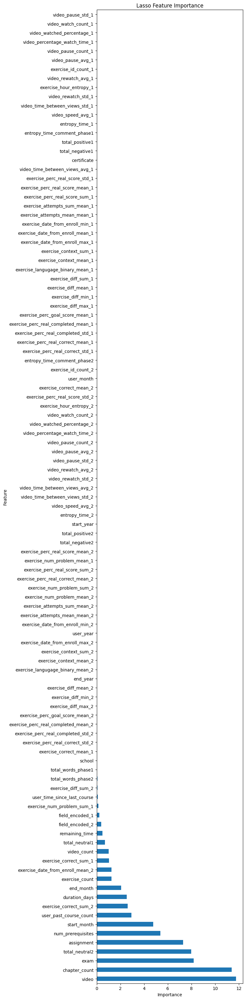

                           Feature  Importance
17                           video   11.758057
11                   chapter_count   11.403660
18                            exam    8.196602
106                 total_neutral2    7.971058
16                      assignment    7.301690
..                             ...         ...
51             video_pause_count_1    0.000000
50   video_percentage_watch_time_1    0.000000
49      video_watched_percentage_1    0.000000
48             video_watch_count_1    0.000000
53               video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                               Feature  Importance
15                         certificate    0.124703
17                               video    0.110678
16                          assignment    0.055409
10                      exercise_count    0.022974
66              exercise_correct_sum_2    0.022493
..                                 ...      

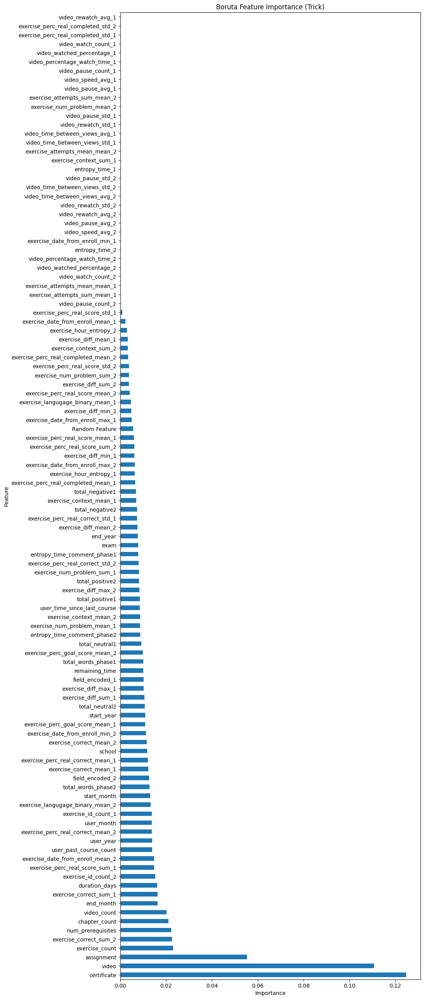

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84372177 0.58127258 0.72263993 0.68368032 0.86642599]
Precision (per class): [0.78540195 0.78117999 0.72023314 0.65089514 0.84210526]
Recall (per class): [0.91139735 0.46283186 0.72506287 0.71994342 0.89219331]
Accuracy: 0.7673
AUC (One-vs-Rest): 0.9457

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      5124
           D       0.78      0.46      0.58      2260
           C       0.72      0.73      0.72      1193
           B       0.65      0.72      0.68       707
           A       0.84      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg

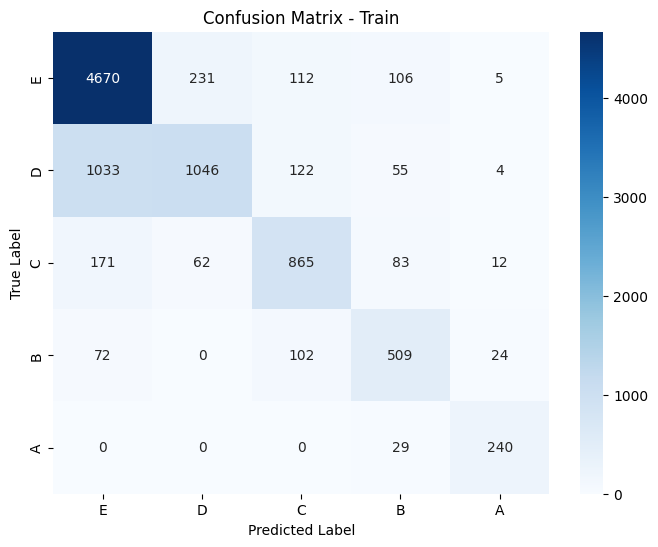

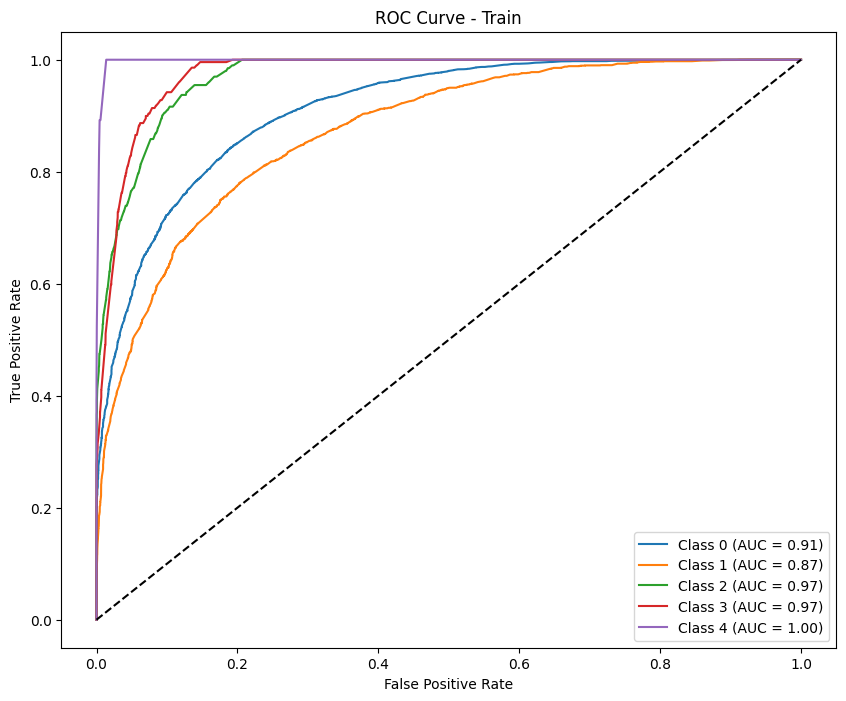

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89184953 0.125      0.08333333 0.         0.        ]
Precision (per class): [0.82703488 0.28       0.25       0.         0.        ]
Recall (per class): [0.96768707 0.08045977 0.05       0.         0.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.6462

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.08      0.12        87
           C       0.25      0.05      0.08        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.27      0.22      0.22       721
weighted avg       0.72      0.80      0.74       721



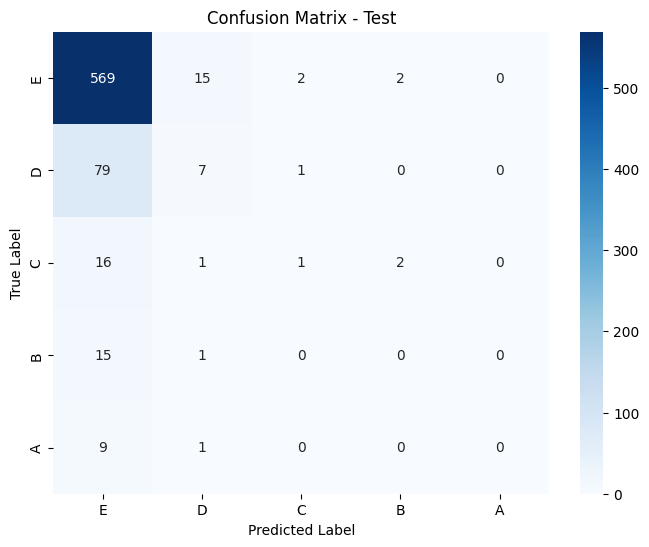

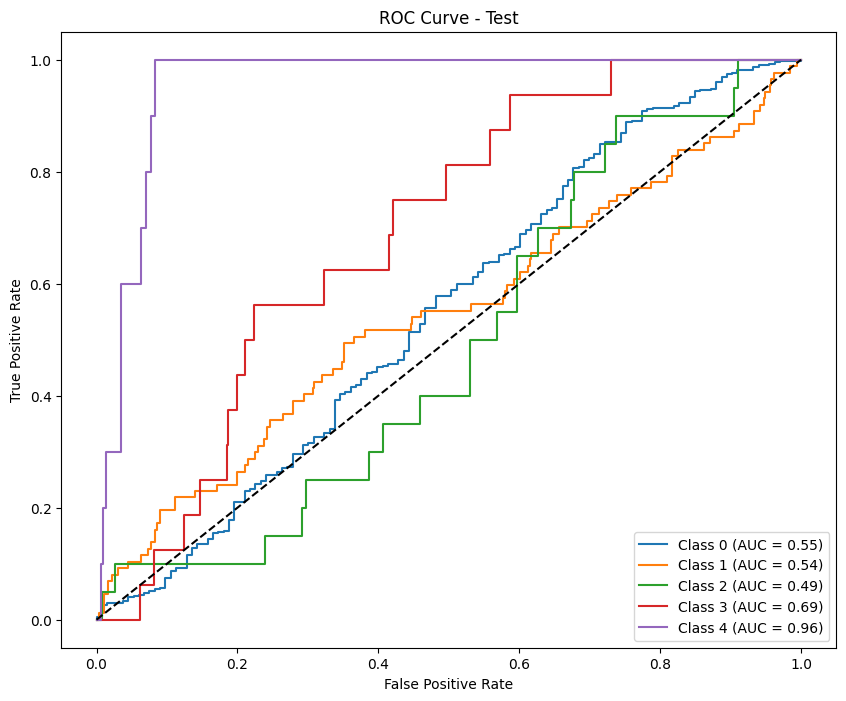

Results saved as test_results_calibrate_undersample_log_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84161892 0.61077844 0.72522898 0.68724832 0.87114338]
Precision (per class): [0.7992278  0.74193548 0.72043011 0.65389527 0.85106383]
Recall (per class): [0.88875878 0.51902655 0.7300922  0.7241867  0.89219331]
Accuracy: 0.7694
AUC (One-vs-Rest): 0.9462

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.74      0.52      0.61      2260
           C       0.72      0.73      0.73      1193
           B       0.65      0.72      0.69       707
           A       0.85      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.75      0.75      0.75      9553
weighted avg       0.77      0.77      0.76      9553



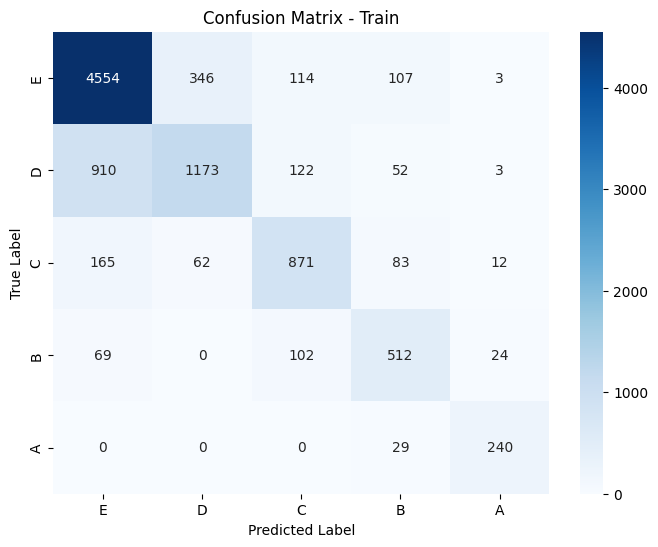

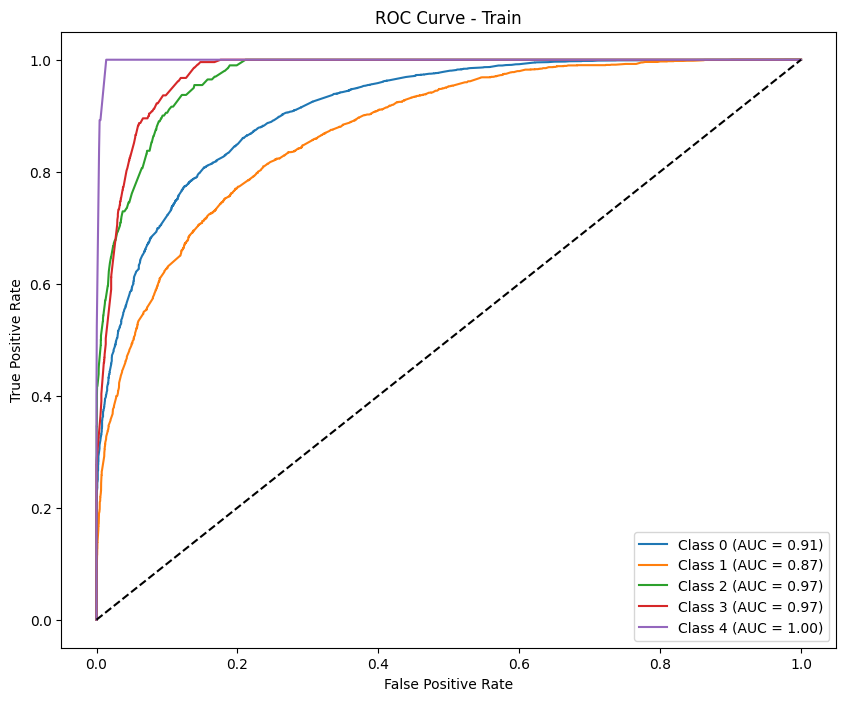

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8923802  0.13793103 0.         0.         0.        ]
Precision (per class): [0.82919708 0.27586207 0.         0.         0.        ]
Recall (per class): [0.96598639 0.09195402 0.         0.         0.        ]
Accuracy: 0.7989
AUC (One-vs-Rest): 0.6167

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.09      0.14        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.22      0.21      0.21       721
weighted avg       0.71      0.80      0.74       721



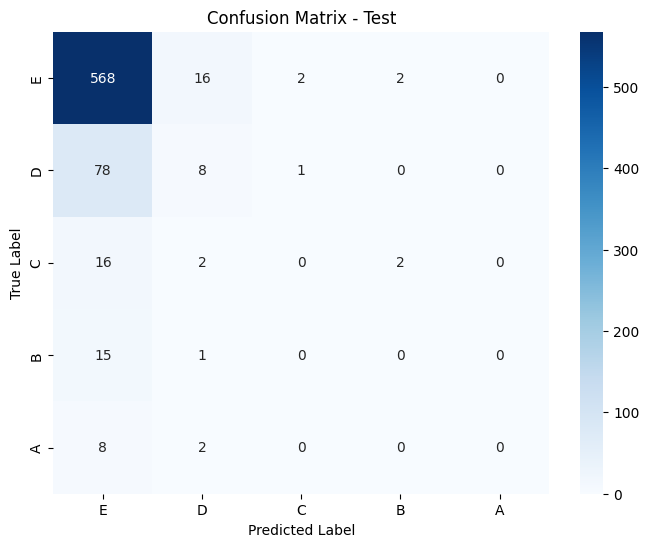

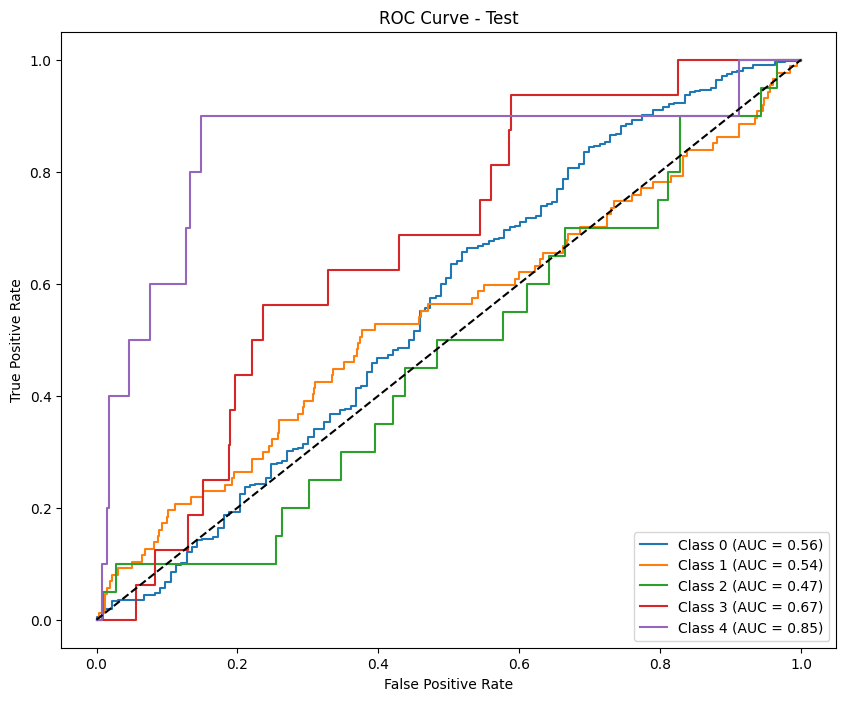

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.8548913  0.63215686 0.81690141 0.76438356 0.90410959]
Precision (per class): [0.81650662 0.83264463 0.79248506 0.69662921 0.825     ]
Recall (per class): [0.89706302 0.50948167 0.84287012 0.84673748 1.        ]
Accuracy: 0.8016
AUC (One-vs-Rest): 0.9593

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.90      0.85      3507
           D       0.83      0.51      0.63      1582
           C       0.79      0.84      0.82      1101
           B       0.70      0.85      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.80      7113
   macro avg

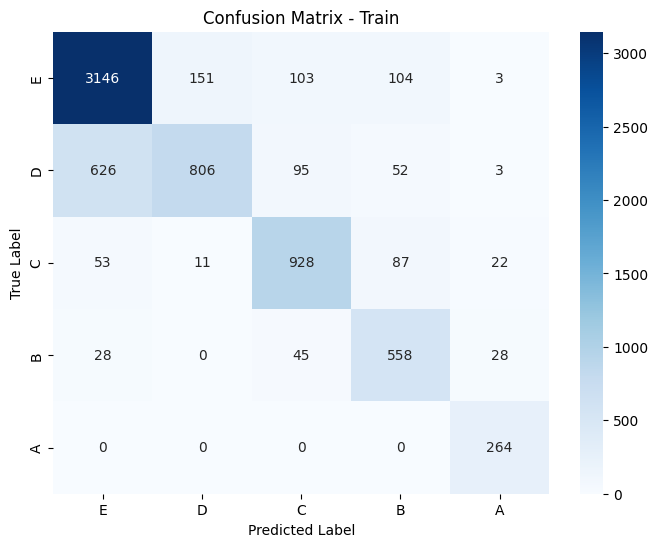

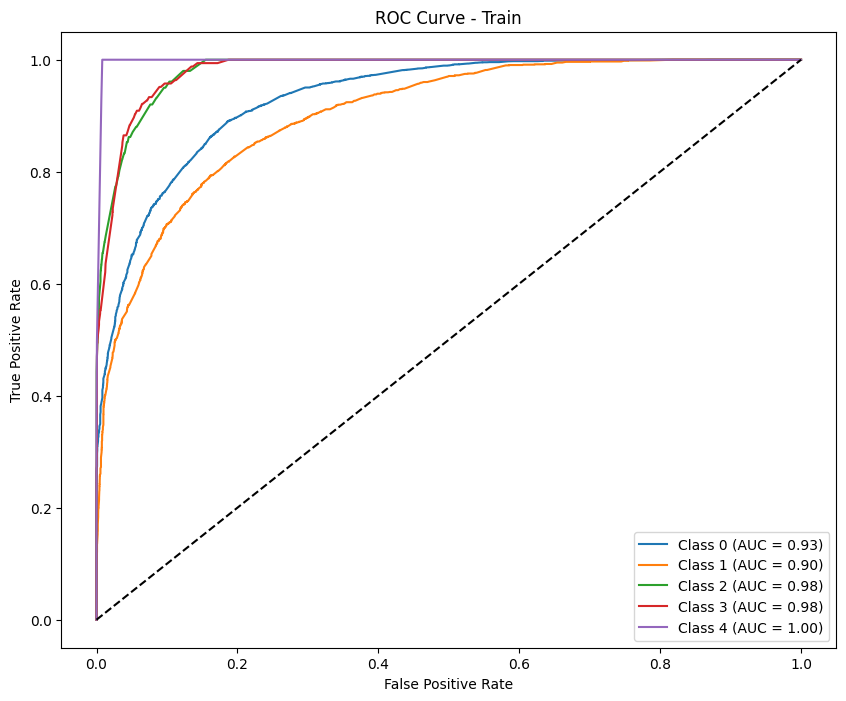

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87687188 0.03738318 0.         0.         0.        ]
Precision (per class): [0.81452859 0.09090909 0.         0.         0.        ]
Recall (per class): [0.94954955 0.02352941 0.         0.         0.        ]
Accuracy: 0.7700
AUC (One-vs-Rest): 0.5890

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.95      0.88       555
           D       0.09      0.02      0.04        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.77       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.77      0.71       687



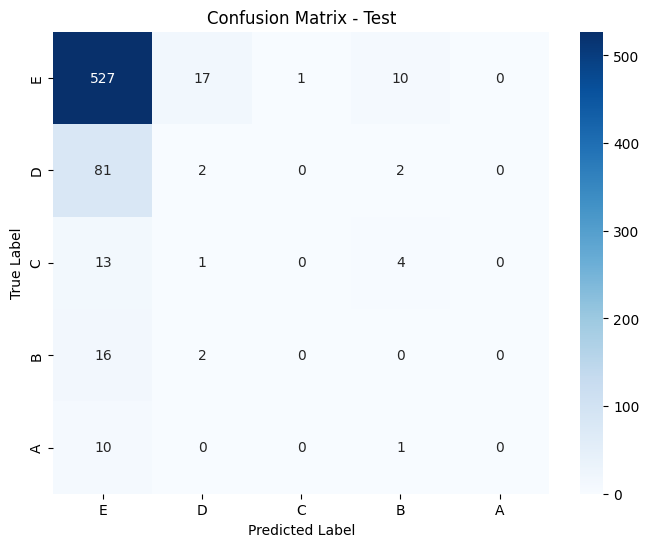

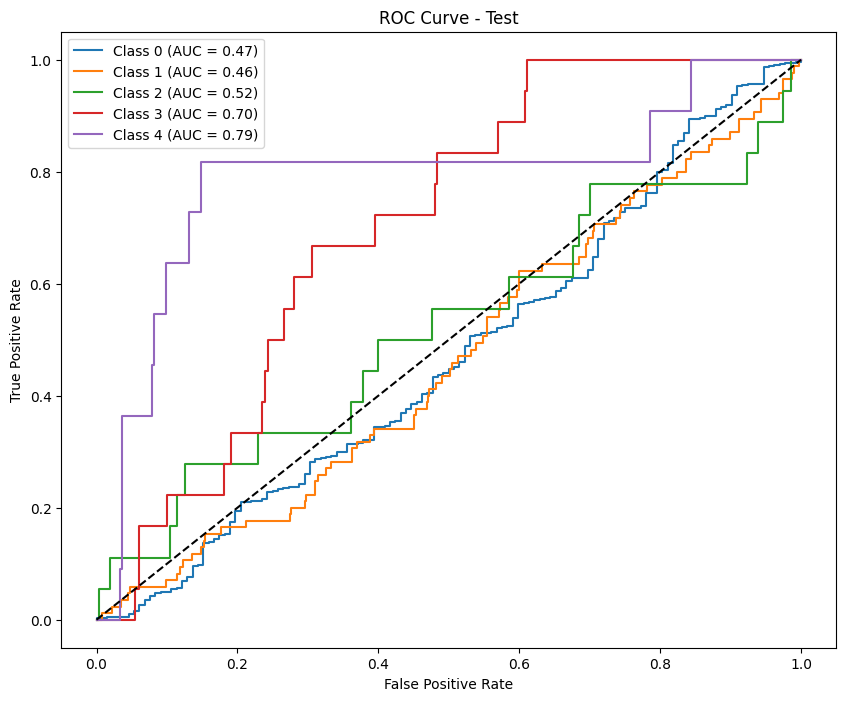

Results saved as test_results_calibrate_undersample_log_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85442776 0.64719272 0.81762115 0.76693767 0.90566038]
Precision (per class): [0.82631859 0.80929791 0.79384089 0.69277846 0.82758621]
Recall (per class): [0.88451668 0.5391909  0.84287012 0.85887709 1.        ]
Accuracy: 0.8032
AUC (One-vs-Rest): 0.9598

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.88      0.85      3507
           D       0.81      0.54      0.65      1582
           C       0.79      0.84      0.82      1101
           B       0.69      0.86      0.77       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.79      0.83      0.80      7113
weighted avg       0.81      0.80      0.80      7113



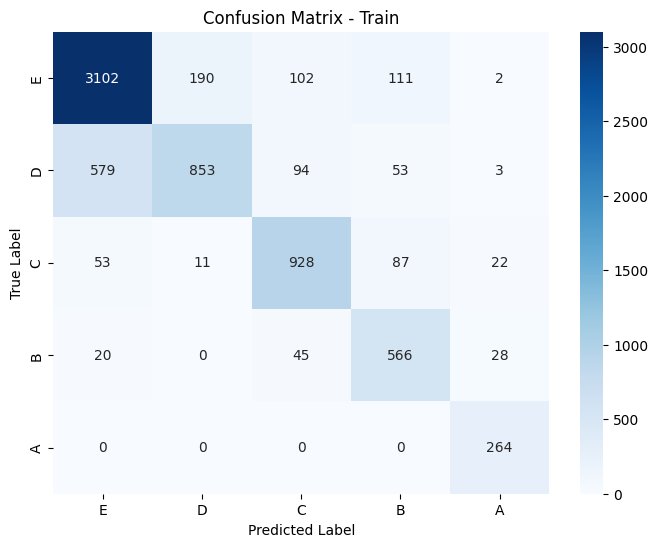

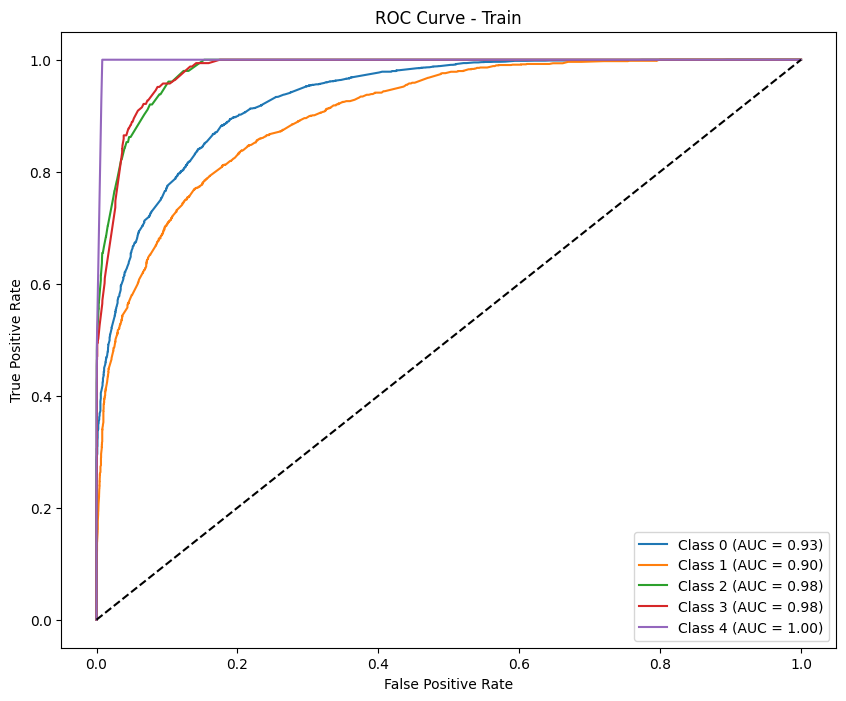

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.86985726 0.05084746 0.         0.         0.        ]
Precision (per class): [0.81446541 0.09090909 0.         0.         0.        ]
Recall (per class): [0.93333333 0.03529412 0.         0.         0.        ]
Accuracy: 0.7584
AUC (One-vs-Rest): 0.5709

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.93      0.87       555
           D       0.09      0.04      0.05        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.76       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.76      0.71       687



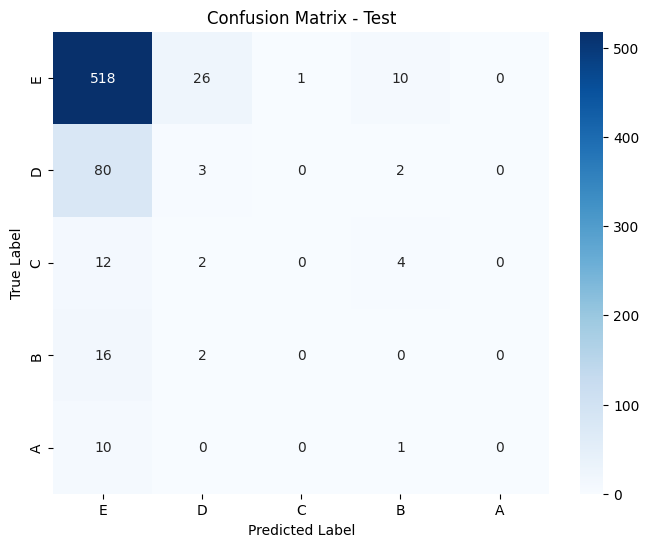

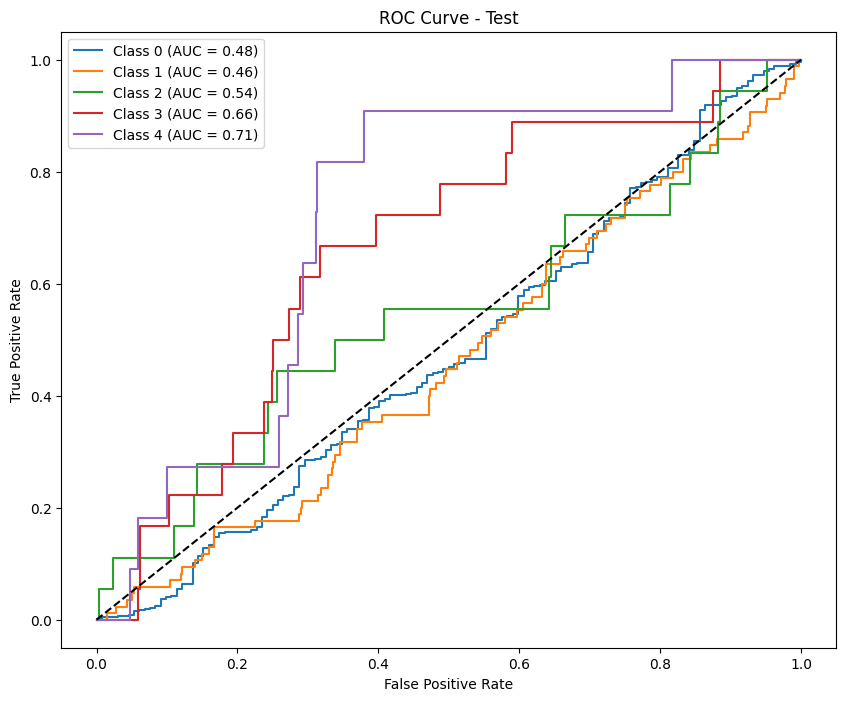

In [31]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, scale='log', metric='f1_macro')

# 4. Scale dữ liệu theo MinMax

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

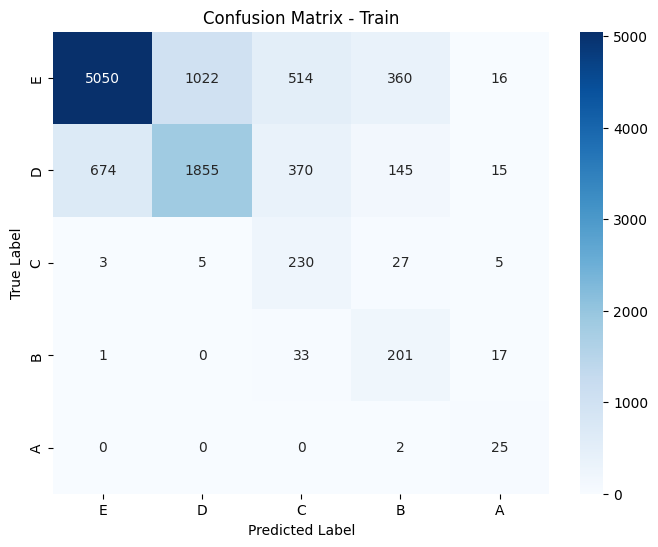

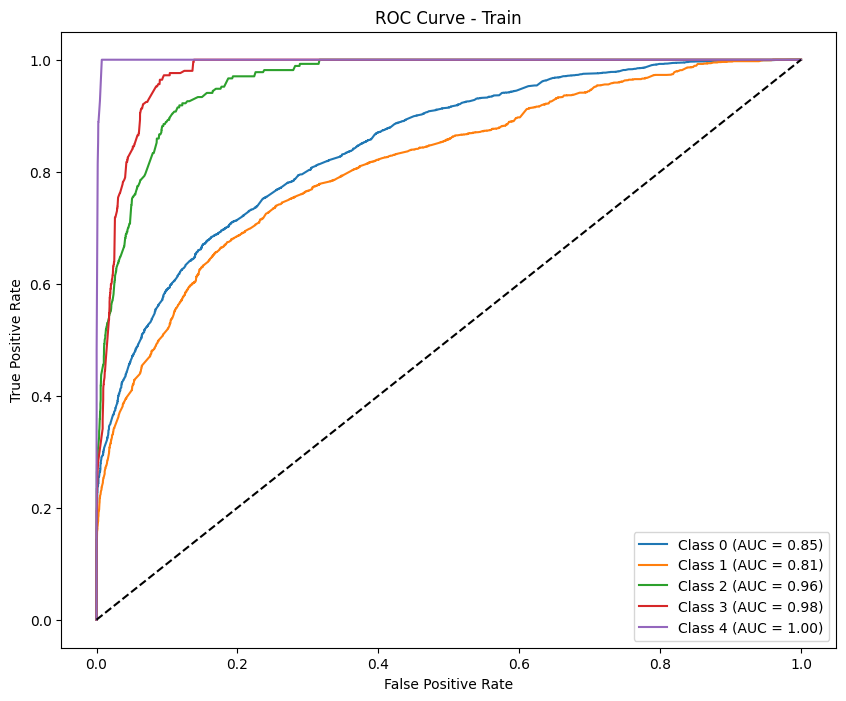

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90923318 0.4260355  0.         0.         0.        ]
Precision (per class): [0.8776435 0.48      0.        0.        0.       ]
Recall (per class): [0.94318182 0.38297872 0.         0.         0.        ]
Accuracy: 0.8161
AUC (One-vs-Rest): 0.7952

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.94      0.91       616
           D       0.48      0.38      0.43        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.82       756
   macro avg       0.27      0.27      0.27       756
weighted avg       0.77      0.82      0.79       756



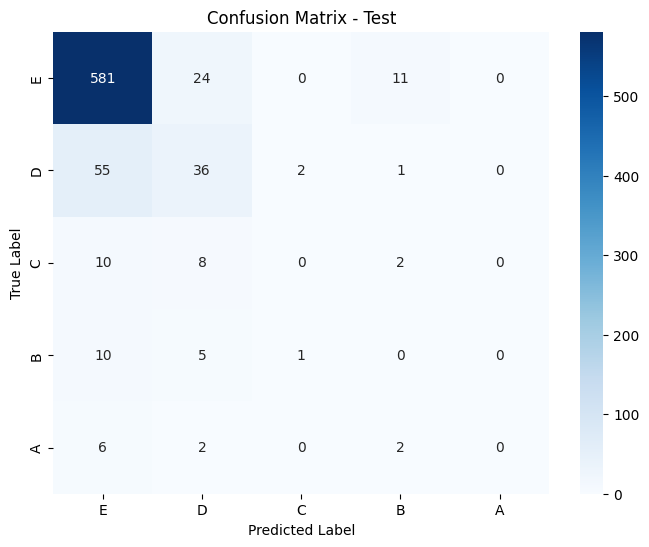

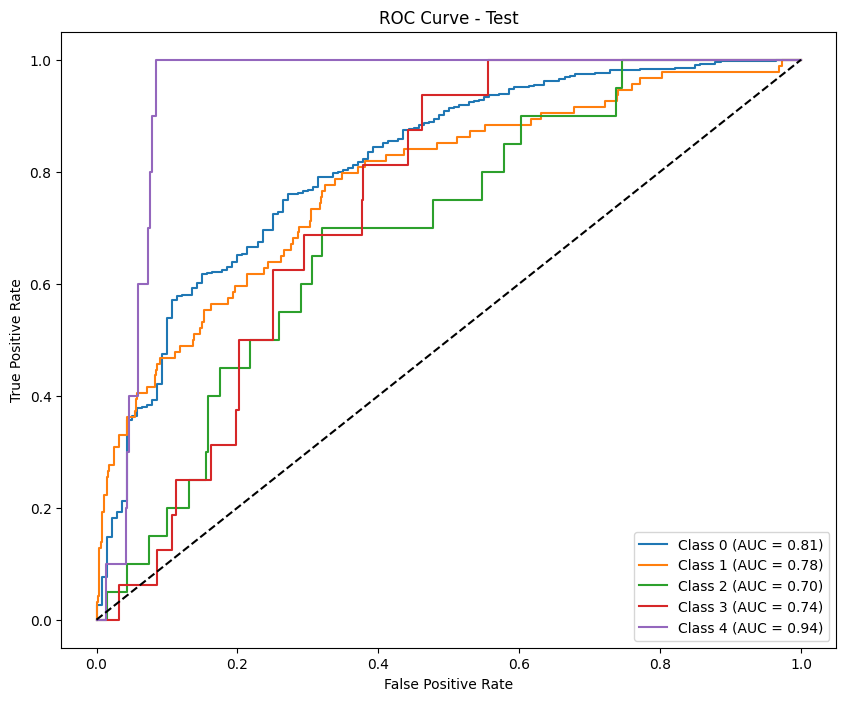

Results saved as test_results_calibrate_minmax_f1_macro_phase1.csv
-------------Results for calibrate phase: phase1---------------

--- Train Metrics ---
F1 Score (per class): [0.84385871 0.59070885 0.50943396 0.49916805 0.65671642]
Precision (per class): [0.78975707 0.7622739  0.51923077 0.42979943 0.55      ]
Recall (per class): [0.90591784 0.48218372 0.5        0.5952381  0.81481481]
Accuracy: 0.7653
AUC (One-vs-Rest): 0.9284

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      6962
           D       0.76      0.48      0.59      3059
           C       0.52      0.50      0.51       270
           B       0.43      0.60      0.50       252
           A       0.55      0.81      0.66        27

    accuracy                           0.77     10570
   macro avg       0.61      0.66      0.62     10570
weighted avg       0.77      0.77      0.75     10570



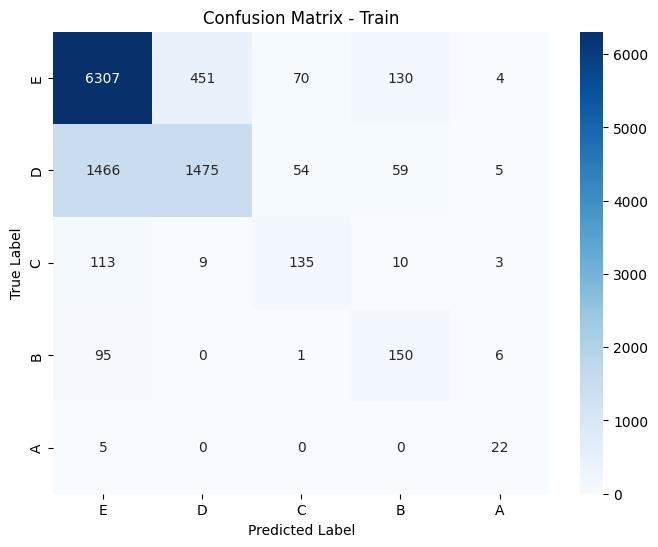

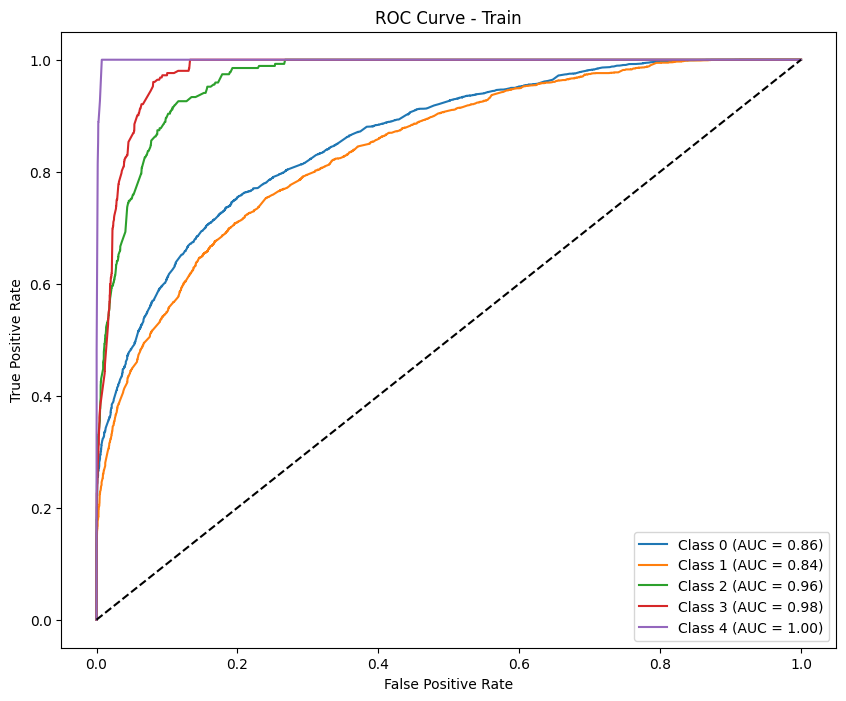

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91238671 0.39130435 0.         0.         0.        ]
Precision (per class): [0.85310734 0.61363636 0.         0.         0.        ]
Recall (per class): [0.98051948 0.28723404 0.         0.         0.        ]
Accuracy: 0.8347
AUC (One-vs-Rest): 0.7426

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.98      0.91       616
           D       0.61      0.29      0.39        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.83       756
   macro avg       0.29      0.25      0.26       756
weighted avg       0.77      0.83      0.79       756



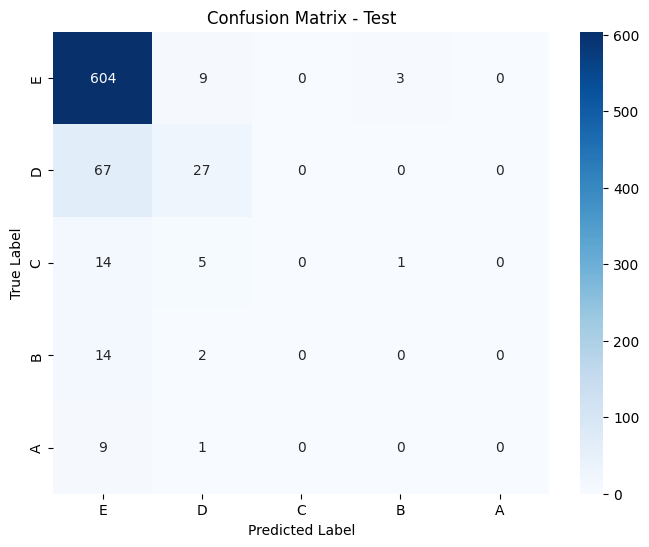

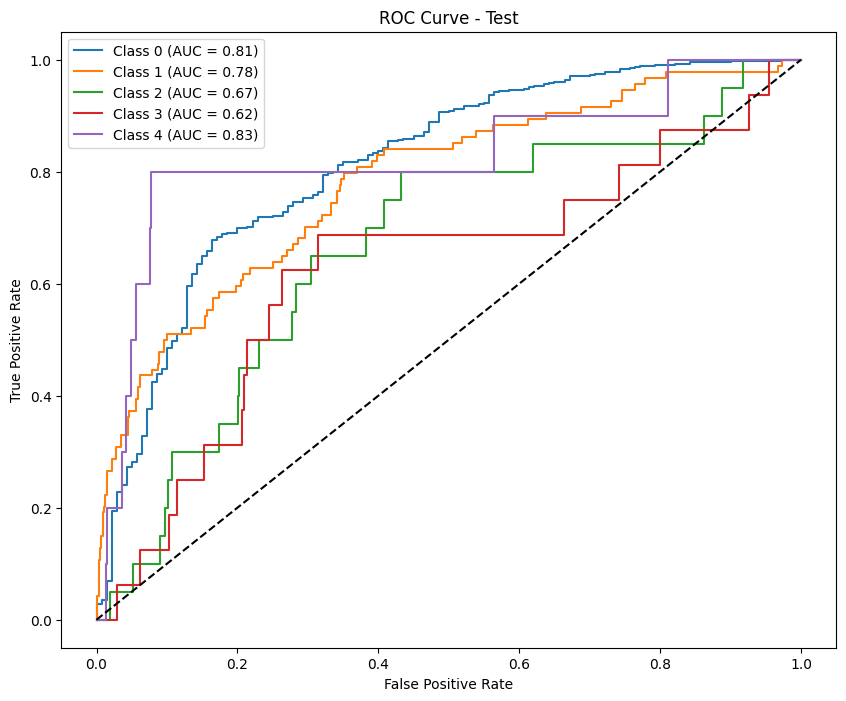


-------------Permutation Importance for phase: phase1---------


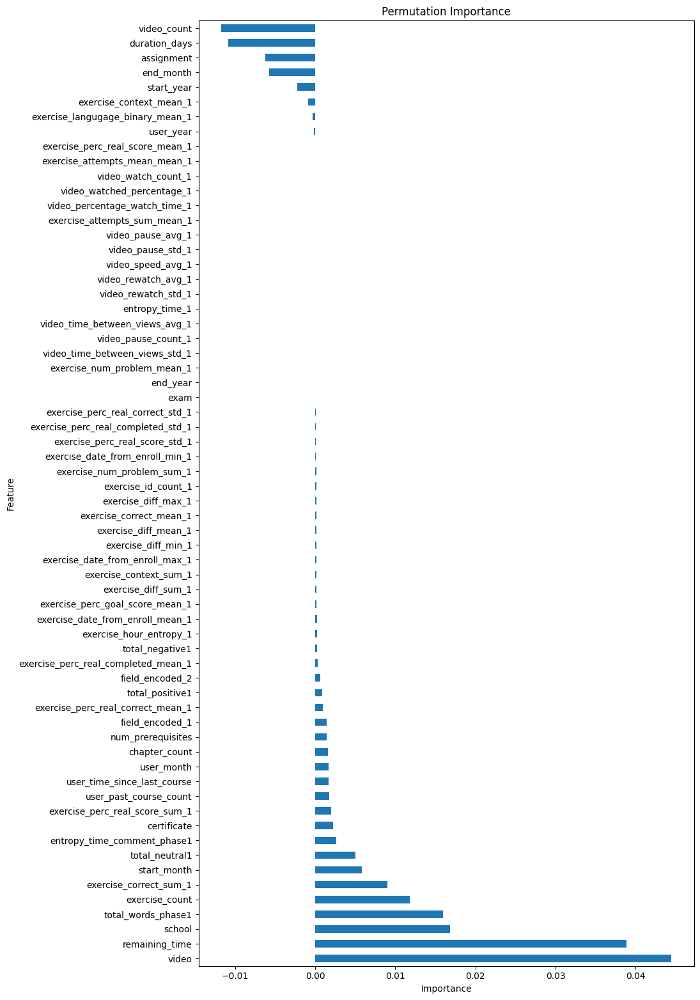

               Feature  Importance
17               video    0.044465
20      remaining_time    0.038895
0               school    0.016864
60  total_words_phase1    0.015989
10      exercise_count    0.011838
..                 ...         ...
3           start_year   -0.002259
6            end_month   -0.005747
16          assignment   -0.006232
19       duration_days   -0.010868
9          video_count   -0.011743

[64 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase1------------


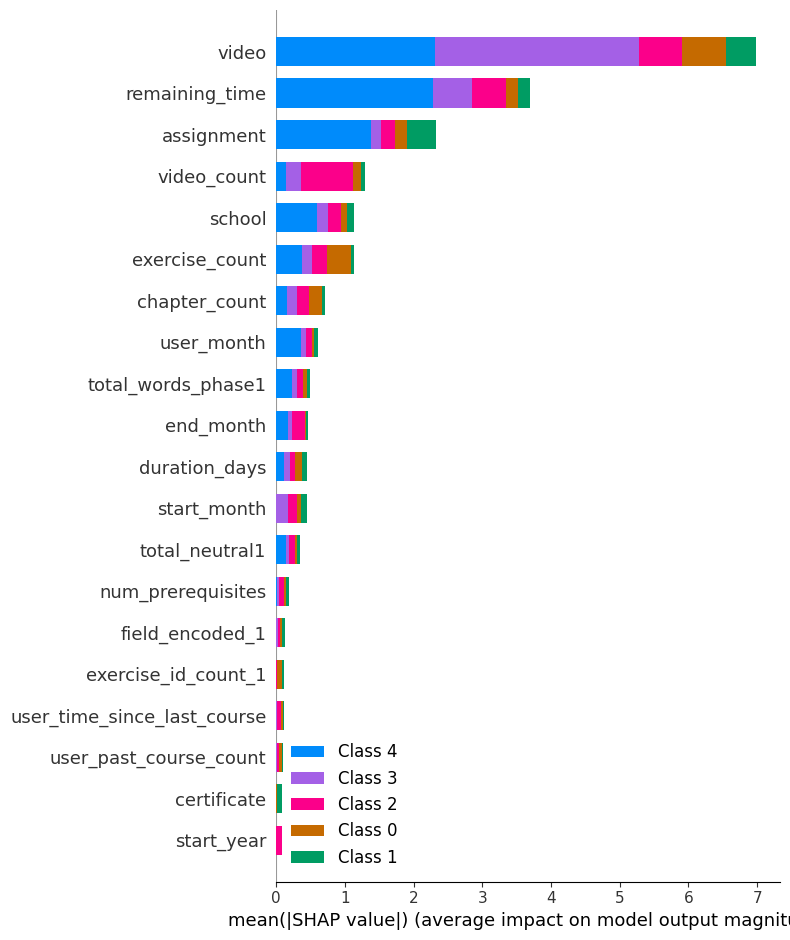


-----Lasso Feature Selection for phase: phase1----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.5852856548563068, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6451384620004319, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3329359385743373, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.684122639829184, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.032467137953063, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.07545261594305, tolerance: 0.38841890964995246
Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.327075219273866, tolerance: 0.38841

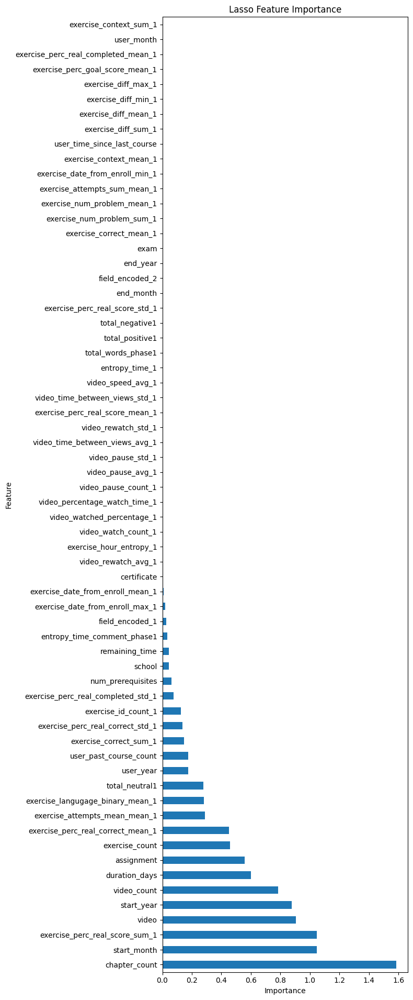

                                Feature  Importance
11                        chapter_count    1.583599
4                           start_month    1.047039
44       exercise_perc_real_score_sum_1    1.045067
17                                video    0.904924
3                            start_year    0.876312
..                                  ...         ...
38                  exercise_diff_max_1    0.000000
39      exercise_perc_goal_score_mean_1    0.000000
40  exercise_perc_real_completed_mean_1    0.000000
8                            user_month    0.000000
32               exercise_context_sum_1    0.000000

[64 rows x 2 columns]

----------Boruta Trick: phase1----------
Feature Importance (Including Random Feature):
                           Feature  Importance
15                     certificate    0.253476
44  exercise_perc_real_score_sum_1    0.150435
22             exercise_id_count_1    0.045931
17                           video    0.038594
16                      assig

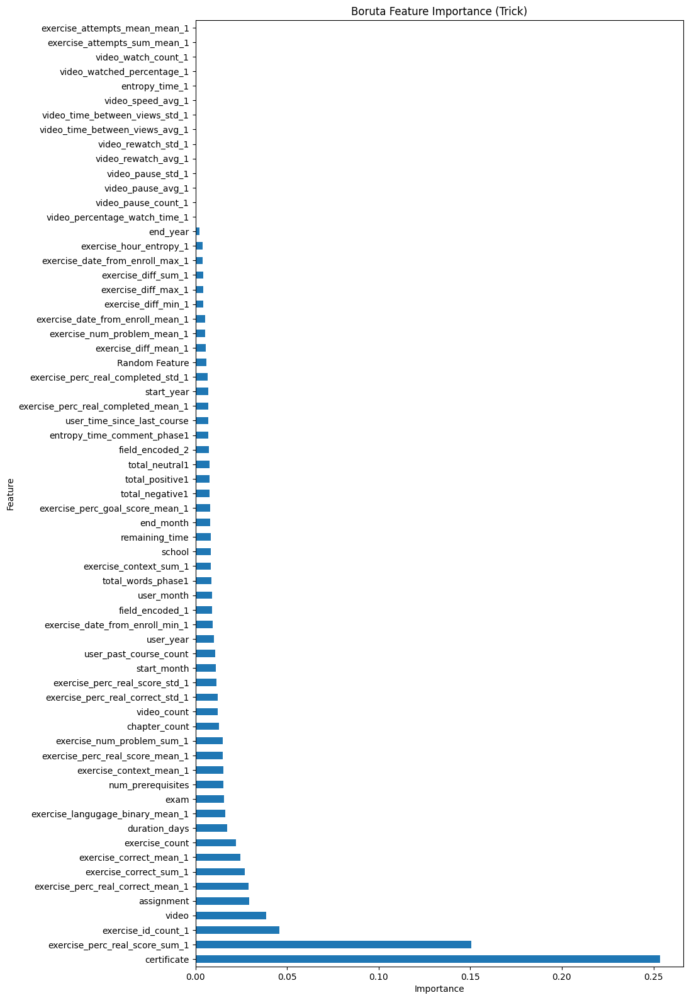

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Label: 0 --> Weight: 0.3042
Label: 1 --> Weight: 0.6998
Label: 2 --> Weight: 7.4330
Label: 3 --> Weight: 7.4330
Label: 4 --> Weight: 68.3840
Results saved as test_results_minmax_f1_macro_phase2.csv
----------Results for phase: phase2--------------

--- Train Metrics ---
F1 Score (per class): [0.78795015 0.60915999 0.34874759 0.43722944 0.62162162]
Precision (per class): [0.8783636  0.61129431 0.2240099  0.29106628 0.46938776]
Recall (per class): [0.71441281 0.60704052 0.78695652 0.87826087 0.92      ]
Accuracy: 0.6907
AUC (One-vs-Rest): 0.9134

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.71      0.79      5620
           D       0.61      0.61      0.61      2443
           C       0.22      0.79      0.35       230
           B       

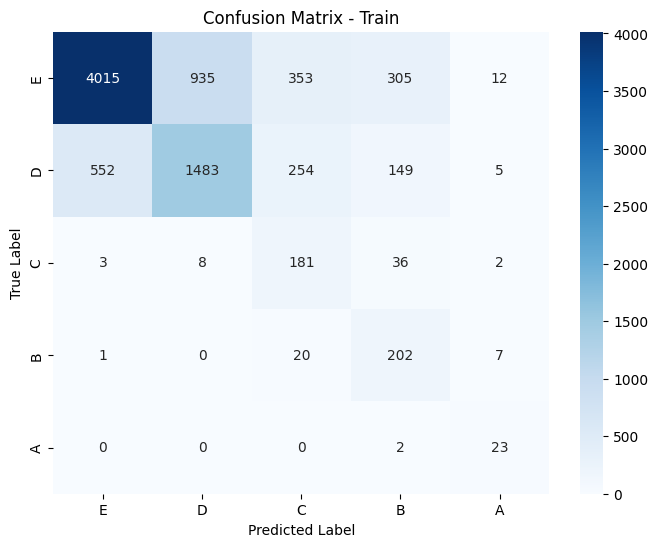

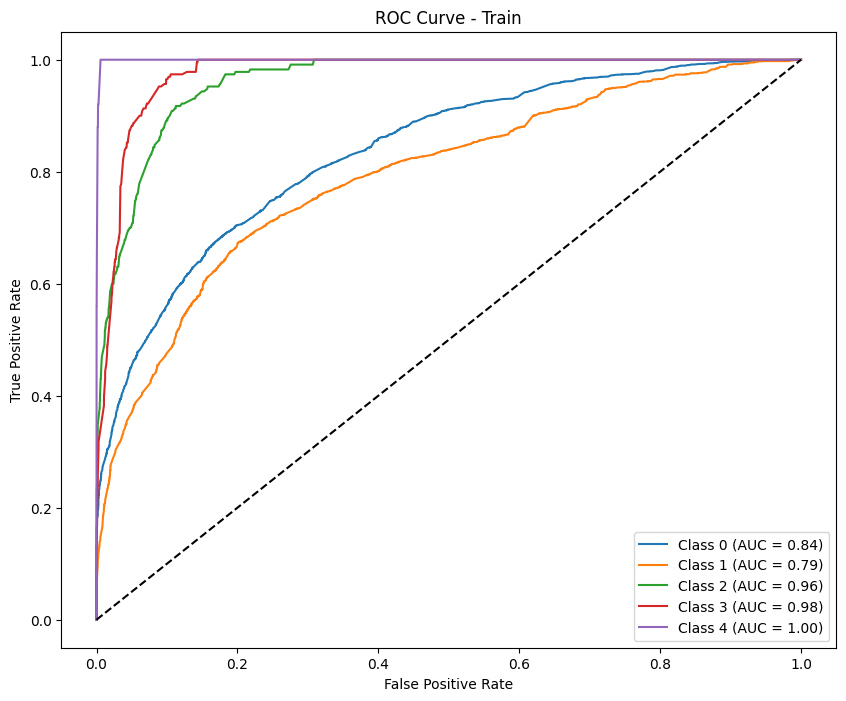


--- Test Metrics ---
F1 Score (per class): [0.8654311  0.26666667 0.         0.03076923 0.        ]
Precision (per class): [0.84968354 0.34482759 0.         0.02       0.        ]
Recall (per class): [0.8817734  0.2173913  0.         0.06666667 0.        ]
Accuracy: 0.7480
AUC (One-vs-Rest): 0.6801

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.88      0.87       609
           D       0.34      0.22      0.27        92
           C       0.00      0.00      0.00        20
           B       0.02      0.07      0.03        15
           A       0.00      0.00      0.00        10

    accuracy                           0.75       746
   macro avg       0.24      0.23      0.23       746
weighted avg       0.74      0.75      0.74       746



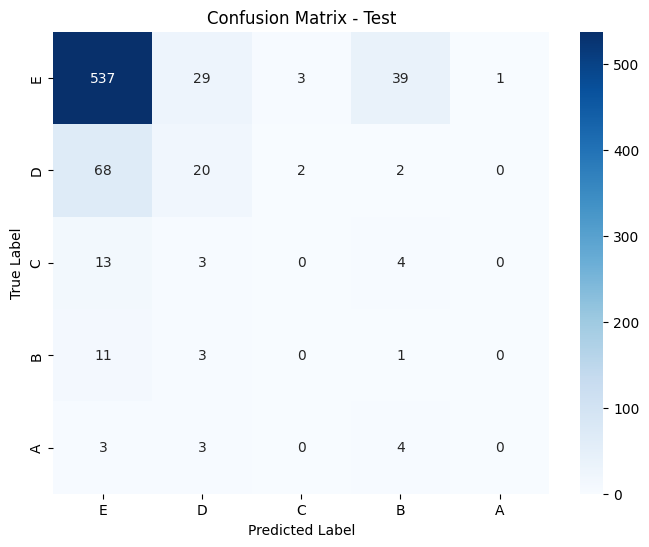

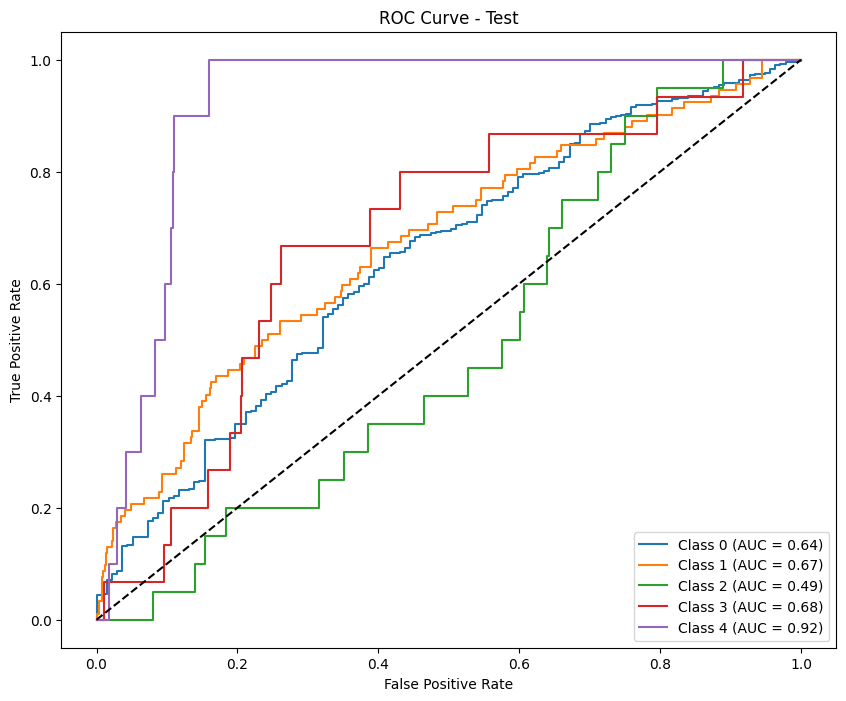

Results saved as test_results_calibrate_minmax_f1_macro_phase2.csv
-------------Results for calibrate phase: phase2---------------

--- Train Metrics ---
F1 Score (per class): [0.83837797 0.56118036 0.52609603 0.5        0.68656716]
Precision (per class): [0.78505979 0.74126344 0.5060241  0.42424242 0.54761905]
Recall (per class): [0.89946619 0.45149406 0.54782609 0.60869565 0.92      ]
Accuracy: 0.7542
AUC (One-vs-Rest): 0.9230

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      5620
           D       0.74      0.45      0.56      2443
           C       0.51      0.55      0.53       230
           B       0.42      0.61      0.50       230
           A       0.55      0.92      0.69        25

    accuracy                           0.75      8548
   macro avg       0.60      0.69      0.62      8548
weighted avg       0.75      0.75      0.74      8548



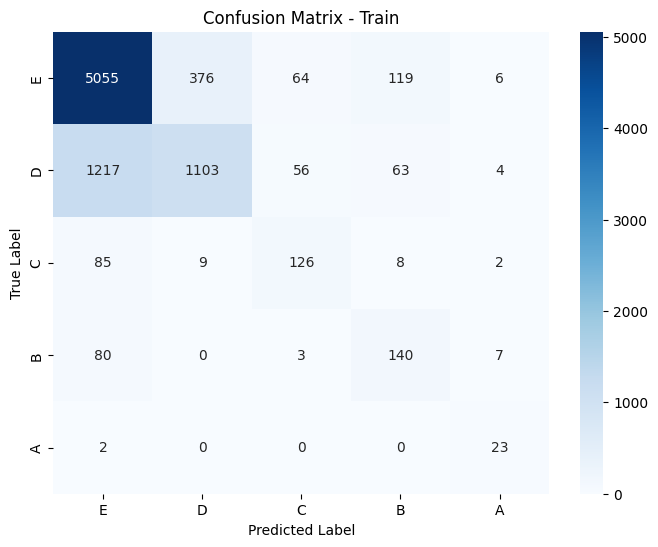

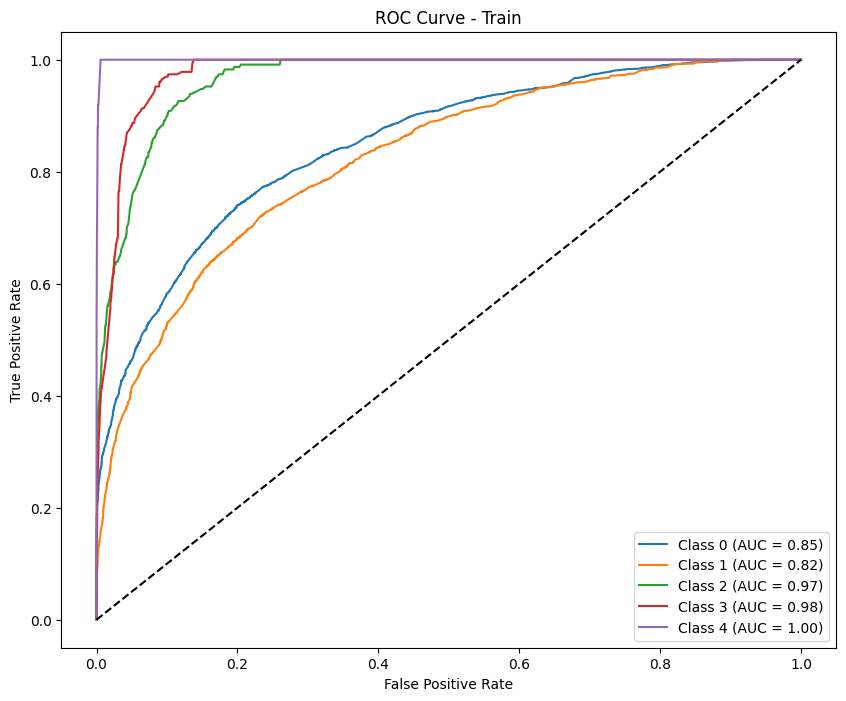

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.892261   0.17699115 0.         0.06451613 0.        ]
Precision (per class): [0.82933709 0.47619048 0.         0.0625     0.        ]
Recall (per class): [0.96551724 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.8029
AUC (One-vs-Rest): 0.6680

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       609
           D       0.48      0.11      0.18        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.80       746
   macro avg       0.27      0.23      0.23       746
weighted avg       0.74      0.80      0.75       746



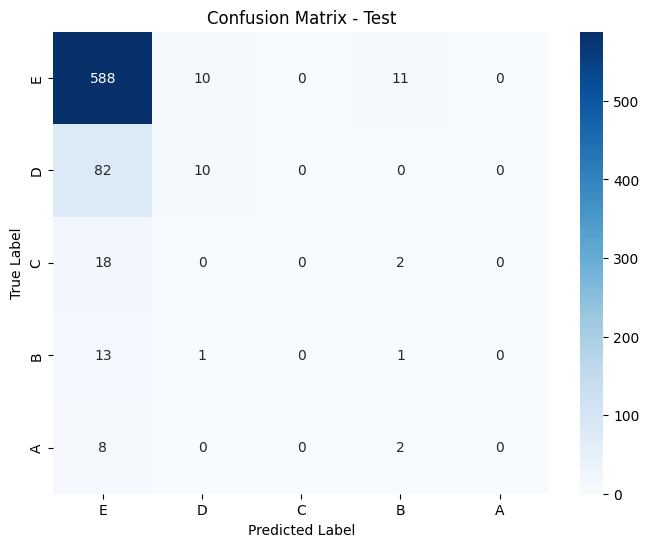

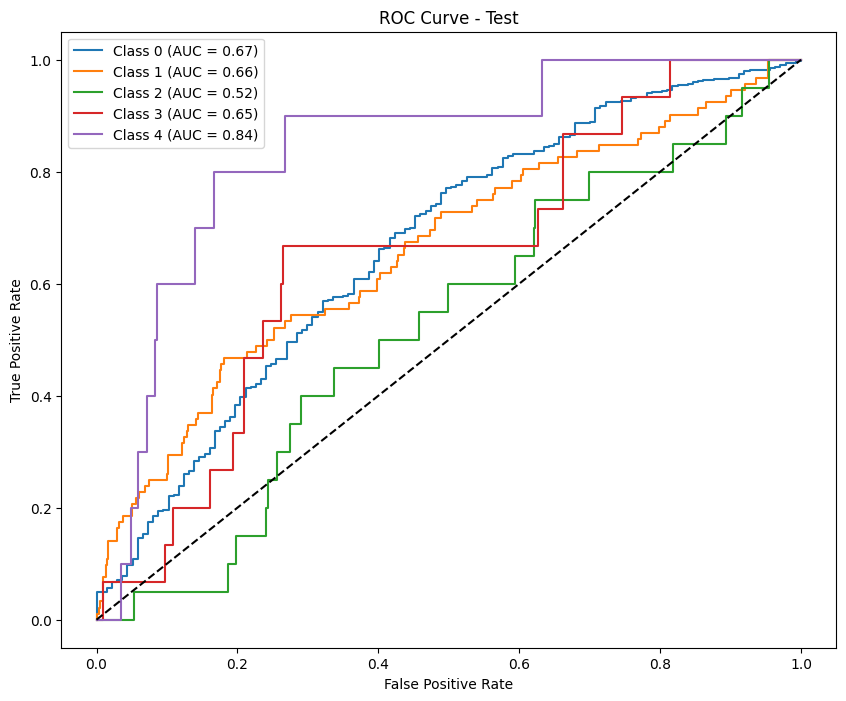


-------------Permutation Importance for phase: phase2---------


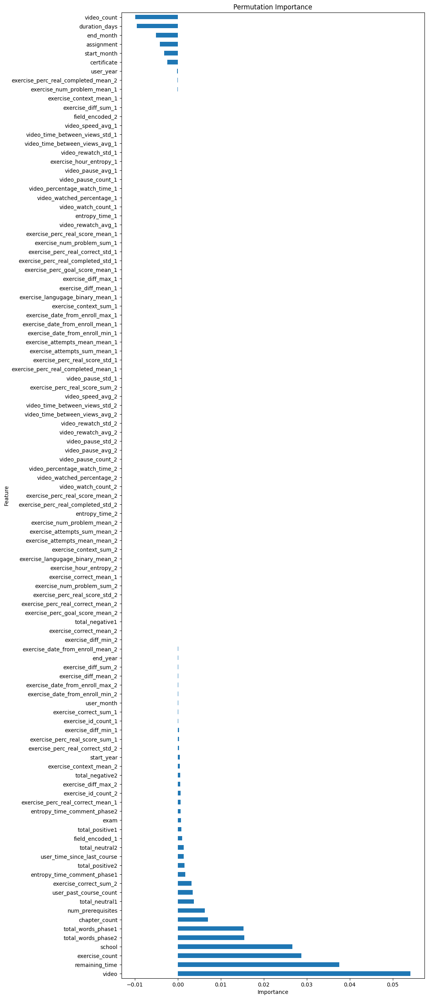

                Feature  Importance
17                video    0.054165
20       remaining_time    0.037597
10       exercise_count    0.028793
0                school    0.026658
103  total_words_phase2    0.015428
..                  ...         ...
4           start_month   -0.003203
16           assignment   -0.004182
6             end_month   -0.005104
19        duration_days   -0.009564
9           video_count   -0.009944

[107 rows x 2 columns]

-----------SHAP Feature Importance for phase: phase2------------


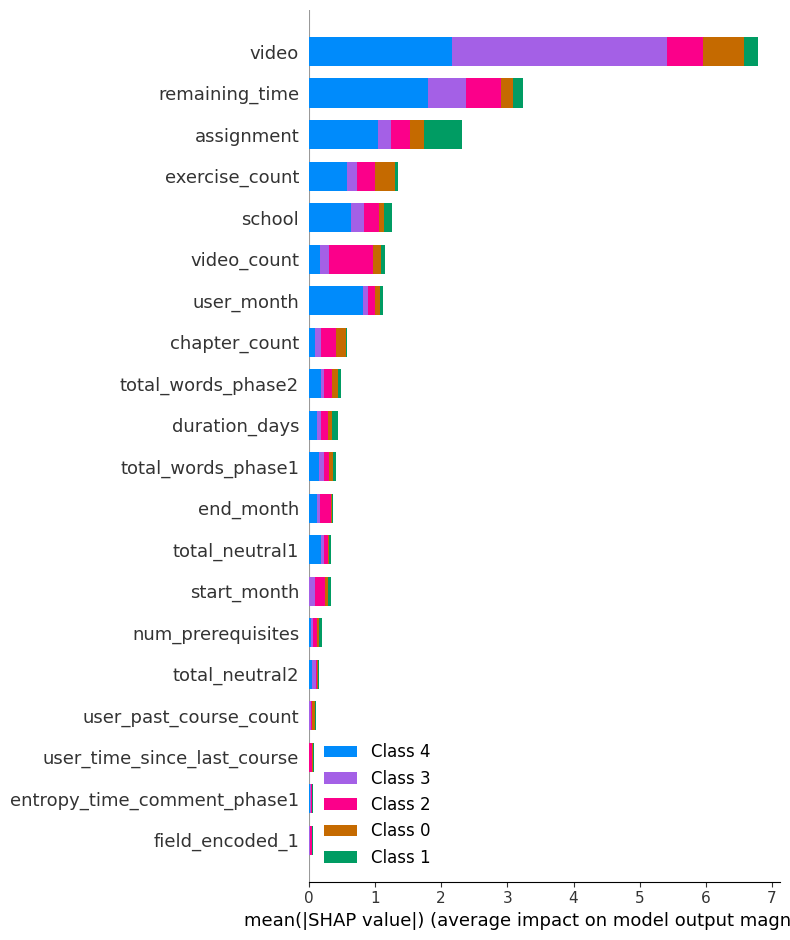


-----Lasso Feature Selection for phase: phase2----------


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7222294889879777, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8062741047765485, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8335539127488119, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8536040471449269, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8470164717773514, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.39004807902529137, tolerance: 0.32802856098274236
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7537903607608314, tolerance: 0.32

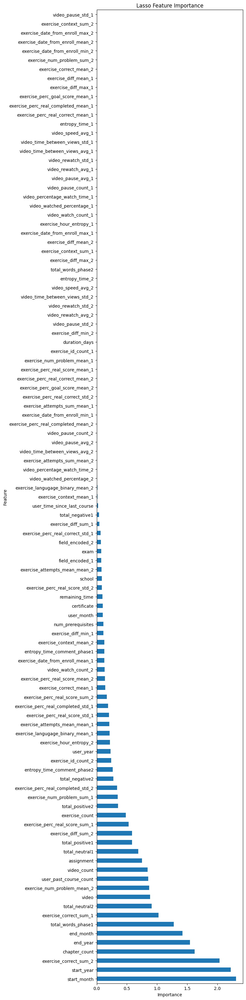

                             Feature  Importance
4                        start_month    2.305842
3                         start_year    2.217744
66            exercise_correct_sum_2    2.034287
11                     chapter_count    1.623914
5                           end_year    1.542653
..                               ...         ...
72   exercise_date_from_enroll_min_2    0.000000
73  exercise_date_from_enroll_mean_2    0.000000
74   exercise_date_from_enroll_max_2    0.000000
75            exercise_context_sum_2    0.000000
53                 video_pause_std_1    0.000000

[107 rows x 2 columns]

----------Boruta Trick: phase2----------
Feature Importance (Including Random Feature):
                                Feature  Importance
15                          certificate    0.146983
17                                video    0.042886
16                           assignment    0.031460
40  exercise_perc_real_completed_mean_1    0.030493
66               exercise_correct_sum_2

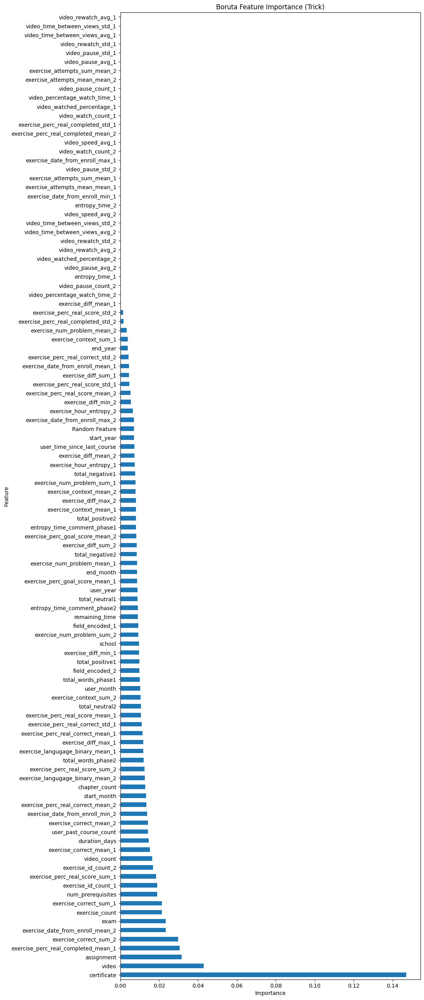

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Label: 0 --> Weight: 0.3046
Label: 1 --> Weight: 0.6905
Label: 2 --> Weight: 8.0860
Label: 3 --> Weight: 7.5391
Label: 4 --> Weight: 82.1368
Results saved as test_results_minmax_f1_macro_phase3.csv
----------Results for phase: phase3--------------

--- Train Metrics ---
F1 Score (per class): [0.79982973 0.62068966 0.35227273 0.41388175 0.44705882]
Precision (per class): [0.87947578 0.62828649 0.22561863 0.28196147 0.28787879]
Recall (per class): [0.7334114  0.61327434 0.80310881 0.77777778 1.        ]
Accuracy: 0.7022
AUC (One-vs-Rest): 0.9196

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.73      0.80      5124
           D       0.63      0.61      0.62      2260
           C       0.23      0.80      0.35       193
           B       

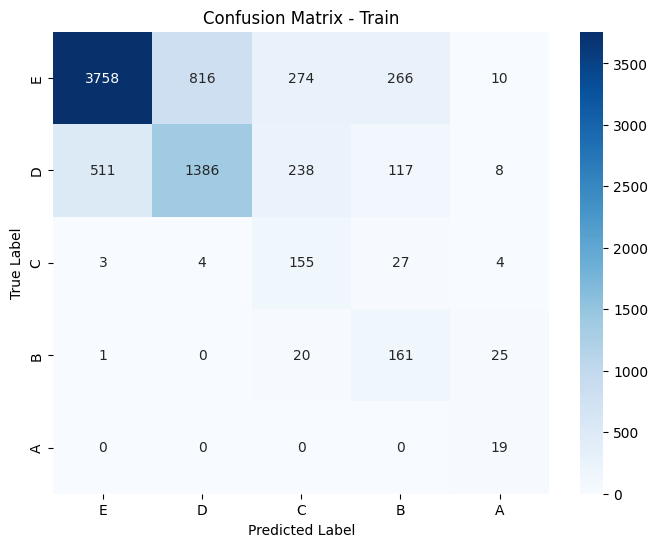

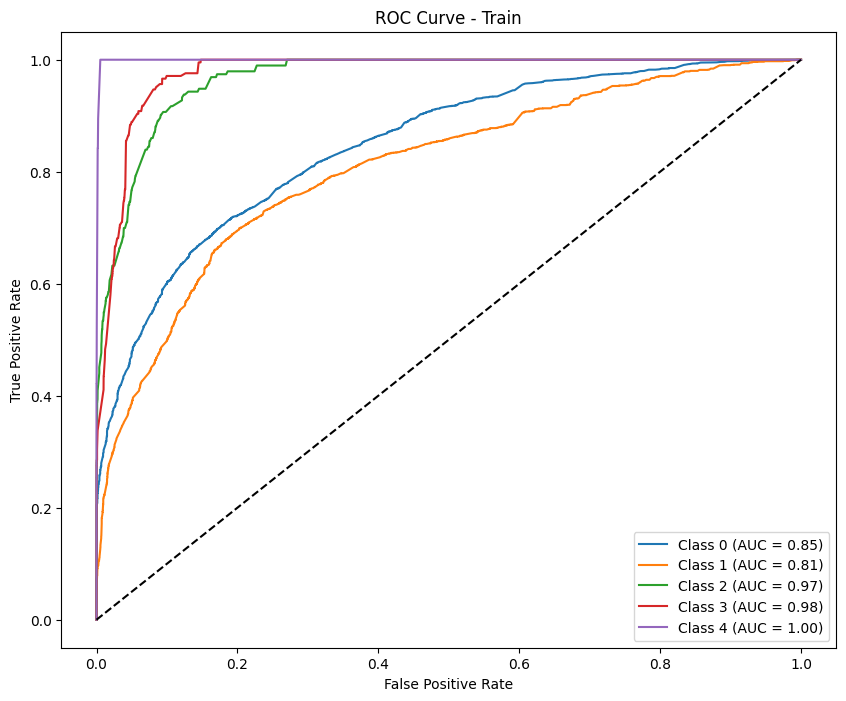

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.78144514 0.15957447 0.         0.04255319 0.        ]
Precision (per class): [0.8217636  0.14851485 0.         0.02564103 0.        ]
Recall (per class): [0.74489796 0.17241379 0.         0.125      0.        ]
Accuracy: 0.6311
AUC (One-vs-Rest): 0.6195

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.74      0.78       588
           D       0.15      0.17      0.16        87
           C       0.00      0.00      0.00        20
           B       0.03      0.12      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.63       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.63      0.66       721



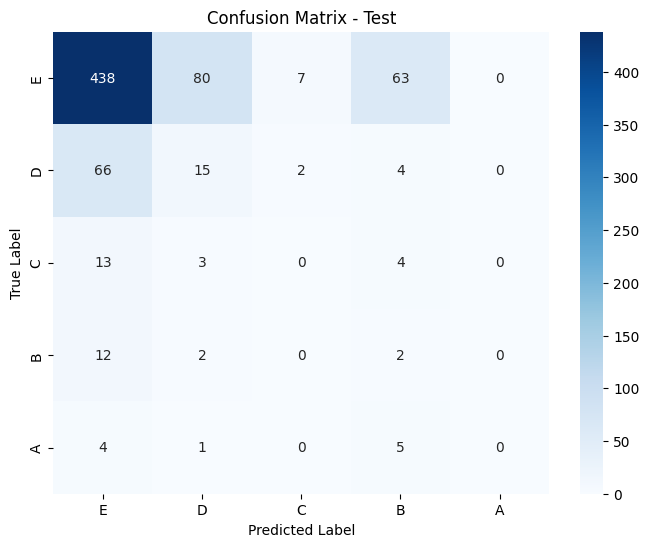

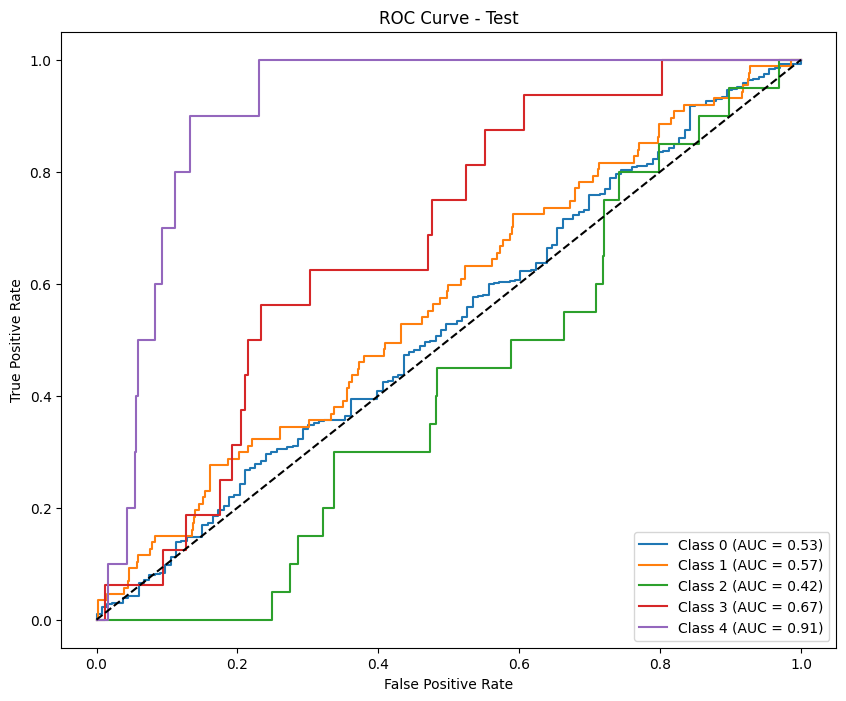

Results saved as test_results_calibrate_minmax_f1_macro_phase3.csv
-------------Results for calibrate phase: phase3---------------

--- Train Metrics ---
F1 Score (per class): [0.83941269 0.59465128 0.54320988 0.51881188 0.64150943]
Precision (per class): [0.79666959 0.72972973 0.51886792 0.43959732 0.5       ]
Recall (per class): [0.88700234 0.50176991 0.56994819 0.63285024 0.89473684]
Accuracy: 0.7609
AUC (One-vs-Rest): 0.9287

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.73      0.50      0.59      2260
           C       0.52      0.57      0.54       193
           B       0.44      0.63      0.52       207
           A       0.50      0.89      0.64        19

    accuracy                           0.76      7803
   macro avg       0.60      0.70      0.63      7803
weighted avg       0.76      0.76      0.75      7803



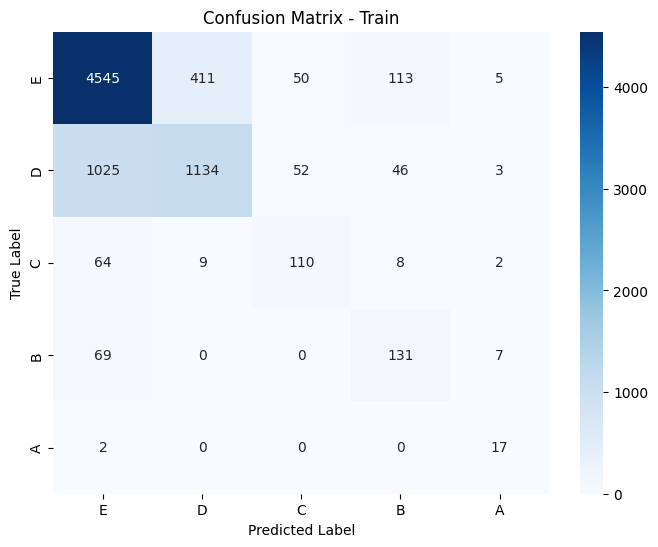

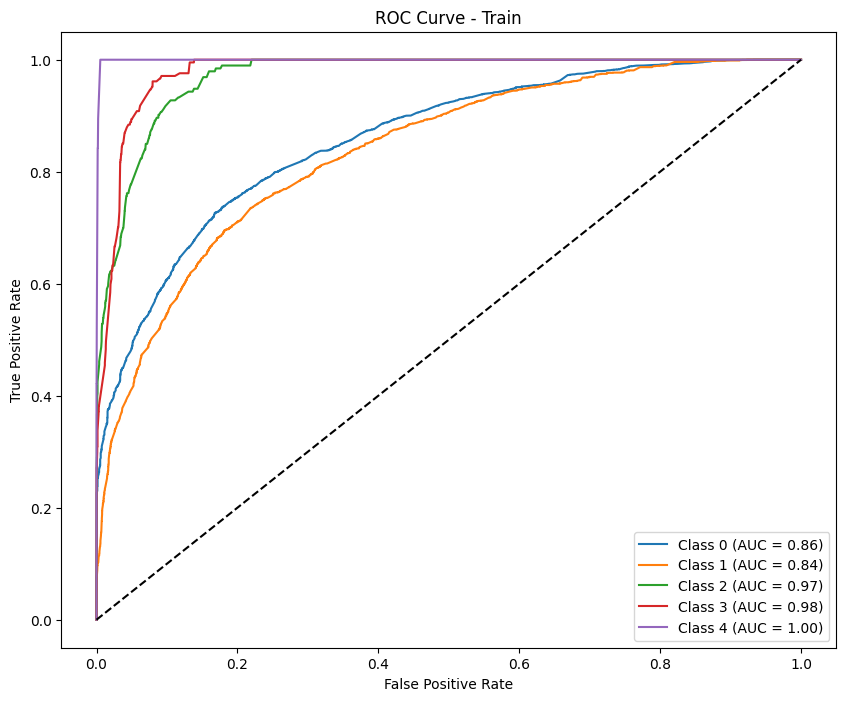

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.86977492 0.09677419 0.         0.04545455 0.        ]
Precision (per class): [0.82469512 0.16216216 0.         0.03571429 0.        ]
Recall (per class): [0.92006803 0.06896552 0.         0.0625     0.        ]
Accuracy: 0.7601
AUC (One-vs-Rest): 0.6057

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.92      0.87       588
           D       0.16      0.07      0.10        87
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.76       721
   macro avg       0.20      0.21      0.20       721
weighted avg       0.69      0.76      0.72       721



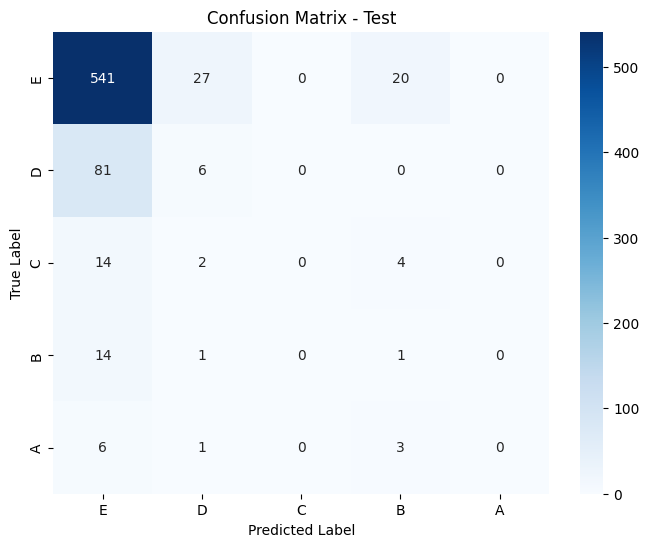

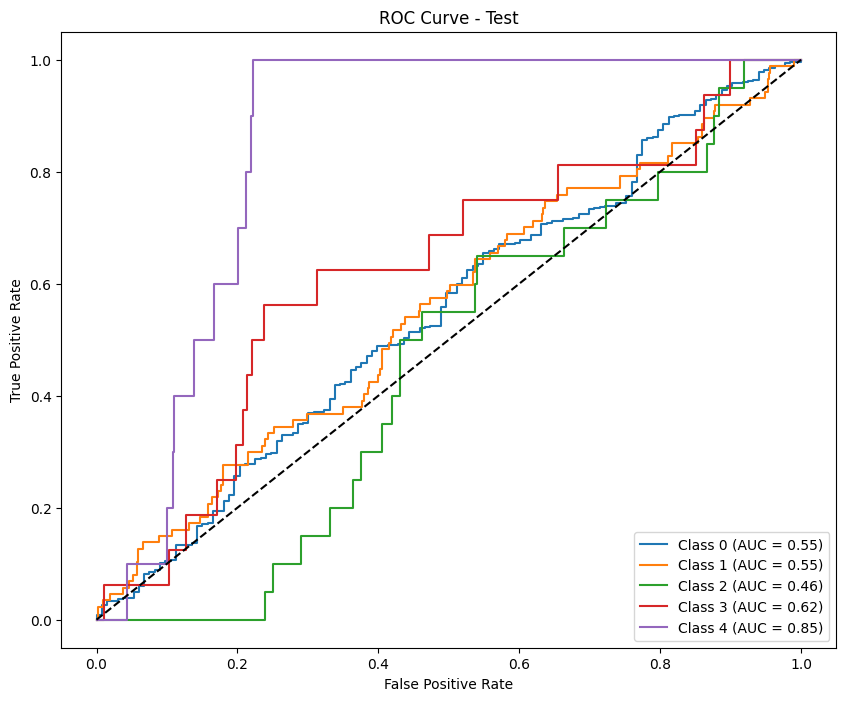

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Label: 0 --> Weight: 0.3058
Label: 1 --> Weight: 0.6780
Label: 2 --> Weight: 10.6198
Label: 3 --> Weight: 6.7459
Label: 4 --> Weight: 76.6143
Results saved as test_results_minmax_f1_macro_phase4.csv
----------Results for phase: phase4--------------

--- Train Metrics ---
F1 Score (per class): [0.81762546 0.66413662 0.37826087 0.52571429 0.65116279]
Precision (per class): [0.88213932 0.66455696 0.24233983 0.37704918 0.48275862]
Recall (per class): [0.76190476 0.66371681 0.86138614 0.86792453 1.        ]
Accuracy: 0.7386
AUC (One-vs-Rest): 0.9326

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.76      0.82      3507
           D       0.66      0.66      0.66      1582
           C       0.24      0.86      0.38       101
           B      

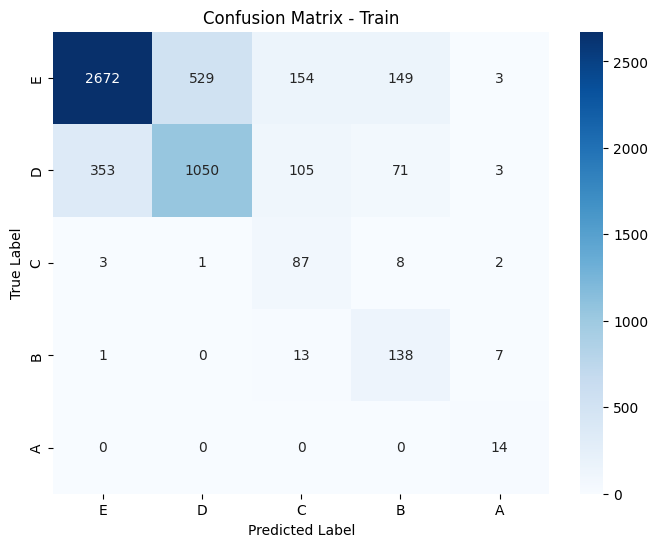

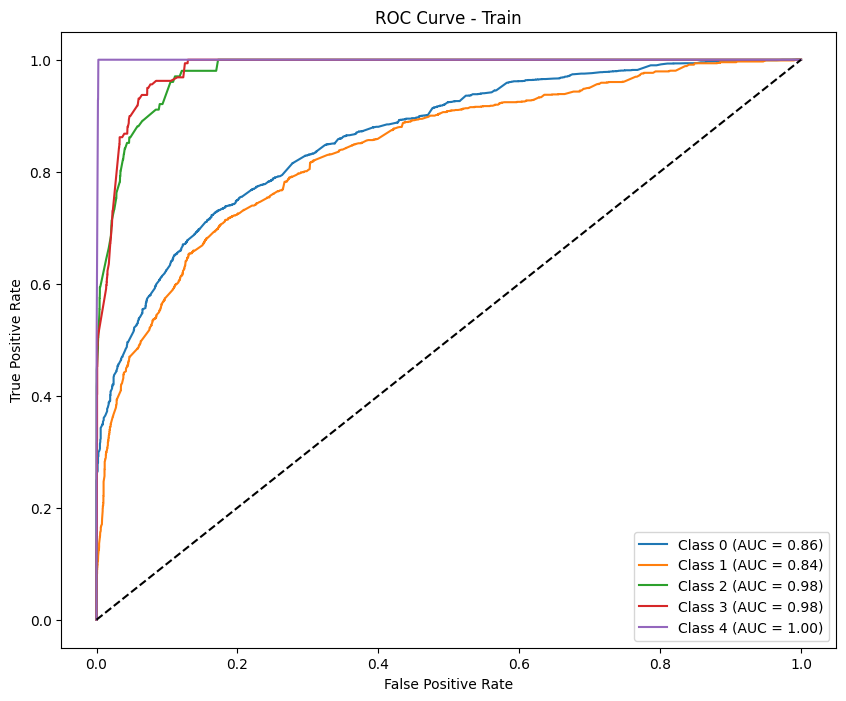

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.75894539 0.11299435 0.         0.04040404 0.        ]
Precision (per class): [0.79487179 0.10869565 0.         0.02469136 0.        ]
Recall (per class): [0.72612613 0.11764706 0.         0.11111111 0.        ]
Accuracy: 0.6041
AUC (One-vs-Rest): 0.5454

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.73      0.76       555
           D       0.11      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.02      0.11      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.60       687
   macro avg       0.19      0.19      0.18       687
weighted avg       0.66      0.60      0.63       687



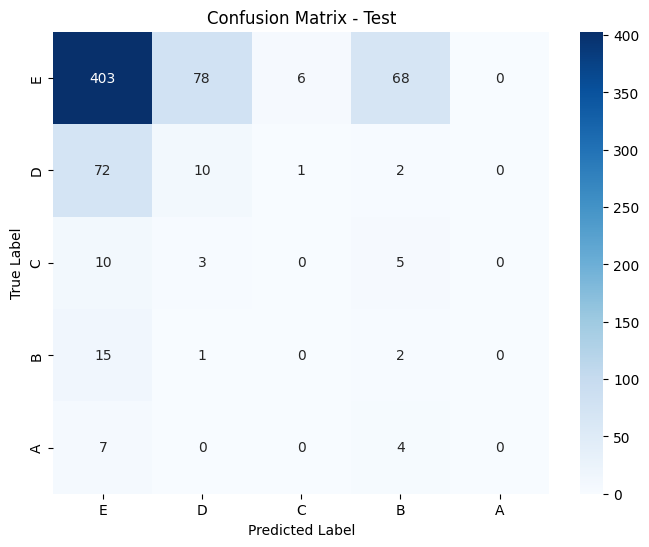

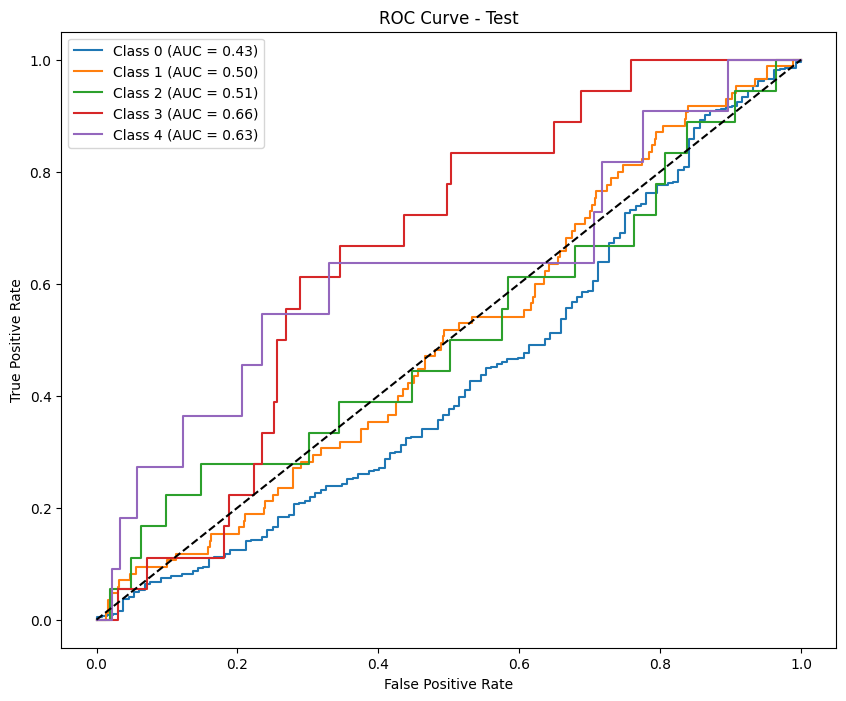

Results saved as test_results_calibrate_minmax_f1_macro_phase4.csv
-------------Results for calibrate phase: phase4---------------

--- Train Metrics ---
F1 Score (per class): [0.8556179  0.63727306 0.59907834 0.59002169 0.66666667]
Precision (per class): [0.82263158 0.76991943 0.56034483 0.45033113 0.5       ]
Recall (per class): [0.89136014 0.54361568 0.64356436 0.85534591 1.        ]
Accuracy: 0.7833
AUC (One-vs-Rest): 0.9400

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.89      0.86      3507
           D       0.77      0.54      0.64      1582
           C       0.56      0.64      0.60       101
           B       0.45      0.86      0.59       159
           A       0.50      1.00      0.67        14

    accuracy                           0.78      5363
   macro avg       0.62      0.79      0.67      5363
weighted avg       0.79      0.78      0.78      5363



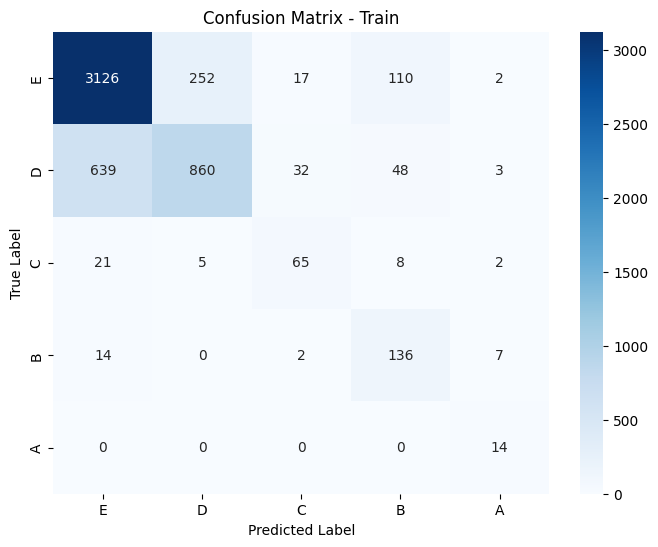

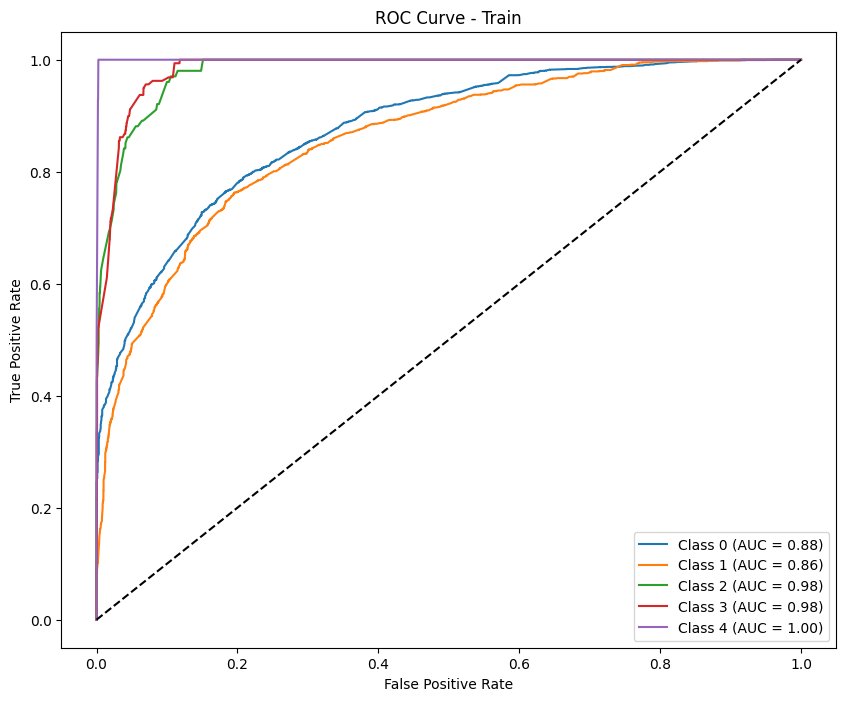

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.85884354 0.1        0.         0.04166667 0.        ]
Precision (per class): [0.81320451 0.17142857 0.         0.03333333 0.        ]
Recall (per class): [0.90990991 0.07058824 0.         0.05555556 0.        ]
Accuracy: 0.7453
AUC (One-vs-Rest): 0.5810

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.91      0.86       555
           D       0.17      0.07      0.10        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.75       687
   macro avg       0.20      0.21      0.20       687
weighted avg       0.68      0.75      0.71       687



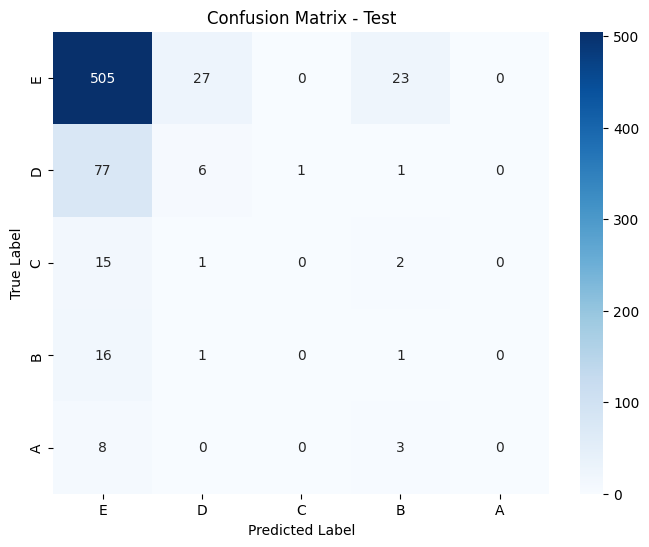

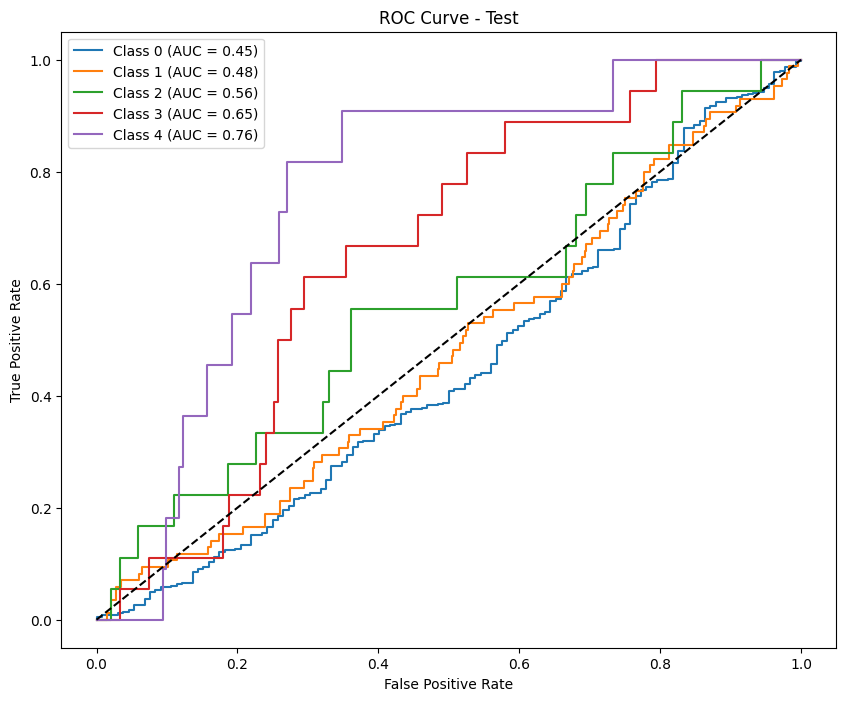

In [32]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, scale='minmax', metric='f1_macro')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

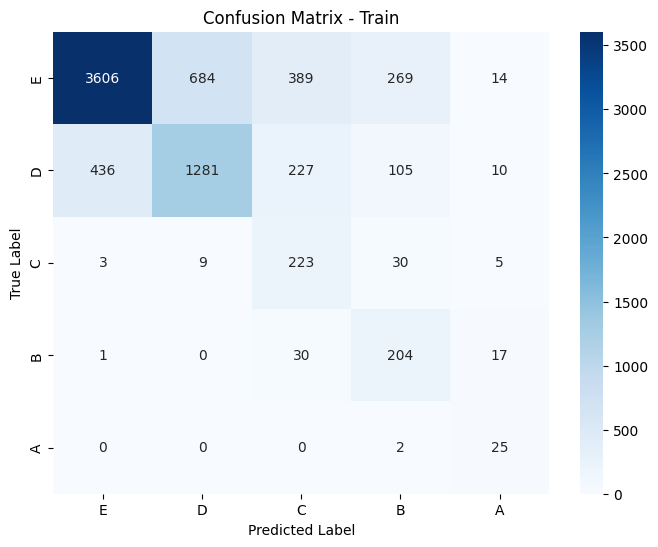

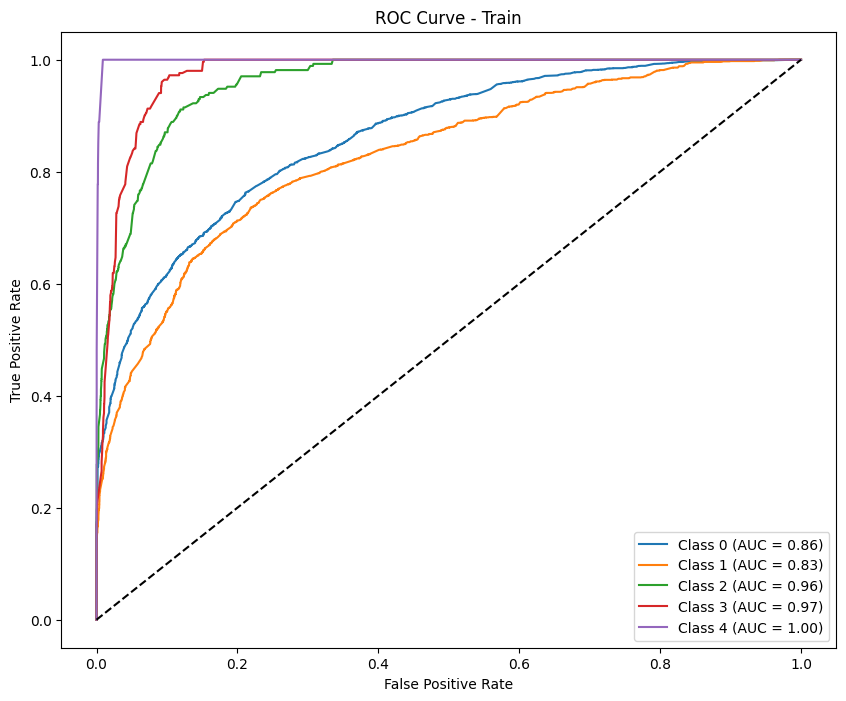

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90793651 0.46242775 0.         0.04761905 0.        ]
Precision (per class): [0.88819876 0.50632911 0.         0.03846154 0.        ]
Recall (per class): [0.92857143 0.42553191 0.         0.0625     0.        ]
Accuracy: 0.8108
AUC (One-vs-Rest): 0.7881

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.93      0.91       616
           D       0.51      0.43      0.46        94
           C       0.00      0.00      0.00        20
           B       0.04      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.81       756
   macro avg       0.29      0.28      0.28       756
weighted avg       0.79      0.81      0.80       756



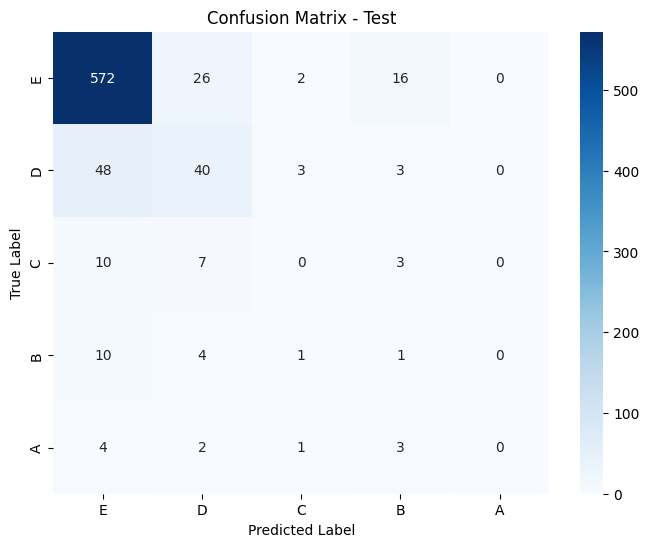

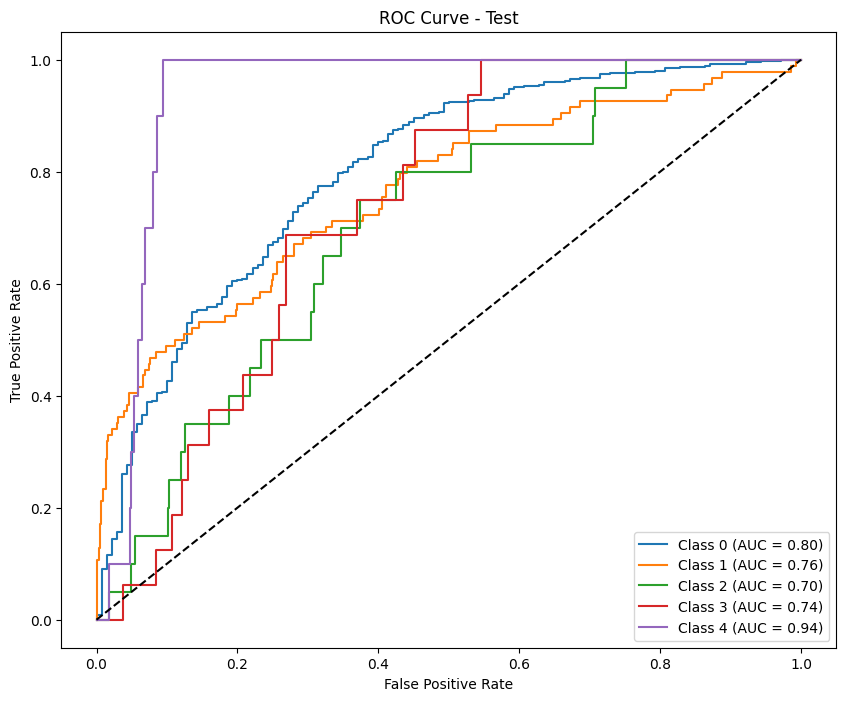

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.8470722  0.60527859 0.54478976 0.54609929 0.67692308]
Precision (per class): [0.79935622 0.76387861 0.53790614 0.49358974 0.57894737]
Recall (per class): [0.90084643 0.50121418 0.55185185 0.61111111 0.81481481]
Accuracy: 0.7697
AUC (One-vs-Rest): 0.9331

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.90      0.85      4962
           D       0.76      0.50      0.61      2059
           C       0.54      0.55      0.54       270
           B       0.49      0.61      0.55       252
           A       0.58      0.81      0.68        27

    accuracy                           0.77      7570
   macro avg       0.63      0.68      0.64      7570
weighted avg       0.77      0.77      0.76      7570



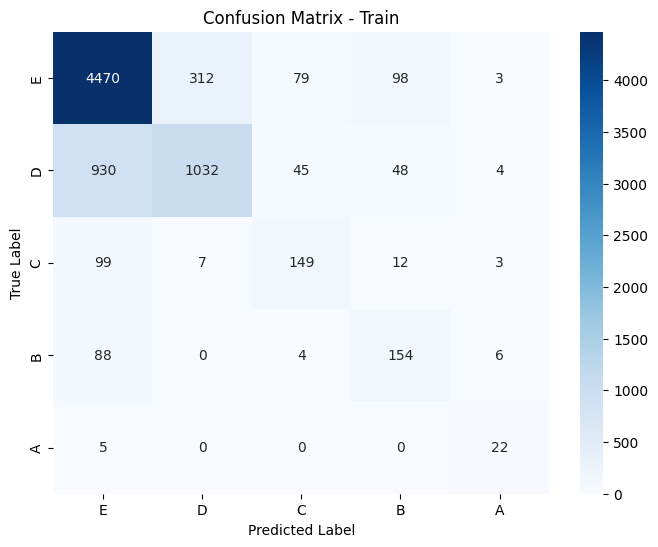

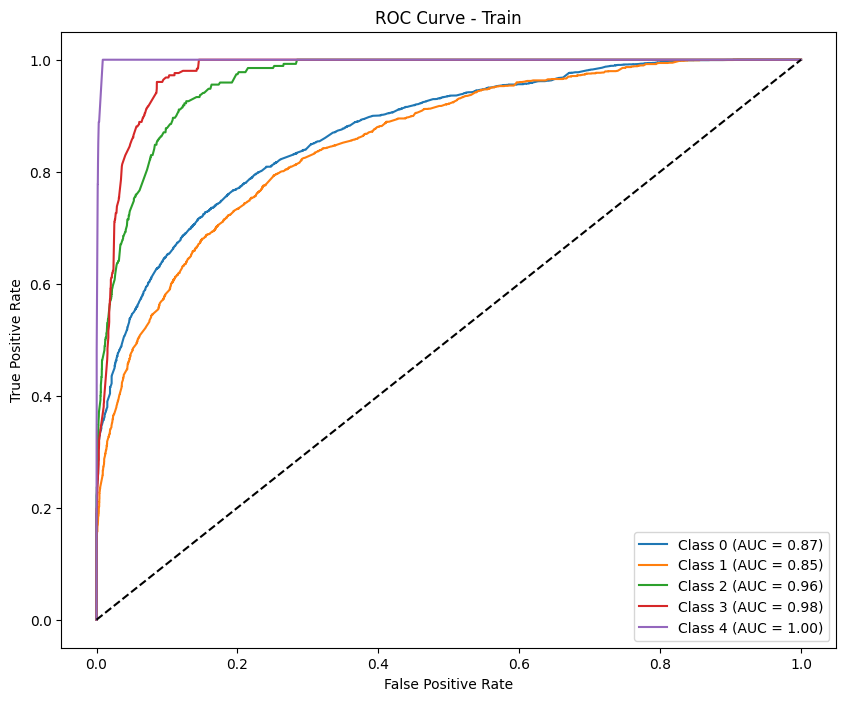

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.91641337 0.43971631 0.         0.         0.        ]
Precision (per class): [0.86142857 0.65957447 0.         0.         0.        ]
Recall (per class): [0.9788961  0.32978723 0.         0.         0.        ]
Accuracy: 0.8386
AUC (One-vs-Rest): 0.7701

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.98      0.92       616
           D       0.66      0.33      0.44        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.30      0.26      0.27       756
weighted avg       0.78      0.84      0.80       756



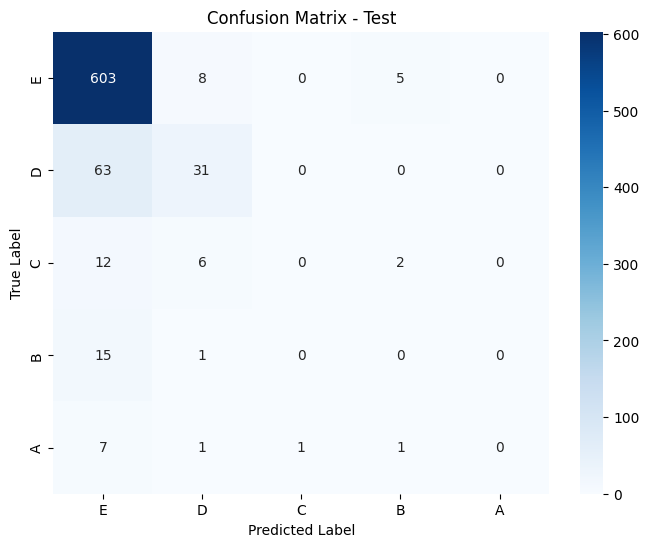

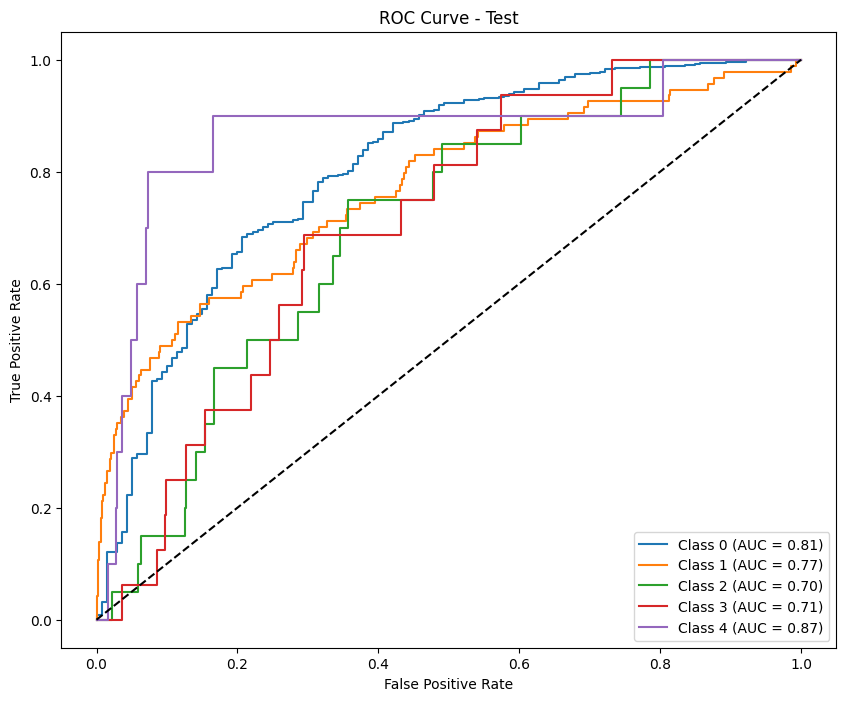


Permutation Importance for phase: phase1


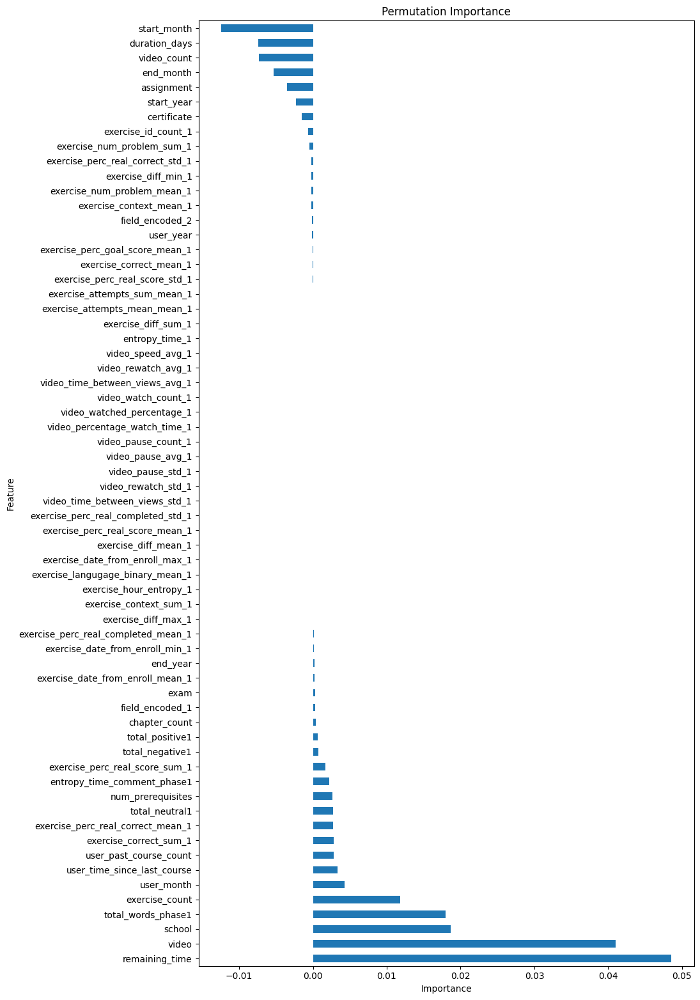

               Feature  Importance
20      remaining_time    0.048563
17               video    0.040984
0               school    0.018676
60  total_words_phase1    0.017966
10      exercise_count    0.011790
..                 ...         ...
16          assignment   -0.003501
6            end_month   -0.005317
9          video_count   -0.007282
19       duration_days   -0.007431
4          start_month   -0.012450

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.4866524657550144, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8947394510018967, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.0792705516555543, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.319121742894822, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4175320688627835, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5108056997405583, tolerance: 0.3382939894319696
Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4781083767766177, tolerance: 0.3382939894

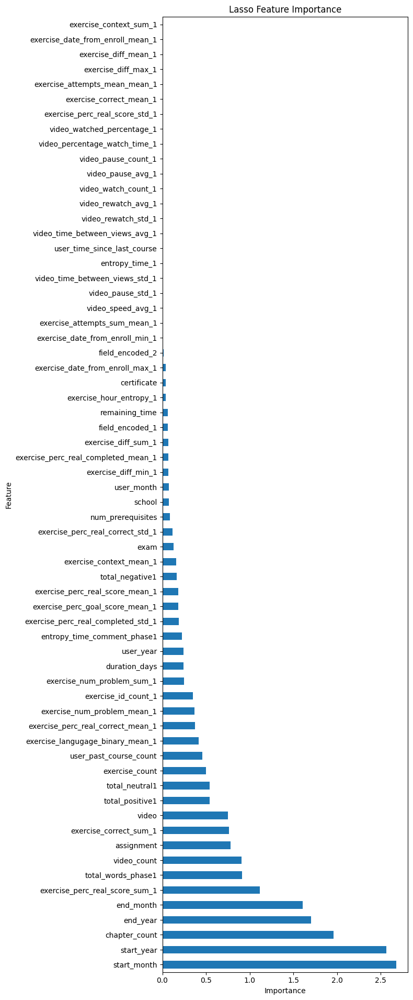

                             Feature  Importance
4                        start_month    2.676725
3                         start_year    2.562448
11                     chapter_count    1.958588
5                           end_year    1.701382
6                          end_month    1.608604
..                               ...         ...
28     exercise_attempts_mean_mean_1    0.000000
38               exercise_diff_max_1    0.000000
36              exercise_diff_mean_1    0.000000
30  exercise_date_from_enroll_mean_1    0.000000
32            exercise_context_sum_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
44     exercise_perc_real_score_sum_1    0.114071
15                        certificate    0.081750
24            exercise_correct_mean_1    0.062107
42  exercise_perc_real_correct_mean_1    0.058798
17                              video    0.047260
..                         

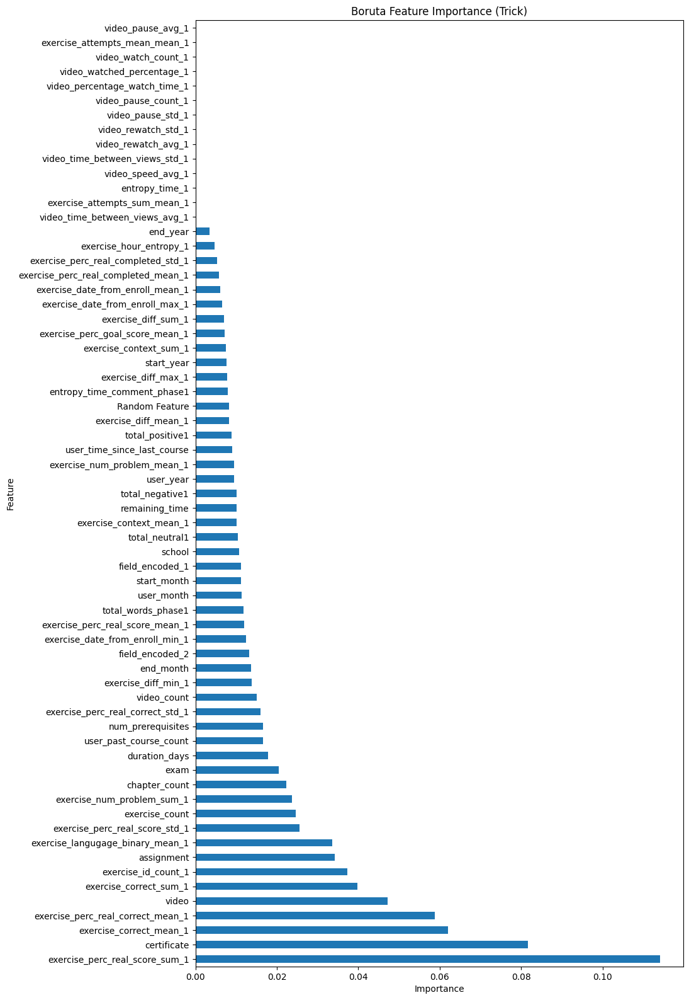

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.79510329 0.61860625 0.43726708 0.53092784 0.68656716]
Precision (per class): [0.89125214 0.61292517 0.30608696 0.37728938 0.54761905]
Recall (per class): [0.71767956 0.62439362 0.76521739 0.89565217 0.92      ]
Accuracy: 0.7037
AUC (One-vs-Rest): 0.9211

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.72      0.80      3620
           D       0.61      0.62      0.62      1443
           C       0.31      0.77      0.44       230
           B       0.38      0.90      0.53       230
           A       0.55      0.92      0.69        25

    accuracy                           0.70      5548
   macro 

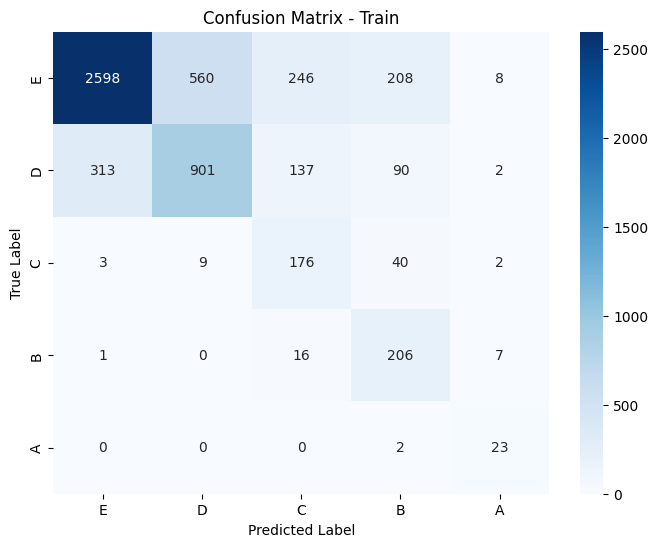

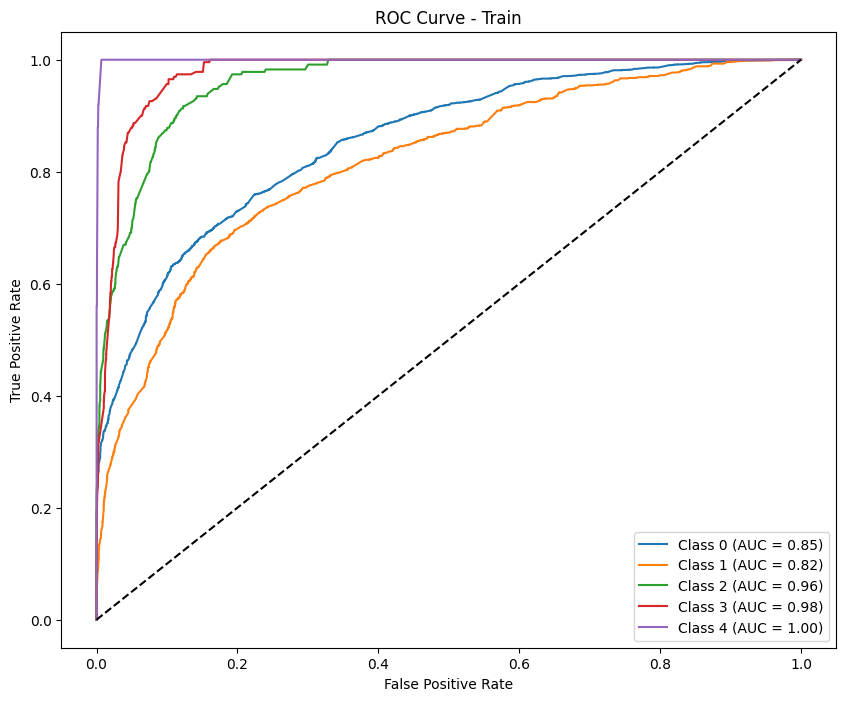


--- Test Metrics ---
F1 Score (per class): [0.83934426 0.20689655 0.         0.06666667 0.        ]
Precision (per class): [0.83797054 0.2195122  0.         0.04444444 0.        ]
Recall (per class): [0.8407225  0.19565217 0.         0.13333333 0.        ]
Accuracy: 0.7131
AUC (One-vs-Rest): 0.6467

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.84      0.84       609
           D       0.22      0.20      0.21        92
           C       0.00      0.00      0.00        20
           B       0.04      0.13      0.07        15
           A       0.00      0.00      0.00        10

    accuracy                           0.71       746
   macro avg       0.22      0.23      0.22       746
weighted avg       0.71      0.71      0.71       746



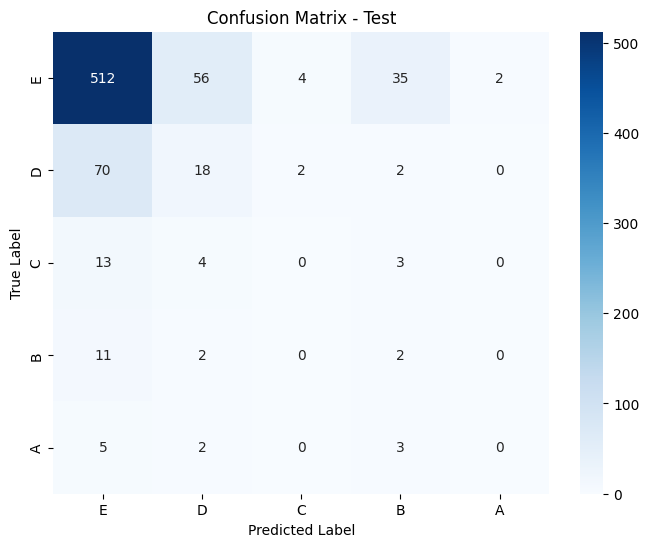

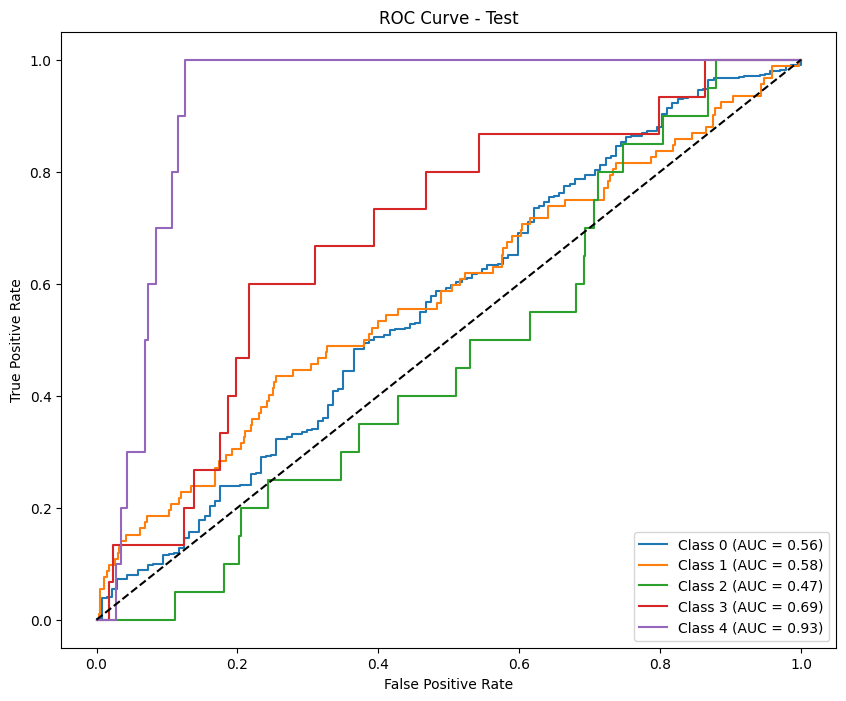

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.84203723 0.54840123 0.5518591  0.59920635 0.74193548]
Precision (per class): [0.79130224 0.7452381  0.50177936 0.55109489 0.62162162]
Recall (per class): [0.89972376 0.43381843 0.61304348 0.65652174 0.92      ]
Accuracy: 0.7567
AUC (One-vs-Rest): 0.9290

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      3620
           D       0.75      0.43      0.55      1443
           C       0.50      0.61      0.55       230
           B       0.55      0.66      0.60       230
           A       0.62      0.92      0.74        25

    accuracy                           0.76      5548
   macro avg       0.64      0.70      0.66      5548
weighted avg       0.76      0.76      0.74      5548



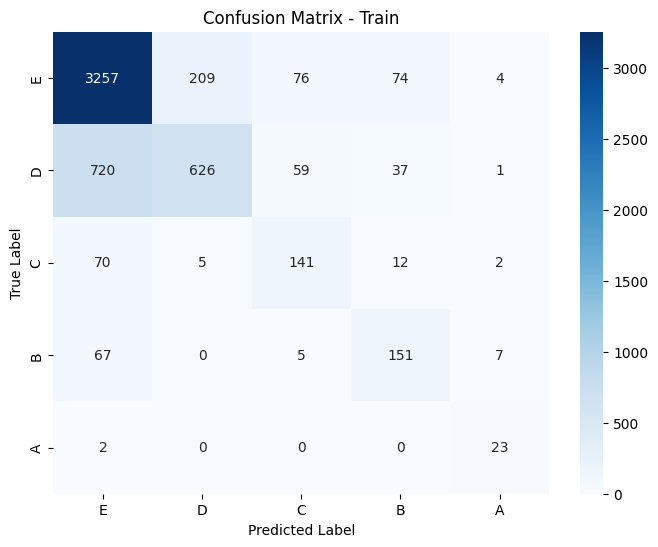

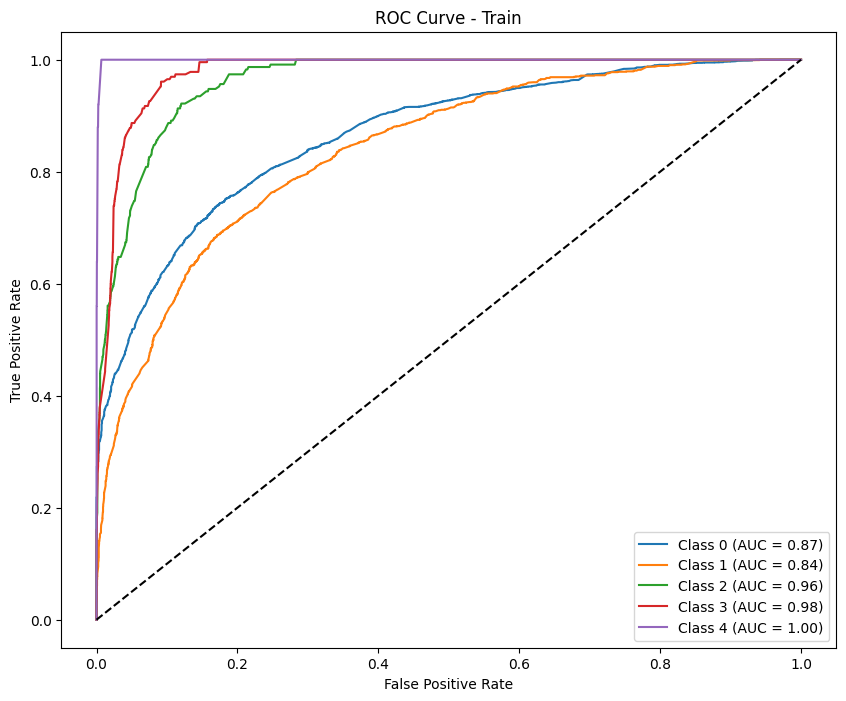

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.88803681 0.16       0.         0.06060606 0.        ]
Precision (per class): [0.83309353 0.3030303  0.         0.05555556 0.        ]
Recall (per class): [0.95073892 0.10869565 0.         0.06666667 0.        ]
Accuracy: 0.7909
AUC (One-vs-Rest): 0.6330

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.95      0.89       609
           D       0.30      0.11      0.16        92
           C       0.00      0.00      0.00        20
           B       0.06      0.07      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.79       746
   macro avg       0.24      0.23      0.22       746
weighted avg       0.72      0.79      0.75       746



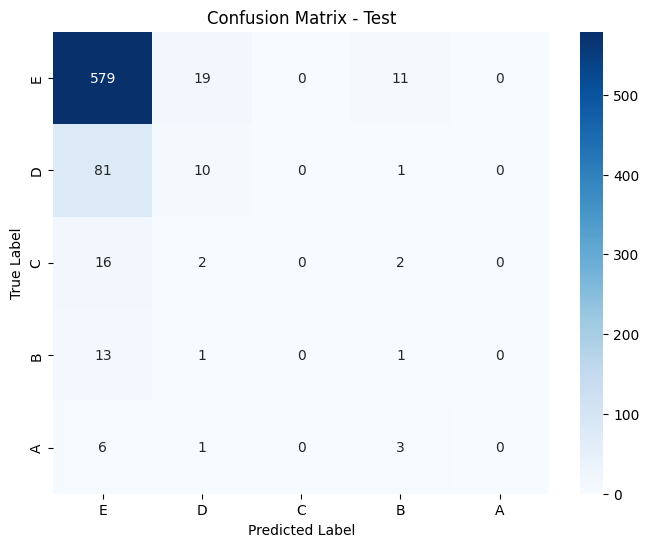

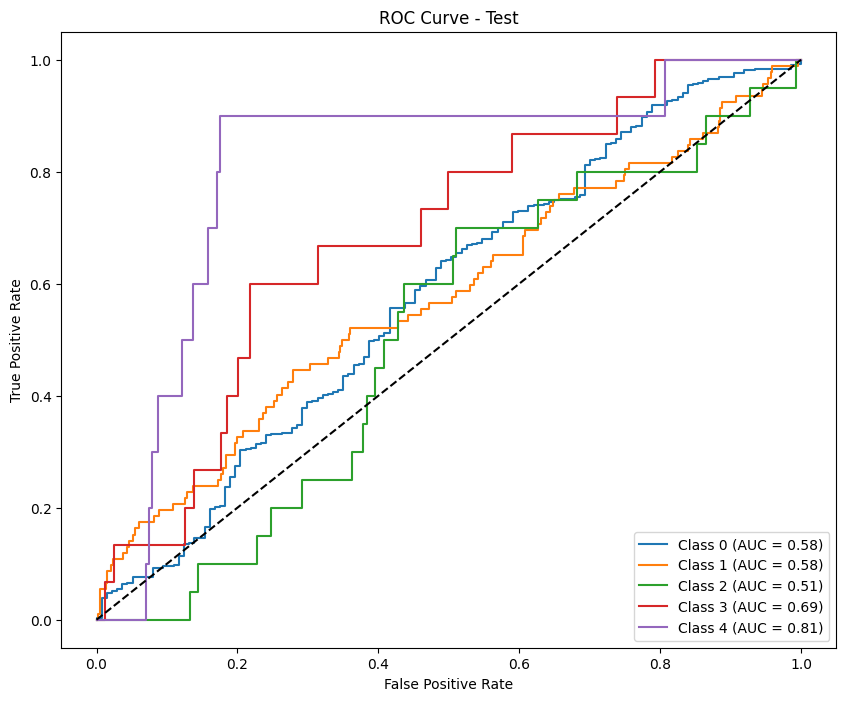


Permutation Importance for phase: phase2


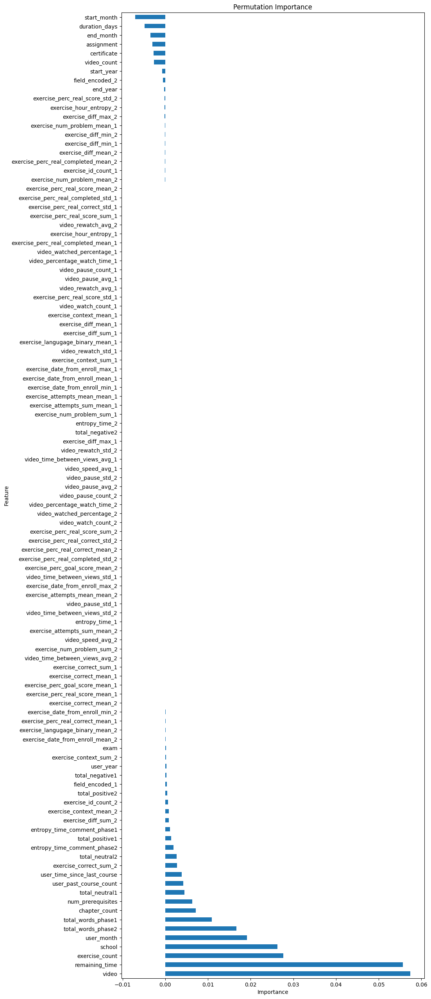

           Feature  Importance
17           video    0.057431
20  remaining_time    0.055651
10  exercise_count    0.027645
0           school    0.026316
8       user_month    0.019106
..             ...         ...
15     certificate   -0.002726
16      assignment   -0.002997
6        end_month   -0.003447
19   duration_days   -0.004822
4      start_month   -0.007052

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3619345029283068, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.073725283009935, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.616281025664648, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.940492641104811, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9780231018889936, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9593528818045343, tolerance: 0.28152467327625075
Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.4418544620784814, tolerance: 0.281524

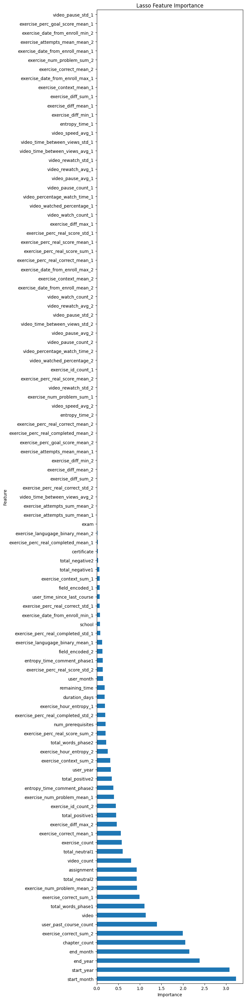

                             Feature  Importance
4                        start_month    3.226375
3                         start_year    3.081007
5                           end_year    2.385268
6                          end_month    2.147360
11                     chapter_count    2.050393
..                               ...         ...
30  exercise_date_from_enroll_mean_1    0.000000
71     exercise_attempts_mean_mean_2    0.000000
72   exercise_date_from_enroll_min_2    0.000000
39   exercise_perc_goal_score_mean_1    0.000000
53                 video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                            Feature  Importance
15                      certificate    0.159600
17                            video    0.046802
16                       assignment    0.032512
45  exercise_perc_real_score_mean_1    0.030469
66           exercise_correct_sum_2    0.029717
..                              ...   

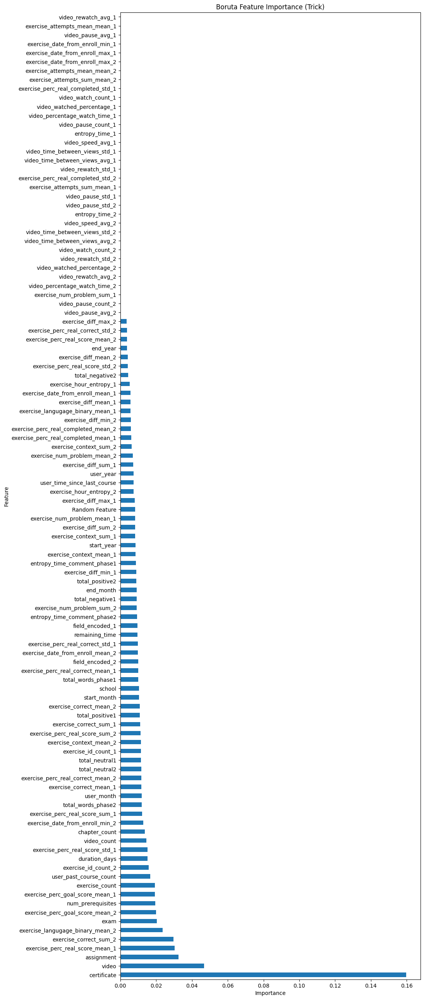

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.80533333 0.6459439  0.47588424 0.51242236 0.49350649]
Precision (per class): [0.90563774 0.61828737 0.34498834 0.37757437 0.32758621]
Recall (per class): [0.72503201 0.67619048 0.76683938 0.79710145 1.        ]
Accuracy: 0.7181
AUC (One-vs-Rest): 0.9296

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.73      0.81      3124
           D       0.62      0.68      0.65      1260
           C       0.34      0.77      0.48       193
           B       0.38      0.80      0.51       207
           A       0.33      1.00      0.49        19

    accuracy                           0.72      4803
   macro 

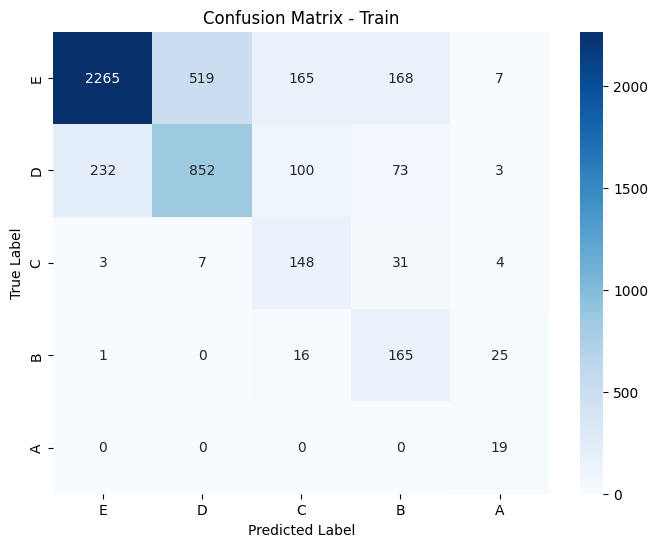

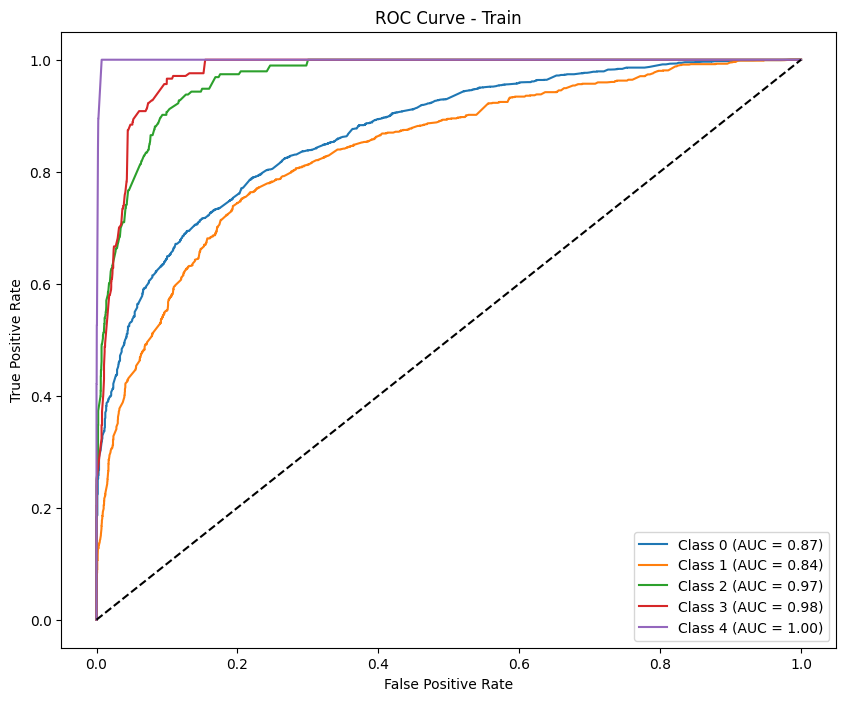


--- Test Metrics ---
F1 Score (per class): [0.73998136 0.20175439 0.         0.0625     0.        ]
Precision (per class): [0.8185567  0.16312057 0.         0.0375     0.        ]
Recall (per class): [0.67517007 0.26436782 0.         0.1875     0.        ]
Accuracy: 0.5867
AUC (One-vs-Rest): 0.6124

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.68      0.74       588
           D       0.16      0.26      0.20        87
           C       0.00      0.00      0.00        20
           B       0.04      0.19      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.59       721
   macro avg       0.20      0.23      0.20       721
weighted avg       0.69      0.59      0.63       721



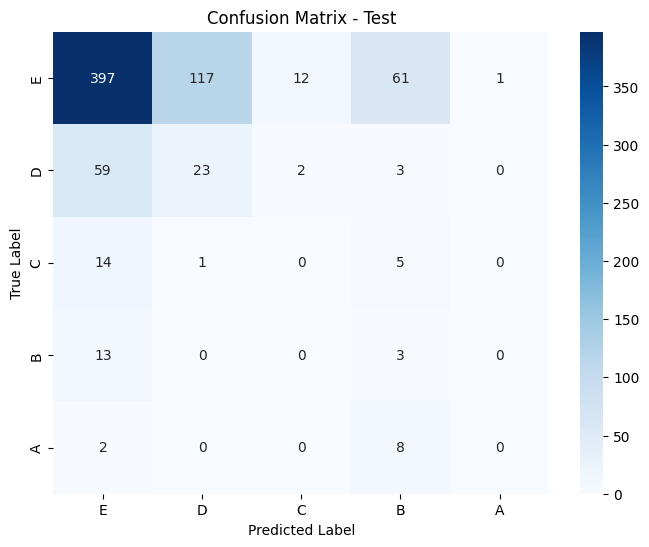

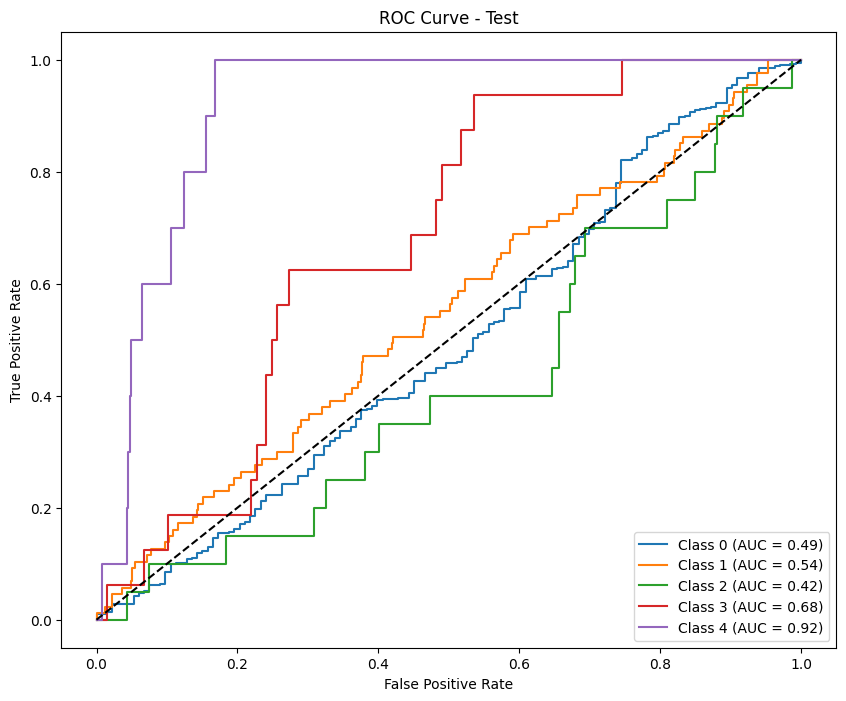

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.8525283  0.60769231 0.5955335  0.60444444 0.70833333]
Precision (per class): [0.80662668 0.77073171 0.57142857 0.55967078 0.5862069 ]
Recall (per class): [0.90396927 0.5015873  0.62176166 0.65700483 0.89473684]
Accuracy: 0.7764
AUC (One-vs-Rest): 0.9370

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.90      0.85      3124
           D       0.77      0.50      0.61      1260
           C       0.57      0.62      0.60       193
           B       0.56      0.66      0.60       207
           A       0.59      0.89      0.71        19

    accuracy                           0.78      4803
   macro avg       0.66      0.72      0.67      4803
weighted avg       0.78      0.78      0.77      4803



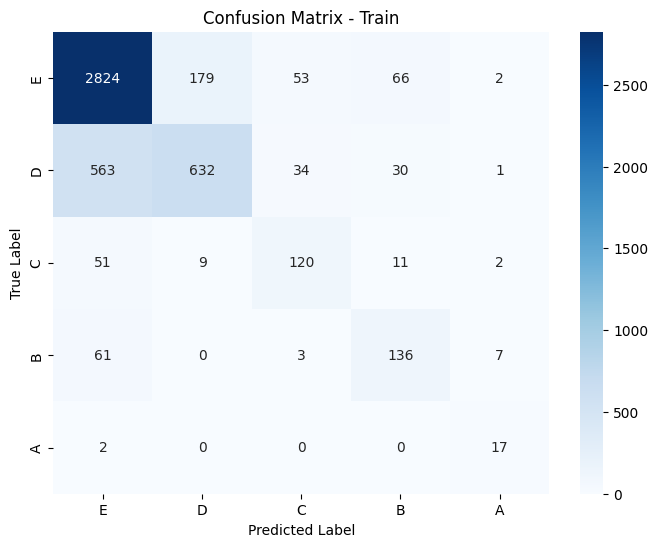

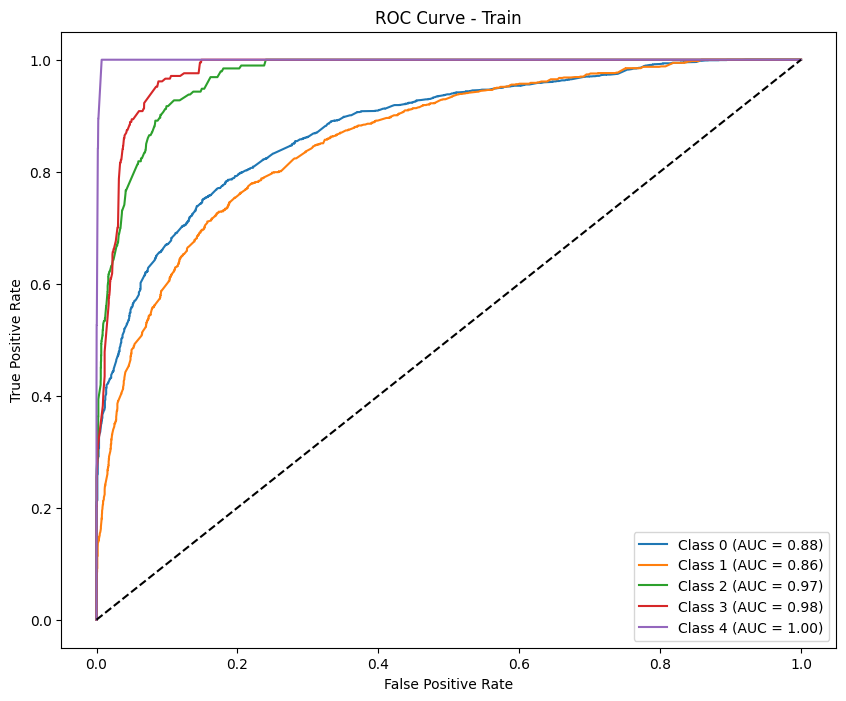

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8452579  0.1509434  0.         0.04081633 0.        ]
Precision (per class): [0.82736156 0.16666667 0.         0.03030303 0.        ]
Recall (per class): [0.86394558 0.13793103 0.         0.0625     0.        ]
Accuracy: 0.7226
AUC (One-vs-Rest): 0.6012

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.86      0.85       588
           D       0.17      0.14      0.15        87
           C       0.00      0.00      0.00        20
           B       0.03      0.06      0.04        16
           A       0.00      0.00      0.00        10

    accuracy                           0.72       721
   macro avg       0.20      0.21      0.21       721
weighted avg       0.70      0.72      0.71       721



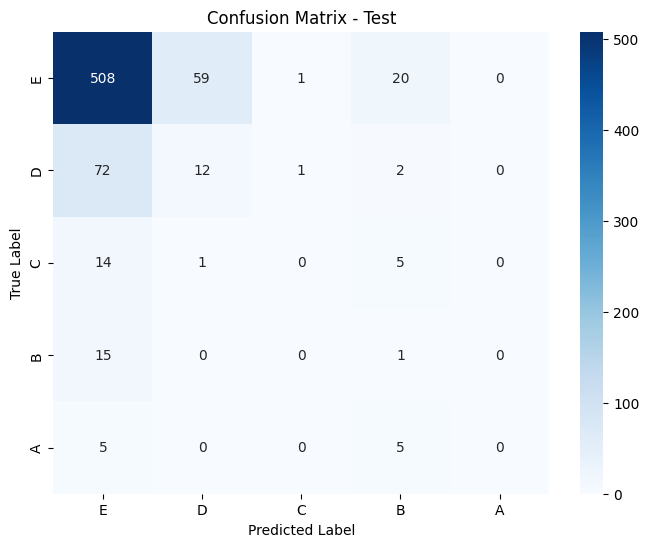

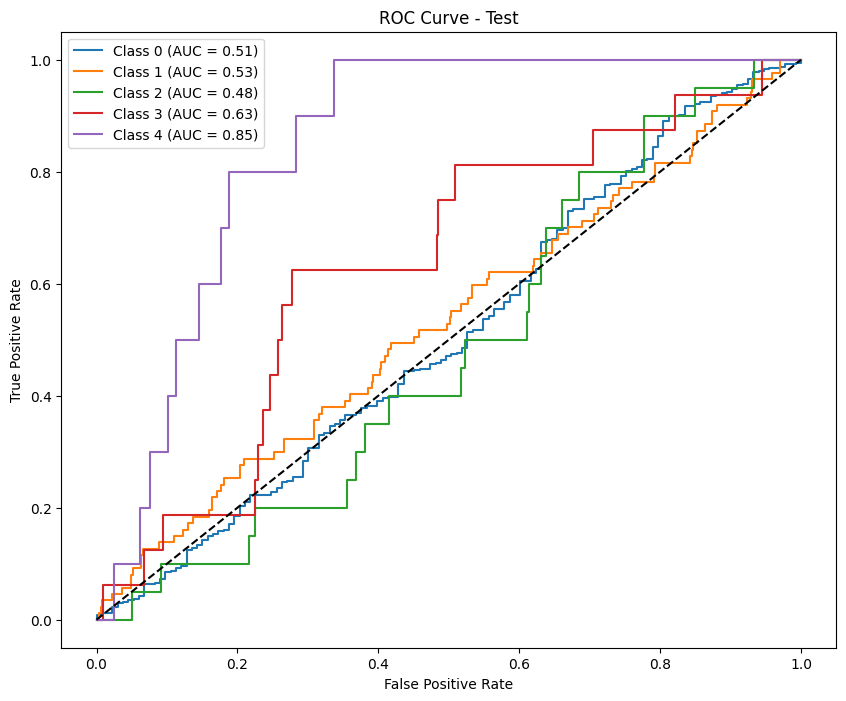

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.81925055 0.66934835 0.53538462 0.69873418 0.68292683]
Precision (per class): [0.91769547 0.62934947 0.38839286 0.58474576 0.51851852]
Recall (per class): [0.73988056 0.71477663 0.86138614 0.86792453 1.        ]
Accuracy: 0.7490
AUC (One-vs-Rest): 0.9460

Classification Report:
              precision    recall  f1-score   support

           E       0.92      0.74      0.82      1507
           D       0.63      0.71      0.67       582
           C       0.39      0.86      0.54       101
           B       0.58      0.87      0.70       159
           A       0.52      1.00      0.68        14

    accuracy                           0.75      2363
   macro 

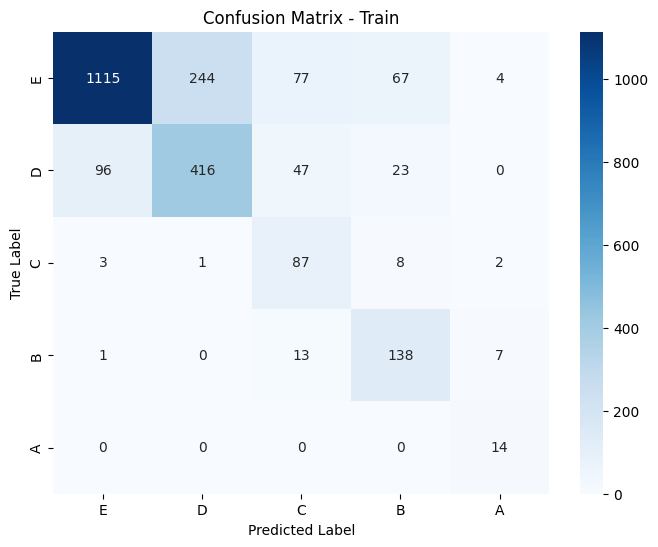

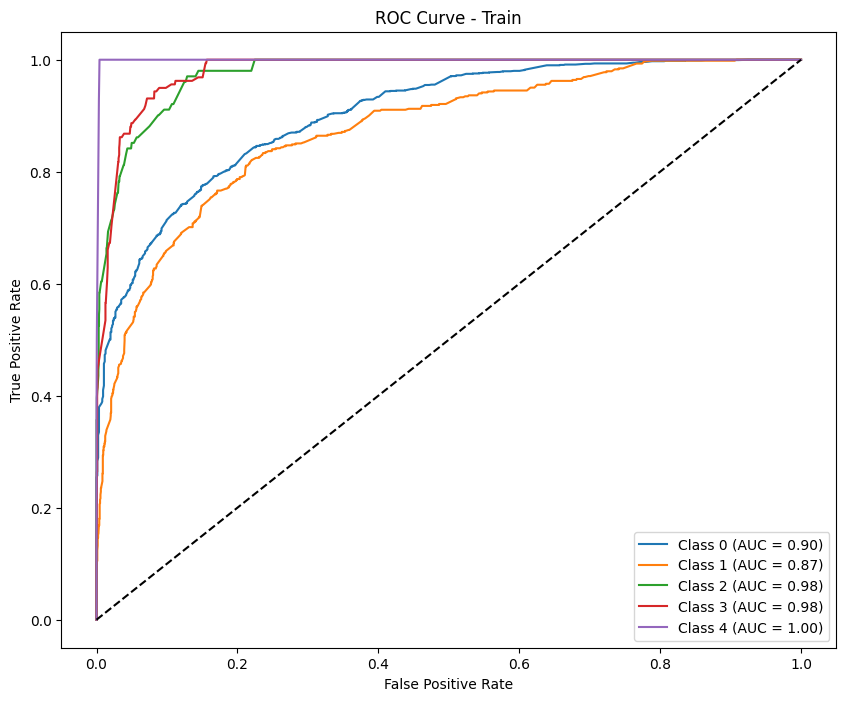

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.76603774 0.11049724 0.         0.06451613 0.        ]
Precision (per class): [0.8039604  0.10416667 0.         0.04       0.        ]
Recall (per class): [0.73153153 0.11764706 0.         0.16666667 0.        ]
Accuracy: 0.6099
AUC (One-vs-Rest): 0.5702

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.73      0.77       555
           D       0.10      0.12      0.11        85
           C       0.00      0.00      0.00        18
           B       0.04      0.17      0.06        18
           A       0.00      0.00      0.00        11

    accuracy                           0.61       687
   macro avg       0.19      0.20      0.19       687
weighted avg       0.66      0.61      0.63       687



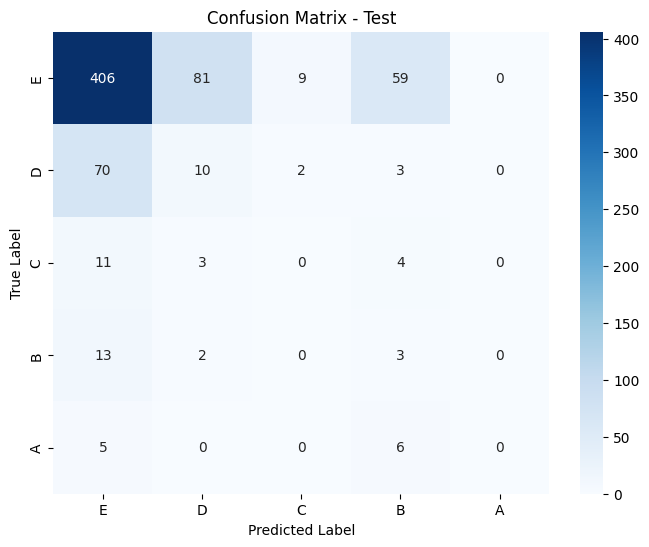

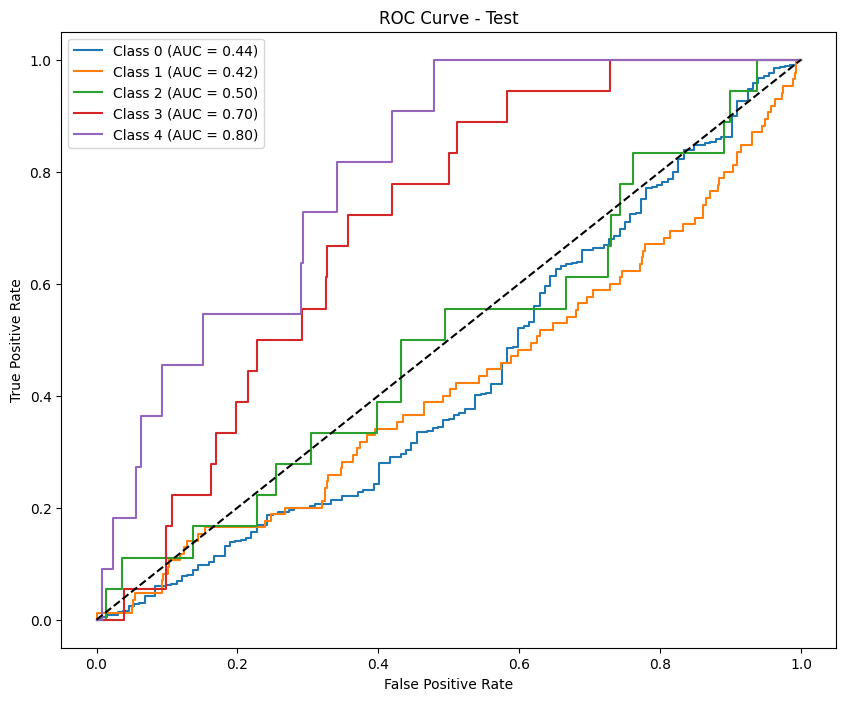

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.87144703 0.64065708 0.63967611 0.73854447 0.73684211]
Precision (per class): [0.84896161 0.79591837 0.54109589 0.64622642 0.58333333]
Recall (per class): [0.89515594 0.53608247 0.78217822 0.86163522 1.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.9512

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.90      0.87      1507
           D       0.80      0.54      0.64       582
           C       0.54      0.78      0.64       101
           B       0.65      0.86      0.74       159
           A       0.58      1.00      0.74        14

    accuracy                           0.80      2363
   macro avg       0.68      0.82      0.73      2363
weighted avg       0.81      0.80      0.79      2363



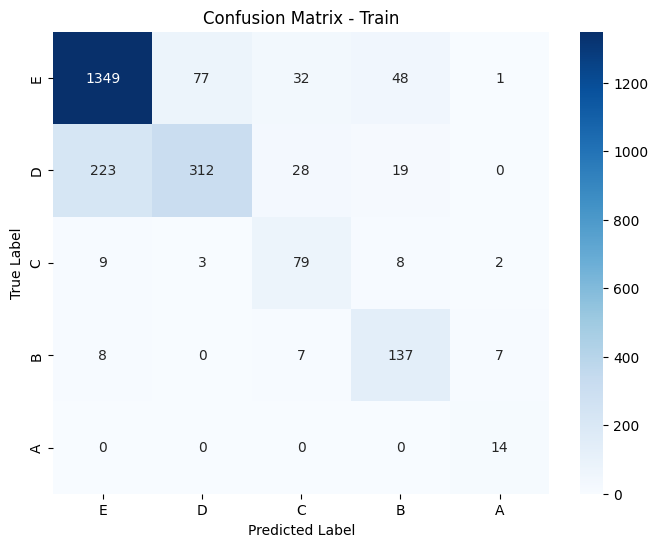

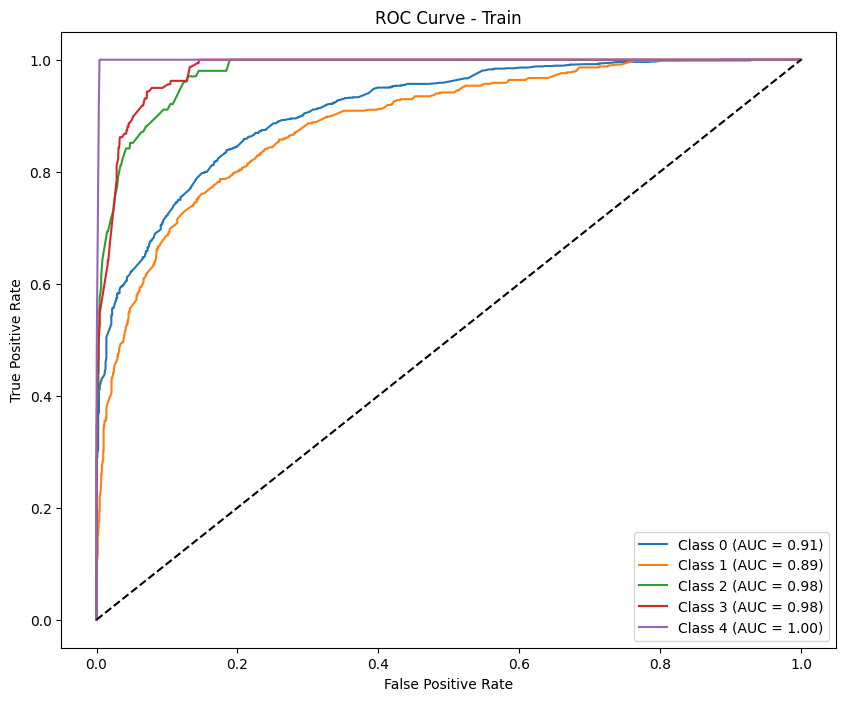

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.84687767 0.03278689 0.         0.03773585 0.        ]
Precision (per class): [0.80618893 0.05405405 0.         0.02857143 0.        ]
Recall (per class): [0.89189189 0.02352941 0.         0.05555556 0.        ]
Accuracy: 0.7249
AUC (One-vs-Rest): 0.5843

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.89      0.85       555
           D       0.05      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.03      0.06      0.04        18
           A       0.00      0.00      0.00        11

    accuracy                           0.72       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.66      0.72      0.69       687



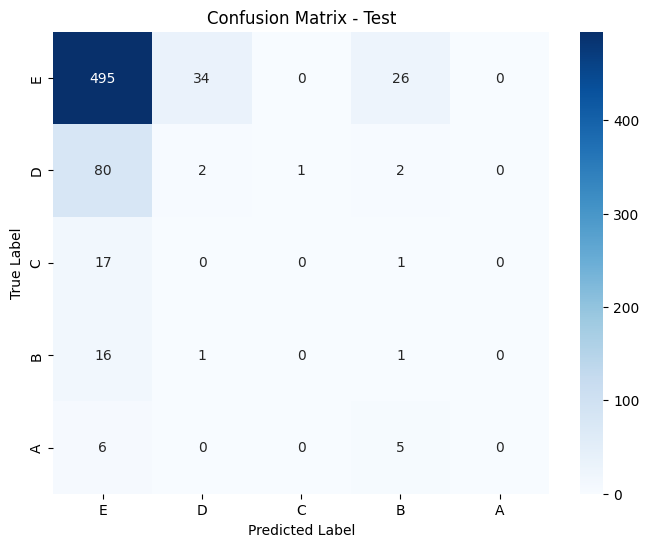

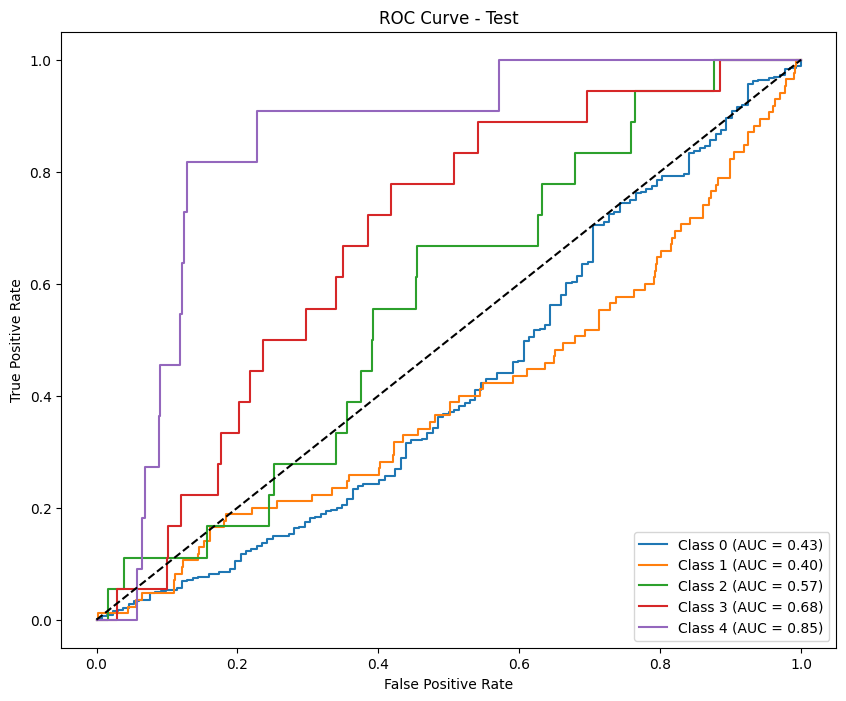

In [33]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, scale='minmax', metric='f1_macro')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

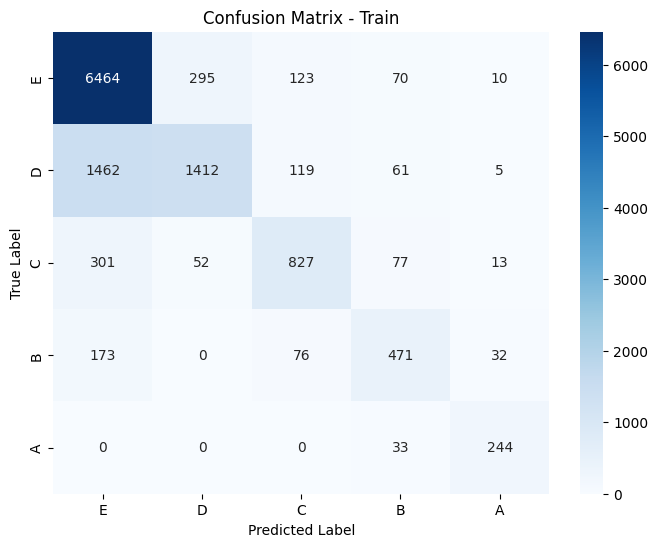

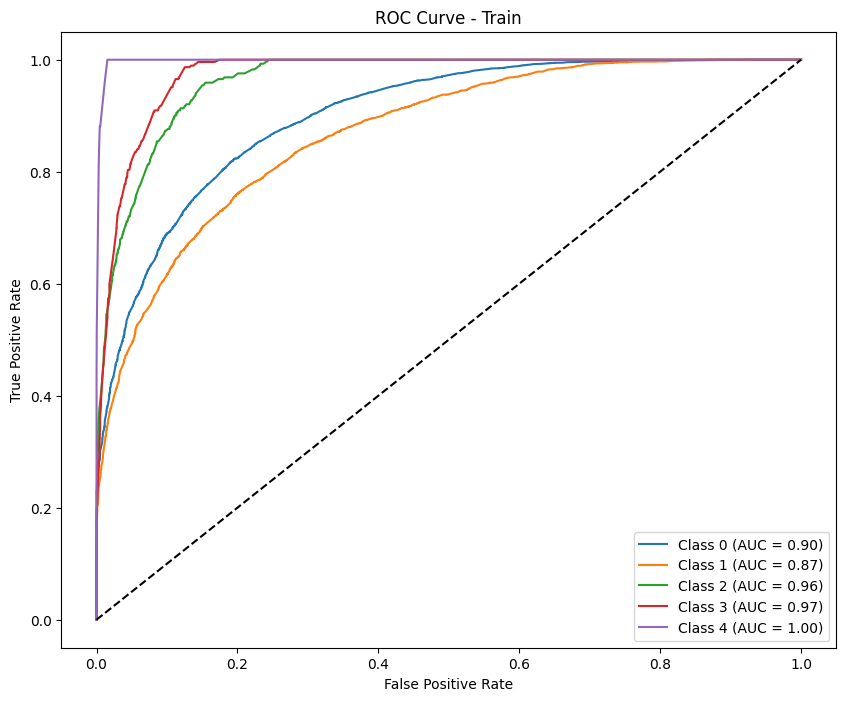

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.92331526 0.45882353 0.         0.         0.        ]
Precision (per class): [0.88296296 0.51315789 0.         0.         0.        ]
Recall (per class): [0.96753247 0.41489362 0.         0.         0.        ]
Accuracy: 0.8399
AUC (One-vs-Rest): 0.8160

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.97      0.92       616
           D       0.51      0.41      0.46        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.28      0.28      0.28       756
weighted avg       0.78      0.84      0.81       756



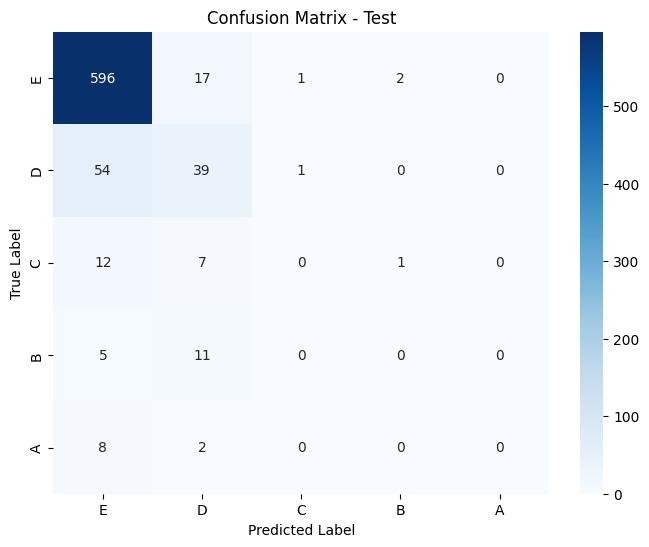

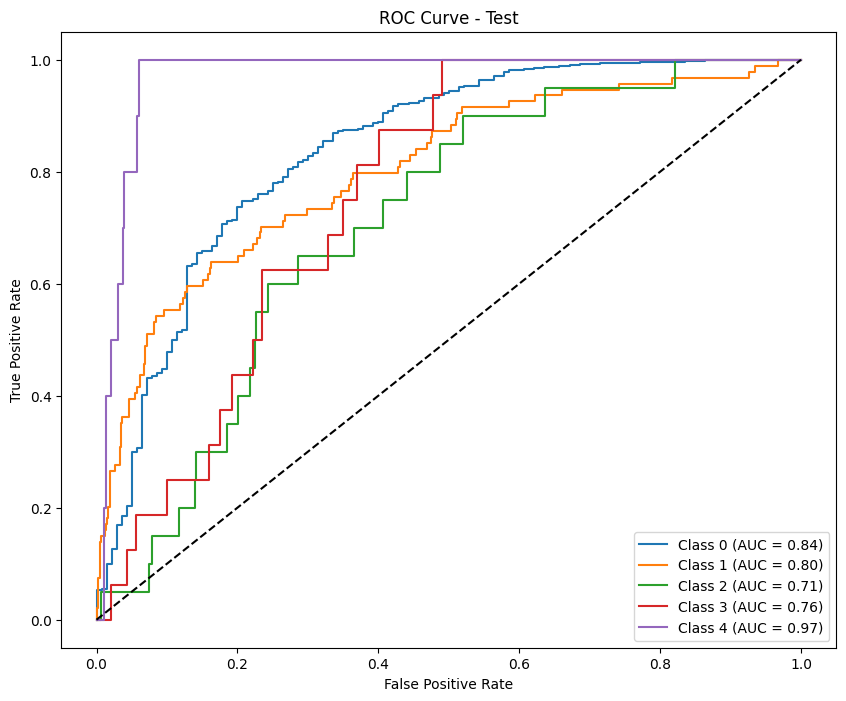

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase1.csv
Results for phase: phase1

--- Train Metrics ---
F1 Score (per class): [0.84045184 0.61813292 0.68423219 0.64485344 0.8457539 ]
Precision (per class): [0.78597325 0.74941779 0.71699741 0.66153846 0.81333333]
Recall (per class): [0.9030451  0.52598889 0.65433071 0.62898936 0.88086643]
Accuracy: 0.7666
AUC (One-vs-Rest): 0.9413

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.90      0.84      6962
           D       0.75      0.53      0.62      3059
           C       0.72      0.65      0.68      1270
           B       0.66      0.63      0.64       752
           A       0.81      0.88      0.85       277

    accuracy                           0.77     12320
   macro avg       0.75      0.72      0.73     12320
weighted avg       0.76      0.77      0.76     12320



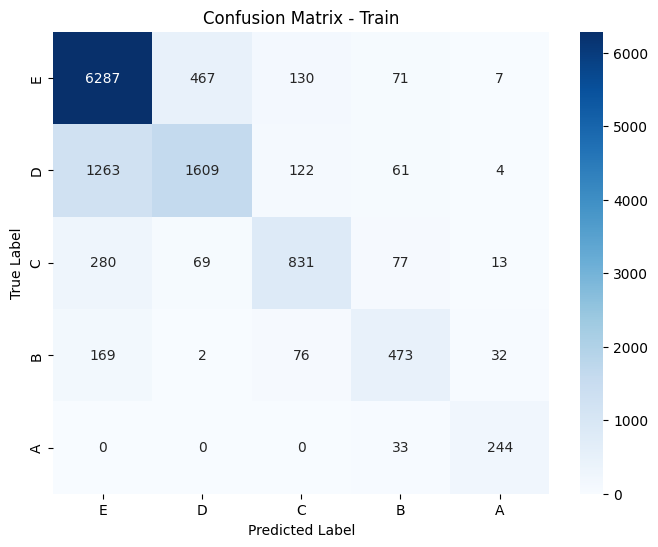

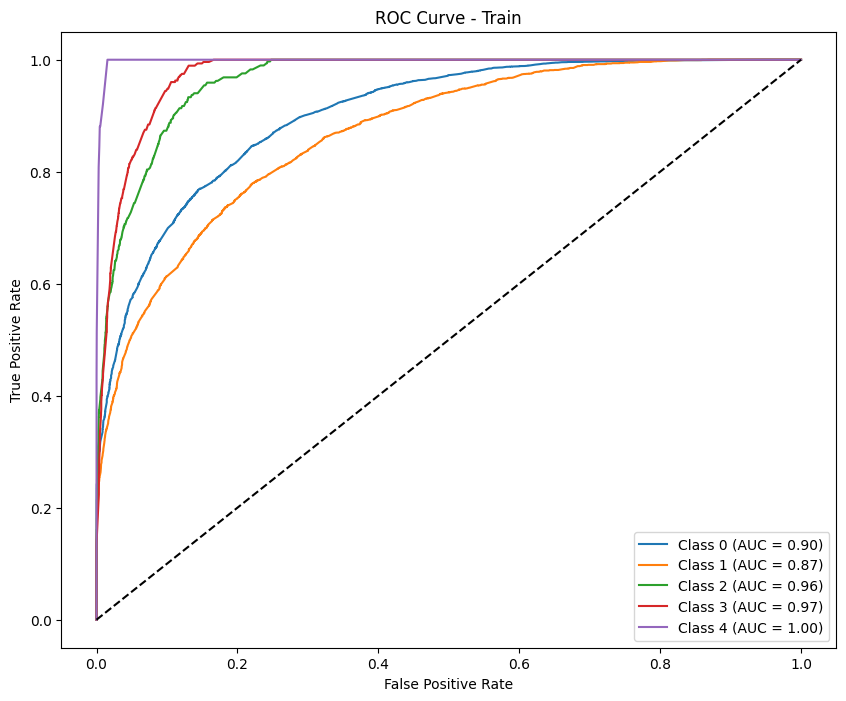

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9222395  0.44827586 0.         0.         0.        ]
Precision (per class): [0.88507463 0.4875     0.         0.         0.        ]
Recall (per class): [0.96266234 0.41489362 0.         0.         0.        ]
Accuracy: 0.8360
AUC (One-vs-Rest): 0.7772

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.96      0.92       616
           D       0.49      0.41      0.45        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.84       756
   macro avg       0.27      0.28      0.27       756
weighted avg       0.78      0.84      0.81       756



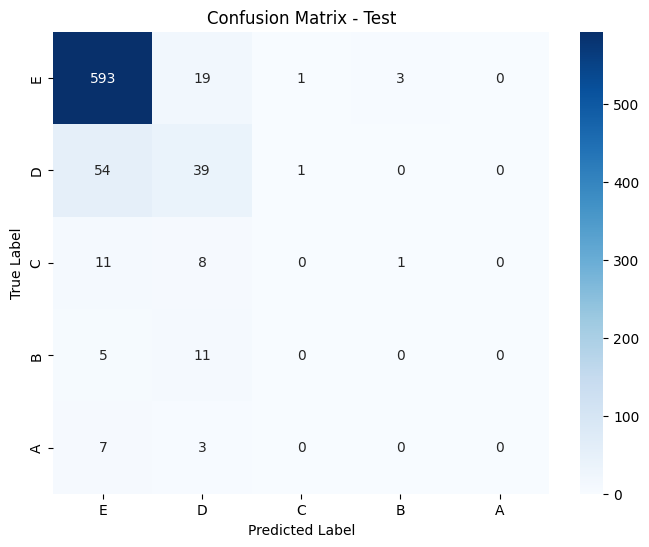

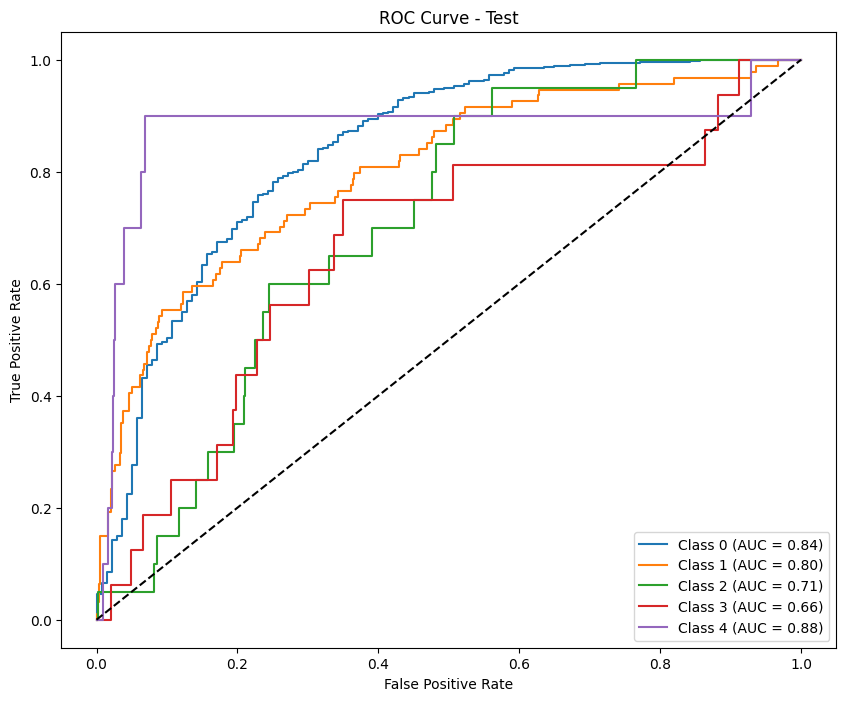


Permutation Importance for phase: phase1


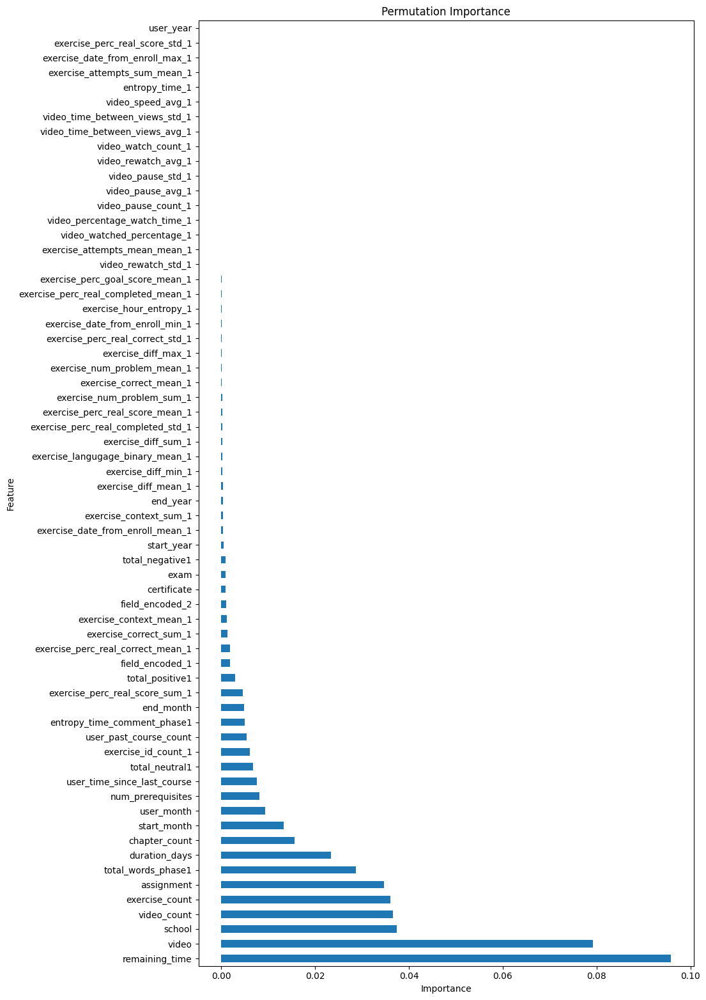

                            Feature  Importance
20                   remaining_time    0.095881
17                            video    0.079261
0                            school    0.037459
9                       video_count    0.036526
10                   exercise_count    0.035988
..                              ...         ...
59                   entropy_time_1    0.000000
27     exercise_attempts_sum_mean_1    0.000000
31  exercise_date_from_enroll_max_1   -0.000030
46   exercise_perc_real_score_std_1   -0.000041
7                         user_year   -0.000101

[64 rows x 2 columns]

Lasso Feature Selection for phase: phase1


Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1400730627156008, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4538682082884407, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.454513783034599, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.426857997465049, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.399785578621959, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.4757078539205395, tolerance: 1.0302982853084377
Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.3972607679870634, tolerance: 1.030298285308

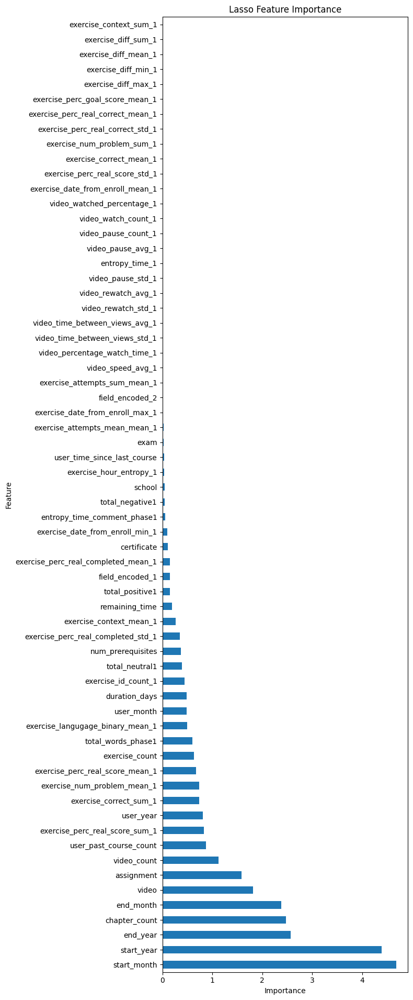

                   Feature  Importance
4              start_month    4.680003
3               start_year    4.391702
5                 end_year    2.571755
11           chapter_count    2.470676
6                end_month    2.379714
..                     ...         ...
38     exercise_diff_max_1    0.000000
37     exercise_diff_min_1    0.000000
36    exercise_diff_mean_1    0.000000
35     exercise_diff_sum_1    0.000000
32  exercise_context_sum_1    0.000000

[64 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                              Feature  Importance
15                        certificate    0.140491
44     exercise_perc_real_score_sum_1    0.111857
17                              video    0.093856
16                         assignment    0.061967
42  exercise_perc_real_correct_mean_1    0.036754
..                                ...         ...
59                     entropy_time_1    0.000000
49         video_watched_percentage_1    0.0000

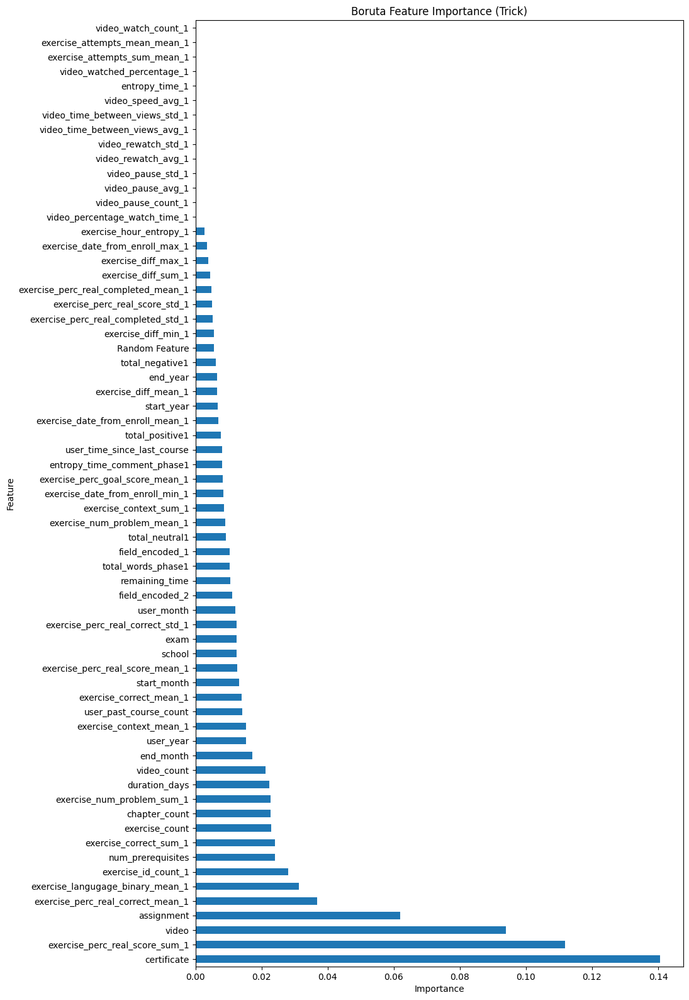

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83901484 0.55692874 0.70787402 0.65398168 0.88461538]
Precision (per class): [0.77446552 0.77867647 0.68625954 0.67343977 0.85185185]
Recall (per class): [0.91530249 0.43348342 0.73089431 0.63561644 0.92      ]
Accuracy: 0.7593
AUC (One-vs-Rest): 0.9408

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.92      0.84      5620
           D       0.78      0.43      0.56      2443
           C       0.69      0.73      0.71      1230
           B       0.67      0.64      0.65       730
           A       0.85      0.92      0.88       275

    accuracy                           0.76     10298
   macro 

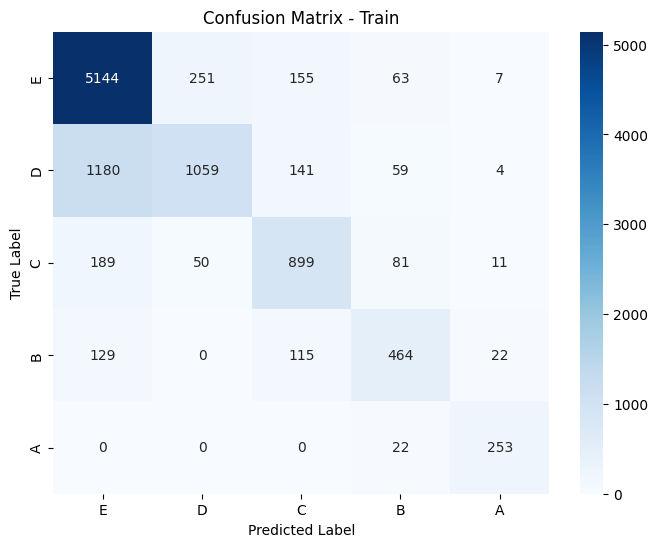

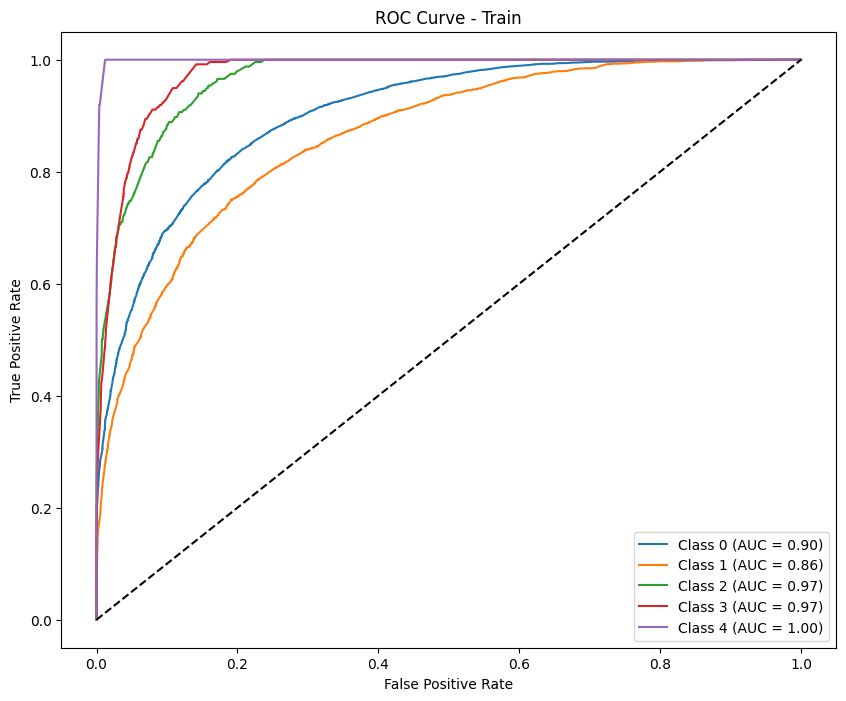

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.90253262 0.28148148 0.         0.         0.        ]
Precision (per class): [0.84726225 0.44186047 0.         0.         0.        ]
Recall (per class): [0.96551724 0.20652174 0.         0.         0.        ]
Accuracy: 0.8137
AUC (One-vs-Rest): 0.7568

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.97      0.90       609
           D       0.44      0.21      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.26      0.23      0.24       746
weighted avg       0.75      0.81      0.77       746



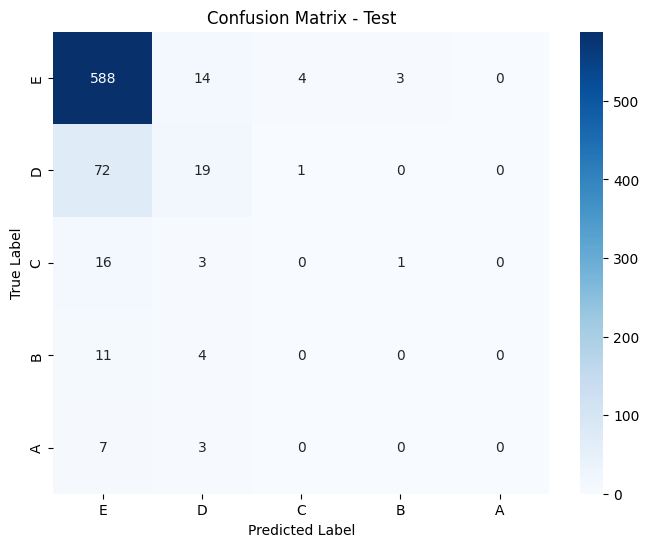

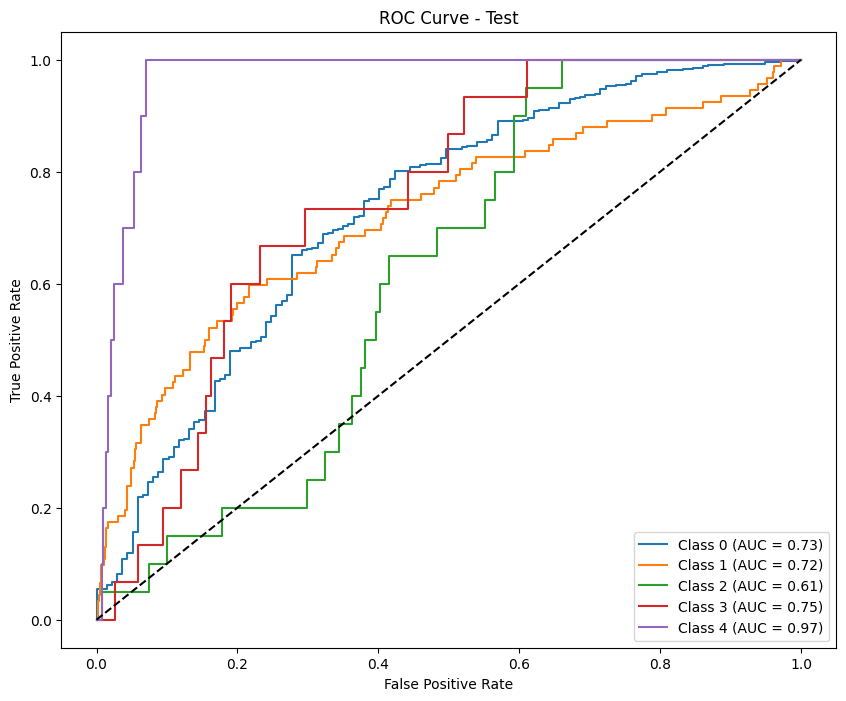

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase2.csv
Results for phase: phase2

--- Train Metrics ---
F1 Score (per class): [0.83616679 0.59113772 0.71263452 0.66710526 0.88927944]
Precision (per class): [0.79687248 0.71247113 0.69898358 0.64177215 0.86054422]
Recall (per class): [0.87953737 0.50511666 0.72682927 0.69452055 0.92      ]
Accuracy: 0.7604
AUC (One-vs-Rest): 0.9411

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.88      0.84      5620
           D       0.71      0.51      0.59      2443
           C       0.70      0.73      0.71      1230
           B       0.64      0.69      0.67       730
           A       0.86      0.92      0.89       275

    accuracy                           0.76     10298
   macro avg       0.74      0.75      0.74     10298
weighted avg       0.76      0.76      0.75     10298



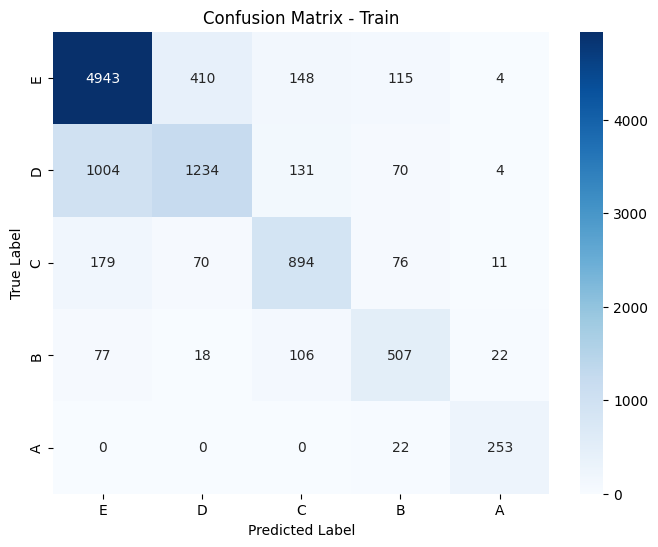

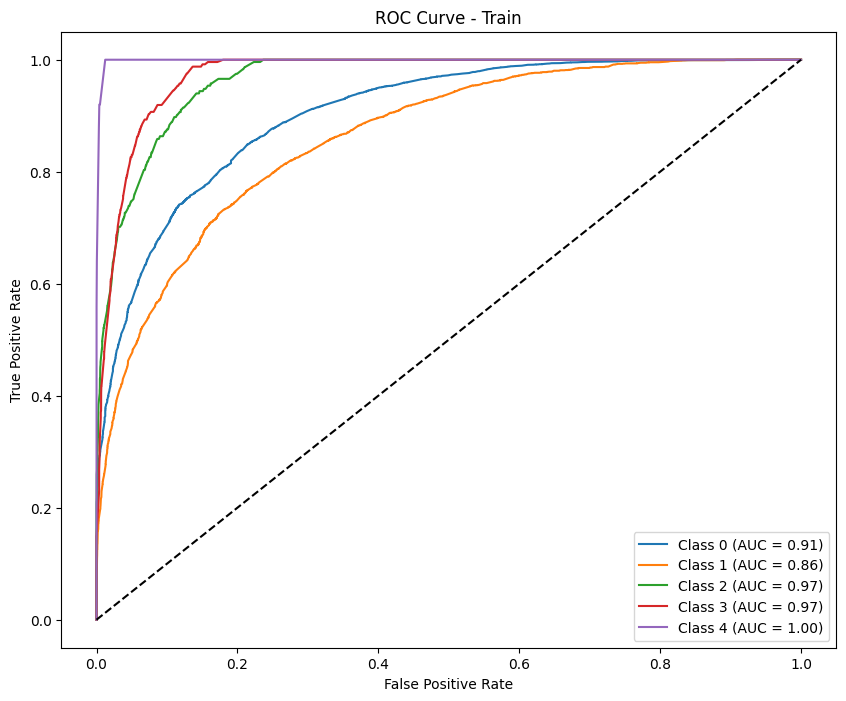

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.9003861  0.28169014 0.         0.         0.        ]
Precision (per class): [0.84985423 0.4        0.         0.         0.        ]
Recall (per class): [0.95730706 0.2173913  0.         0.         0.        ]
Accuracy: 0.8083
AUC (One-vs-Rest): 0.7287

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.96      0.90       609
           D       0.40      0.22      0.28        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.81       746
   macro avg       0.25      0.23      0.24       746
weighted avg       0.74      0.81      0.77       746



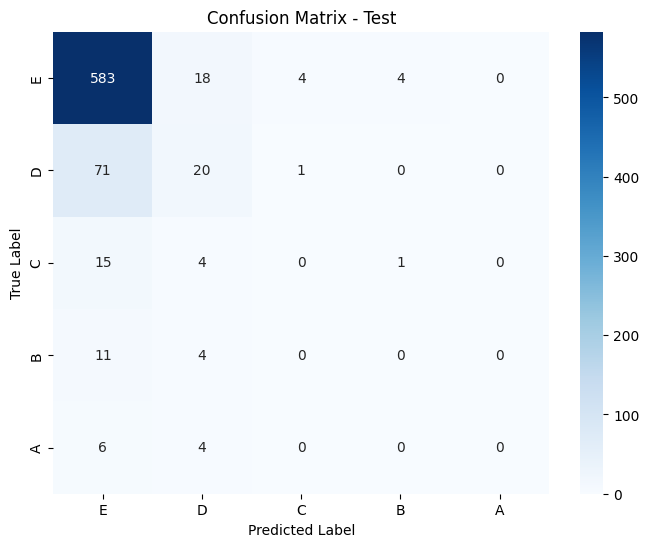

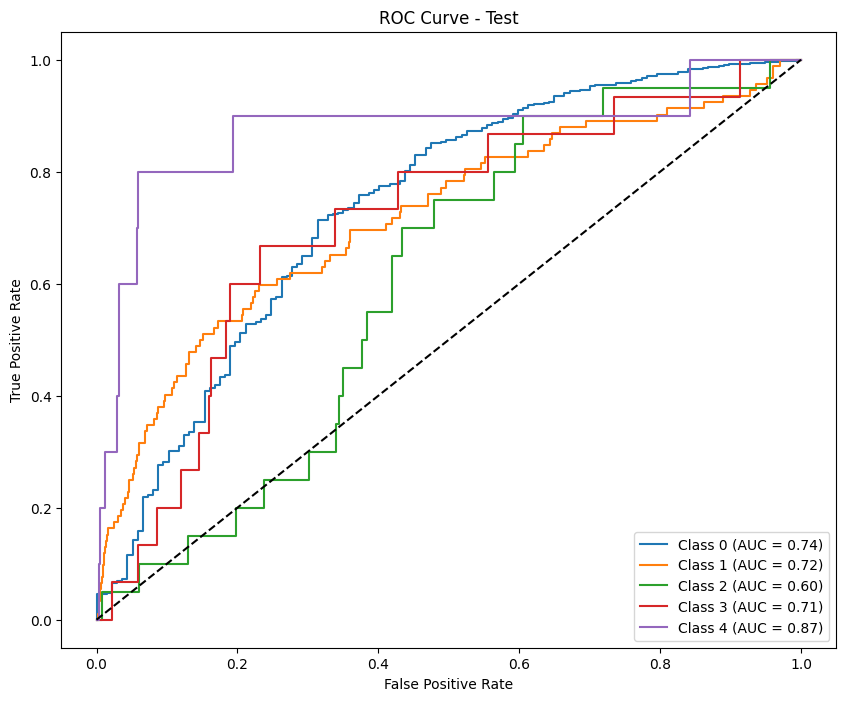


Permutation Importance for phase: phase2


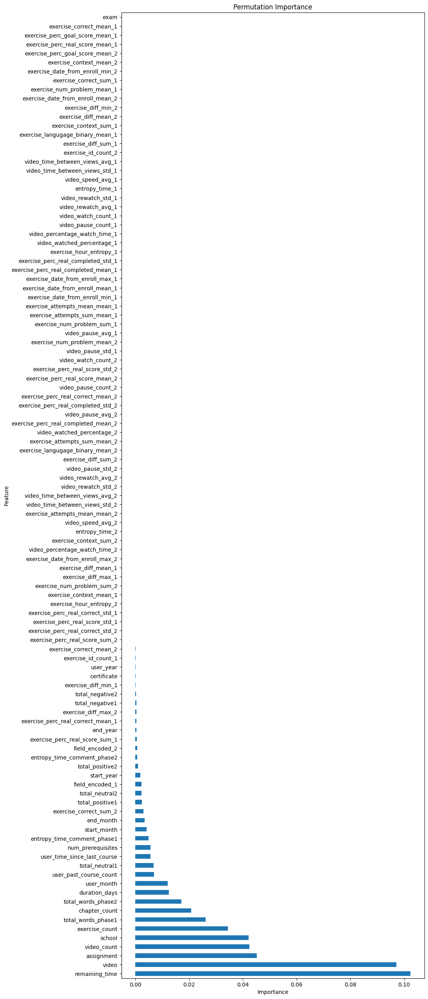

                            Feature  Importance
20                   remaining_time    0.102399
17                            video    0.097191
16                       assignment    0.045227
9                       video_count    0.042472
0                            school    0.042120
..                              ...         ...
82  exercise_perc_goal_score_mean_2   -0.000049
45  exercise_perc_real_score_mean_1   -0.000049
39  exercise_perc_goal_score_mean_1   -0.000061
24          exercise_correct_mean_1   -0.000061
18                             exam   -0.000073

[107 rows x 2 columns]

Lasso Feature Selection for phase: phase2


Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.0856672171921673, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.871230364437906, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.692601455834847, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.087237587356867, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.221889369920973, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.32726778759934, tolerance: 0.9432695799951406
Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.201227863049098, tolerance: 0.94326957999

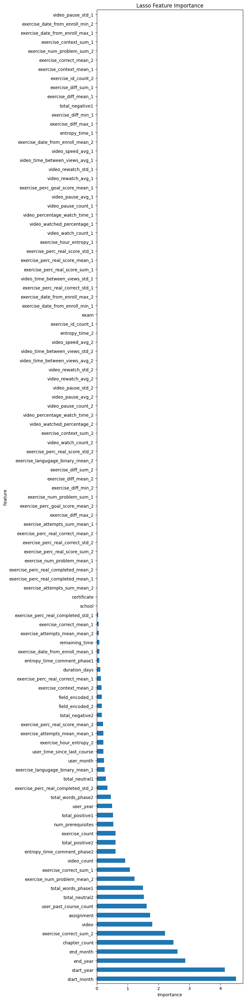

                            Feature  Importance
4                       start_month    4.502798
3                        start_year    4.147642
5                          end_year    2.869039
6                         end_month    2.616952
11                    chapter_count    2.483980
..                              ...         ...
68       exercise_num_problem_sum_2    0.000000
32           exercise_context_sum_1    0.000000
31  exercise_date_from_enroll_max_1    0.000000
72  exercise_date_from_enroll_min_2    0.000000
53                video_pause_std_1    0.000000

[107 rows x 2 columns]

Boruta Trick:
Feature Importance (Including Random Feature):
                               Feature  Importance
15                         certificate    0.142257
17                               video    0.111740
16                          assignment    0.056193
14                   num_prerequisites    0.022978
10                      exercise_count    0.022738
..                              

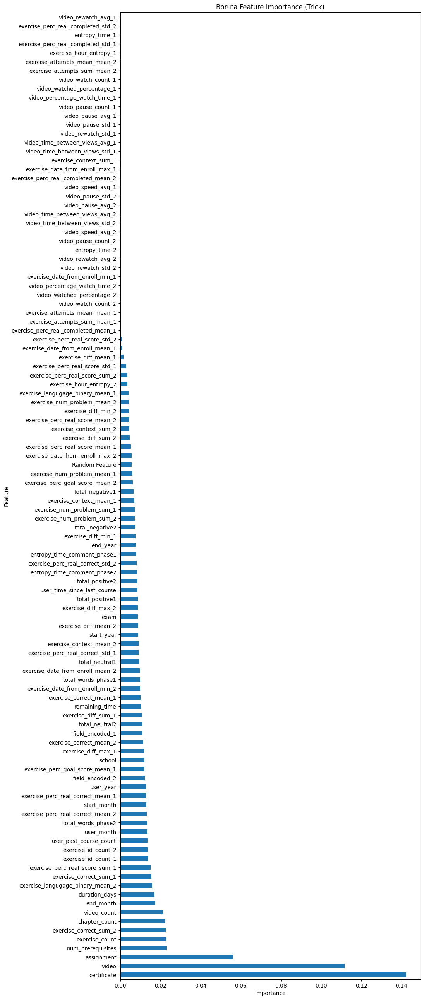

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84372177 0.58127258 0.72263993 0.68368032 0.86642599]
Precision (per class): [0.78540195 0.78117999 0.72023314 0.65089514 0.84210526]
Recall (per class): [0.91139735 0.46283186 0.72506287 0.71994342 0.89219331]
Accuracy: 0.7673
AUC (One-vs-Rest): 0.9457

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.91      0.84      5124
           D       0.78      0.46      0.58      2260
           C       0.72      0.73      0.72      1193
           B       0.65      0.72      0.68       707
           A       0.84      0.89      0.87       269

    accuracy                           0.77      9553
   macro 

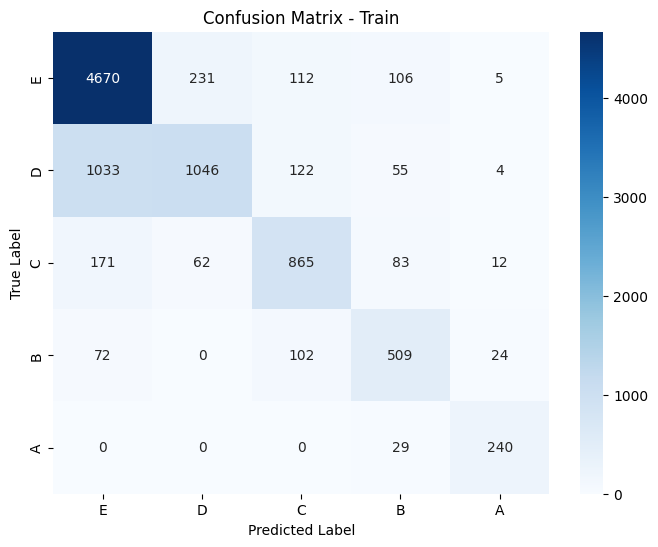

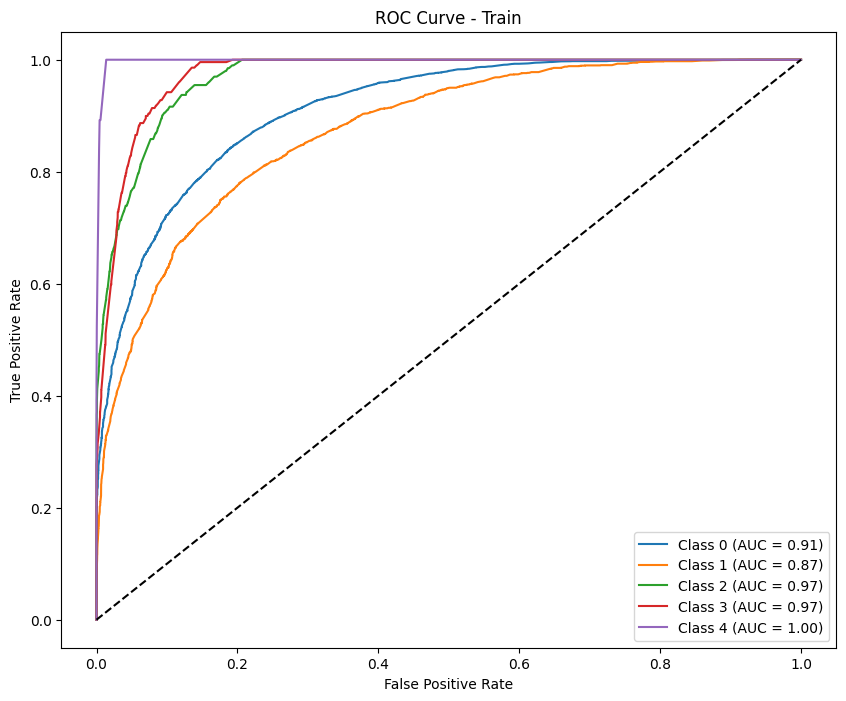

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.89184953 0.125      0.08333333 0.         0.        ]
Precision (per class): [0.82703488 0.28       0.25       0.         0.        ]
Recall (per class): [0.96768707 0.08045977 0.05       0.         0.        ]
Accuracy: 0.8003
AUC (One-vs-Rest): 0.6462

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.08      0.12        87
           C       0.25      0.05      0.08        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.27      0.22      0.22       721
weighted avg       0.72      0.80      0.74       721



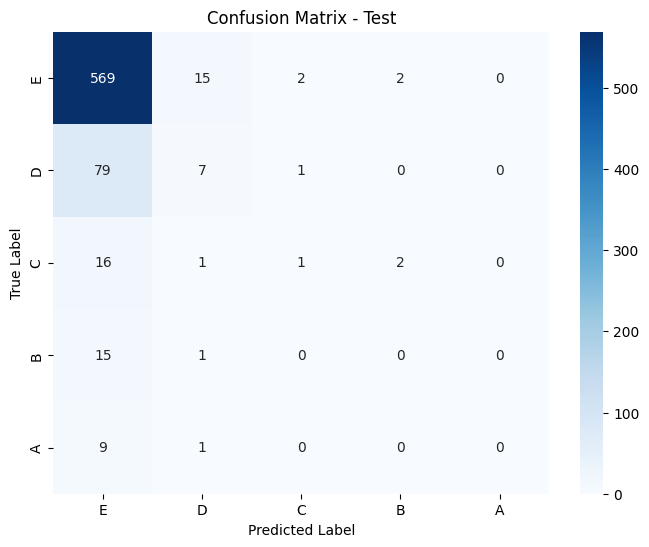

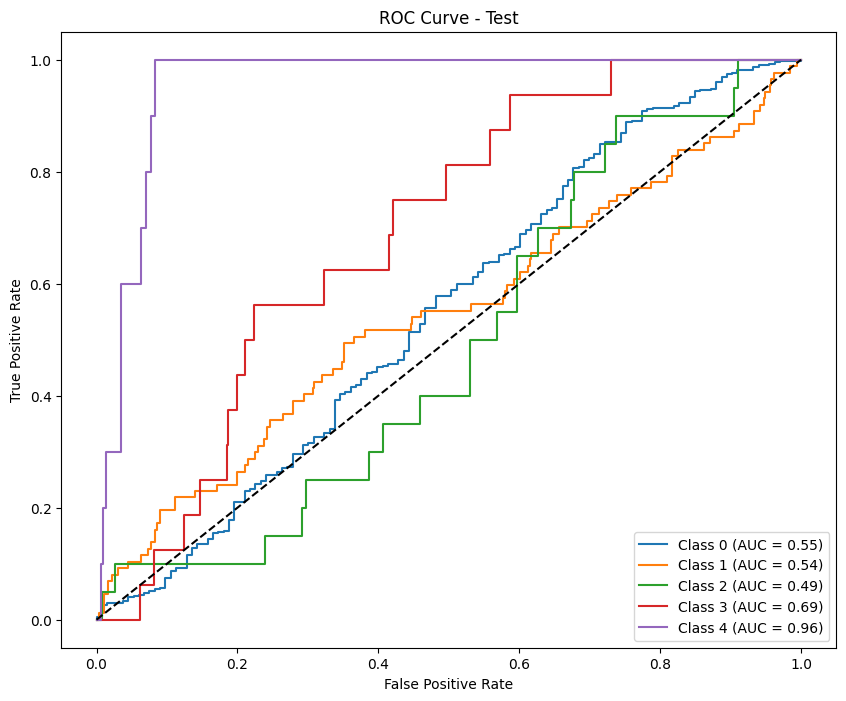

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase3.csv
Results for phase: phase3

--- Train Metrics ---
F1 Score (per class): [0.84161892 0.61077844 0.72522898 0.68724832 0.87114338]
Precision (per class): [0.7992278  0.74193548 0.72043011 0.65389527 0.85106383]
Recall (per class): [0.88875878 0.51902655 0.7300922  0.7241867  0.89219331]
Accuracy: 0.7694
AUC (One-vs-Rest): 0.9462

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.89      0.84      5124
           D       0.74      0.52      0.61      2260
           C       0.72      0.73      0.73      1193
           B       0.65      0.72      0.69       707
           A       0.85      0.89      0.87       269

    accuracy                           0.77      9553
   macro avg       0.75      0.75      0.75      9553
weighted avg       0.77      0.77      0.76      9553



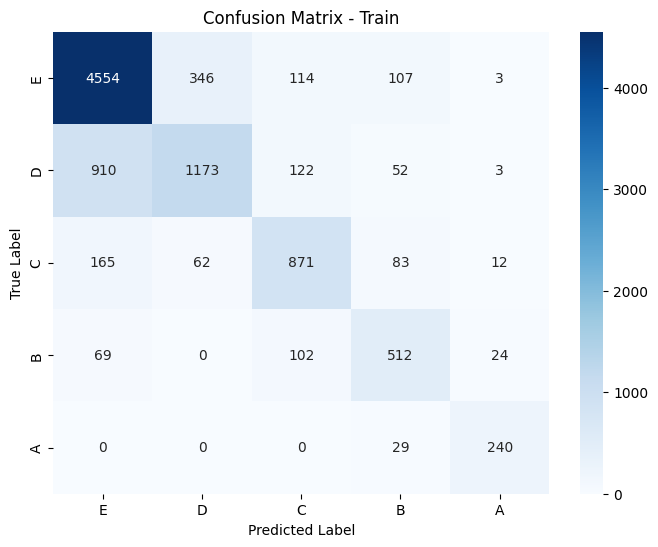

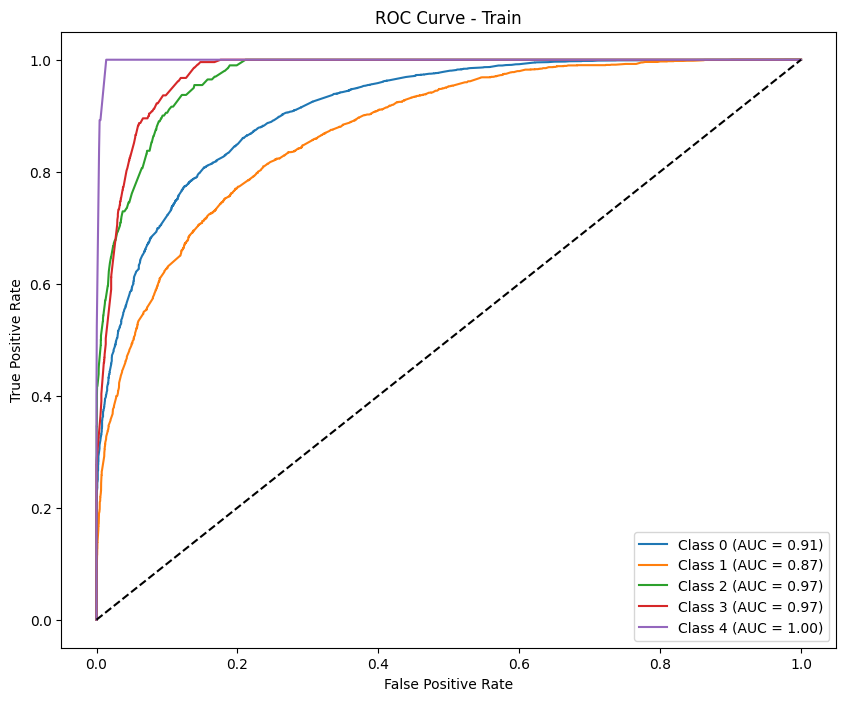

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.8923802  0.13793103 0.         0.         0.        ]
Precision (per class): [0.82919708 0.27586207 0.         0.         0.        ]
Recall (per class): [0.96598639 0.09195402 0.         0.         0.        ]
Accuracy: 0.7989
AUC (One-vs-Rest): 0.6167

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.97      0.89       588
           D       0.28      0.09      0.14        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.80       721
   macro avg       0.22      0.21      0.21       721
weighted avg       0.71      0.80      0.74       721



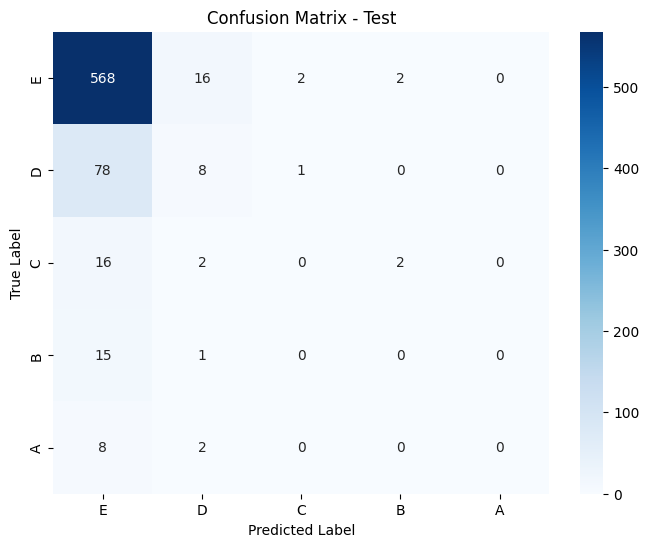

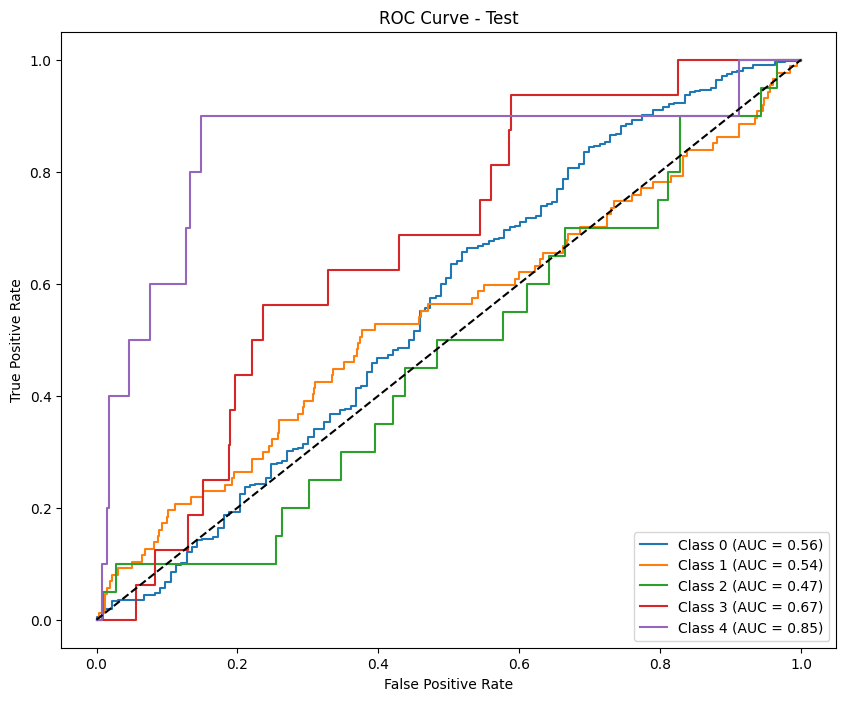

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None
Results saved as test_results_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85500544 0.6346229  0.81690141 0.76490747 0.90410959]
Precision (per class): [0.81742523 0.83111566 0.79248506 0.6975     0.825     ]
Recall (per class): [0.89620758 0.51327434 0.84287012 0.84673748 1.        ]
Accuracy: 0.8021
AUC (One-vs-Rest): 0.9594

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.90      0.86      3507
           D       0.83      0.51      0.63      1582
           C       0.79      0.84      0.82      1101
           B       0.70      0.85      0.76       659
           A       0.82      1.00      0.90       264

    accuracy                           0.80      7113
   macro 

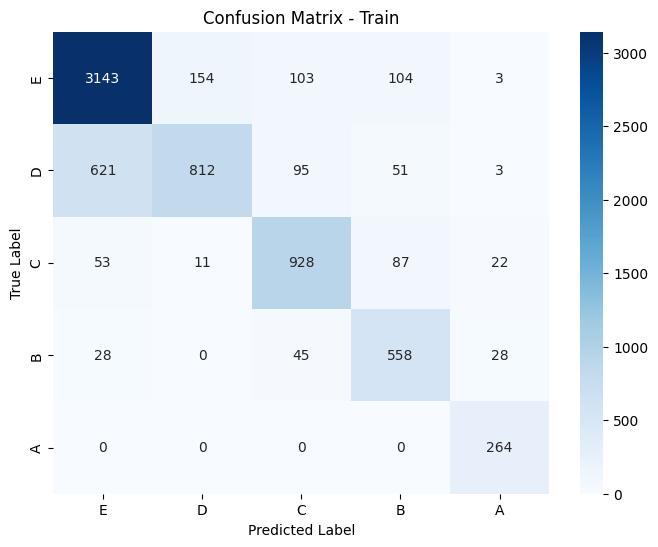

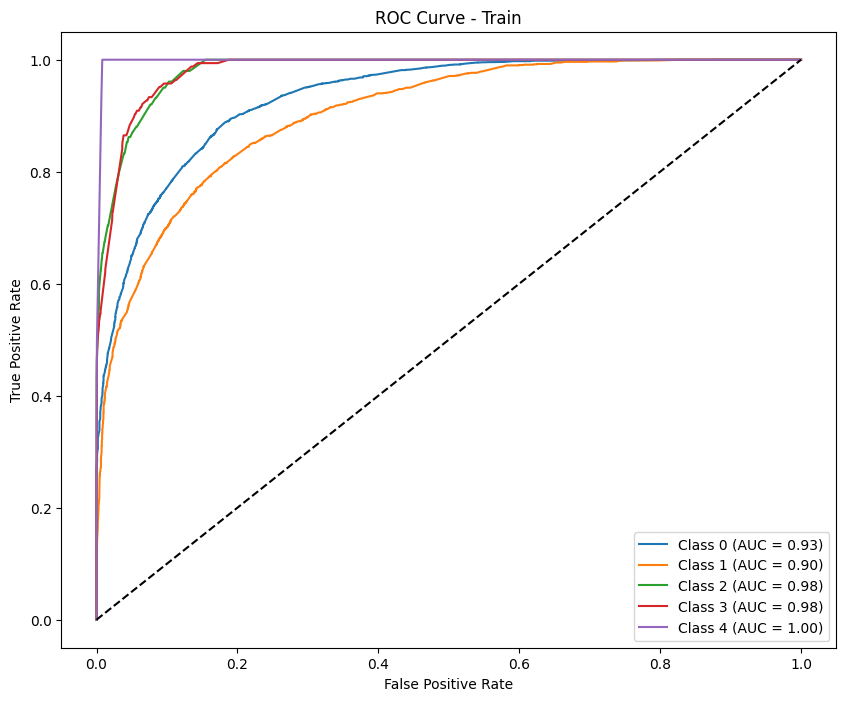

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87593672 0.03703704 0.         0.         0.        ]
Precision (per class): [0.81424149 0.08695652 0.         0.         0.        ]
Recall (per class): [0.94774775 0.02352941 0.         0.         0.        ]
Accuracy: 0.7686
AUC (One-vs-Rest): 0.5852

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.95      0.88       555
           D       0.09      0.02      0.04        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.77       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.77      0.71       687



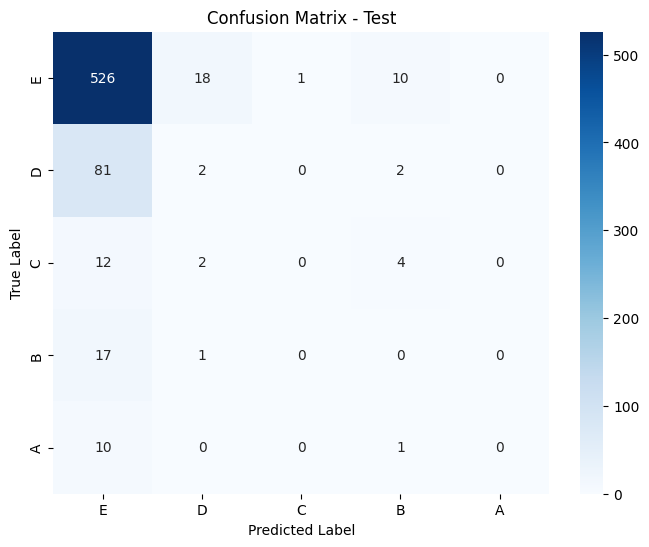

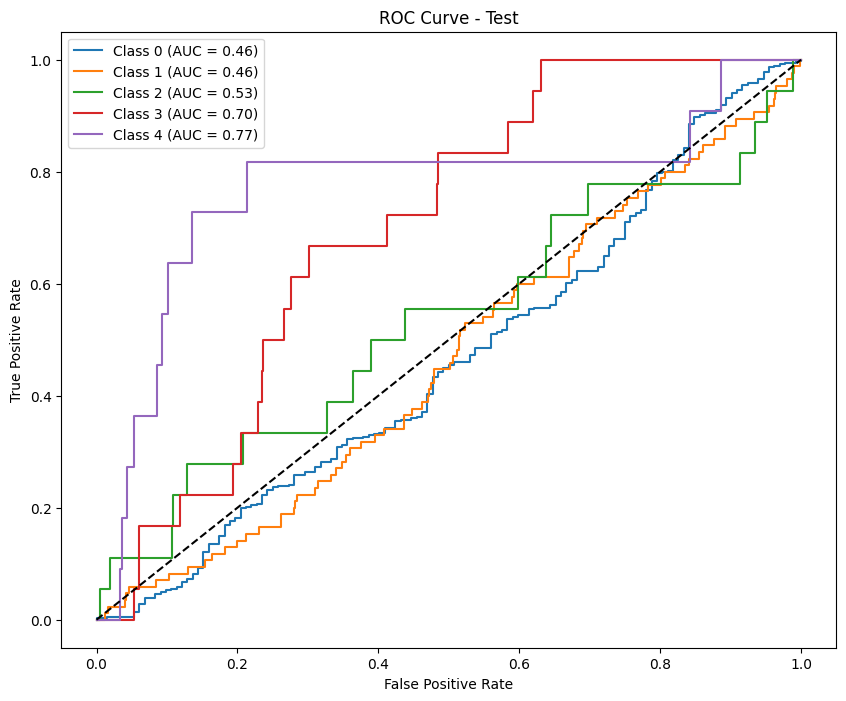

Results saved as test_results_calibrate_undersample_minmax_f1_macro_phase4.csv
Results for phase: phase4

--- Train Metrics ---
F1 Score (per class): [0.85564738 0.64971537 0.81726112 0.76641842 0.90566038]
Precision (per class): [0.82760458 0.81291548 0.79316239 0.69193154 0.82758621]
Recall (per class): [0.88565726 0.54108723 0.84287012 0.85887709 1.        ]
Accuracy: 0.8042
AUC (One-vs-Rest): 0.9599

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.89      0.86      3507
           D       0.81      0.54      0.65      1582
           C       0.79      0.84      0.82      1101
           B       0.69      0.86      0.77       659
           A       0.83      1.00      0.91       264

    accuracy                           0.80      7113
   macro avg       0.79      0.83      0.80      7113
weighted avg       0.81      0.80      0.80      7113



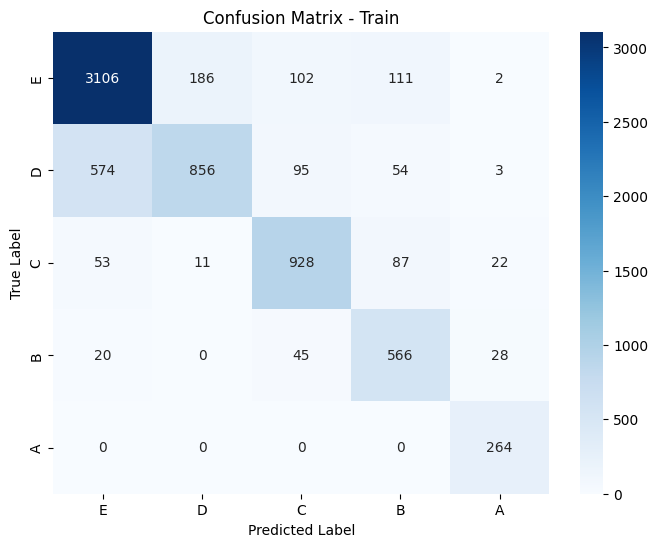

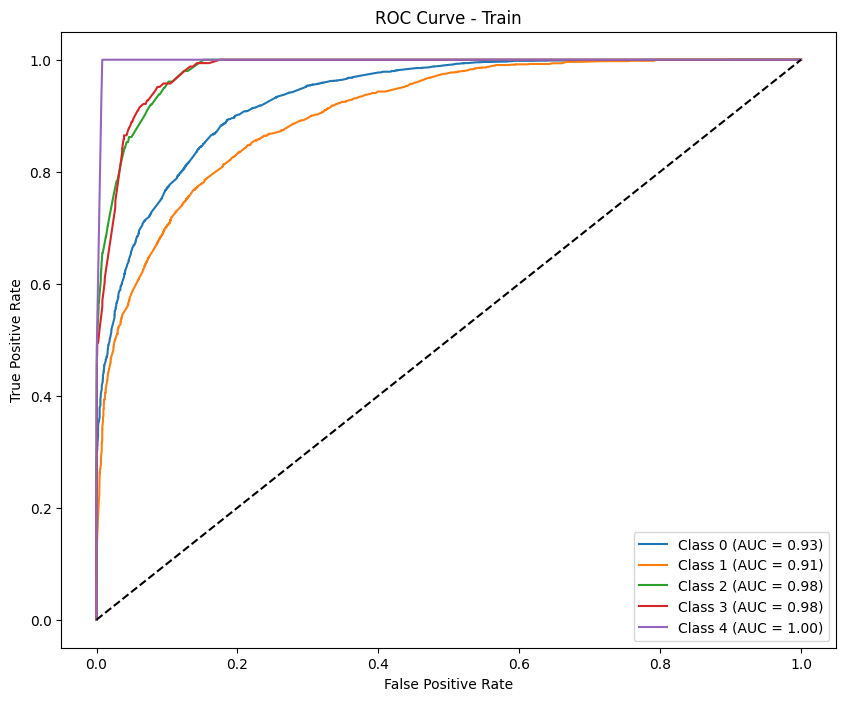

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



--- Test Metrics ---
F1 Score (per class): [0.87102178 0.03478261 0.         0.         0.        ]
Precision (per class): [0.81377152 0.06666667 0.         0.         0.        ]
Recall (per class): [0.93693694 0.02352941 0.         0.         0.        ]
Accuracy: 0.7598
AUC (One-vs-Rest): 0.5719

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.94      0.87       555
           D       0.07      0.02      0.03        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.76       687
   macro avg       0.18      0.19      0.18       687
weighted avg       0.67      0.76      0.71       687



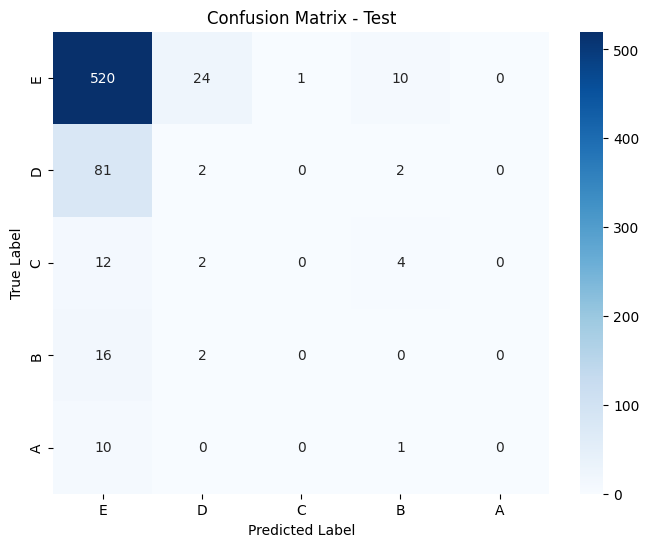

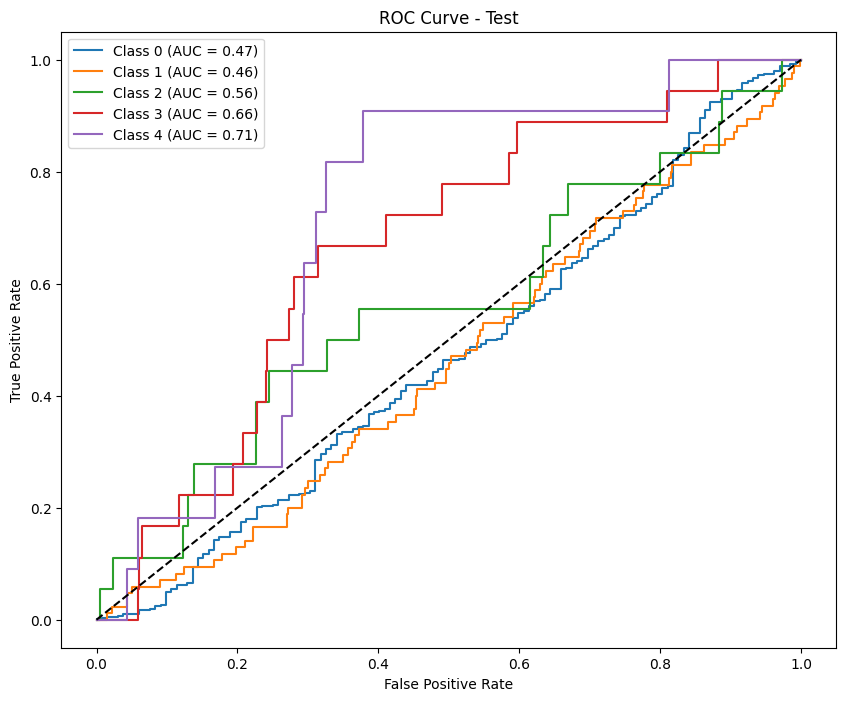

In [34]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, scale='minmax', metric='f1_macro')